<a href="https://colab.research.google.com/github/FitriNurjanah/Deep-Learning-Lanjut-Tugas/blob/main/Tugas_4_Model_DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os

# Konfigurasi agar GPU digunakan secara efisien
physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU Terdeteksi: ", physical_devices[0])
else:
    print("Peringatan: GPU tidak terdeteksi. Training akan lambat.")

GPU Terdeteksi:  PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [2]:
# Create the .kaggle directory if it doesn't exist
!mkdir -p ~/.kaggle

# Move the kaggle.json file to the .kaggle directory
# IMPORTANT: Make sure you have uploaded kaggle.json to your Colab session's /content/ directory first.
# If you uploaded it somewhere else, adjust the source path accordingly.
!mv /content/kaggle.json ~/.kaggle/

# Set read-only permissions for the kaggle.json file for security
!chmod 600 ~/.kaggle/kaggle.json

print("Kaggle API credentials set up successfully!")

mv: cannot stat '/content/kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory
Kaggle API credentials set up successfully!


In [3]:
# Install kaggle if not already installed
!pip install -q kaggle

# Make sure your Kaggle API credentials (kaggle.json) are set up in ~/.kaggle/
# If you haven't done this, please refer to the previous instructions.

# Download the dataset
!kaggle datasets download -d joosthazelzet/lego-brick-images

# Unzip the downloaded dataset to the specified directory
# The zip file will be downloaded to the current working directory (/content/)
!unzip -q /content/lego-brick-images.zip -d /content/dataset/

# Clean up the zip file after extraction
!rm /content/lego-brick-images.zip

print("Dataset downloaded and extracted to /content/dataset/")

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'
unzip:  cannot find or open /content/lego-brick-images.zip, /content/lego-brick-images.zip.zip or /content/lego-brick-images.zip.ZIP.
rm: cannot remove '/content/lego-brick-images.zip': No such file or directory
Dataset downloaded and extracted to /content/dataset/


In [4]:
# Parameter Konfigurasi
BATCH_SIZE = 64
IMG_HEIGHT = 64  # Menggunakan 64x64 agar detail LEGO cukup terlihat
IMG_WIDTH = 64
CHANNELS = 3     # RGB


# --- OPSI B: Membuat Dataset Loader ---
# Ganti 'path/to/images' dengan path folder dataset Anda
dataset_dir = '/content/dataset/LEGO brick images v1'

# Jika folder kosong/tidak ada, kita buat dummy data agar kode tetap jalan (untuk testing)
if not os.path.exists(dataset_dir) or not os.listdir(dataset_dir):
    print("Dataset tidak ditemukan. Membuat data dummy untuk demonstrasi struktur kode.")
    os.makedirs(dataset_dir, exist_ok=True)
    # Membuat 100 gambar random noise sebagai placeholder
    for i in range(100):
        img = np.random.randint(0, 255, (64, 64, 3), dtype=np.uint8)
        tf.keras.utils.save_img(f"{dataset_dir}/dummy_{i}.png", img)

# Memuat dataset
train_dataset = tf.keras.utils.image_dataset_from_directory(
    dataset_dir,
    label_mode=None, # Kita tidak butuh label untuk GAN
    image_size=(IMG_HEIGHT, IMG_WIDTH),
    batch_size=BATCH_SIZE
)

# Normalisasi ke [-1, 1]
train_dataset = train_dataset.map(lambda x: (x - 127.5) / 127.5)

# Optimasi performa (Caching & Prefetching)
train_dataset = train_dataset.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)

Dataset tidak ditemukan. Membuat data dummy untuk demonstrasi struktur kode.
Found 100 files.


In [5]:
latent_dim = 128

def build_generator():
    model = keras.Sequential(name="generator")

    # Input: Latent Vector
    # Mulai dengan dense layer yang cukup besar untuk di-reshape
    # Kita ingin mulai dari ukuran 8x8 dengan 512 filter
    model.add(layers.Dense(8 * 8 * 512, use_bias=False, input_shape=(latent_dim,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Reshape menjadi tensor 3D
    model.add(layers.Reshape((8, 8, 512)))

    # Upsampling 1: 8x8 -> 16x16
    model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Upsampling 2: 16x16 -> 32x32
    model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Upsampling 3: 32x32 -> 64x64
    model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    # Output Layer: 64x64 -> 64x64x3 (RGB)
    # Aktivasi TANH penting agar output di range [-1, 1]
    model.add(layers.Conv2D(CHANNELS, (3, 3), padding='same', activation='tanh'))

    return model

def build_discriminator():
    model = keras.Sequential(name="discriminator")

    # Input: Gambar 64x64x3
    # Downsampling 1: 64 -> 32
    model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=(IMG_HEIGHT, IMG_WIDTH, CHANNELS)))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    # Downsampling 2: 32 -> 16
    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    # Downsampling 3: 16 -> 8
    model.add(layers.Conv2D(256, (4, 4), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU(alpha=0.2))
    model.add(layers.Dropout(0.3))

    # Flatten dan Output
    model.add(layers.Flatten())
    model.add(layers.Dense(1)) # Output berupa logit (skor real/fake)

    return model

# Inisialisasi Model
generator = build_generator()
discriminator = build_discriminator()

generator.summary()
# discriminator.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32768)          │     4,194,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 32768)          │       131,072 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 256)    │     2,097,152 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 128)    │       524,288 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 64)     │       131,072 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 3)      │         1,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,081,411 (27.01 MB)

 Trainable params: 7,014,979 (26.76 MB)

 Non-trainable params: 66,432 (259.50 KB)

In [6]:
class DCGAN(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(DCGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
        # Metric trackers
        self.d_loss_metric = keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = keras.metrics.Mean(name="g_loss")

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def train_step(self, real_images):
        # 1. Sample random points in the latent space
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

        # 2. Decode them to fake images
        generated_images = self.generator(random_latent_vectors)

        # 3. Combine them with real images
        combined_images = tf.concat([generated_images, real_images], axis=0)

        # 4. Assemble labels discriminating real from fake images
        # Label 1 untuk fake, 0 untuk real (atau sebaliknya, teknik ini menggunakan label smoothing)
        # Di sini kita pakai standar: 1=Real, 0=Fake.
        # Namun, karena kita concat [Fake, Real], maka labelnya: [0...0, 1...1]
        labels = tf.concat(
            [tf.zeros((batch_size, 1)), tf.ones((batch_size, 1))], axis=0
        )

        # Tambahkan sedikit noise pada label (Label Smoothing) untuk stabilitas
        labels += 0.05 * tf.random.uniform(tf.shape(labels))

        # 5. Train the Discriminator
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)

        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )

        # 6. Sample random points in the latent space (lagi, untuk Generator)
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

        # 7. Assemble labels that say "all real images" (We want to fool the discriminator)
        misleading_labels = tf.ones((batch_size, 1))

        # 8. Train the Generator
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)

        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(
            zip(grads, self.generator.trainable_weights)
        )

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {
            "d_loss": self.d_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
        }

In [7]:
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, num_img=3, latent_dim=128):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        generated_images *= 127.5
        generated_images += 127.5
        generated_images.numpy()

        fig = plt.figure(figsize=(10, 4))
        for i in range(self.num_img):
            plt.subplot(1, self.num_img, i+1)
            img = keras.utils.array_to_img(generated_images[i])
            plt.imshow(img)
            plt.axis('off')

        plt.suptitle(f"Epoch {epoch+1}")
        plt.show() # Tampilkan inline di Colab

        # Opsional: Simpan ke file
        # plt.savefig(f"generated_lego_epoch_{epoch}.png")
        # plt.close()

Mulai Training...
Epoch 1/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - d_loss: 0.6873 - g_loss: 0.6909  

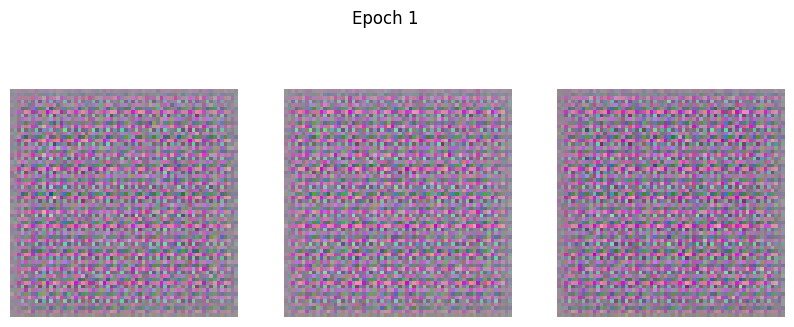

2/2 ━━━━━━━━━━━━━━━━━━━━ 23s 9s/step - d_loss: 0.6822 - g_loss: 0.6905
Epoch 2/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.5696 - g_loss: 0.6704

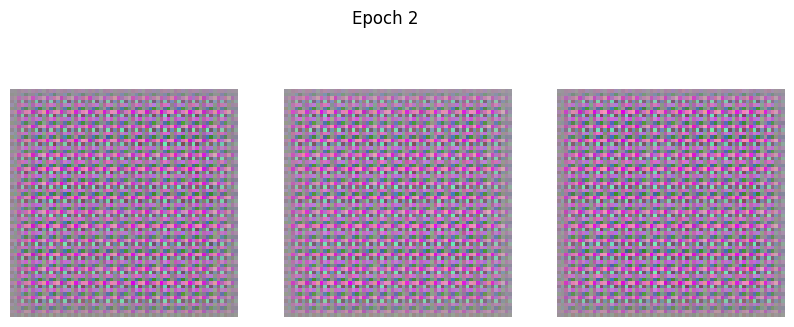

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.5653 - g_loss: 0.6681
Epoch 3/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - d_loss: 0.4923 - g_loss: 0.5742

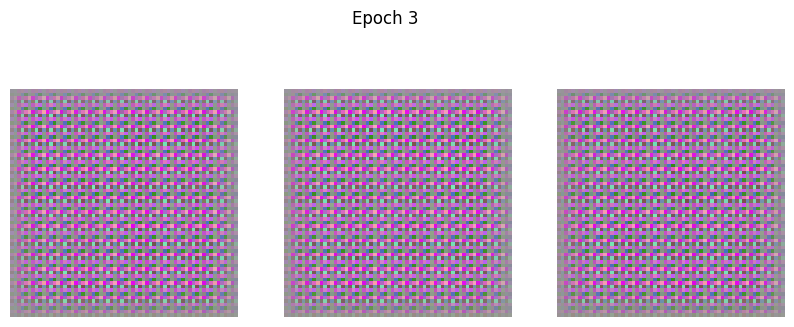

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step - d_loss: 0.4939 - g_loss: 0.5686
Epoch 4/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5588 - g_loss: 0.5145 

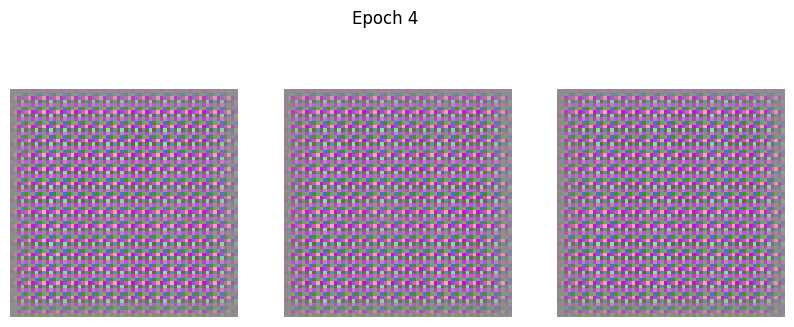

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - d_loss: 0.5601 - g_loss: 0.5186
Epoch 5/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.4769 - g_loss: 0.6851 

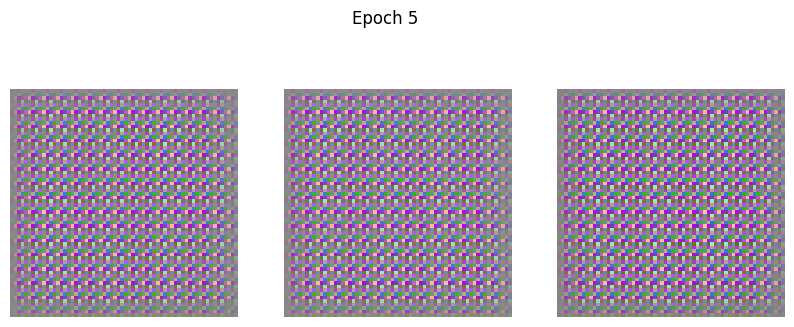

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - d_loss: 0.4696 - g_loss: 0.6942
Epoch 6/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3366 - g_loss: 0.8759 

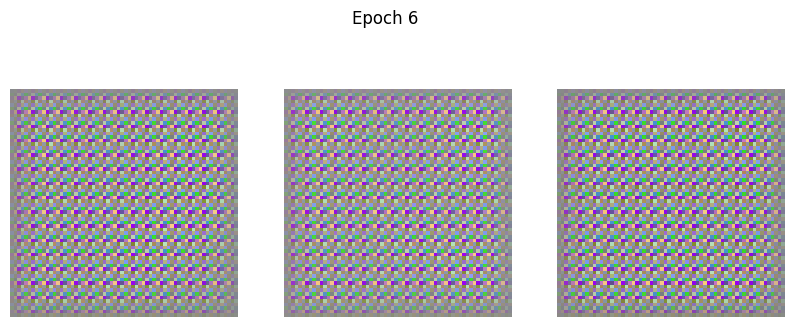

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - d_loss: 0.3324 - g_loss: 0.8822
Epoch 7/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - d_loss: 0.2616 - g_loss: 0.9815 

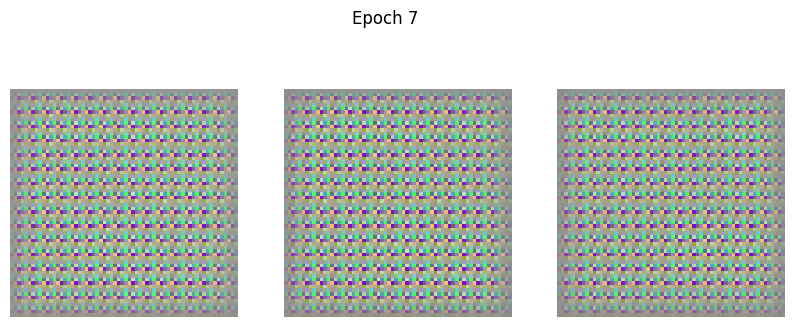

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - d_loss: 0.2602 - g_loss: 0.9829
Epoch 8/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2582 - g_loss: 0.9229 

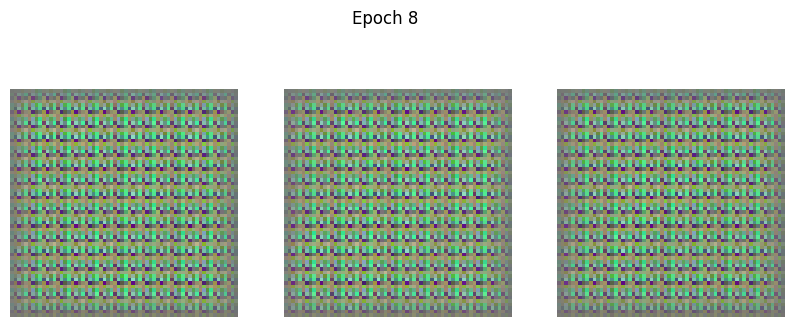

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step - d_loss: 0.2587 - g_loss: 0.9179
Epoch 9/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.2880 - g_loss: 0.7970 

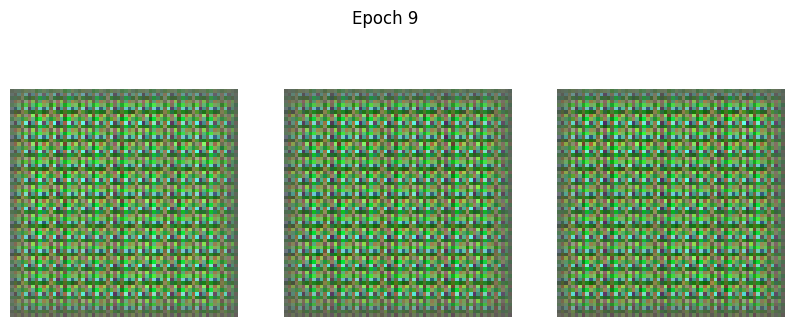

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - d_loss: 0.2919 - g_loss: 0.7916
Epoch 10/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - d_loss: 0.4902 - g_loss: 0.6147

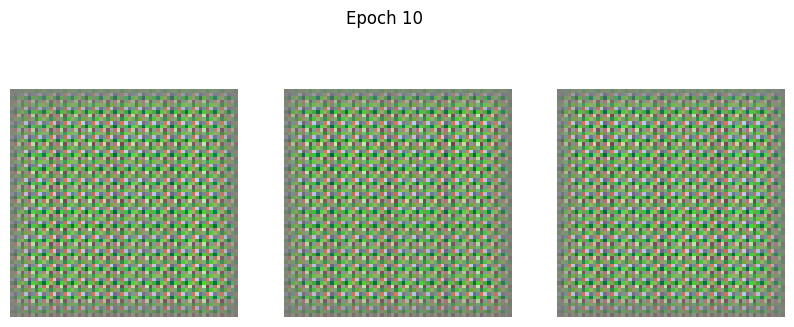

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.5057 - g_loss: 0.6064
Epoch 11/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.7194 - g_loss: 0.6647

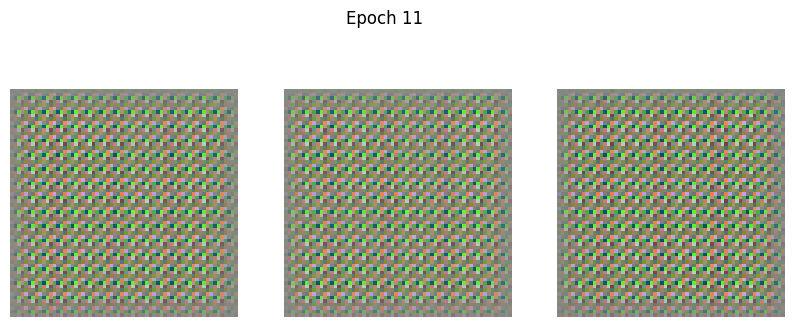

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.7123 - g_loss: 0.6880
Epoch 12/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - d_loss: 0.5386 - g_loss: 0.9395

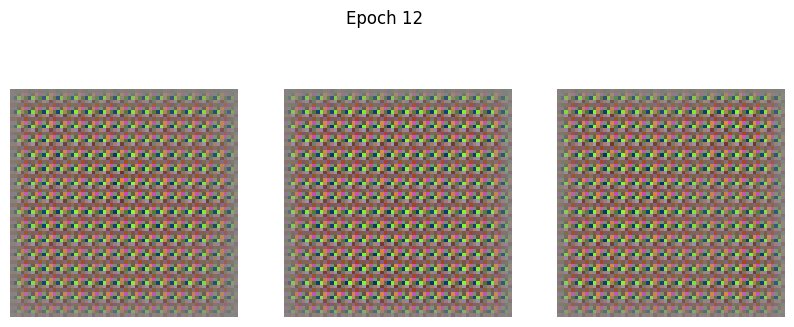

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - d_loss: 0.5370 - g_loss: 0.9303
Epoch 13/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5148 - g_loss: 0.8141 

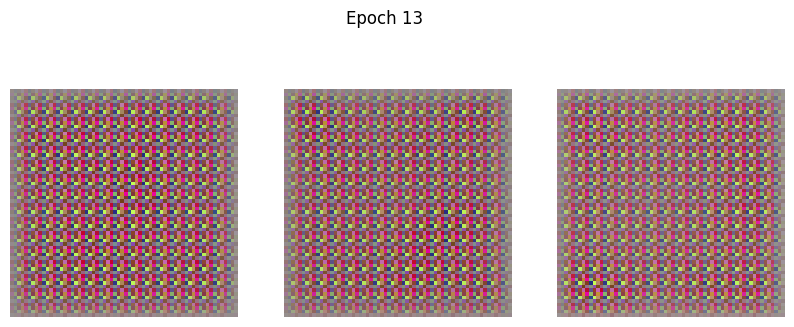

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - d_loss: 0.5136 - g_loss: 0.8144
Epoch 14/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - d_loss: 0.4955 - g_loss: 0.9056 

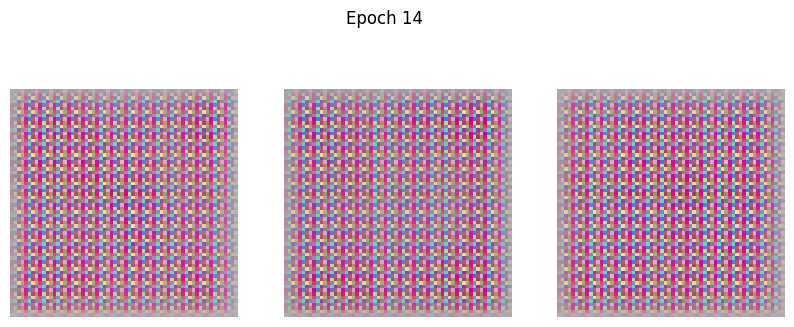

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - d_loss: 0.4923 - g_loss: 0.9132
Epoch 15/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.4297 - g_loss: 0.9755

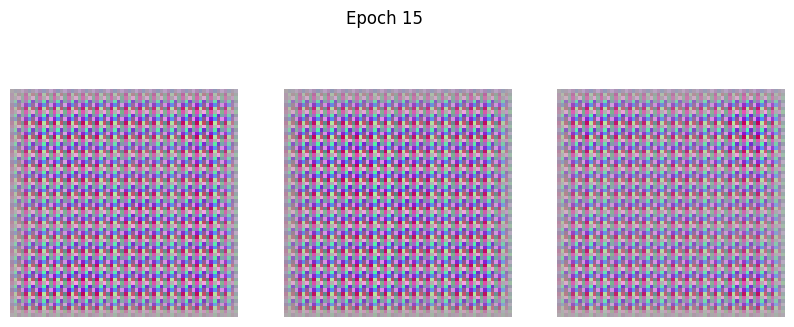

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.4284 - g_loss: 0.9767
Epoch 16/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.4248 - g_loss: 0.9917 

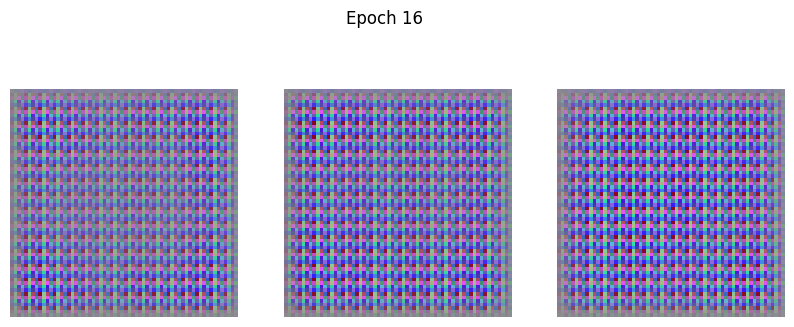

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - d_loss: 0.4242 - g_loss: 0.9931
Epoch 17/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - d_loss: 0.3961 - g_loss: 0.9665

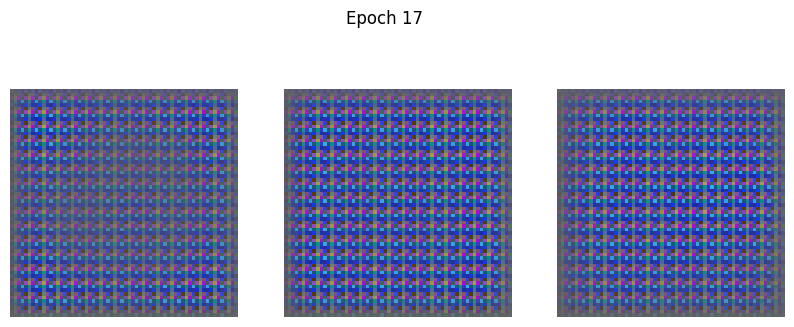

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.3951 - g_loss: 0.9636
Epoch 18/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.3789 - g_loss: 0.9204 

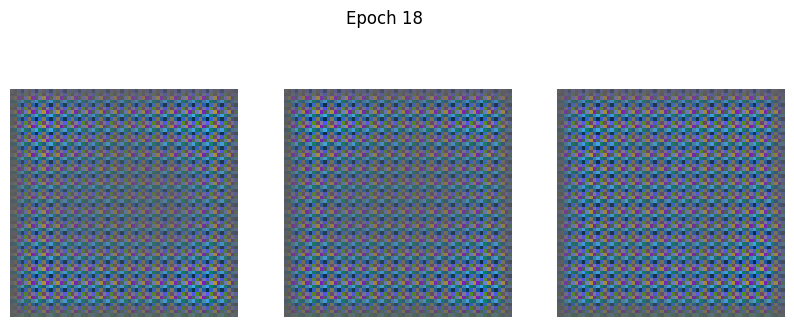

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - d_loss: 0.3775 - g_loss: 0.9222
Epoch 19/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3636 - g_loss: 0.9713 

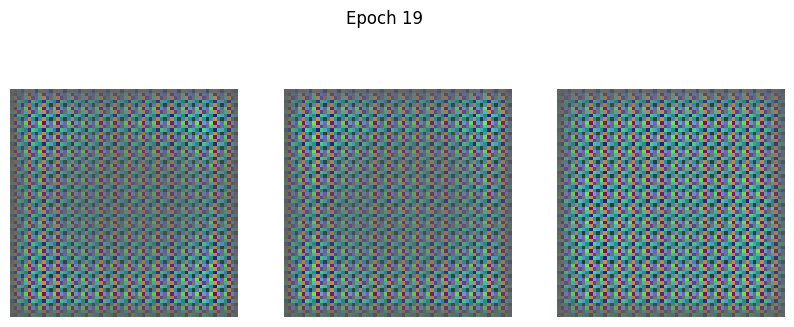

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step - d_loss: 0.3608 - g_loss: 0.9730
Epoch 20/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.3237 - g_loss: 0.9825

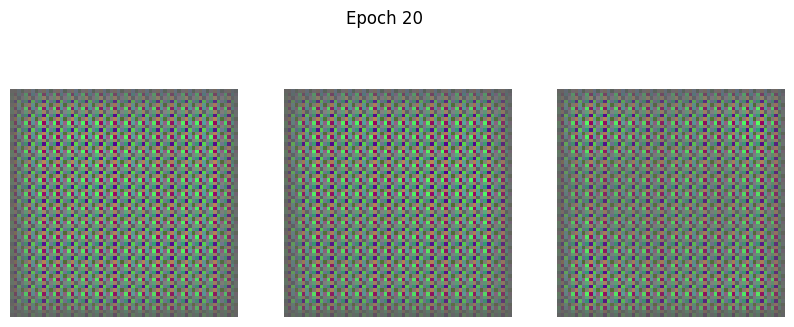

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step - d_loss: 0.3209 - g_loss: 0.9827
Epoch 21/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - d_loss: 0.2928 - g_loss: 0.9859 

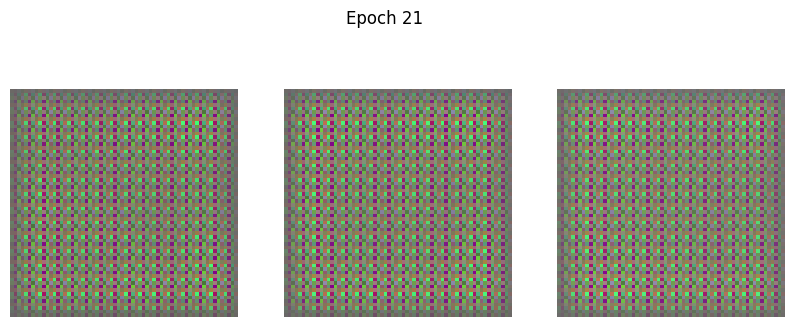

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - d_loss: 0.2932 - g_loss: 0.9836
Epoch 22/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.3266 - g_loss: 1.0086

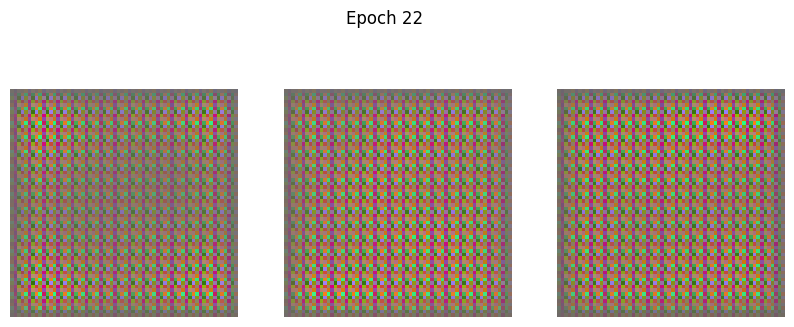

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step - d_loss: 0.3236 - g_loss: 1.0100
Epoch 23/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.2903 - g_loss: 1.1792 

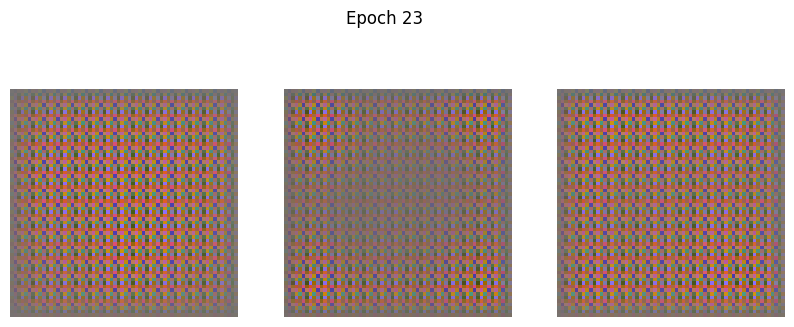

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - d_loss: 0.2870 - g_loss: 1.1909
Epoch 24/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - d_loss: 0.2150 - g_loss: 1.2962 

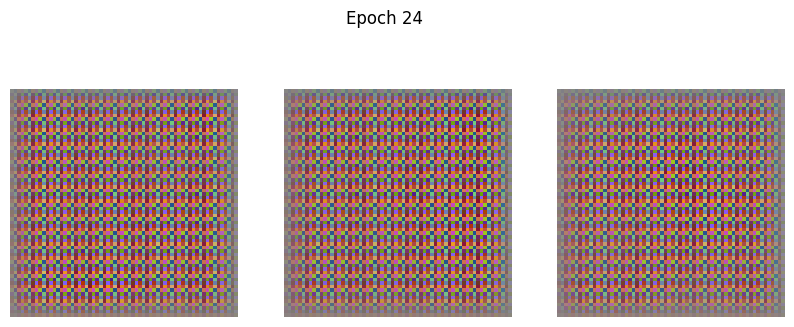

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - d_loss: 0.2153 - g_loss: 1.2892
Epoch 25/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.3095 - g_loss: 0.9579 

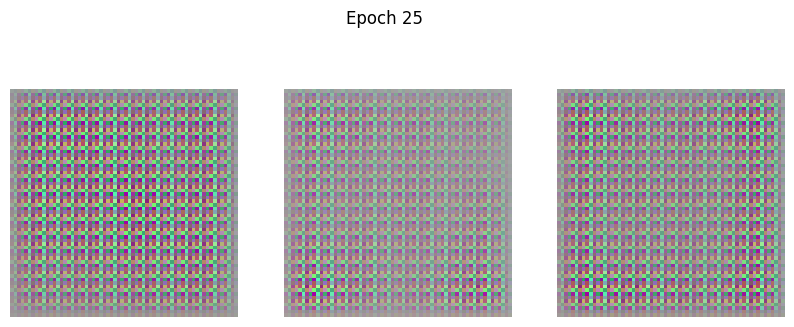

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - d_loss: 0.3170 - g_loss: 0.9470
Epoch 26/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.6048 - g_loss: 1.0996 

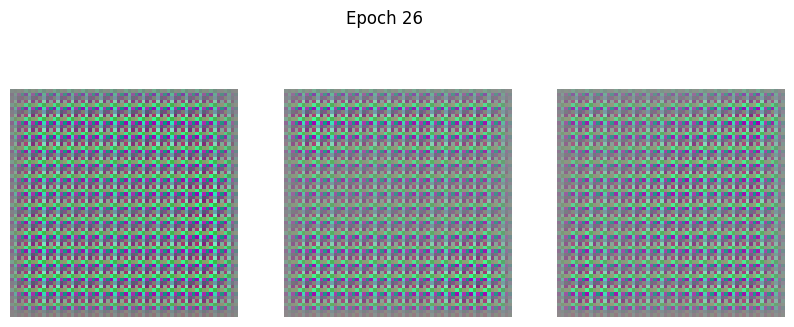

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step - d_loss: 0.6041 - g_loss: 1.1392
Epoch 27/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.3863 - g_loss: 1.9140 

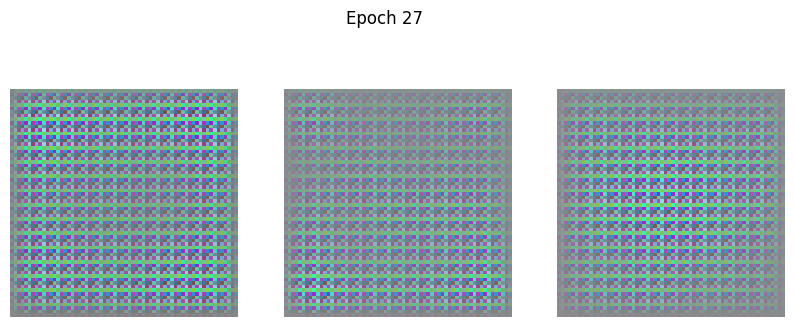

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - d_loss: 0.3828 - g_loss: 1.9746
Epoch 28/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.1642 - g_loss: 2.5808

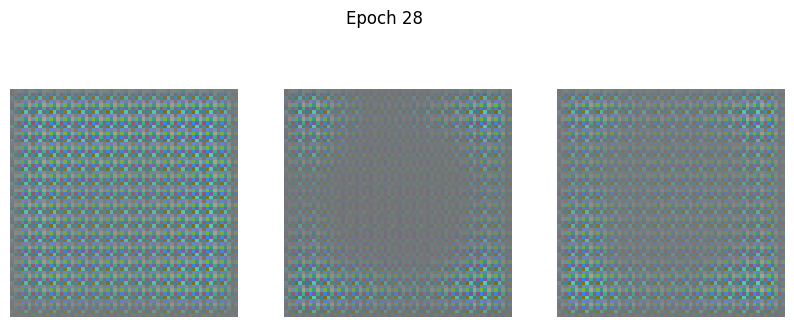

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step - d_loss: 0.1620 - g_loss: 2.5300
Epoch 29/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2133 - g_loss: 1.6012 

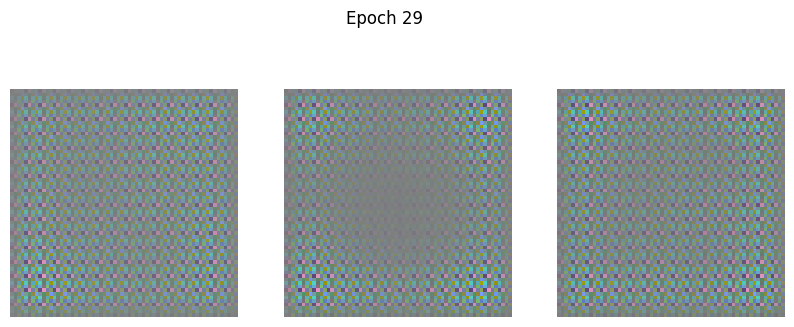

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - d_loss: 0.2186 - g_loss: 1.5999
Epoch 30/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.2963 - g_loss: 1.6537 

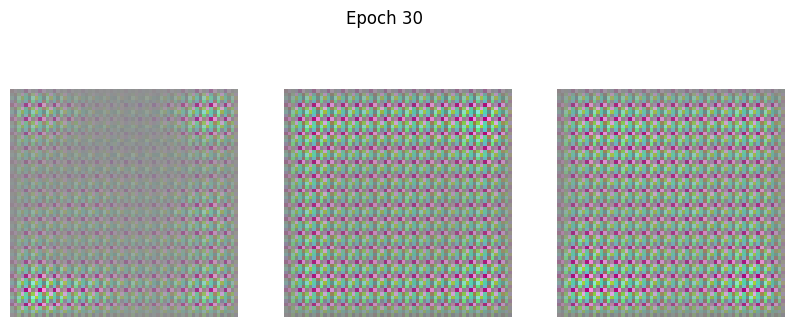

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step - d_loss: 0.2928 - g_loss: 1.6452
Epoch 31/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.4508 - g_loss: 1.3692 

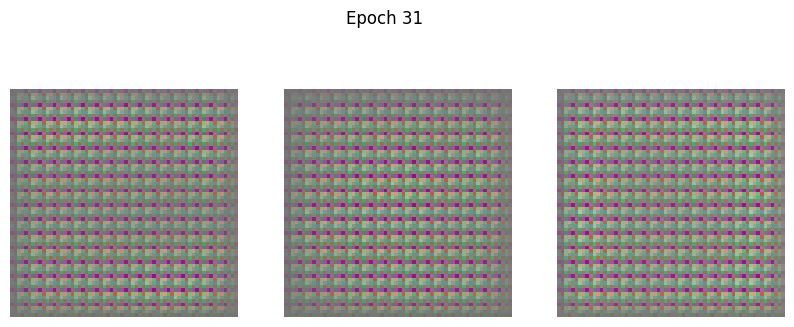

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step - d_loss: 0.4807 - g_loss: 1.3834
Epoch 32/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.7599 - g_loss: 1.5647

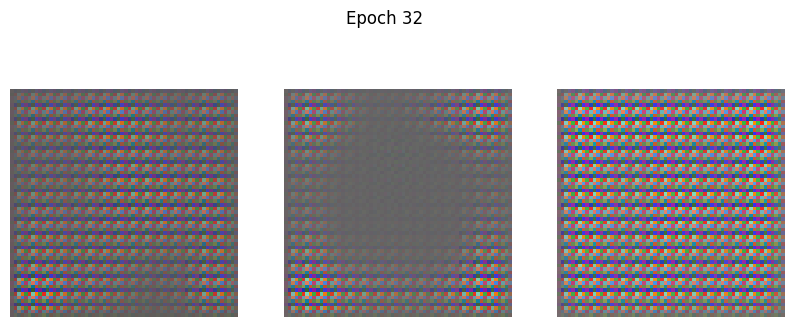

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step - d_loss: 0.7691 - g_loss: 1.6686
Epoch 33/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.4214 - g_loss: 2.2563 

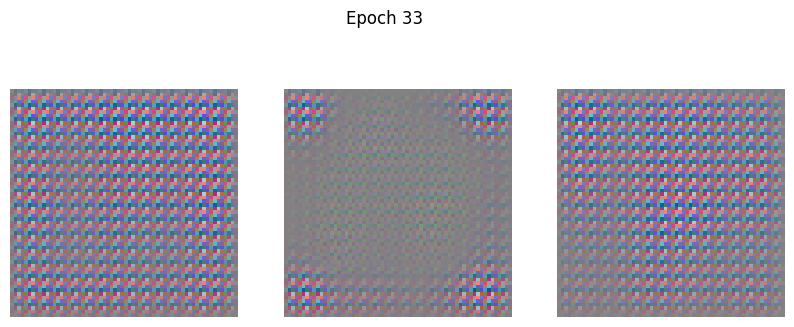

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step - d_loss: 0.4111 - g_loss: 2.2768
Epoch 34/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.4507 - g_loss: 2.5844 

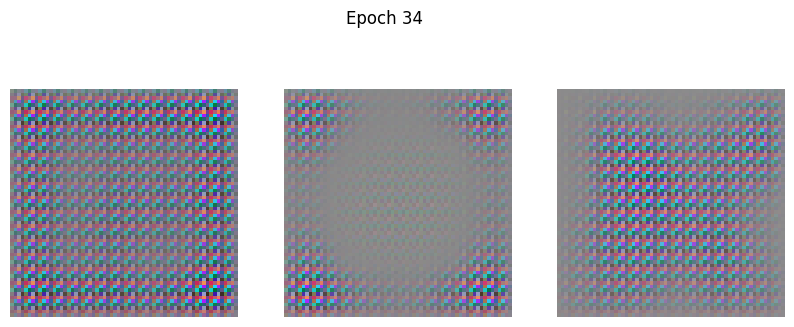

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step - d_loss: 0.4468 - g_loss: 2.5344
Epoch 35/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3778 - g_loss: 2.0667 

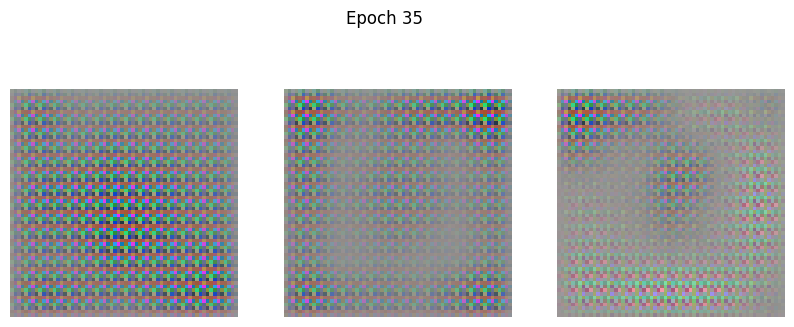

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 196ms/step - d_loss: 0.3802 - g_loss: 2.1239
Epoch 36/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.3108 - g_loss: 2.4753 

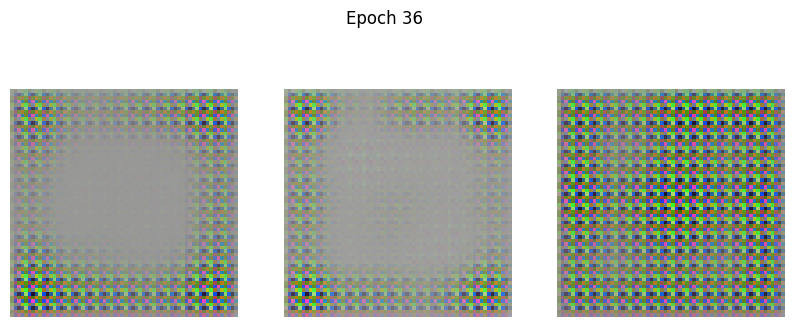

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.3099 - g_loss: 2.4417
Epoch 37/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.4274 - g_loss: 2.7702 

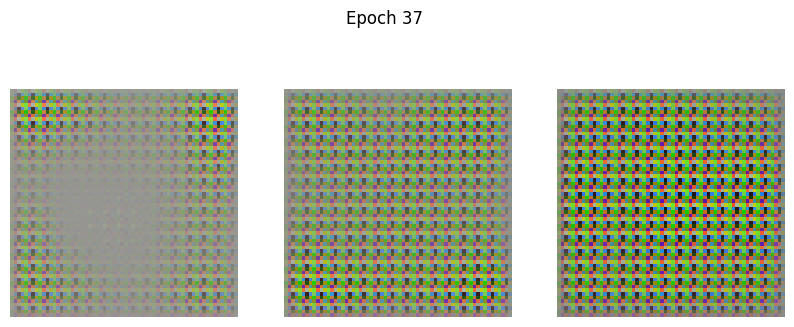

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 144ms/step - d_loss: 0.4149 - g_loss: 2.7551
Epoch 38/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.3384 - g_loss: 2.1006

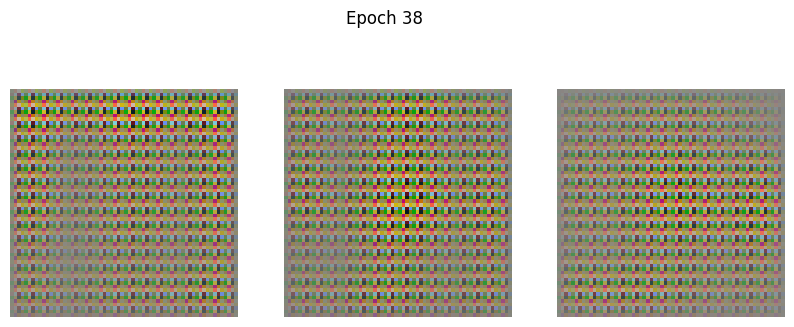

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step - d_loss: 0.3375 - g_loss: 2.0755
Epoch 39/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.3385 - g_loss: 1.8851

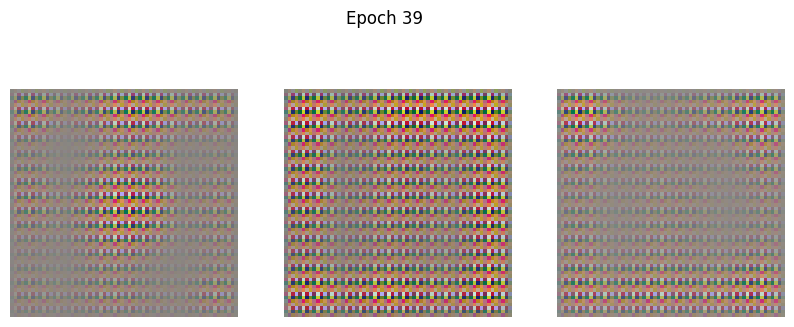

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step - d_loss: 0.3418 - g_loss: 1.8834
Epoch 40/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.3414 - g_loss: 1.8814

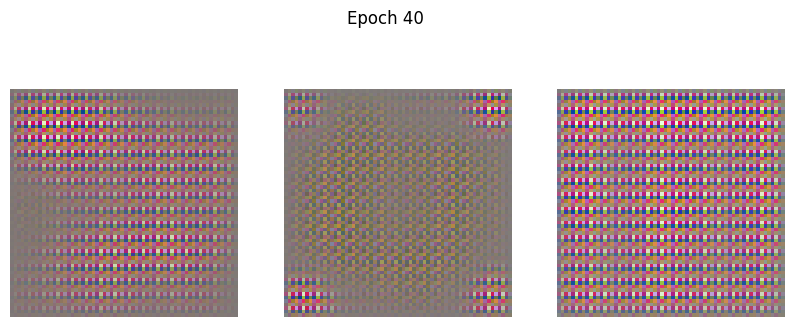

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step - d_loss: 0.3408 - g_loss: 1.9026
Epoch 41/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2769 - g_loss: 1.8616

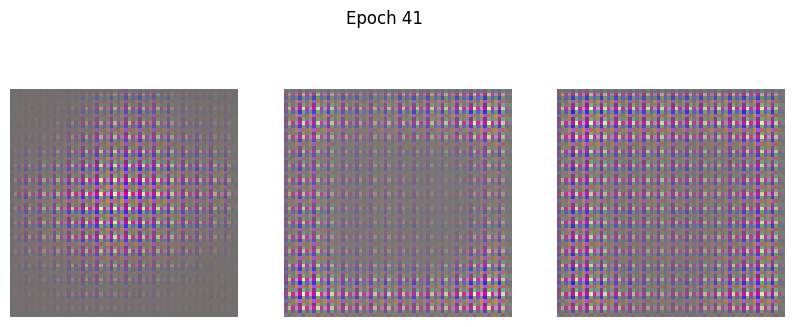

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - d_loss: 0.2987 - g_loss: 1.9045
Epoch 42/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.2653 - g_loss: 2.4023

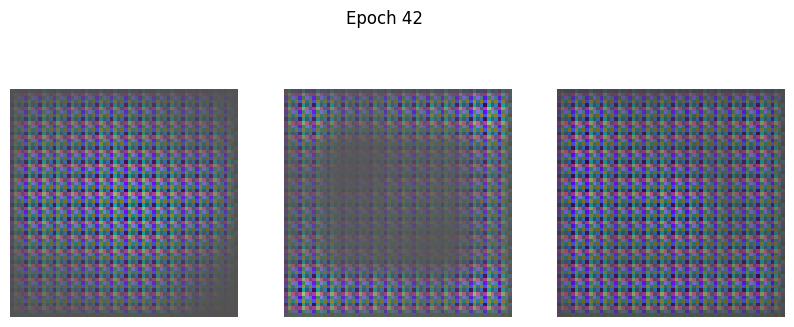

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.2673 - g_loss: 2.3877
Epoch 43/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2547 - g_loss: 1.8697 

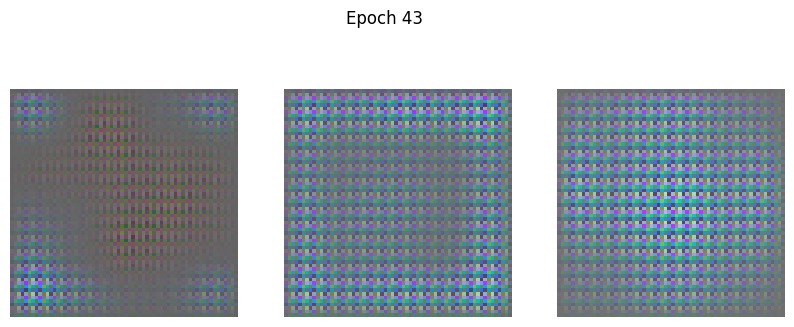

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - d_loss: 0.2624 - g_loss: 1.8674
Epoch 44/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.3354 - g_loss: 2.1748

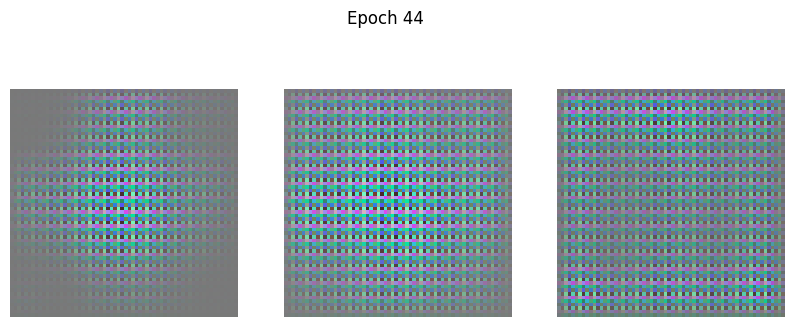

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.3261 - g_loss: 2.1585
Epoch 45/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.2352 - g_loss: 2.2580

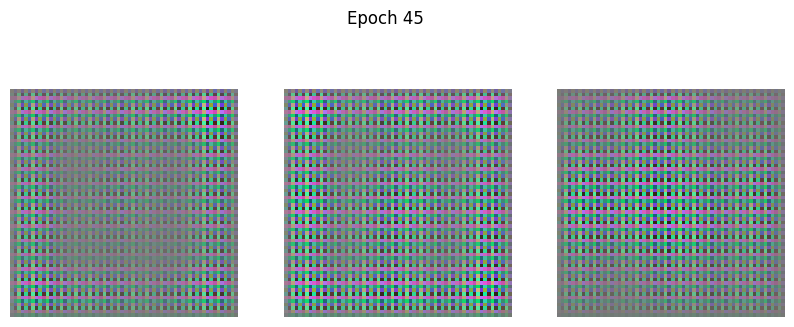

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step - d_loss: 0.2351 - g_loss: 2.2823
Epoch 46/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.1353 - g_loss: 2.4308

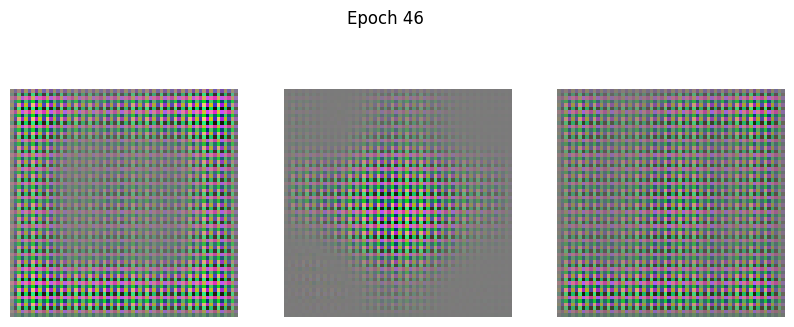

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step - d_loss: 0.1356 - g_loss: 2.4293
Epoch 47/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0870 - g_loss: 2.5991 

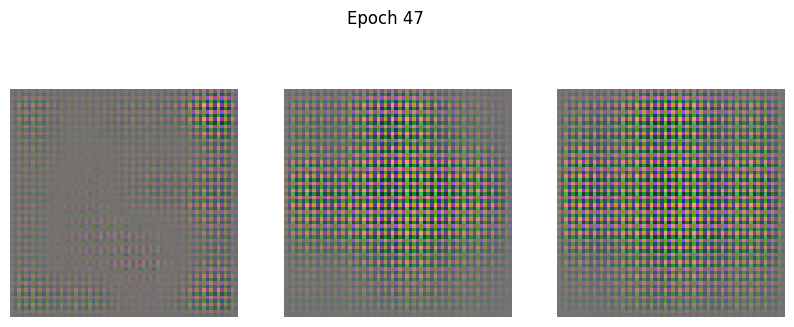

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - d_loss: 0.0837 - g_loss: 2.6068
Epoch 48/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0229 - g_loss: 2.6535

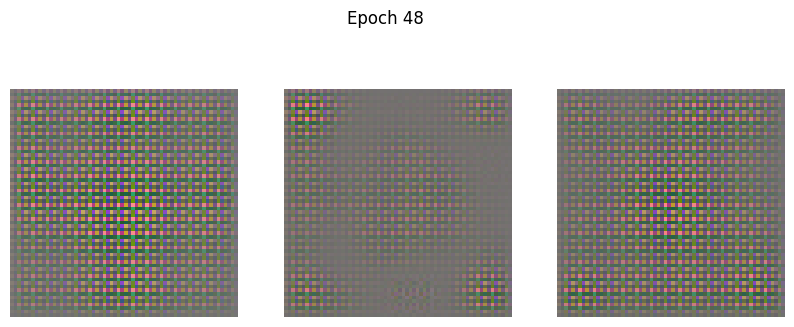

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.0242 - g_loss: 2.6355
Epoch 49/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0240 - g_loss: 2.4029 

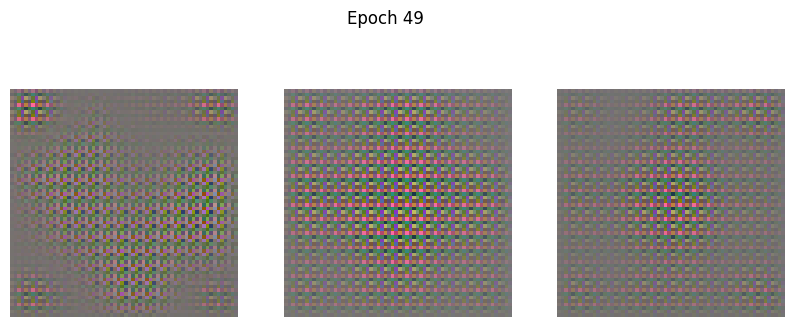

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step - d_loss: 0.0245 - g_loss: 2.3946
Epoch 50/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.0464 - g_loss: 2.2451

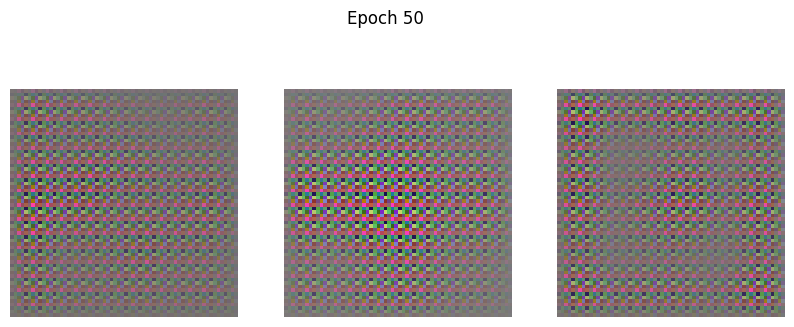

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step - d_loss: 0.0511 - g_loss: 2.2567
Epoch 51/500
1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - d_loss: 0.1074 - g_loss: 2.8987

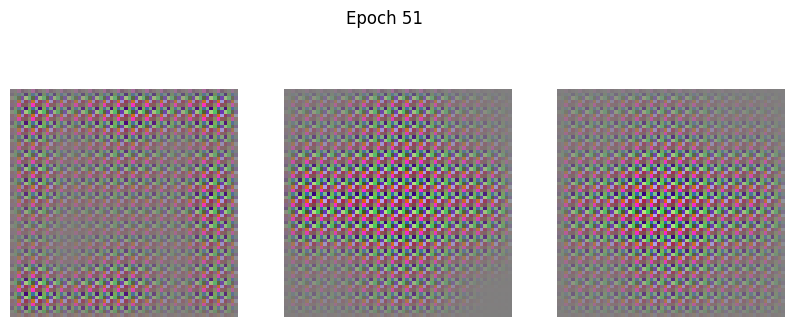

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - d_loss: 0.0828 - g_loss: 3.0950
Epoch 52/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0115 - g_loss: 3.6136     

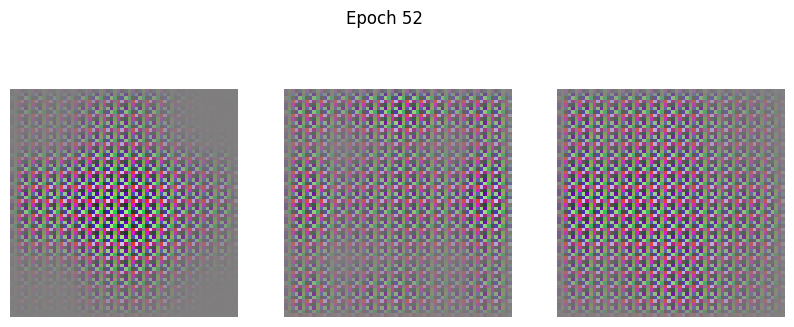

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0152 - g_loss: 3.6337
Epoch 53/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.0096 - g_loss: 3.5149 

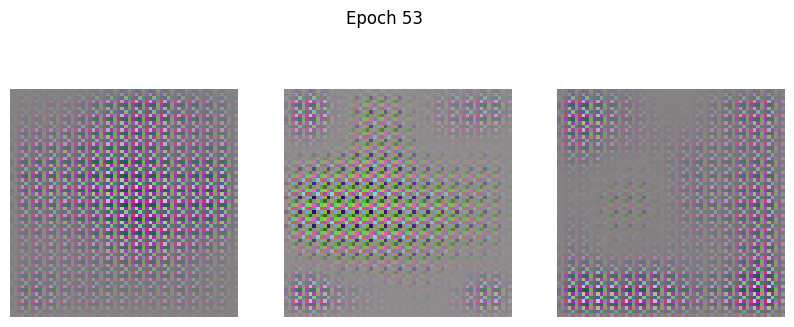

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0092 - g_loss: 3.4923
Epoch 54/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.0636 - g_loss: 3.6393 

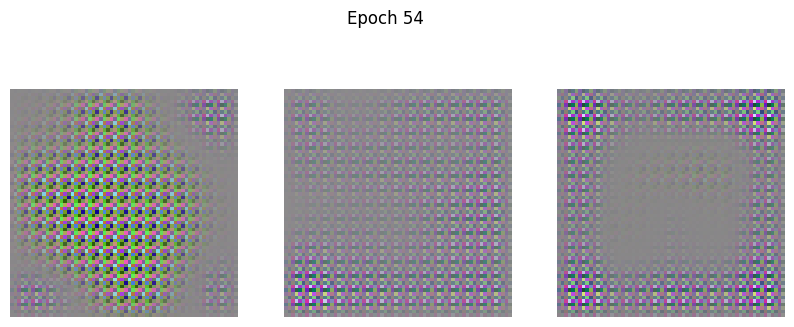

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - d_loss: 0.0618 - g_loss: 3.6750
Epoch 55/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0539 - g_loss: 4.0141

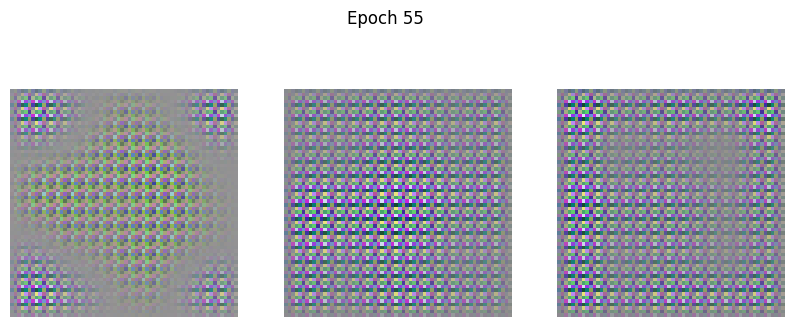

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0548 - g_loss: 3.9521
Epoch 56/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - d_loss: 0.1149 - g_loss: 3.8439

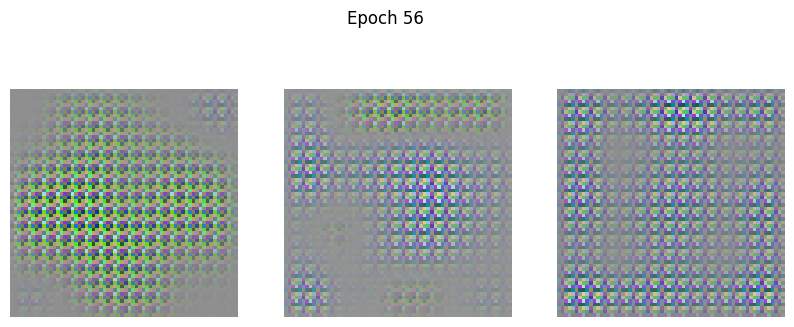

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.1128 - g_loss: 3.8336
Epoch 57/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.1501 - g_loss: 3.4726

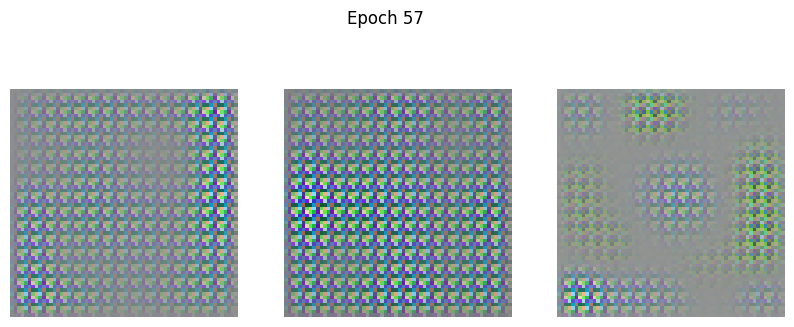

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1609 - g_loss: 3.5268
Epoch 58/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1591 - g_loss: 3.3278 

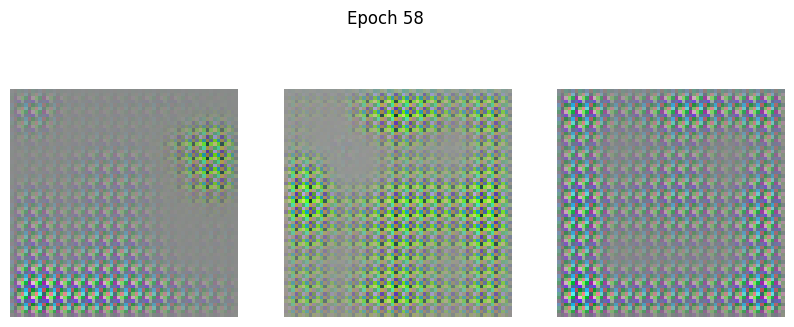

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 493ms/step - d_loss: 0.1525 - g_loss: 3.2727
Epoch 59/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2244 - g_loss: 3.6524 

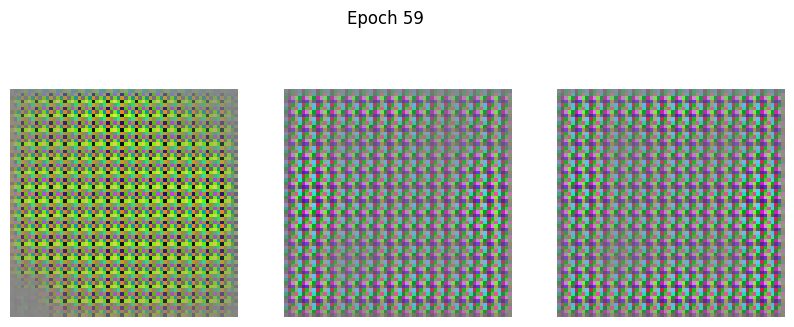

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - d_loss: 0.2187 - g_loss: 3.6815
Epoch 60/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.1513 - g_loss: 3.5650

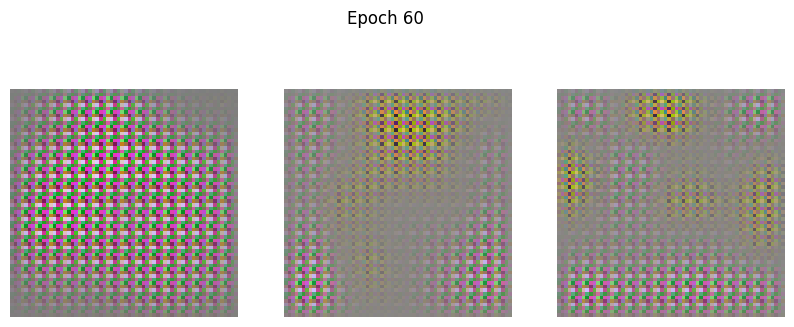

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1513 - g_loss: 3.5344
Epoch 61/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.3328 - g_loss: 3.7727

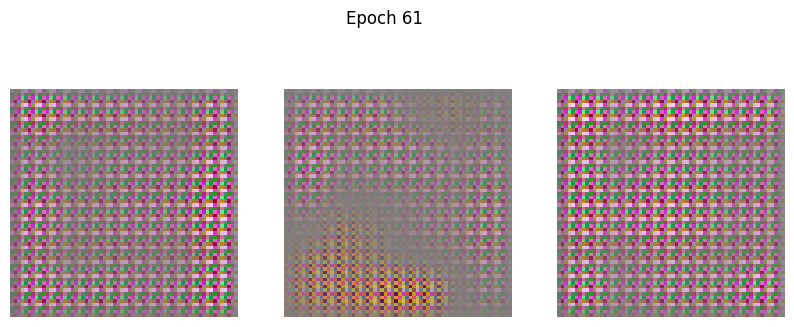

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.3353 - g_loss: 3.6423
Epoch 62/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.5198 - g_loss: 5.7469

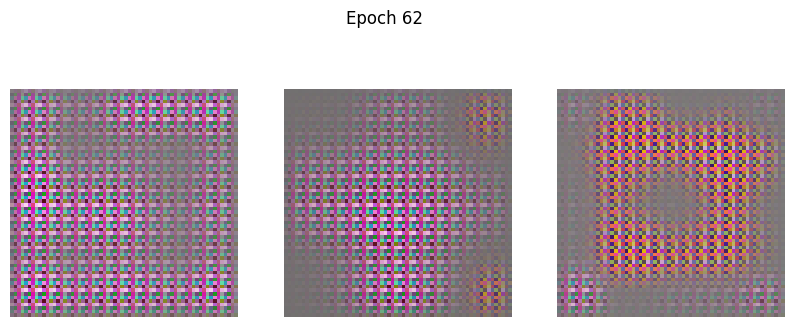

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - d_loss: 0.4732 - g_loss: 5.8058
Epoch 63/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - d_loss: 0.1535 - g_loss: 4.3336

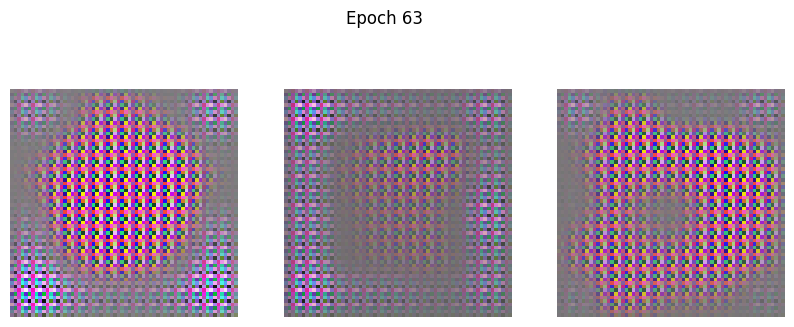

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step - d_loss: 0.1711 - g_loss: 4.4234
Epoch 64/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.2152 - g_loss: 4.1947 

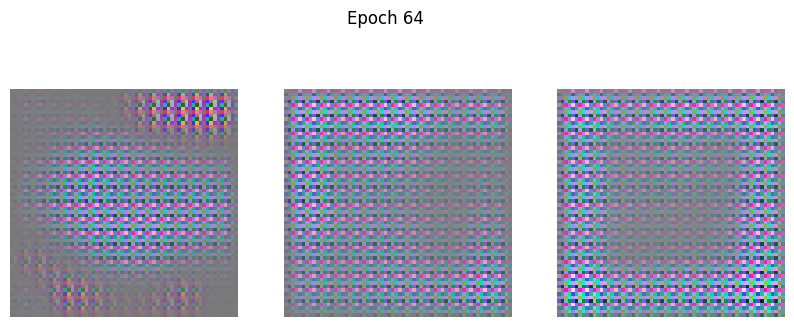

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step - d_loss: 0.2190 - g_loss: 4.1899
Epoch 65/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.3138 - g_loss: 4.8918 

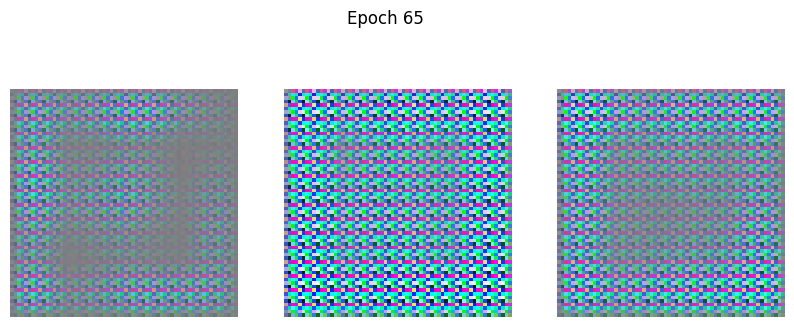

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.3165 - g_loss: 4.9101
Epoch 66/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.3213 - g_loss: 5.6482

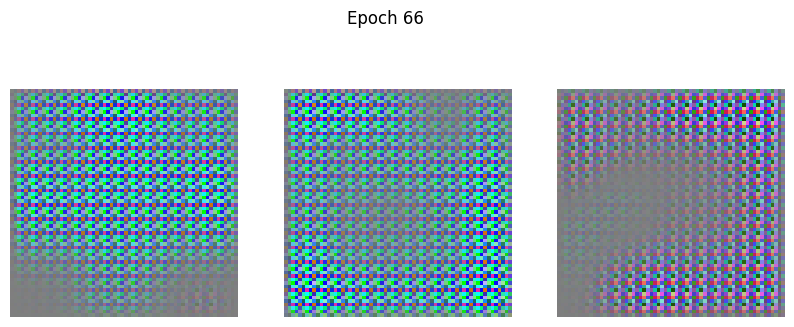

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step - d_loss: 0.3170 - g_loss: 5.5090
Epoch 67/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2768 - g_loss: 5.3491

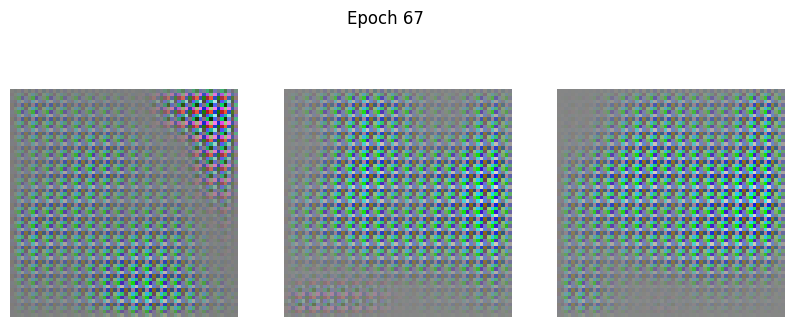

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.2731 - g_loss: 5.5139
Epoch 68/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.3774 - g_loss: 4.0438

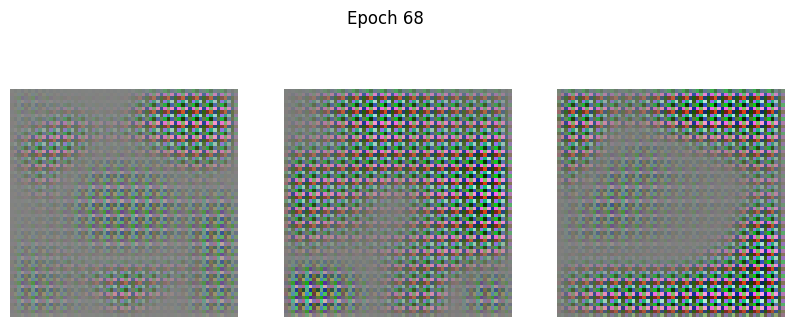

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.4088 - g_loss: 4.2271
Epoch 69/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.3379 - g_loss: 4.9849

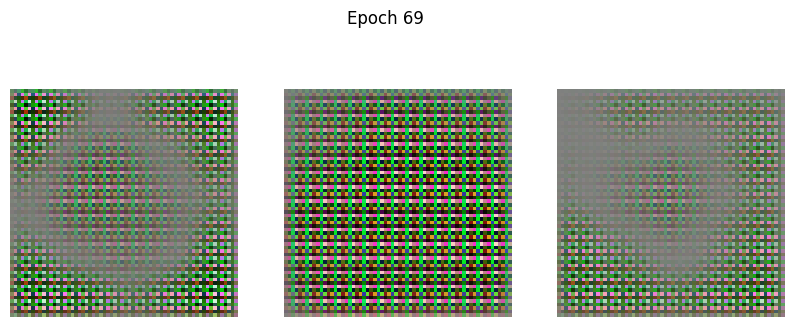

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.3415 - g_loss: 4.9337
Epoch 70/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1531 - g_loss: 5.0980

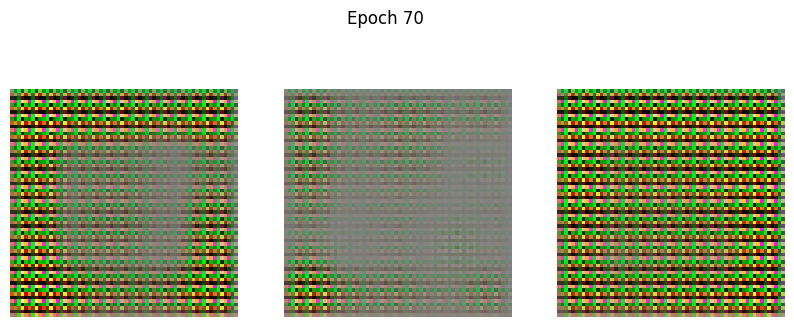

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1487 - g_loss: 5.1318
Epoch 71/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0614 - g_loss: 5.4103

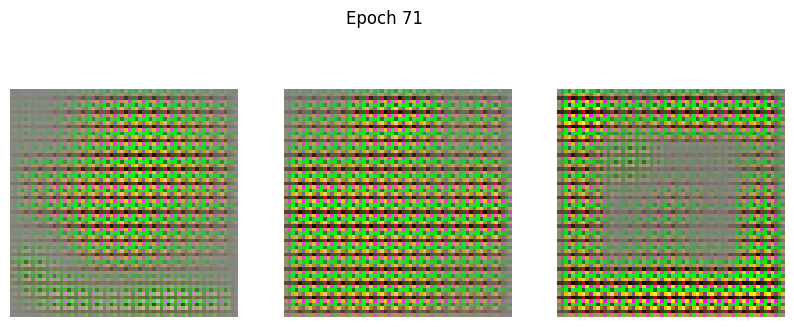

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step - d_loss: 0.0642 - g_loss: 5.4762
Epoch 72/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1101 - g_loss: 6.7256

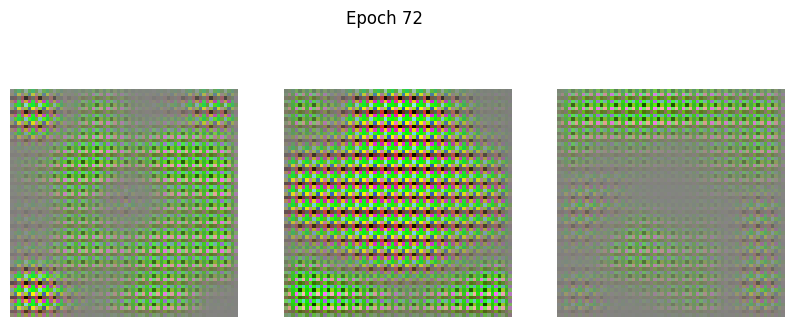

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 260ms/step - d_loss: 0.1136 - g_loss: 6.7424
Epoch 73/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2129 - g_loss: 6.1400 

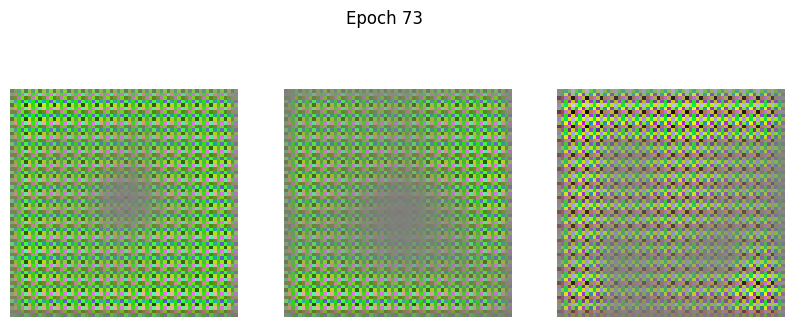

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - d_loss: 0.2282 - g_loss: 6.3748
Epoch 74/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5600 - g_loss: 3.6674 

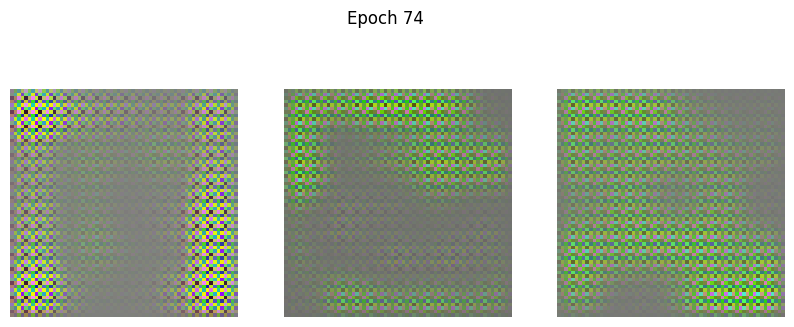

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.5879 - g_loss: 4.1489
Epoch 75/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0581 - g_loss: 8.0596 

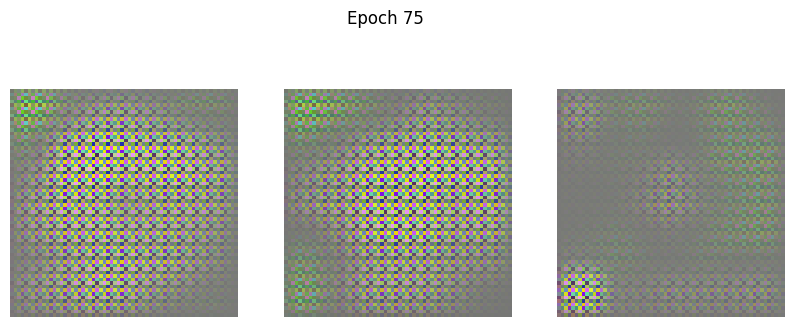

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.0586 - g_loss: 7.8946
Epoch 76/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1119 - g_loss: 3.9982 

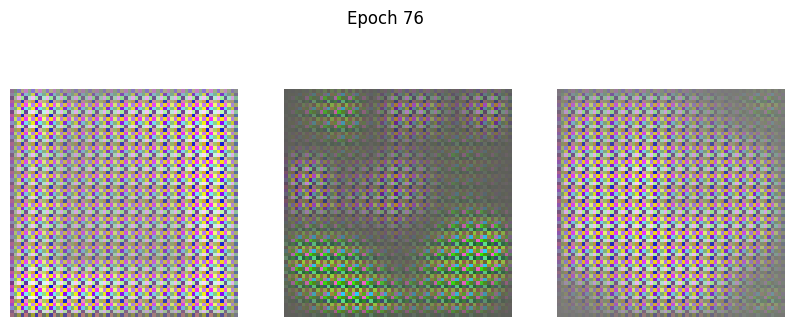

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.1366 - g_loss: 4.0109
Epoch 77/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.4029 - g_loss: 5.1560

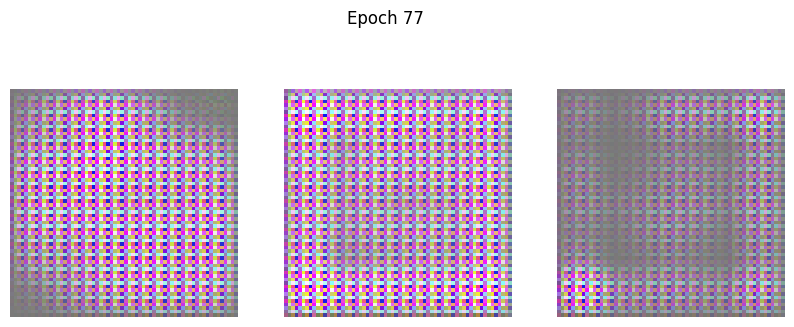

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step - d_loss: 0.4004 - g_loss: 4.9947
Epoch 78/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.3267 - g_loss: 4.8951 

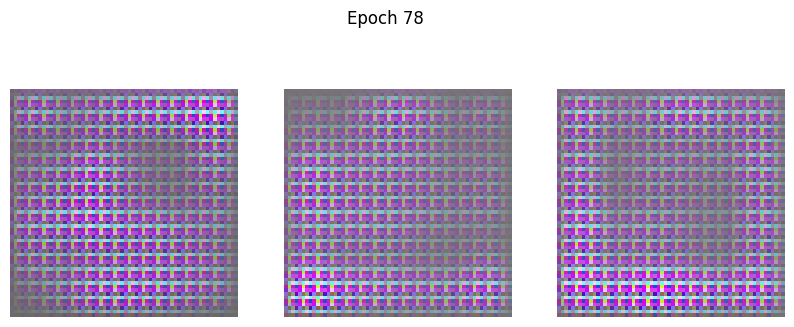

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 172ms/step - d_loss: 0.3079 - g_loss: 4.9746
Epoch 79/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.1184 - g_loss: 4.4253

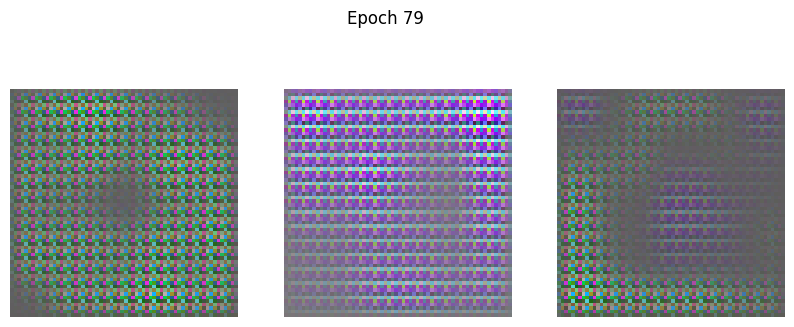

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1201 - g_loss: 4.3877
Epoch 80/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1577 - g_loss: 4.1733

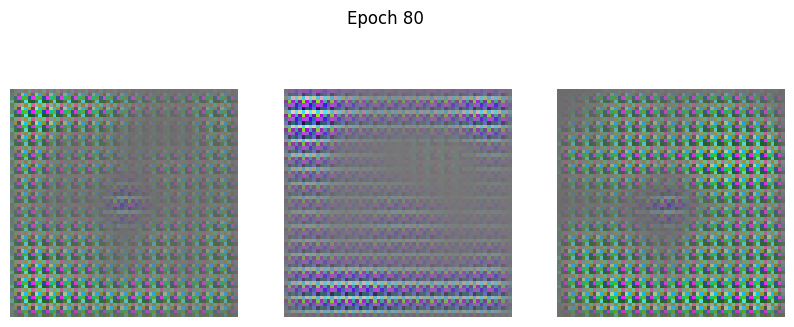

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1624 - g_loss: 4.2461
Epoch 81/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1232 - g_loss: 4.3454 

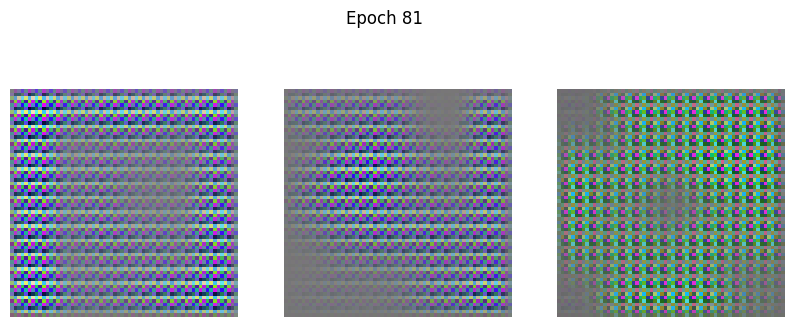

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - d_loss: 0.1217 - g_loss: 4.2848
Epoch 82/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1650 - g_loss: 4.4705 

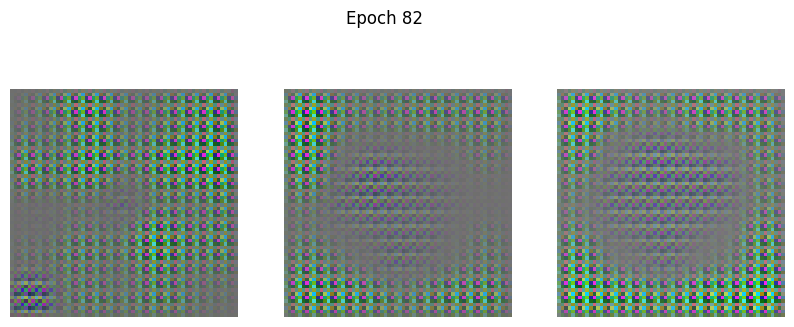

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1662 - g_loss: 4.5200
Epoch 83/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1589 - g_loss: 4.1199 

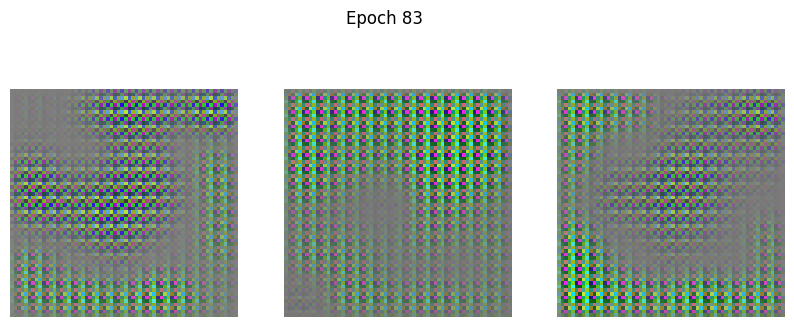

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1619 - g_loss: 4.2370
Epoch 84/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0946 - g_loss: 4.0738

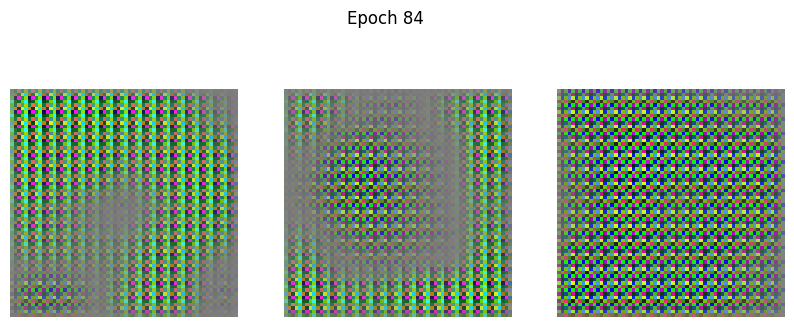

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.0958 - g_loss: 4.0375
Epoch 85/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.1033 - g_loss: 4.2912

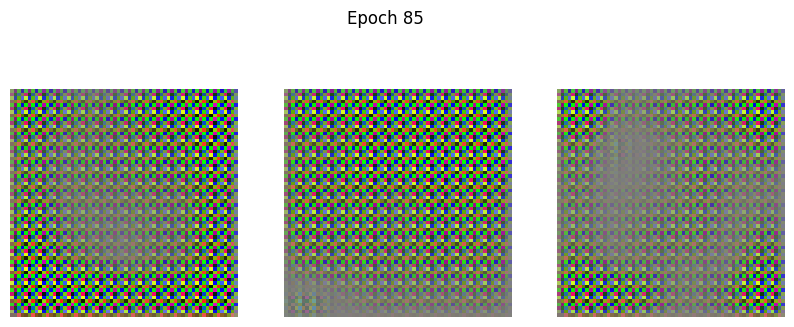

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0976 - g_loss: 4.2976
Epoch 86/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0647 - g_loss: 4.3363 

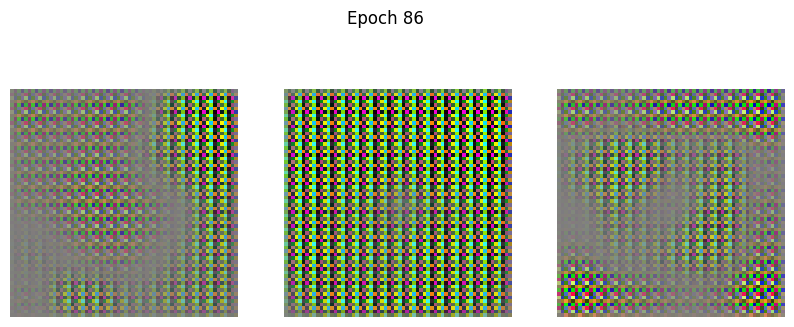

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.0680 - g_loss: 4.4289
Epoch 87/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0635 - g_loss: 4.9579

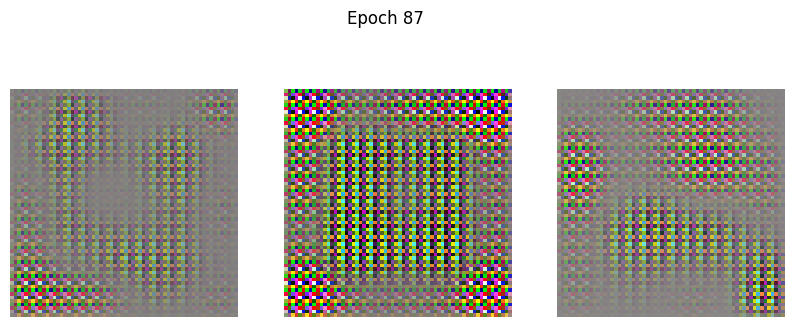

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.0684 - g_loss: 4.9779
Epoch 88/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0981 - g_loss: 6.0097 

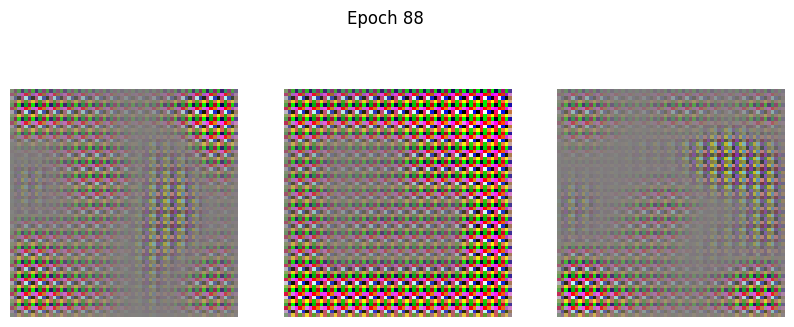

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0965 - g_loss: 6.0235
Epoch 89/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0932 - g_loss: 5.7387

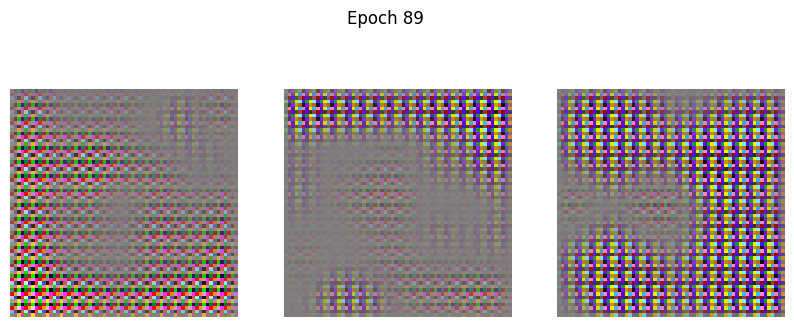

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.0982 - g_loss: 5.9617
Epoch 90/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.1886 - g_loss: 6.0599 

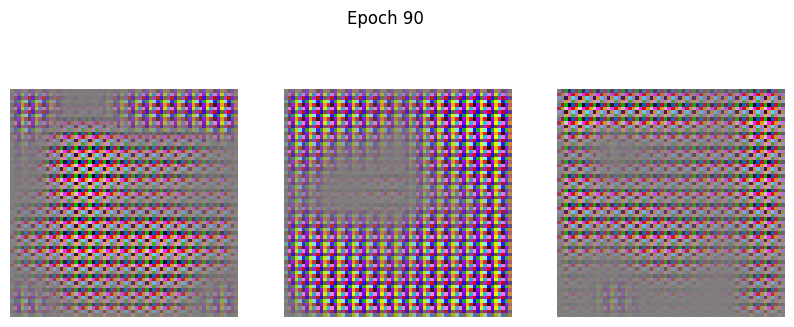

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.2021 - g_loss: 6.5958
Epoch 91/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.3057 - g_loss: 5.2309 

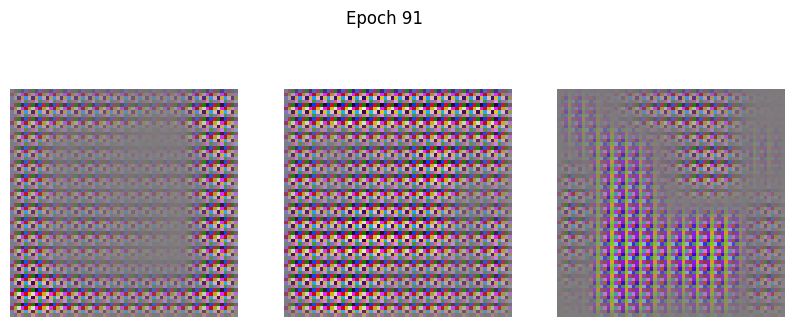

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - d_loss: 0.2896 - g_loss: 5.1338
Epoch 92/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.3102 - g_loss: 7.6340 

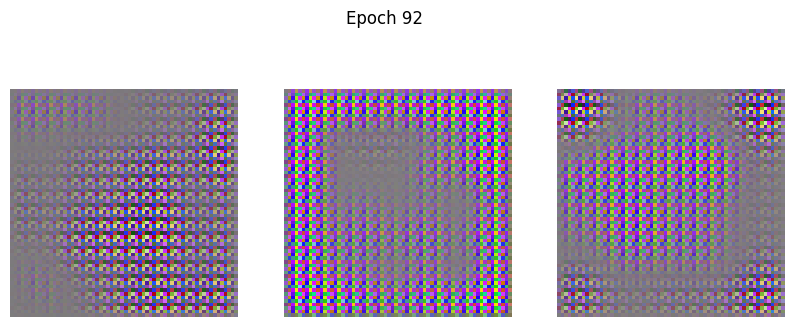

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.2995 - g_loss: 7.4411
Epoch 93/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1457 - g_loss: 3.6338 

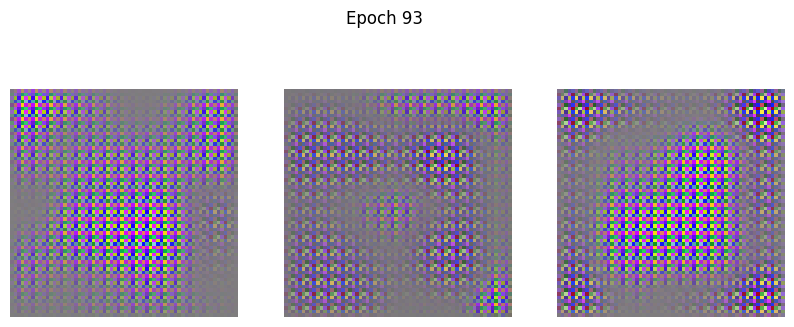

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1570 - g_loss: 3.8030
Epoch 94/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1038 - g_loss: 5.7004 

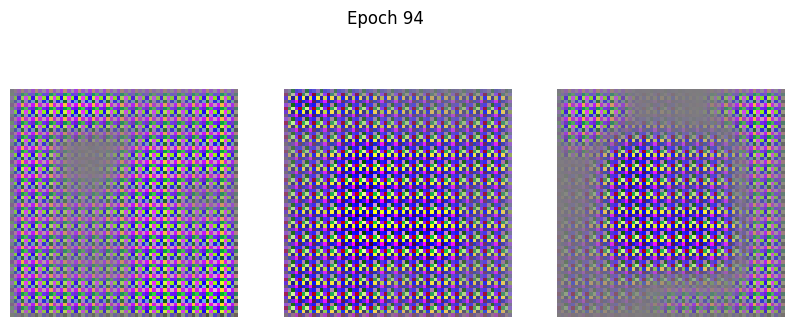

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1021 - g_loss: 5.5891
Epoch 95/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1127 - g_loss: 4.6630 

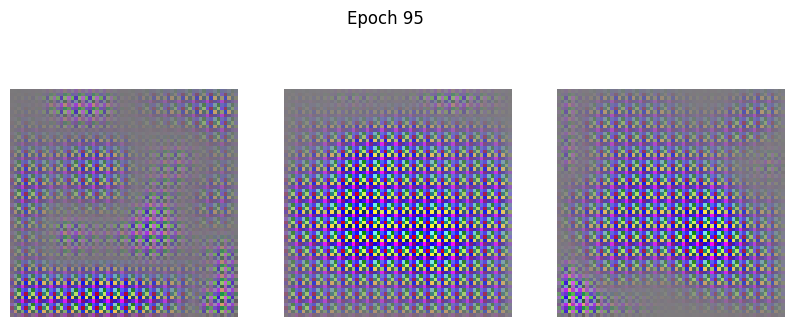

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - d_loss: 0.1144 - g_loss: 4.7135
Epoch 96/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.1185 - g_loss: 5.6219

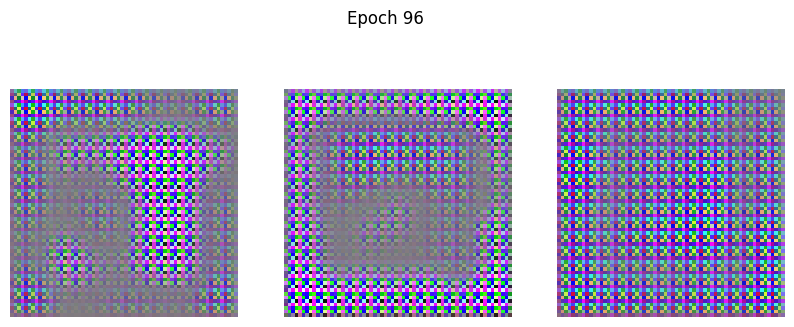

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1200 - g_loss: 5.4924
Epoch 97/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1877 - g_loss: 6.9246 

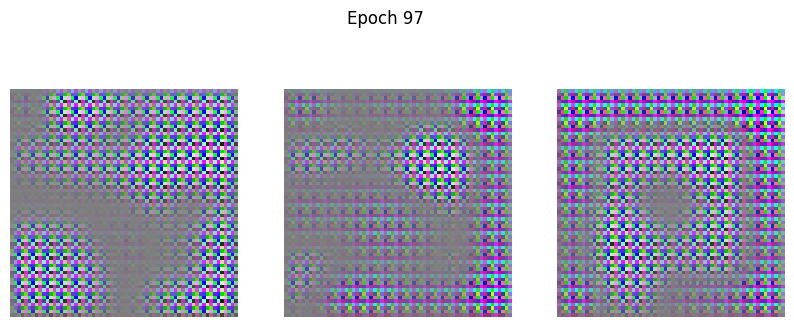

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1838 - g_loss: 6.7914
Epoch 98/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1602 - g_loss: 5.0630

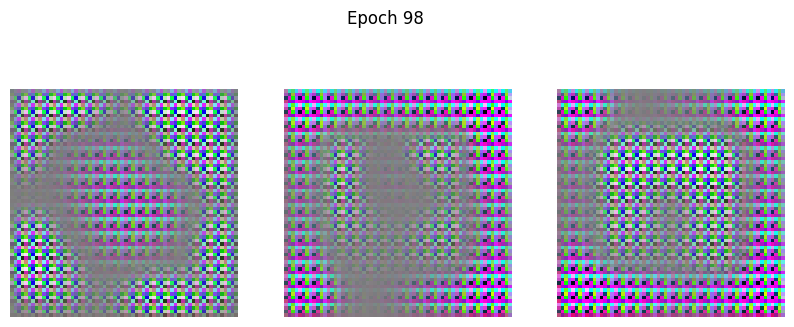

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1630 - g_loss: 5.1081
Epoch 99/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1258 - g_loss: 4.9387

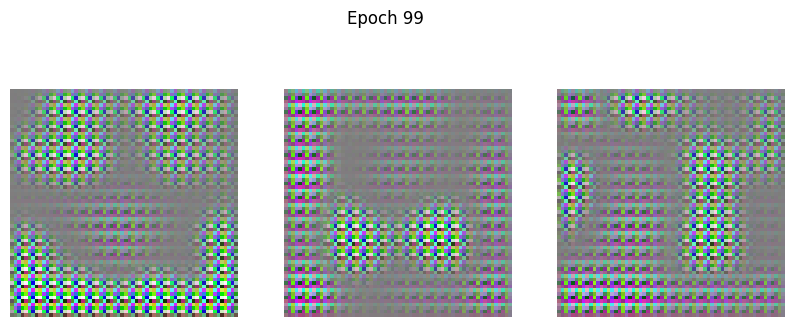

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1345 - g_loss: 5.0333
Epoch 100/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.2528 - g_loss: 4.2931 

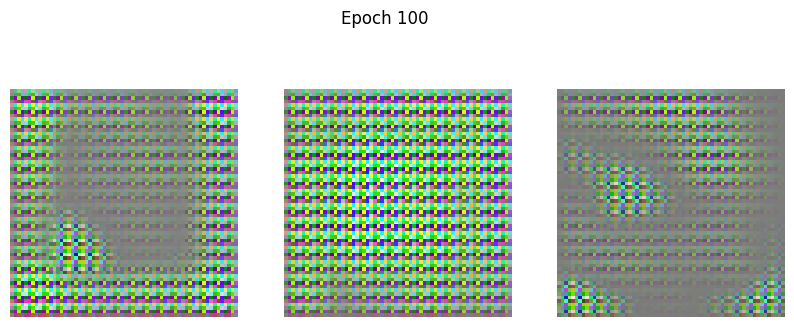

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.2685 - g_loss: 4.5039
Epoch 101/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.4361 - g_loss: 3.5803 

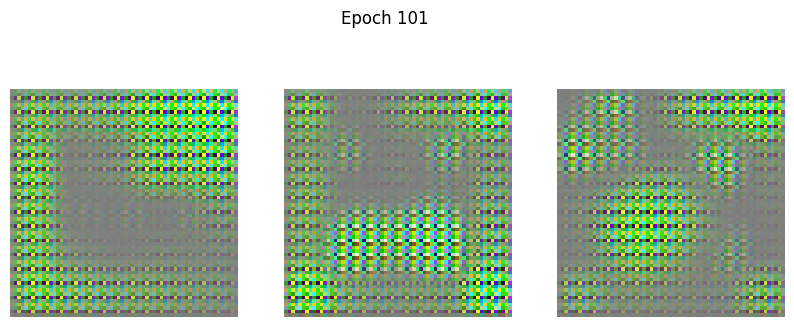

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.4583 - g_loss: 3.7372
Epoch 102/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.3676 - g_loss: 6.4274 

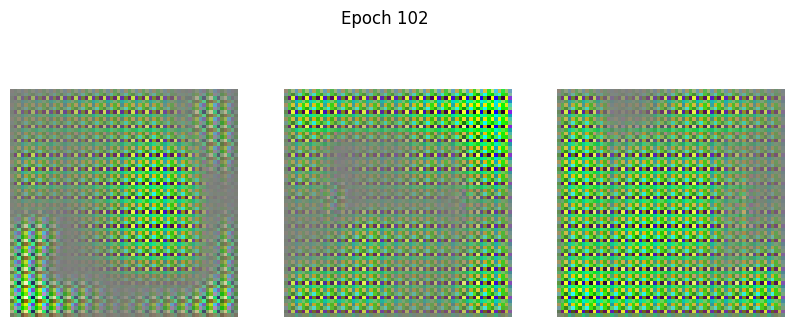

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.3492 - g_loss: 6.3142
Epoch 103/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0853 - g_loss: 4.3560 

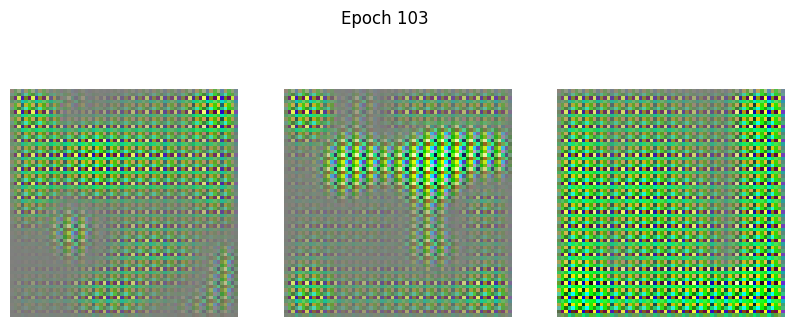

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0816 - g_loss: 4.3113
Epoch 104/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.0506 - g_loss: 4.4510 

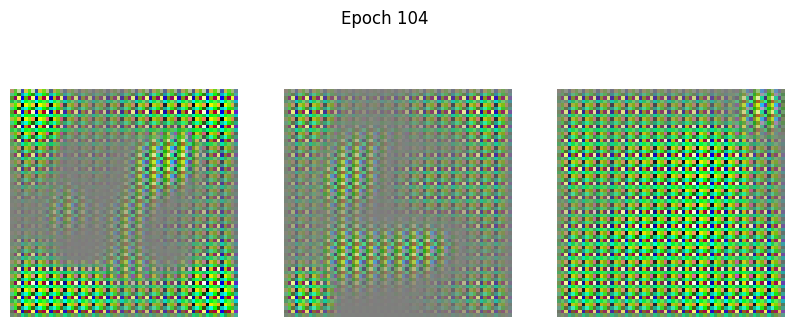

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - d_loss: 0.0467 - g_loss: 4.4564
Epoch 105/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0665 - g_loss: 4.6808 

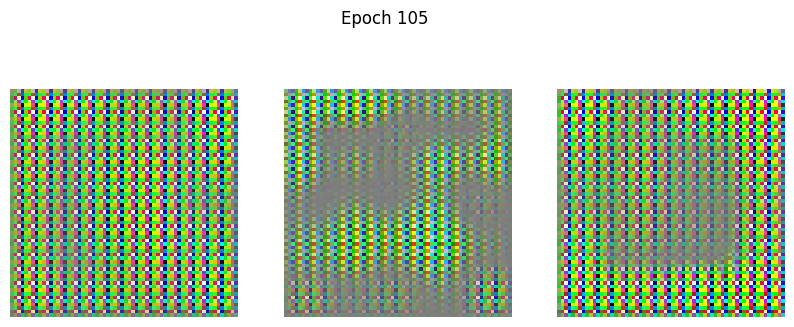

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - d_loss: 0.0679 - g_loss: 4.7215
Epoch 106/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1453 - g_loss: 5.9004

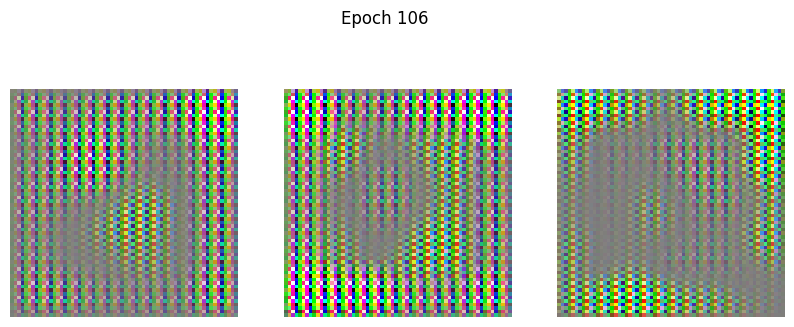

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1436 - g_loss: 5.7599
Epoch 107/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1217 - g_loss: 4.5670 

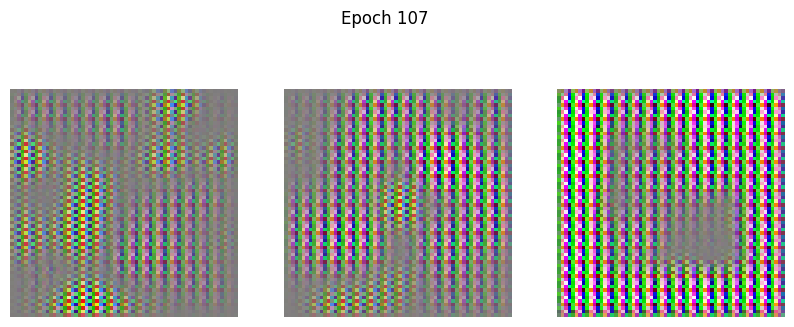

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - d_loss: 0.1259 - g_loss: 4.7274
Epoch 108/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1114 - g_loss: 4.8957 

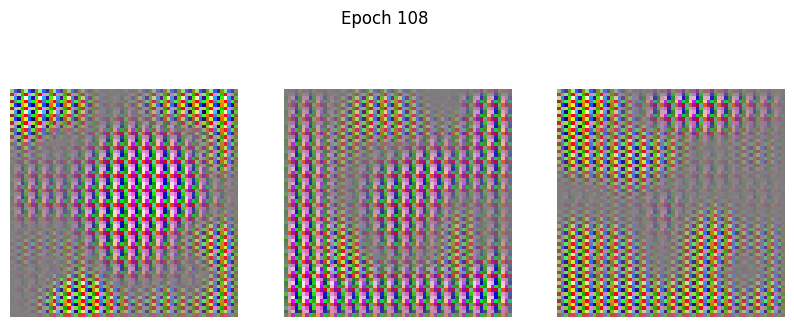

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1111 - g_loss: 4.8763
Epoch 109/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.1358 - g_loss: 6.3885

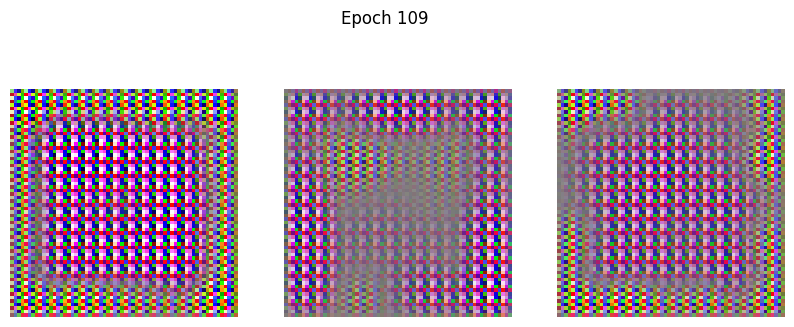

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1358 - g_loss: 6.2177
Epoch 110/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.3125 - g_loss: 9.0480

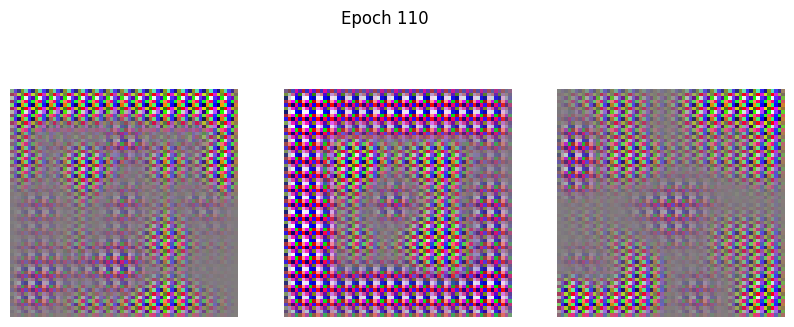

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.3263 - g_loss: 8.5296
Epoch 111/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1788 - g_loss: 7.7884 

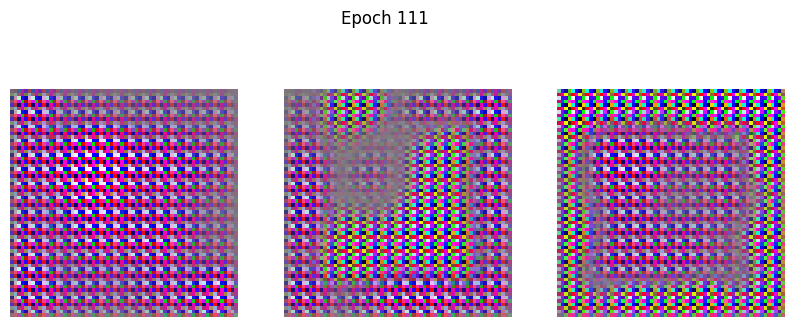

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step - d_loss: 0.1682 - g_loss: 7.8708
Epoch 112/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0533 - g_loss: 5.9801

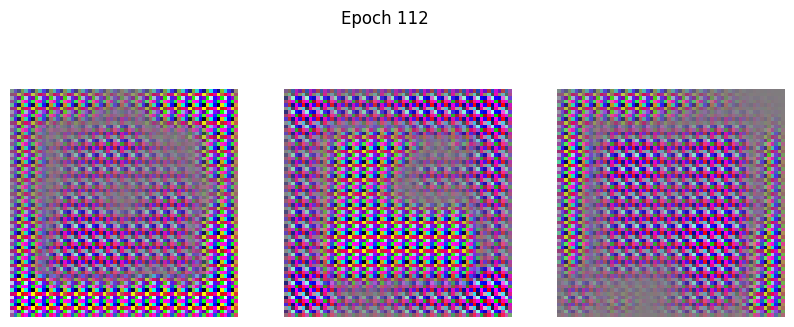

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 273ms/step - d_loss: 0.0519 - g_loss: 5.7915
Epoch 113/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2610 - g_loss: 10.9834 

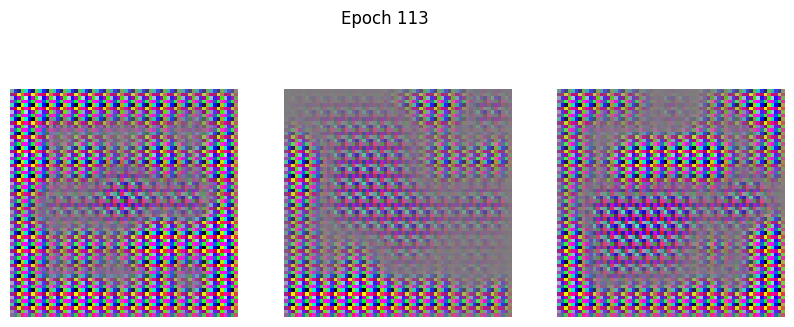

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step - d_loss: 0.2582 - g_loss: 10.8327
Epoch 114/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1004 - g_loss: 5.2373

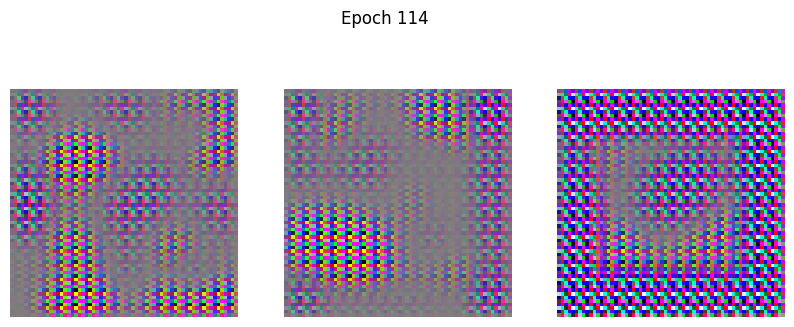

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step - d_loss: 0.1045 - g_loss: 5.2880
Epoch 115/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0619 - g_loss: 6.3178 

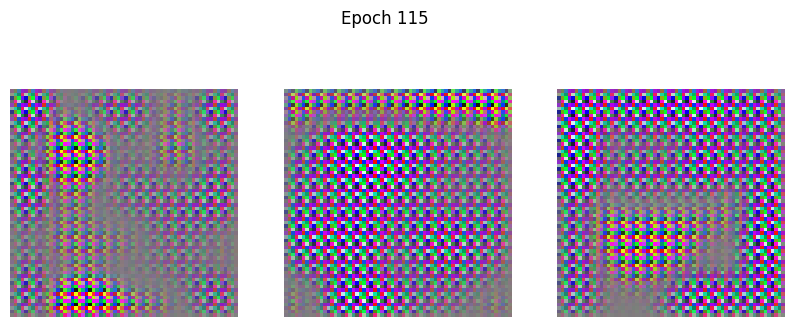

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step - d_loss: 0.0614 - g_loss: 6.2040
Epoch 116/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1740 - g_loss: 7.1807

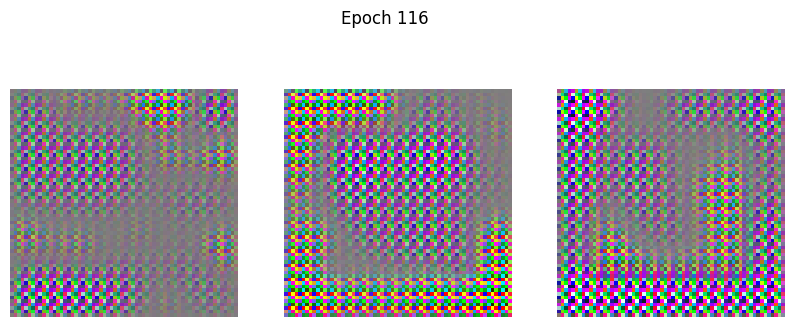

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 251ms/step - d_loss: 0.1771 - g_loss: 6.8113
Epoch 117/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.8441 - g_loss: 8.1856 

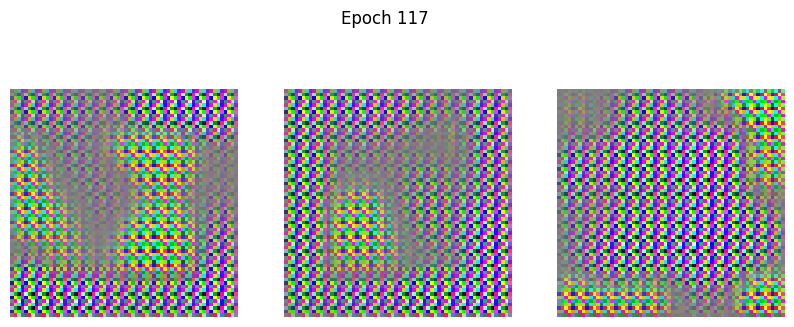

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 168ms/step - d_loss: 0.8237 - g_loss: 7.6235
Epoch 118/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.5656 - g_loss: 8.5658

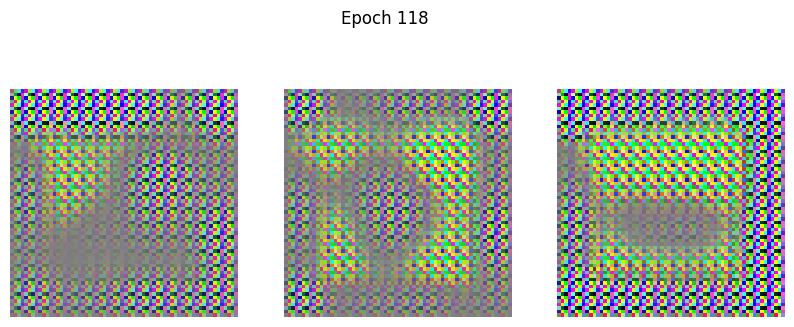

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.5207 - g_loss: 8.6998
Epoch 119/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1374 - g_loss: 5.7187

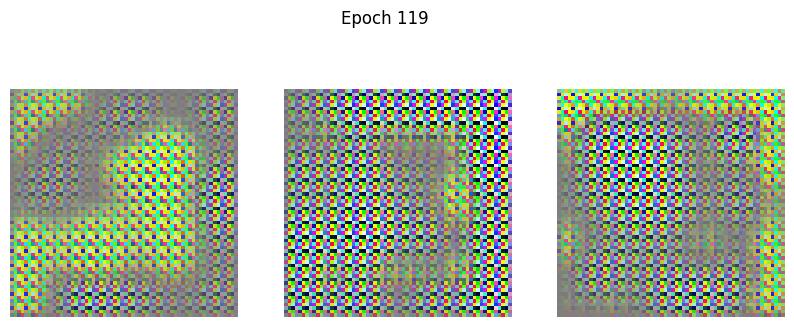

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1382 - g_loss: 5.6319
Epoch 120/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1162 - g_loss: 5.1563 

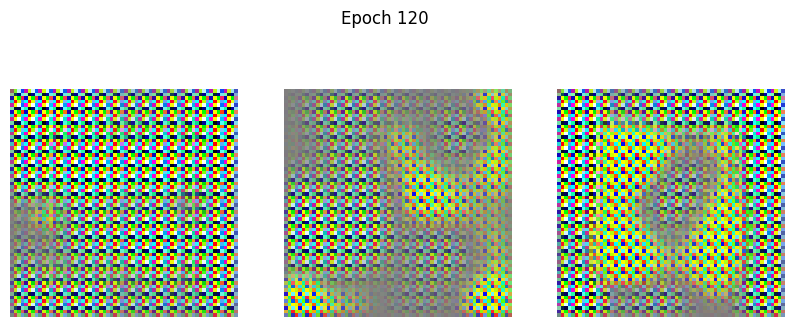

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.1139 - g_loss: 5.1981
Epoch 121/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1006 - g_loss: 4.4895 

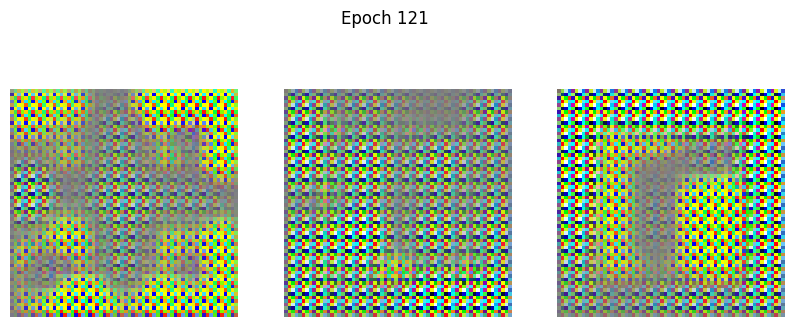

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.1009 - g_loss: 4.5783
Epoch 122/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - d_loss: 0.0686 - g_loss: 4.7832

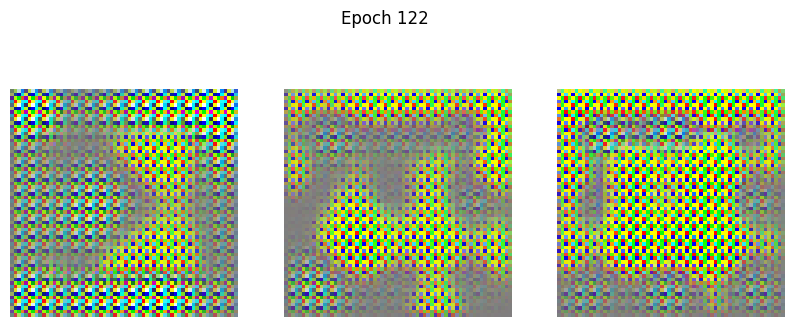

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - d_loss: 0.0690 - g_loss: 4.6679
Epoch 123/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1721 - g_loss: 8.8072

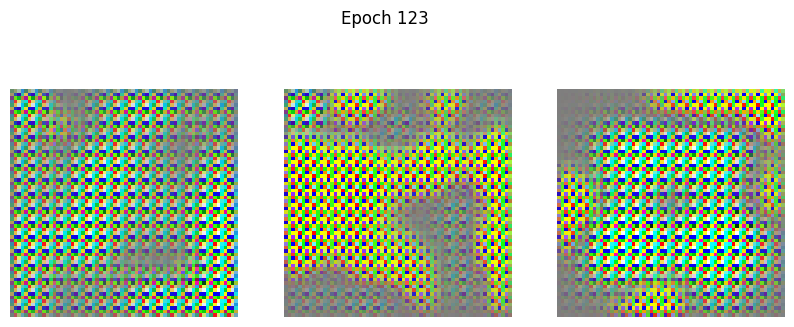

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1691 - g_loss: 8.6359
Epoch 124/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1175 - g_loss: 5.6813

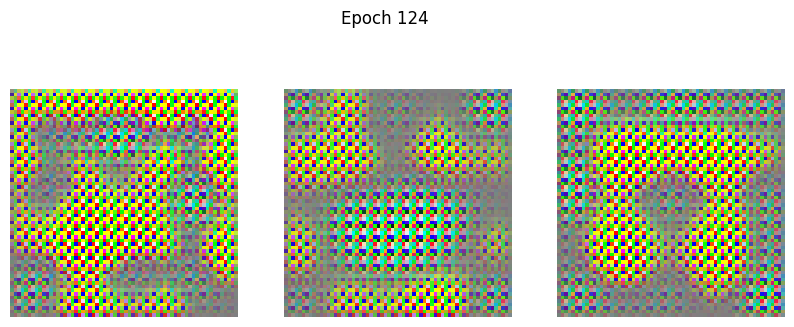

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.1322 - g_loss: 6.1426
Epoch 125/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1514 - g_loss: 7.1946

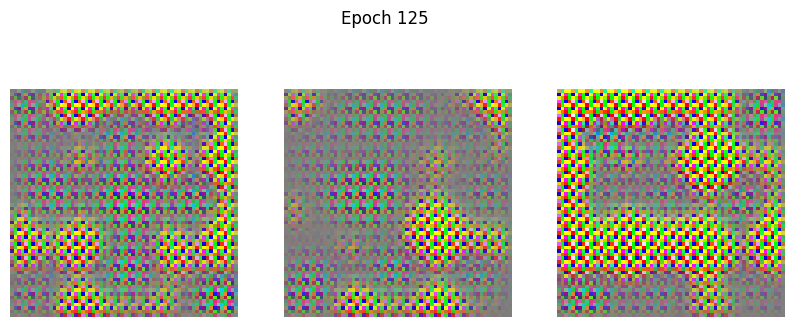

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1495 - g_loss: 6.8152
Epoch 126/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.4295 - g_loss: 8.8603 

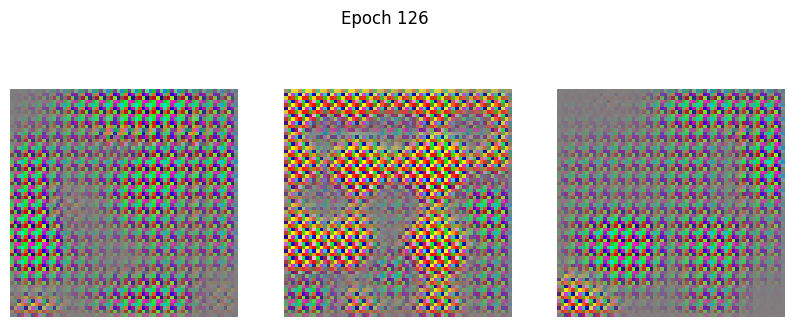

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - d_loss: 0.4080 - g_loss: 8.6931
Epoch 127/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.2067 - g_loss: 4.3707 

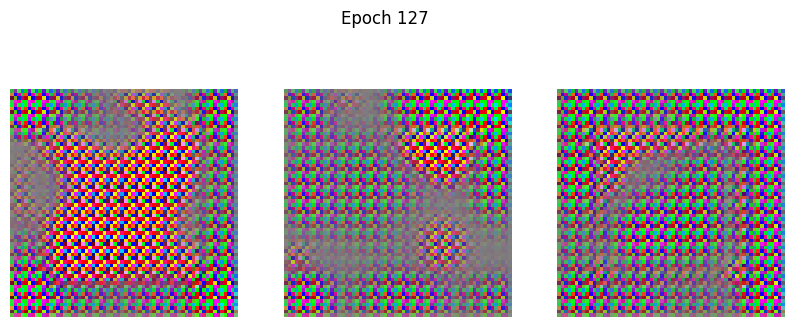

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step - d_loss: 0.2262 - g_loss: 4.6914
Epoch 128/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1490 - g_loss: 6.7065 

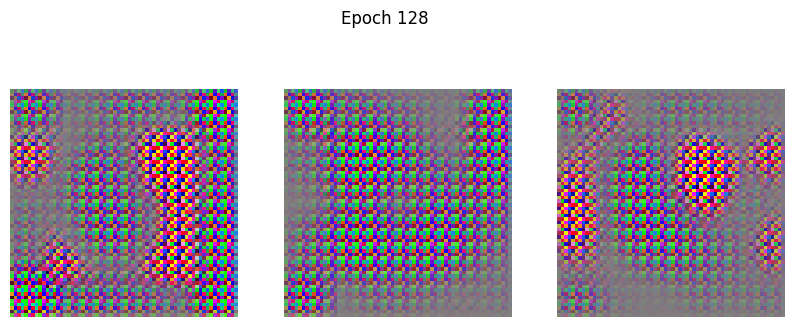

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - d_loss: 0.1415 - g_loss: 6.5506
Epoch 129/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0991 - g_loss: 4.6789

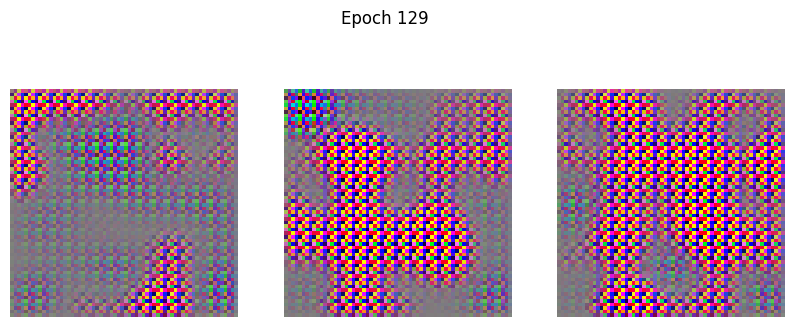

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1038 - g_loss: 4.8864
Epoch 130/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0696 - g_loss: 5.4894

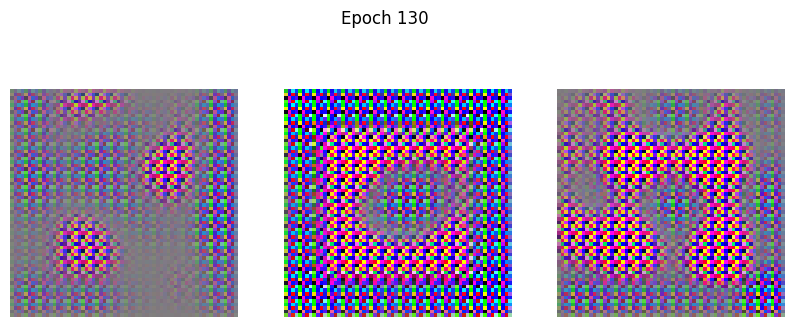

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.0718 - g_loss: 5.3914
Epoch 131/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.0970 - g_loss: 5.4044 

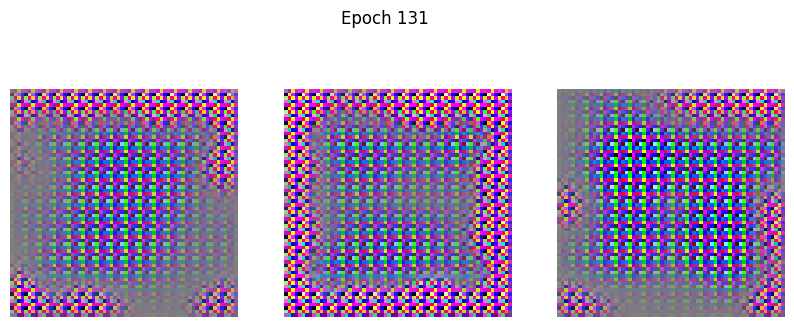

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.0939 - g_loss: 5.4136
Epoch 132/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0824 - g_loss: 5.0925

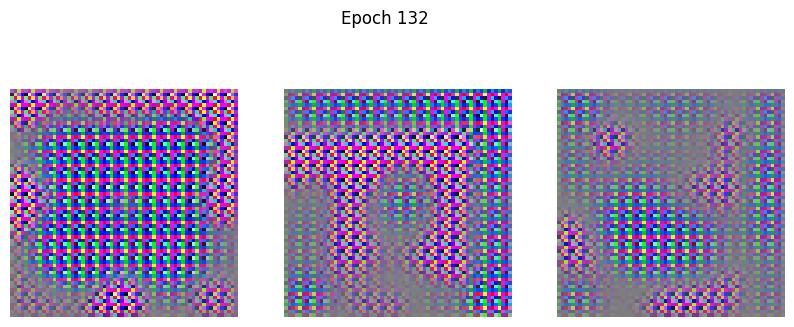

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.0856 - g_loss: 5.1254
Epoch 133/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0989 - g_loss: 5.1341

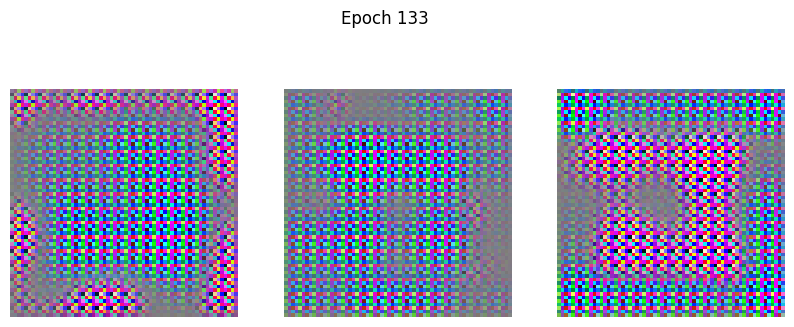

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1043 - g_loss: 5.2485
Epoch 134/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1166 - g_loss: 5.1982

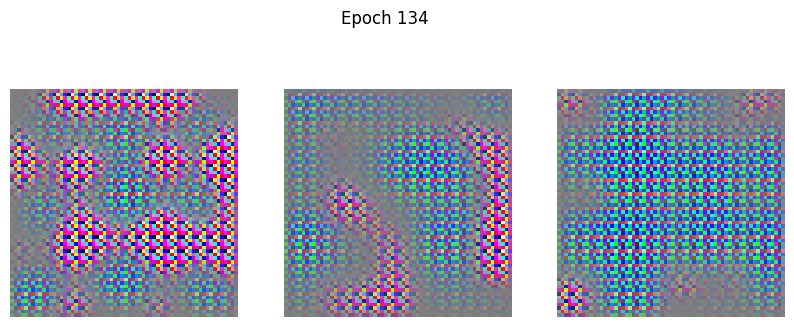

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1196 - g_loss: 5.2327
Epoch 135/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1851 - g_loss: 7.2592 

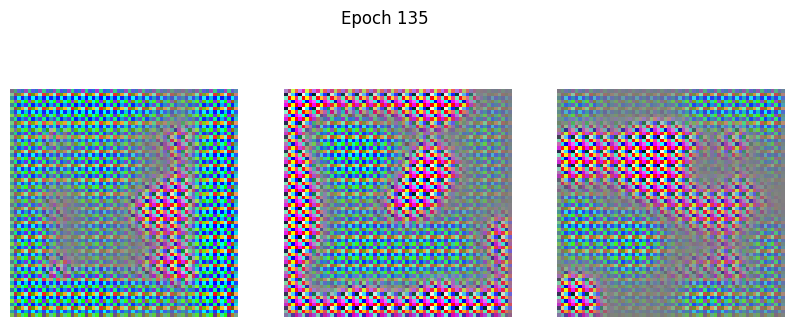

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - d_loss: 0.1830 - g_loss: 6.9624
Epoch 136/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.2192 - g_loss: 7.5459 

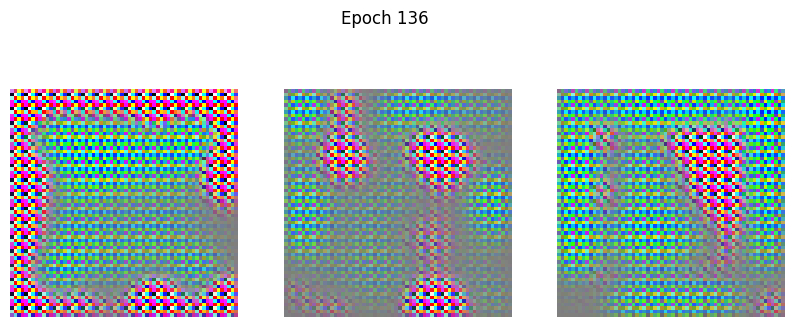

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.2117 - g_loss: 7.3797
Epoch 137/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1252 - g_loss: 5.2067 

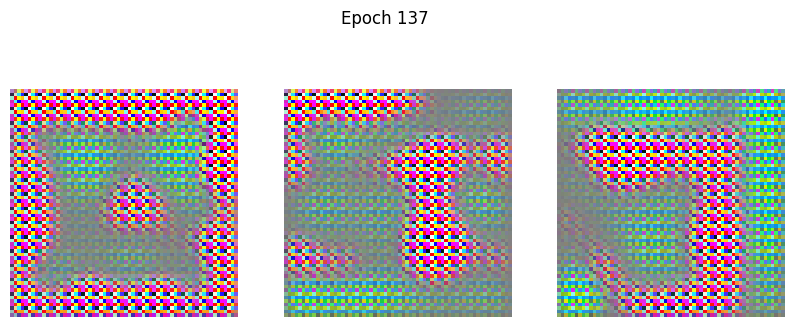

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.1340 - g_loss: 5.6421
Epoch 138/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1613 - g_loss: 5.5630 

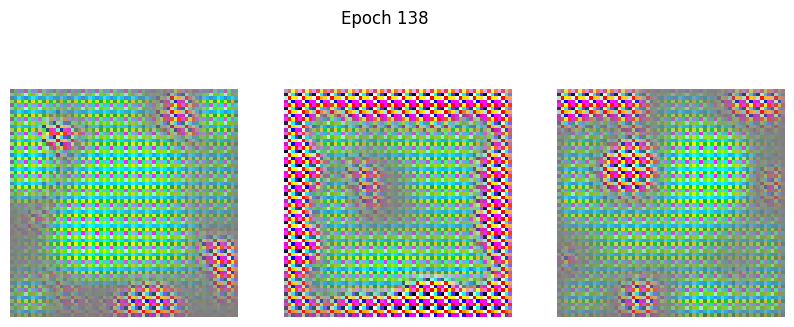

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.1499 - g_loss: 5.3376
Epoch 139/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2802 - g_loss: 9.3760 

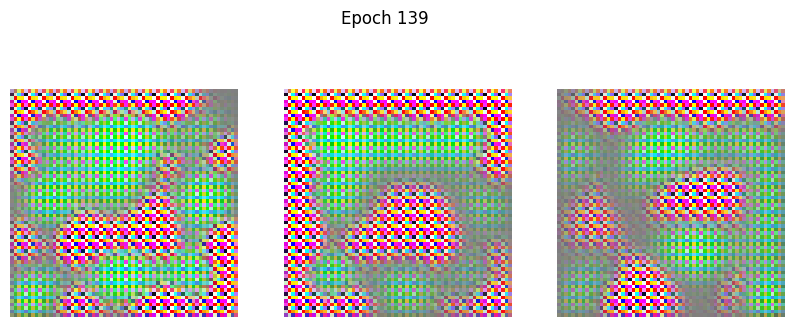

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - d_loss: 0.2692 - g_loss: 9.3409
Epoch 140/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1032 - g_loss: 4.9140 

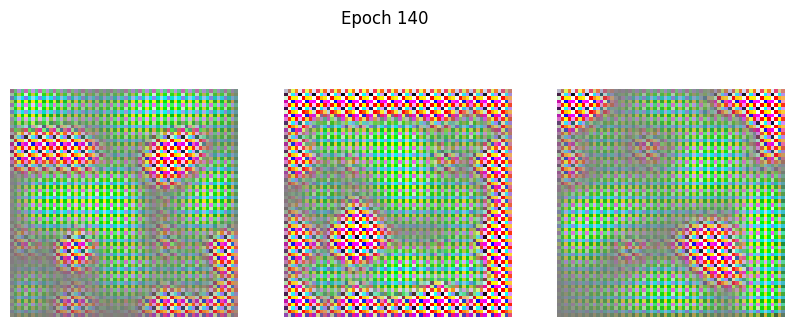

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0953 - g_loss: 4.7239
Epoch 141/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1038 - g_loss: 7.0257

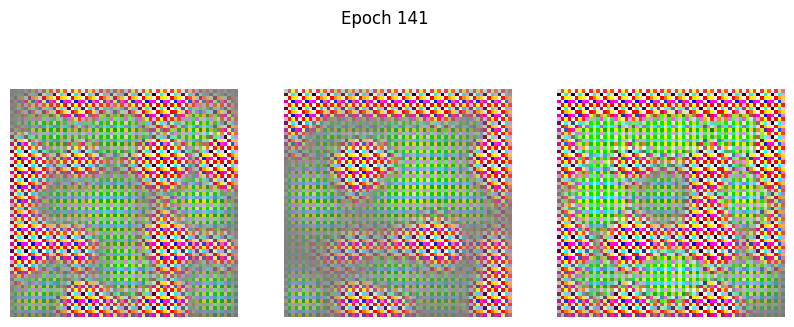

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0969 - g_loss: 7.0201
Epoch 142/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0461 - g_loss: 4.5741

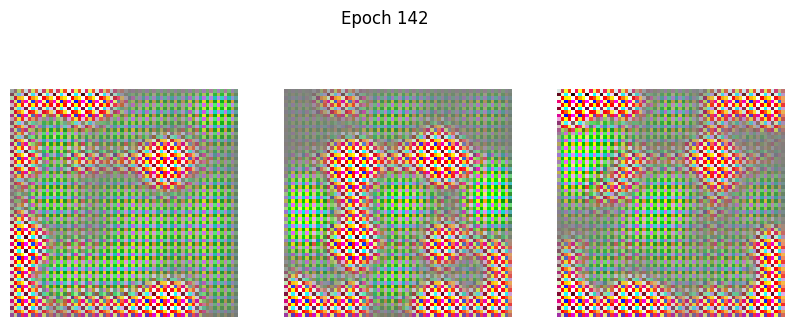

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.0470 - g_loss: 4.5154
Epoch 143/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1436 - g_loss: 8.4971

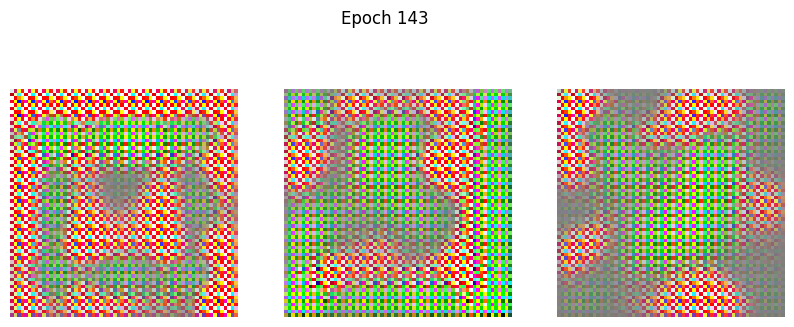

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1421 - g_loss: 8.3993
Epoch 144/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0948 - g_loss: 4.6732 

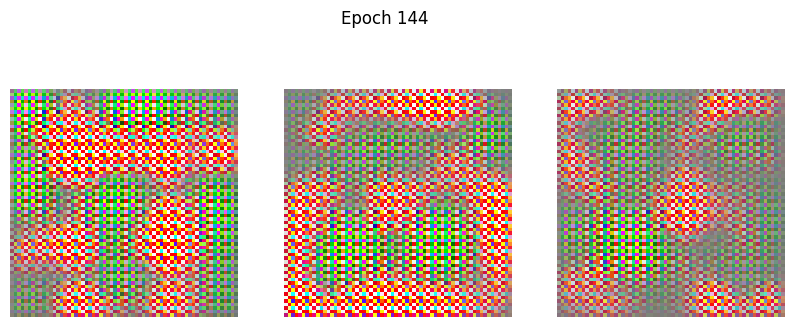

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0946 - g_loss: 4.8574
Epoch 145/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0508 - g_loss: 5.7099 

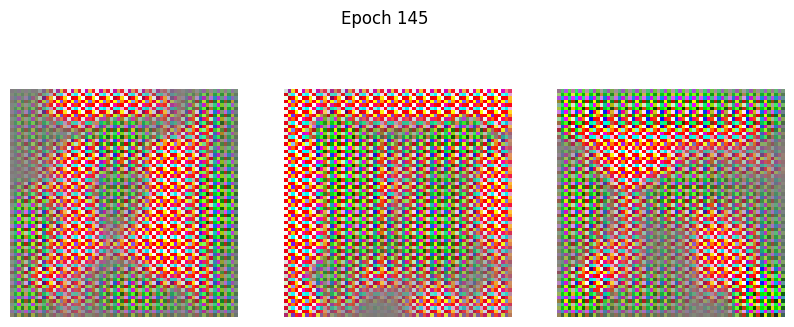

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0494 - g_loss: 5.6662
Epoch 146/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0493 - g_loss: 5.7456 

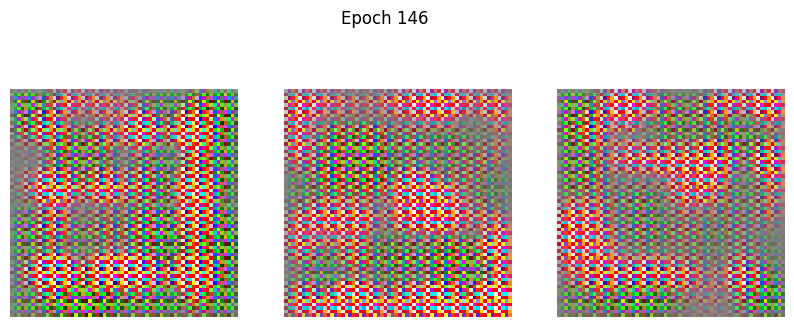

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.0482 - g_loss: 5.7832
Epoch 147/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0546 - g_loss: 5.9265 

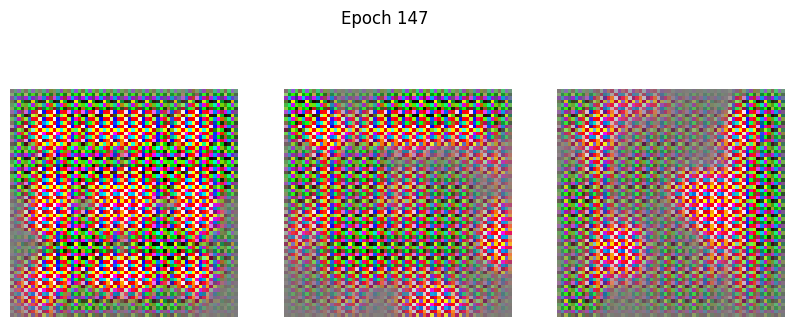

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - d_loss: 0.0564 - g_loss: 6.1960
Epoch 148/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.0807 - g_loss: 7.0231 

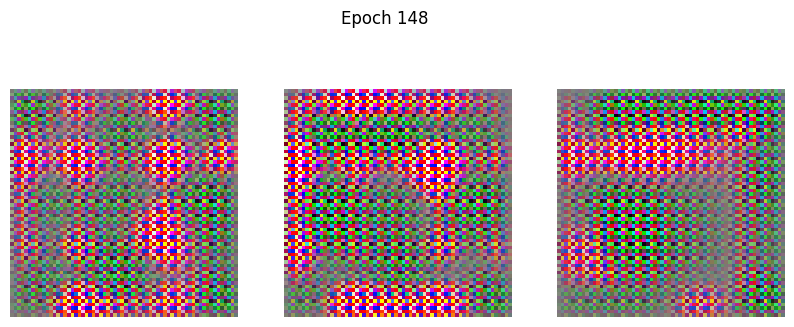

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.0867 - g_loss: 7.3361
Epoch 149/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1408 - g_loss: 6.7544 

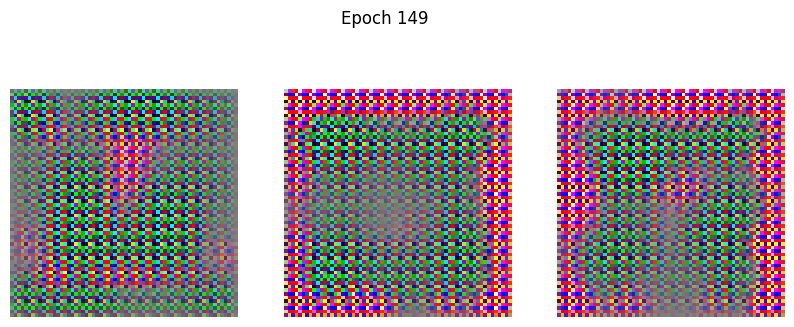

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.1426 - g_loss: 6.9675
Epoch 150/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1075 - g_loss: 7.5431

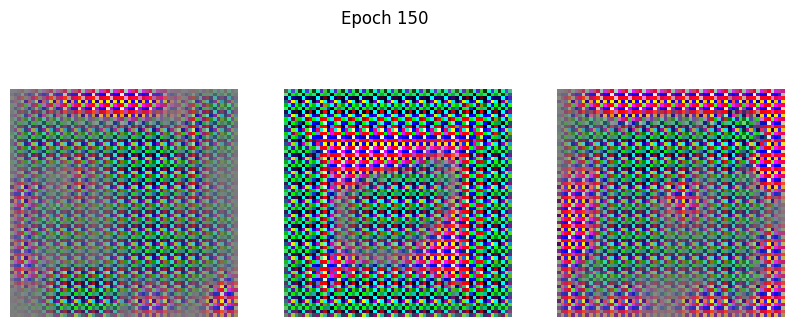

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step - d_loss: 0.1096 - g_loss: 7.3859
Epoch 151/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1643 - g_loss: 11.3373 

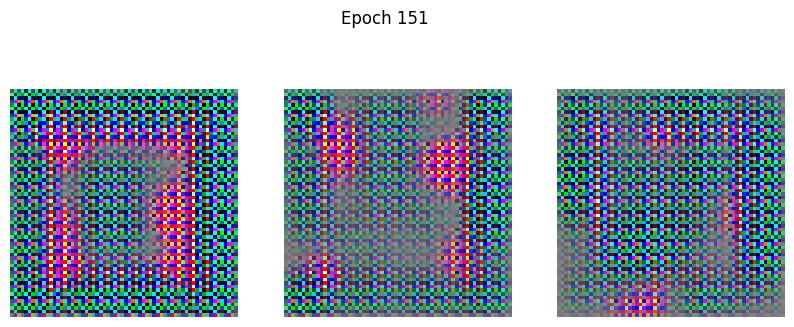

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.1601 - g_loss: 11.1504
Epoch 152/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1508 - g_loss: 8.0878 

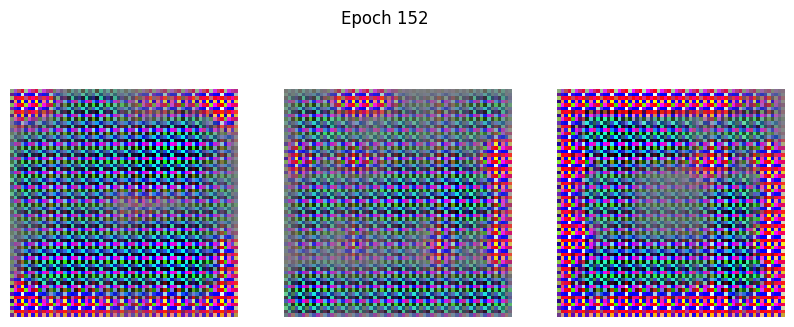

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.1804 - g_loss: 9.3781
Epoch 153/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2982 - g_loss: 17.0874

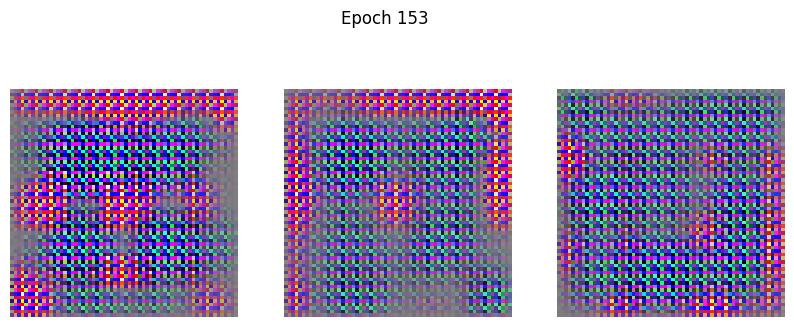

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step - d_loss: 0.2887 - g_loss: 16.4572
Epoch 154/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0764 - g_loss: 5.5887

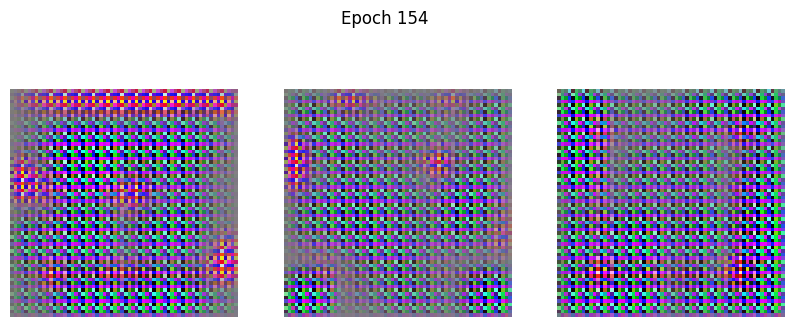

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step - d_loss: 0.0873 - g_loss: 5.8487
Epoch 155/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0220 - g_loss: 7.0422 

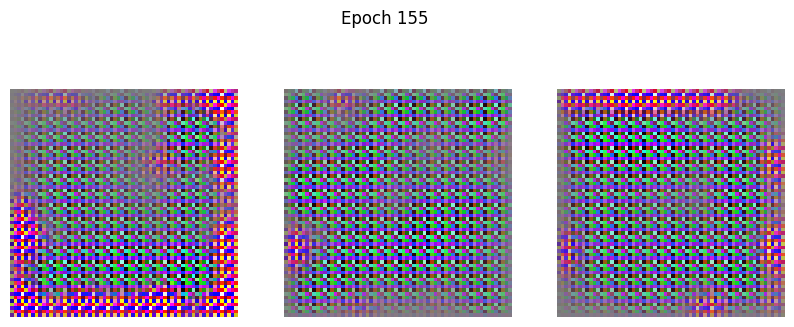

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - d_loss: 0.0222 - g_loss: 6.8419
Epoch 156/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2456 - g_loss: 11.3451 

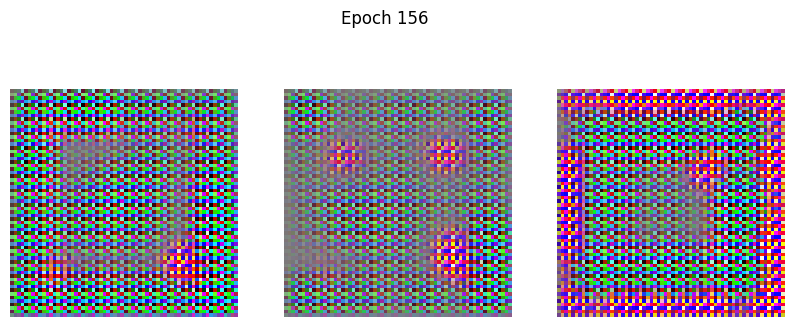

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.2316 - g_loss: 11.2236
Epoch 157/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.2087 - g_loss: 6.8003 

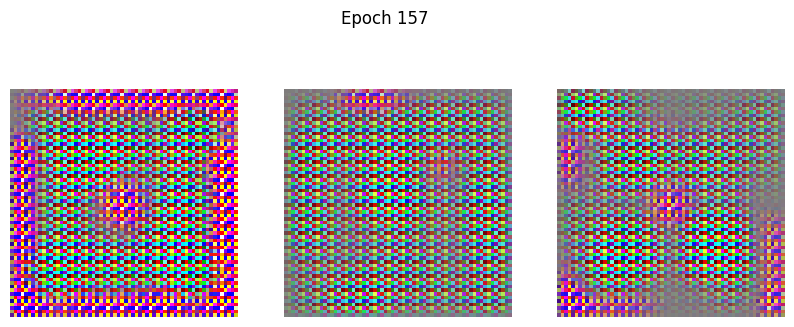

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - d_loss: 0.2355 - g_loss: 7.5047
Epoch 158/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1991 - g_loss: 11.9464 

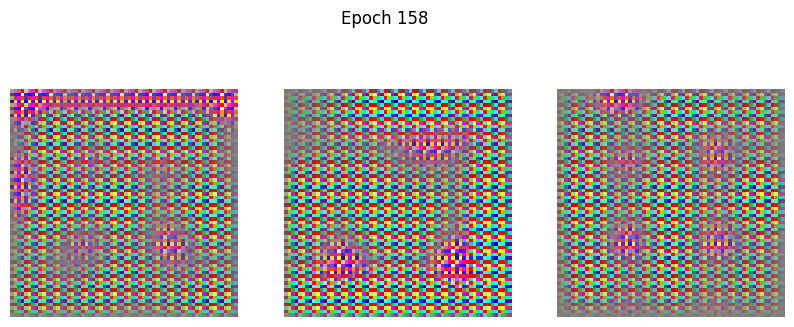

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step - d_loss: 0.1872 - g_loss: 11.5452
Epoch 159/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - d_loss: 0.1756 - g_loss: 7.0852

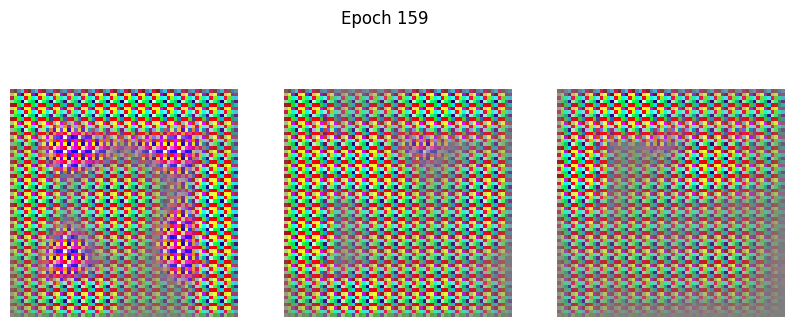

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step - d_loss: 0.2243 - g_loss: 8.1753
Epoch 160/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.2822 - g_loss: 14.2016 

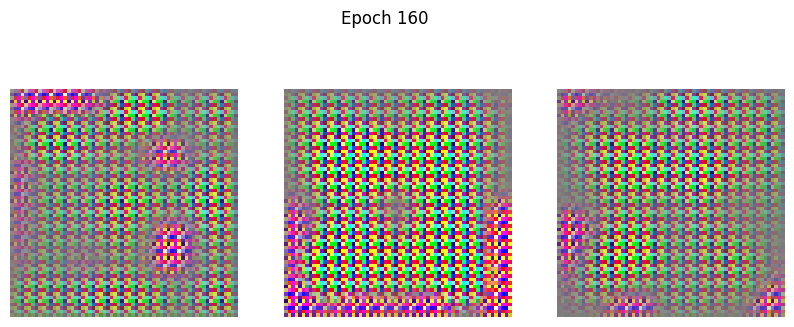

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step - d_loss: 0.2663 - g_loss: 13.7204
Epoch 161/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - d_loss: 0.1016 - g_loss: 5.0145 

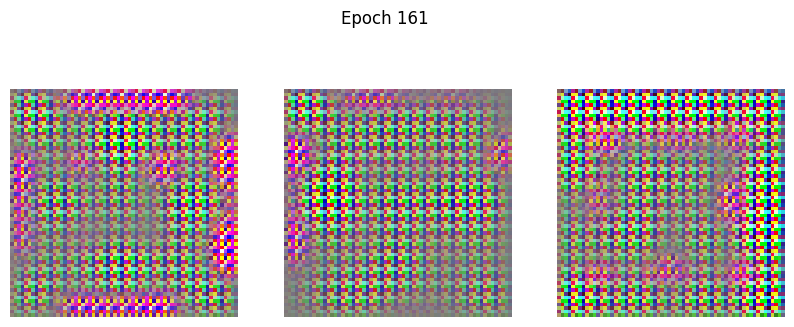

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step - d_loss: 0.1170 - g_loss: 5.3046
Epoch 162/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - d_loss: 0.0538 - g_loss: 7.1272

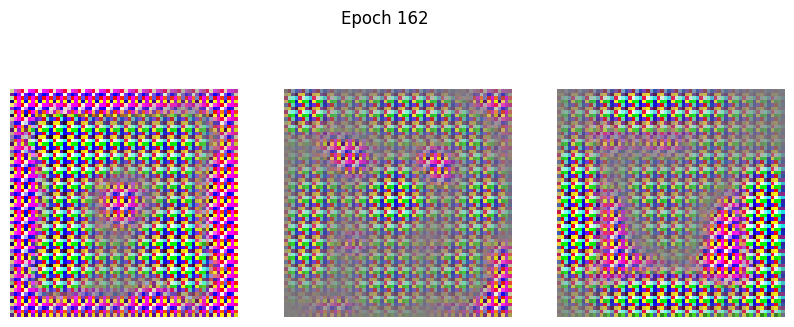

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - d_loss: 0.0572 - g_loss: 6.9789   
Epoch 163/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step - d_loss: 0.0430 - g_loss: 3.8754

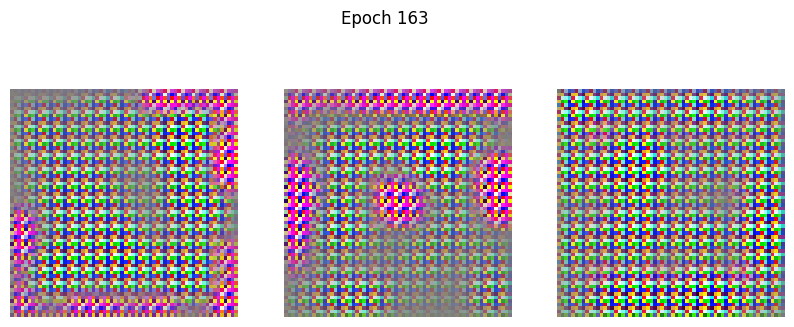

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 265ms/step - d_loss: 0.0469 - g_loss: 3.9408
Epoch 164/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0562 - g_loss: 5.0040

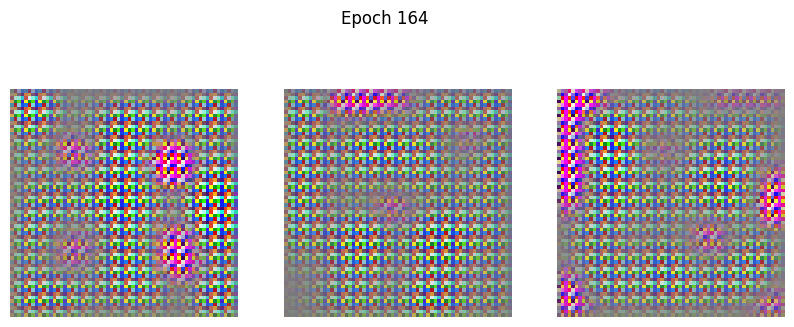

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.0575 - g_loss: 4.9591
Epoch 165/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1015 - g_loss: 5.3458

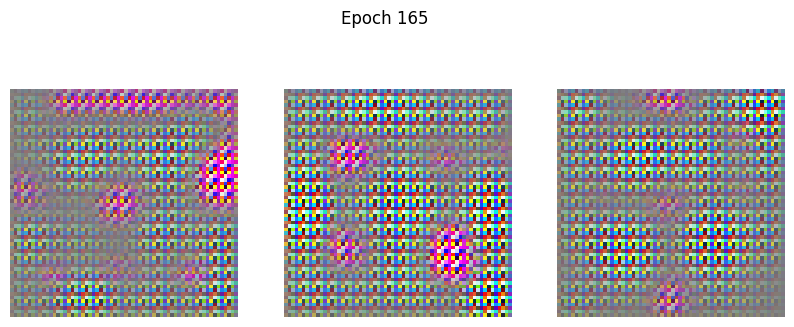

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1119 - g_loss: 5.5982
Epoch 166/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.2834 - g_loss: 5.8949 

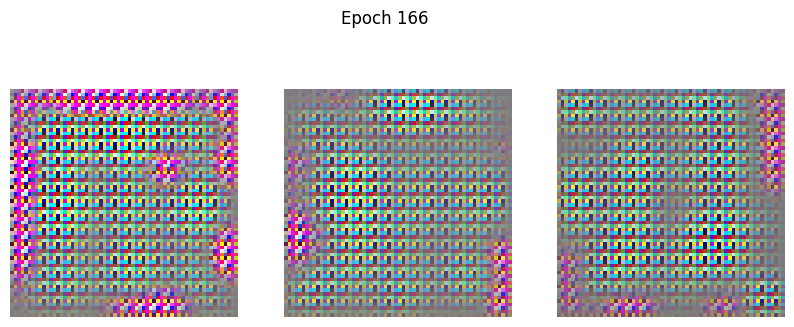

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.3024 - g_loss: 6.4730
Epoch 167/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.4747 - g_loss: 5.1158 

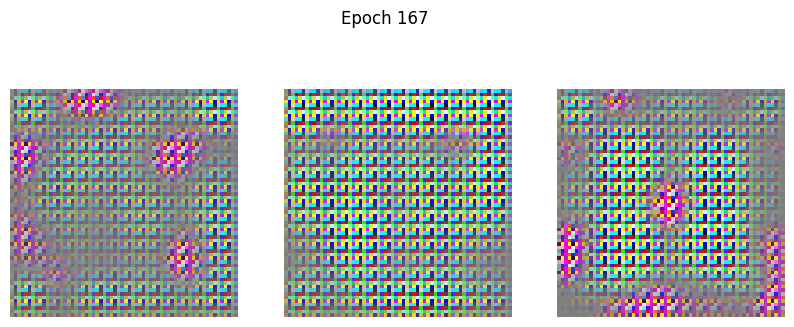

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.4286 - g_loss: 4.9424
Epoch 168/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1552 - g_loss: 7.8586

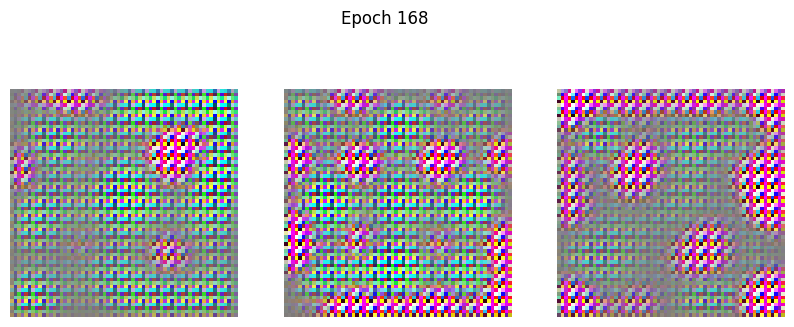

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1431 - g_loss: 7.8523
Epoch 169/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0445 - g_loss: 4.8762

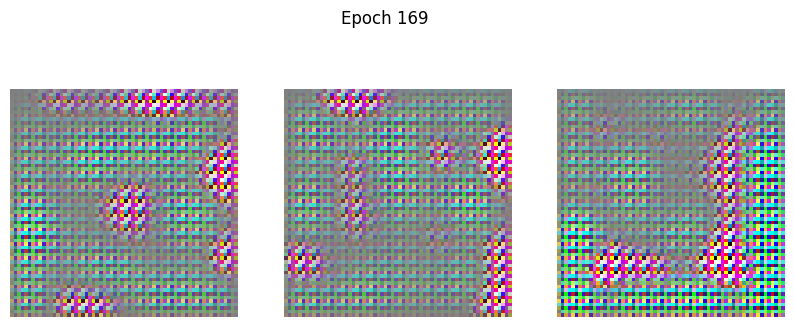

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.0469 - g_loss: 4.7686
Epoch 170/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1709 - g_loss: 7.1313

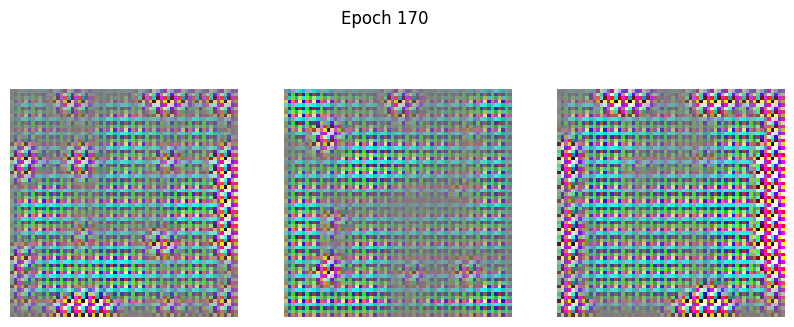

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1660 - g_loss: 7.0649
Epoch 171/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0944 - g_loss: 4.7492

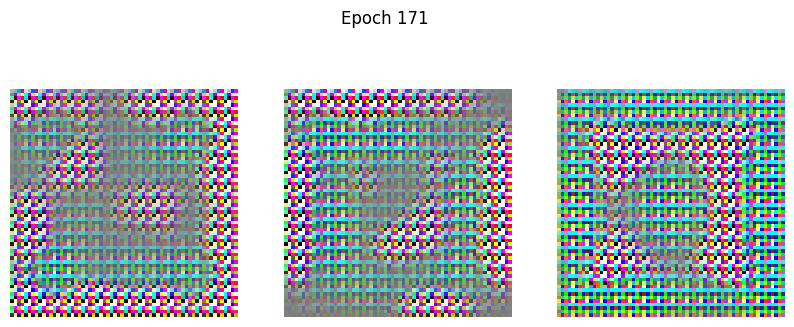

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1026 - g_loss: 4.8716
Epoch 172/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0862 - g_loss: 5.2931 

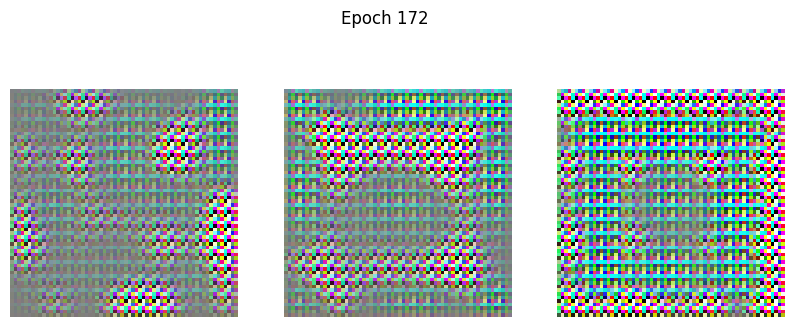

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.0846 - g_loss: 5.2485
Epoch 173/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0812 - g_loss: 5.1082

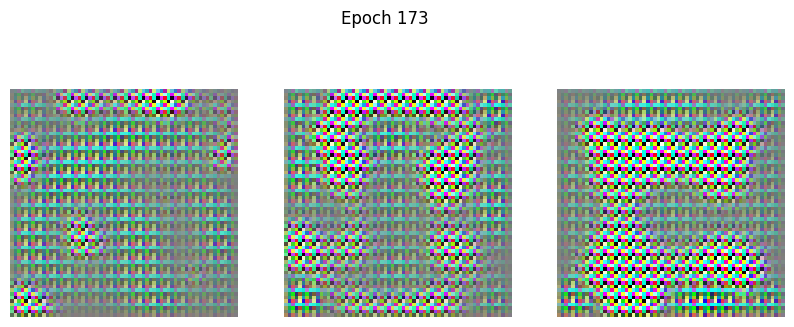

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0818 - g_loss: 5.1172
Epoch 174/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0779 - g_loss: 5.1662 

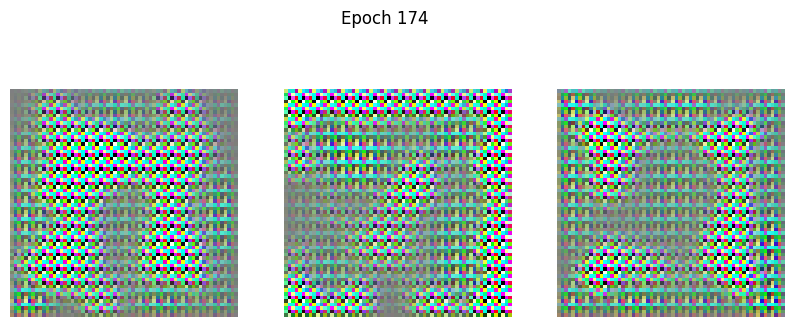

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0745 - g_loss: 5.1159
Epoch 175/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0625 - g_loss: 5.0259 

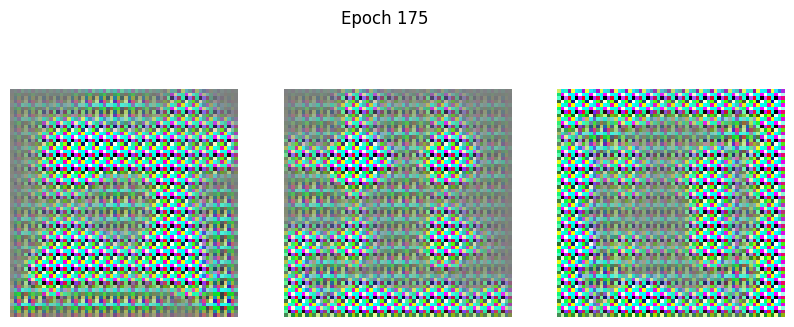

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0606 - g_loss: 5.0111
Epoch 176/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0600 - g_loss: 4.9116 

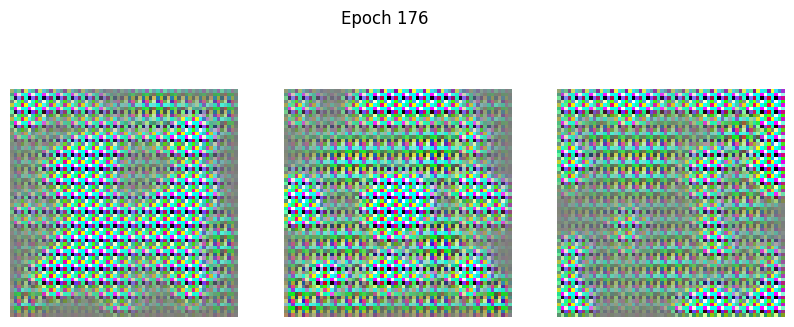

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.0594 - g_loss: 5.0092
Epoch 177/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0523 - g_loss: 4.9467 

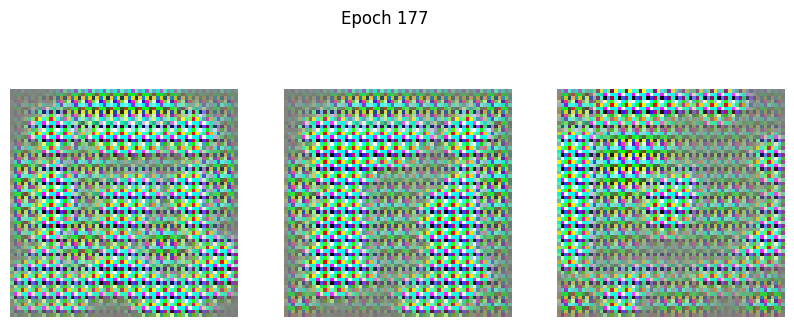

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0509 - g_loss: 4.9593
Epoch 178/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.0580 - g_loss: 5.6003 

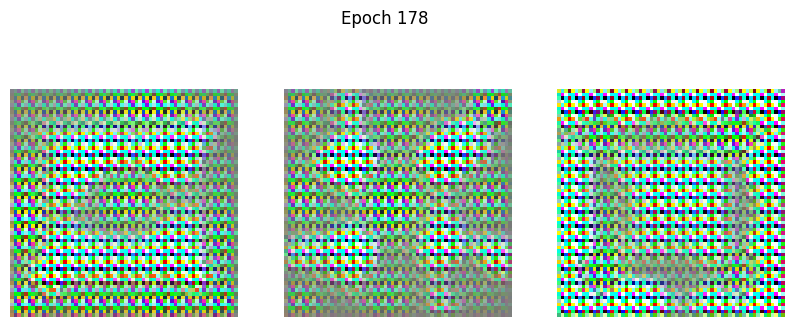

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0569 - g_loss: 5.5765
Epoch 179/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0796 - g_loss: 6.4148

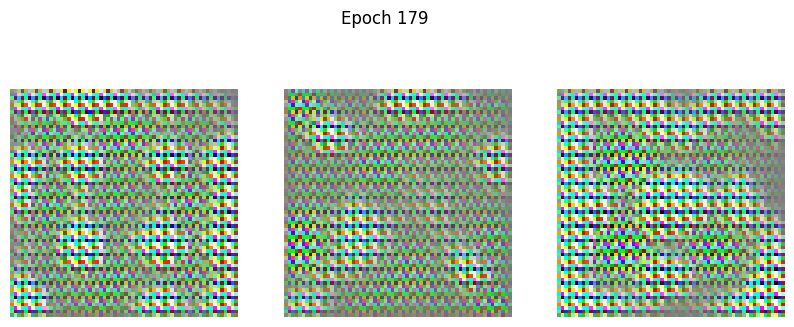

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0790 - g_loss: 6.2575
Epoch 180/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1037 - g_loss: 6.4960

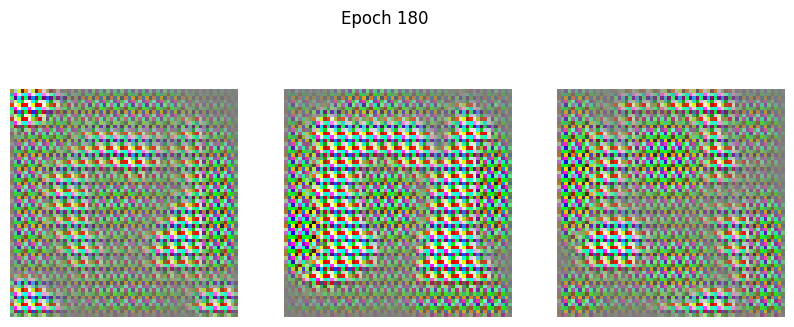

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.1040 - g_loss: 6.3960
Epoch 181/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1508 - g_loss: 8.2147

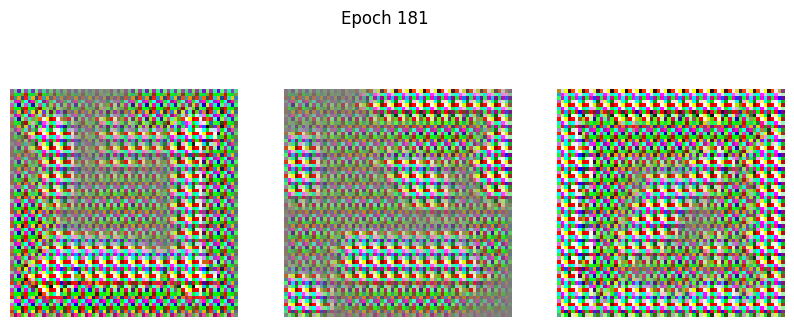

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.1539 - g_loss: 7.8209
Epoch 182/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.3488 - g_loss: 12.0081

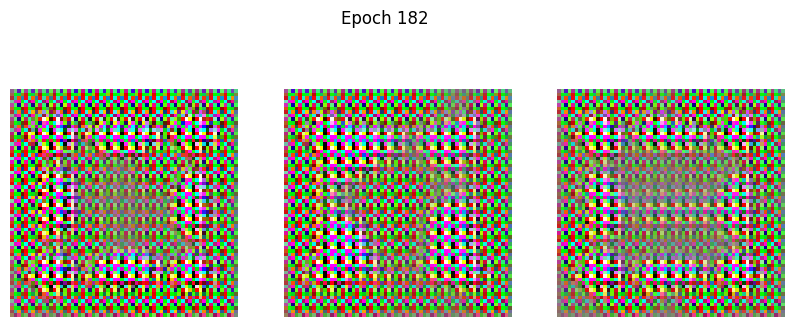

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.3508 - g_loss: 11.5024
Epoch 183/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1516 - g_loss: 7.9400 

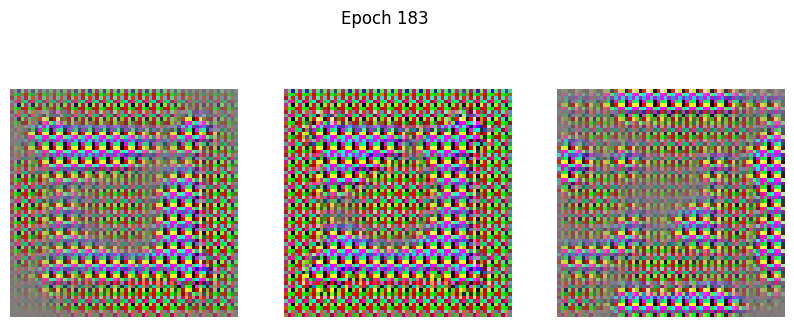

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1612 - g_loss: 8.4495
Epoch 184/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.1479 - g_loss: 7.8129

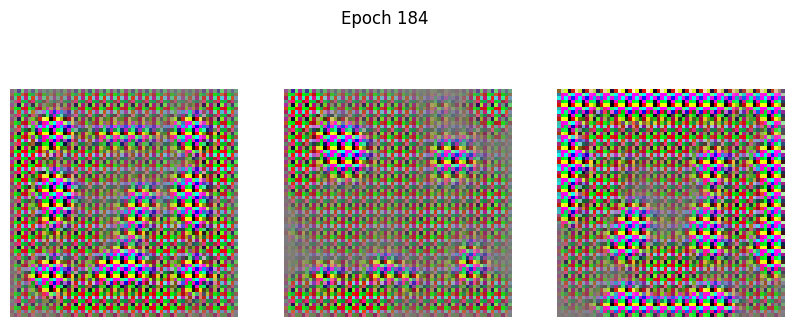

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1451 - g_loss: 7.3376
Epoch 185/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6027 - g_loss: 9.9977  

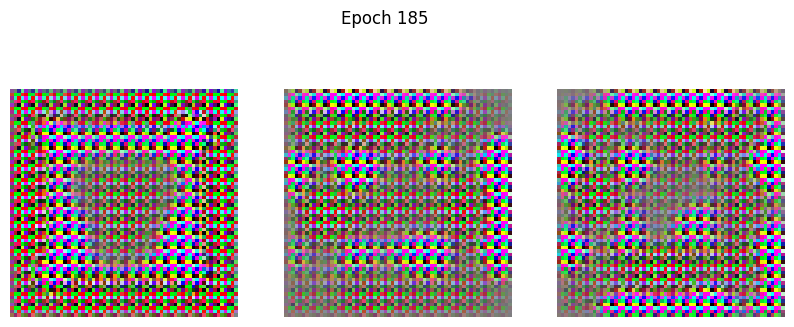

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step - d_loss: 0.5754 - g_loss: 9.6880
Epoch 186/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.2085 - g_loss: 5.5012 

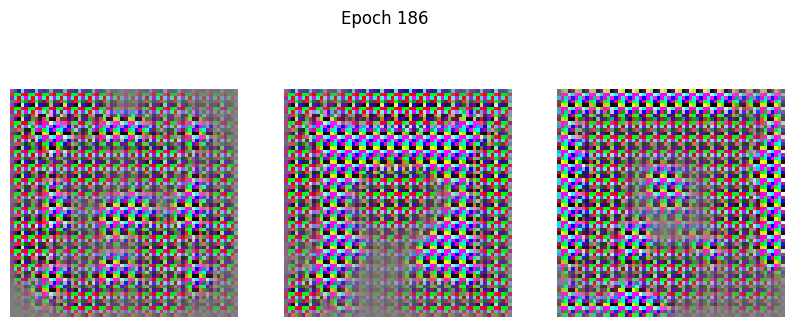

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 189ms/step - d_loss: 0.2367 - g_loss: 6.1438
Epoch 187/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.2196 - g_loss: 8.5590 

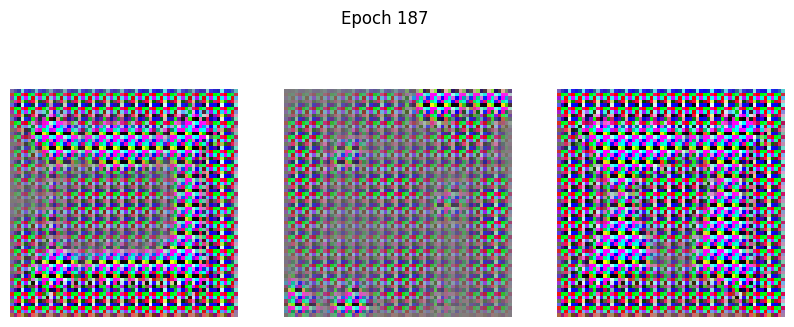

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - d_loss: 0.2042 - g_loss: 8.2195
Epoch 188/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1294 - g_loss: 5.9973

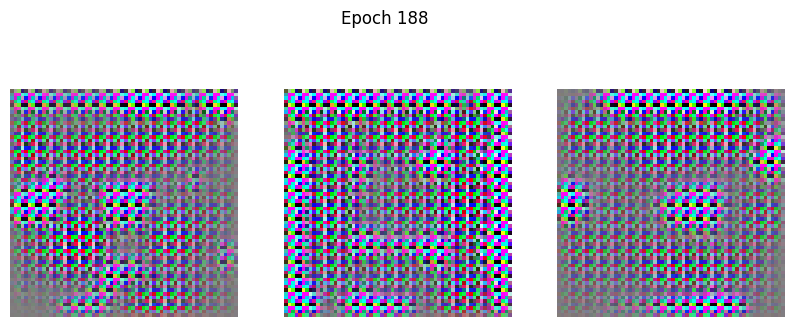

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 261ms/step - d_loss: 0.1248 - g_loss: 6.0676
Epoch 189/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0715 - g_loss: 5.6328 

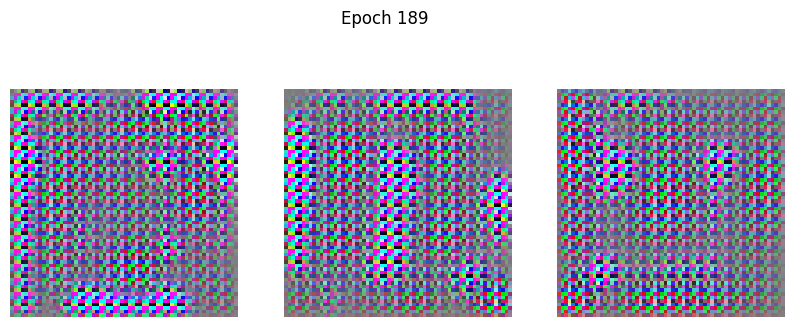

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.0707 - g_loss: 5.6287
Epoch 190/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - d_loss: 0.0927 - g_loss: 6.4174 

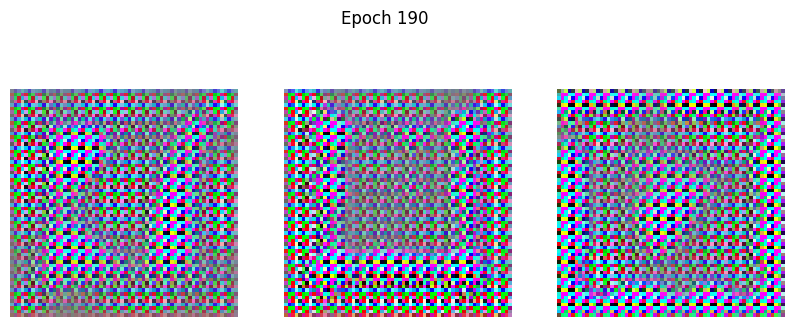

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 242ms/step - d_loss: 0.0943 - g_loss: 6.3797
Epoch 191/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1525 - g_loss: 6.8318

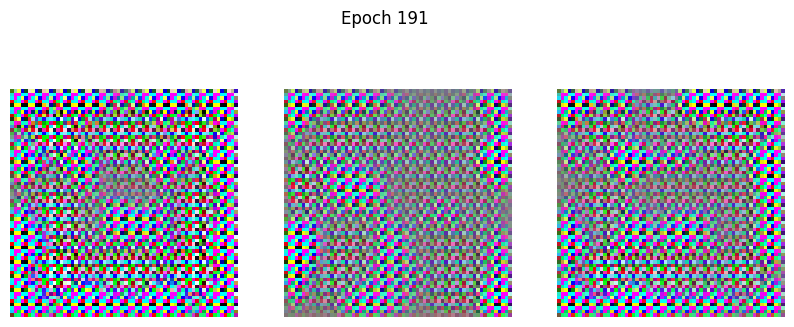

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.1549 - g_loss: 6.6085
Epoch 192/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2137 - g_loss: 8.3084

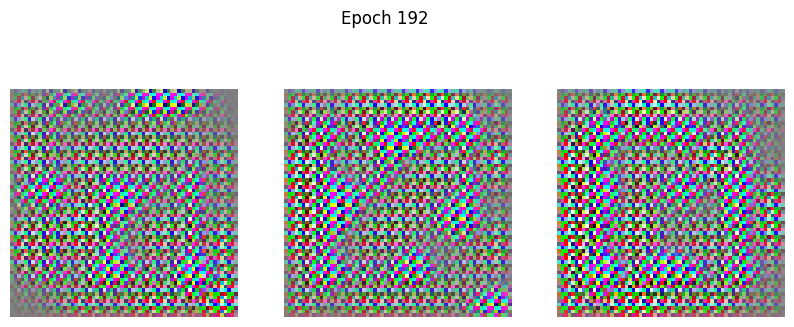

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.2145 - g_loss: 7.9989
Epoch 193/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1760 - g_loss: 7.7703 

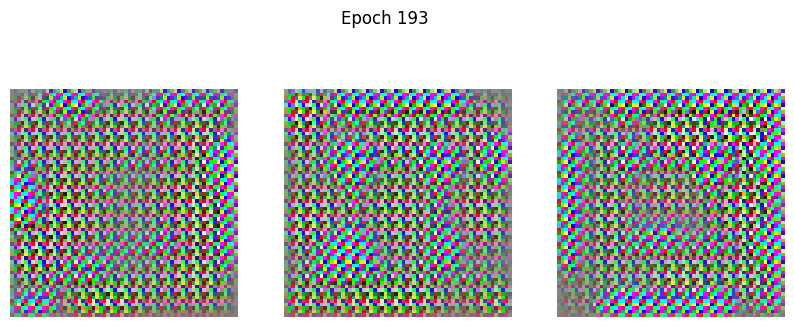

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.1674 - g_loss: 7.6361
Epoch 194/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1412 - g_loss: 6.9661

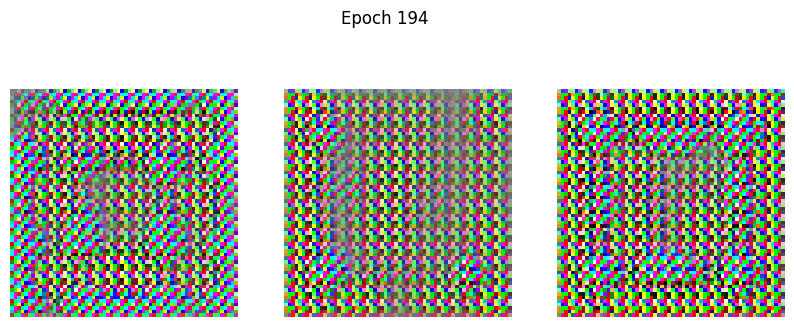

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1480 - g_loss: 7.2343
Epoch 195/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1885 - g_loss: 6.7950 

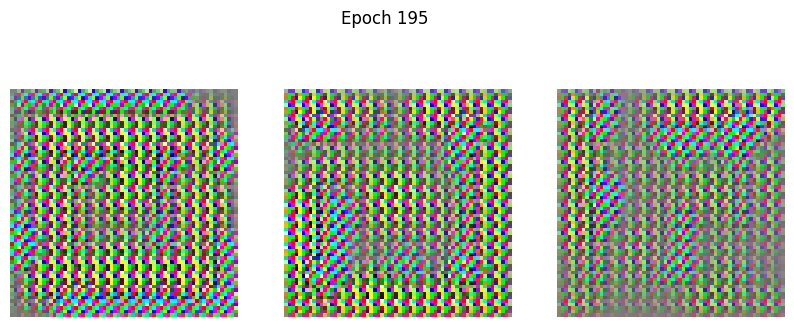

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.1955 - g_loss: 7.1862
Epoch 196/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1345 - g_loss: 7.0338

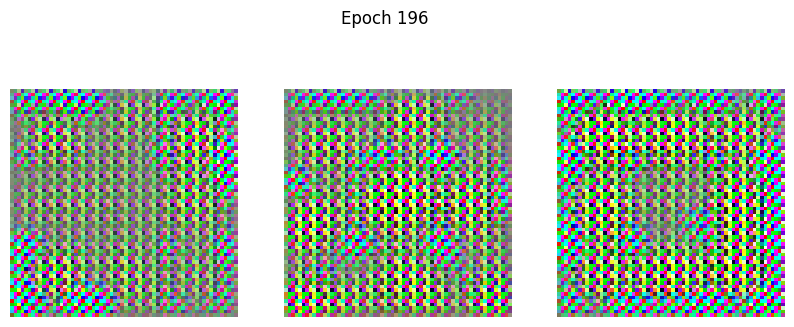

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.1402 - g_loss: 7.0650
Epoch 197/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1132 - g_loss: 6.5330 

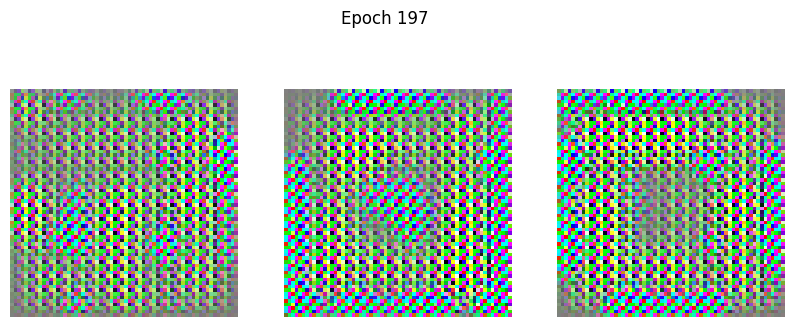

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1100 - g_loss: 6.7238
Epoch 198/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0904 - g_loss: 8.3911

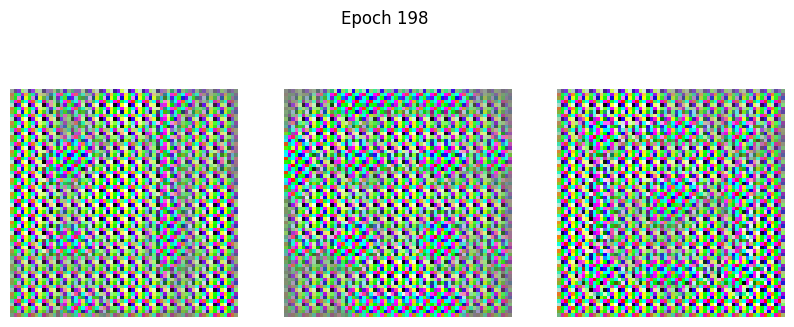

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1015 - g_loss: 9.0483
Epoch 199/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.2136 - g_loss: 7.2193

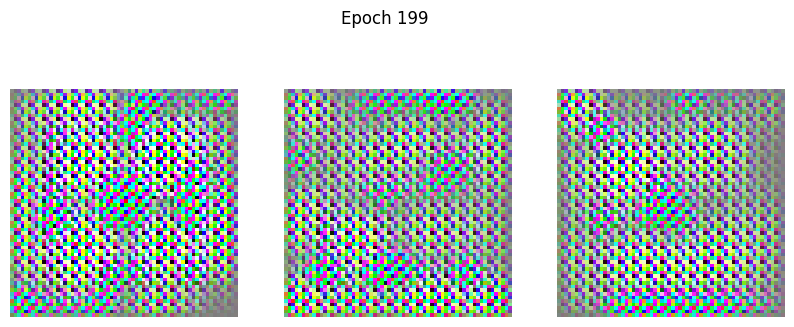

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1999 - g_loss: 6.7500
Epoch 200/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.7080 - g_loss: 25.4701 

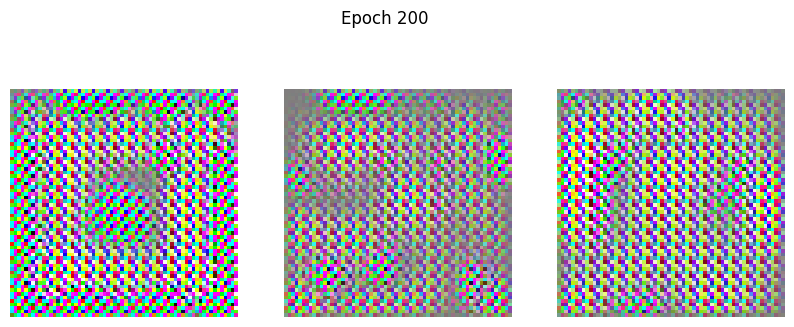

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.7503 - g_loss: 25.0132
Epoch 201/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1466 - g_loss: 9.8263  

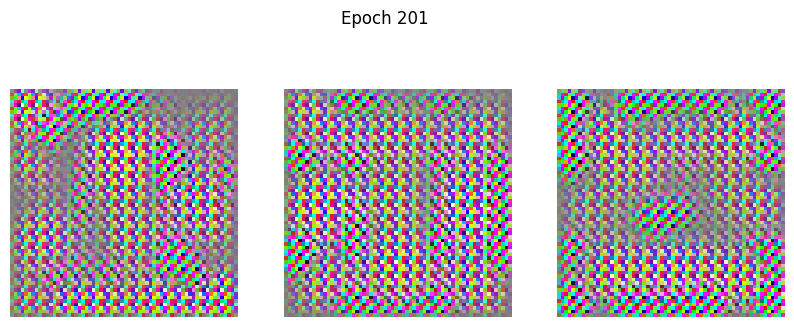

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1322 - g_loss: 9.1437
Epoch 202/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.2198 - g_loss: 8.9839 

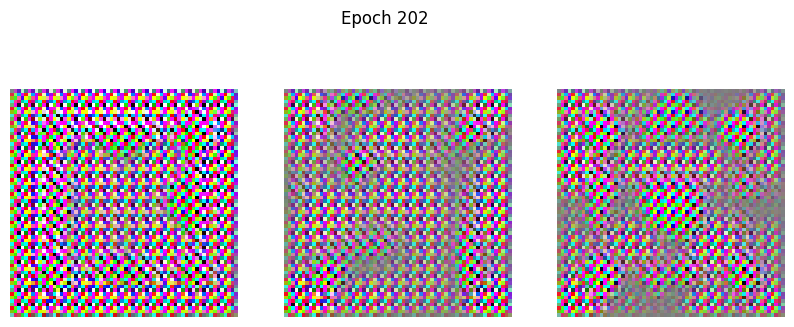

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1971 - g_loss: 9.0065
Epoch 203/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0402 - g_loss: 6.7208

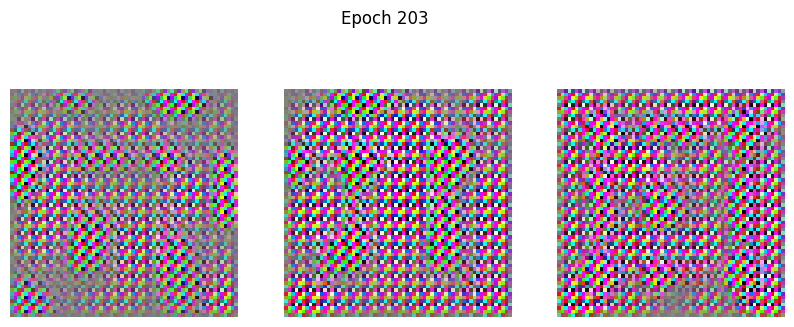

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.0425 - g_loss: 6.5589
Epoch 204/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1228 - g_loss: 7.1907 

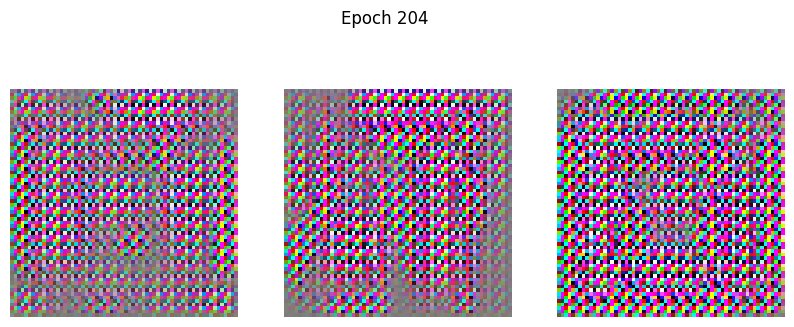

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.1158 - g_loss: 7.1206
Epoch 205/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1038 - g_loss: 6.1327

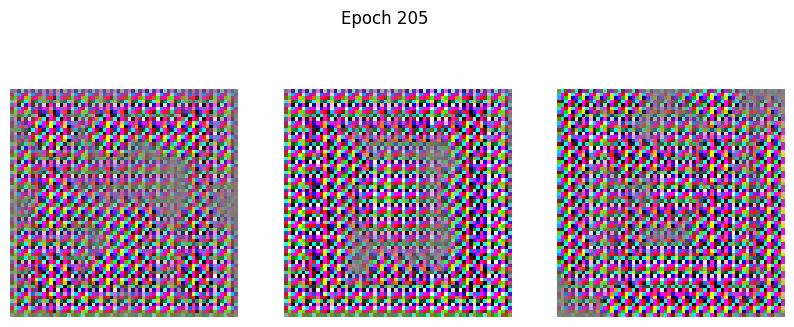

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1139 - g_loss: 6.4208
Epoch 206/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.1236 - g_loss: 6.5075

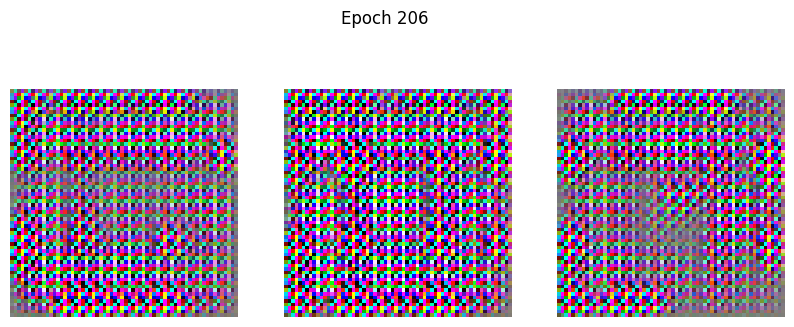

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - d_loss: 0.1257 - g_loss: 6.4686
Epoch 207/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1841 - g_loss: 10.5797

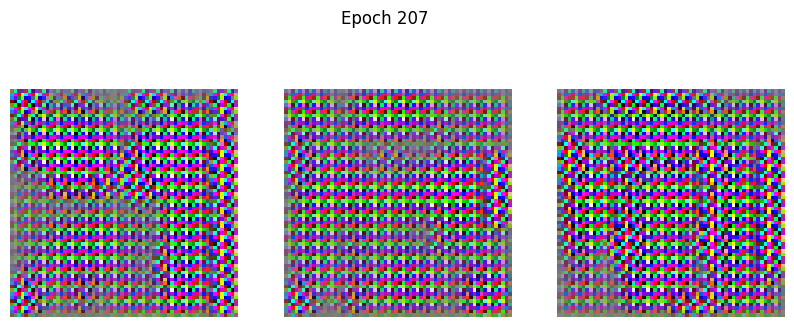

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1834 - g_loss: 10.1882
Epoch 208/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2077 - g_loss: 10.0967 

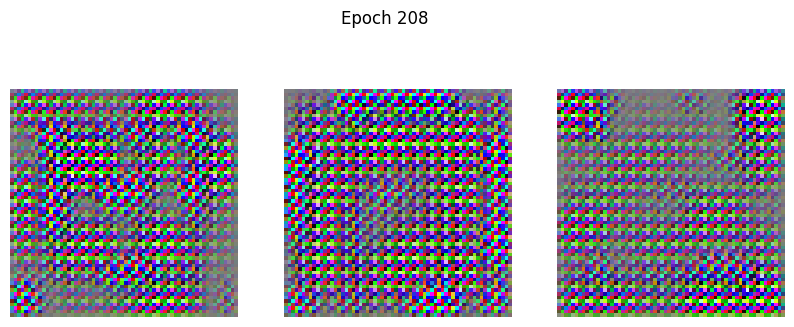

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - d_loss: 0.1972 - g_loss: 9.8928
Epoch 209/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1711 - g_loss: 7.0973 

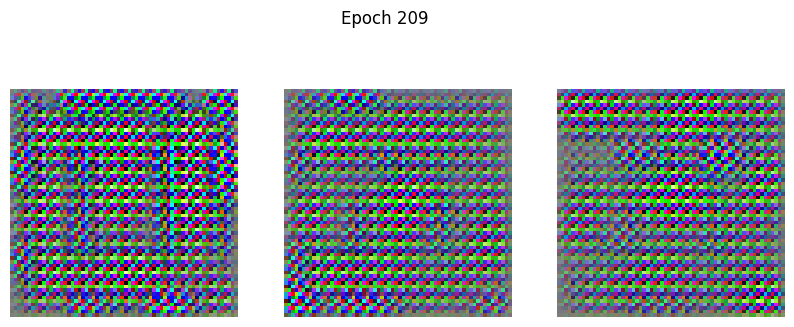

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.1887 - g_loss: 8.0310
Epoch 210/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.2634 - g_loss: 12.0749

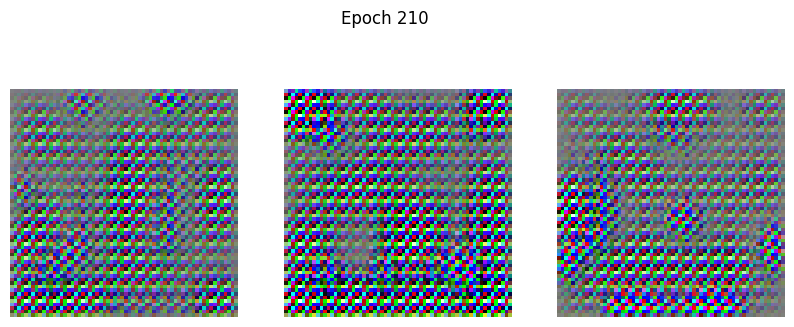

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.2599 - g_loss: 11.3497
Epoch 211/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.3338 - g_loss: 11.0450

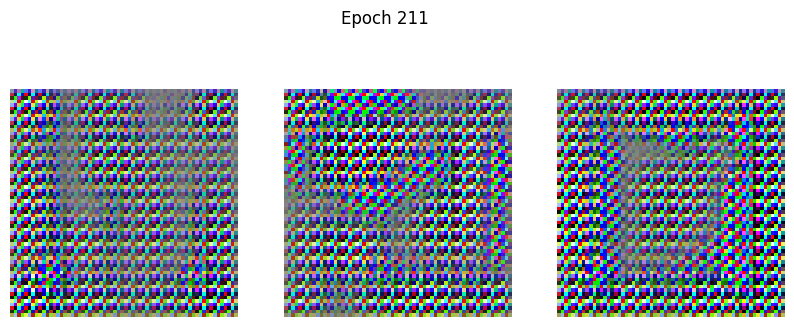

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step - d_loss: 0.3142 - g_loss: 10.9488
Epoch 212/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1773 - g_loss: 7.6244

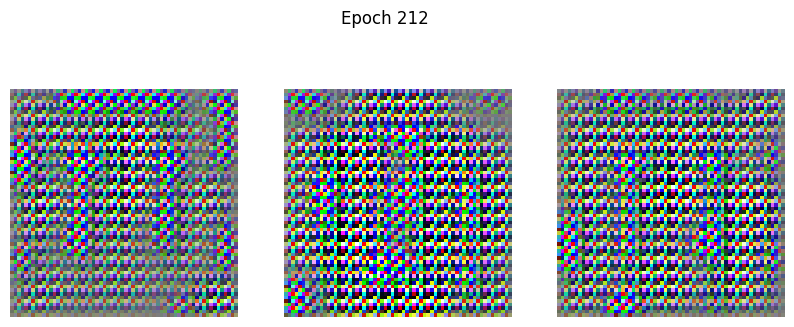

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step - d_loss: 0.1782 - g_loss: 7.6312
Epoch 213/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1053 - g_loss: 6.2927

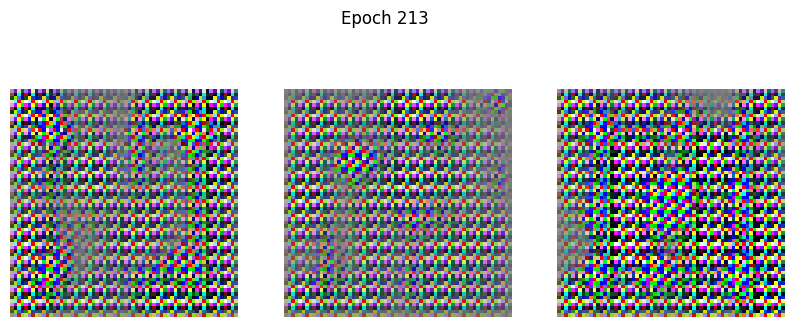

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.1112 - g_loss: 6.3505
Epoch 214/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1901 - g_loss: 7.9117 

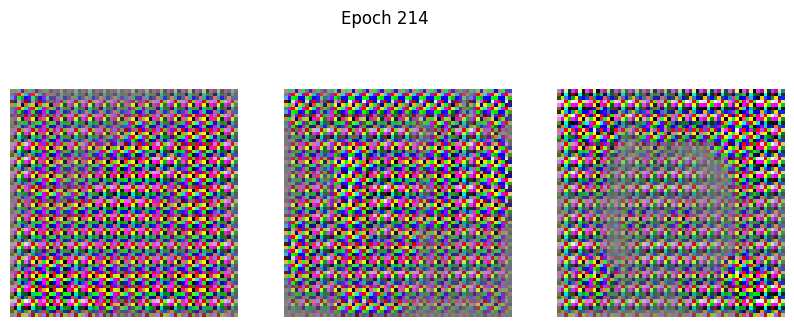

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.1836 - g_loss: 7.6425
Epoch 215/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2724 - g_loss: 6.7406

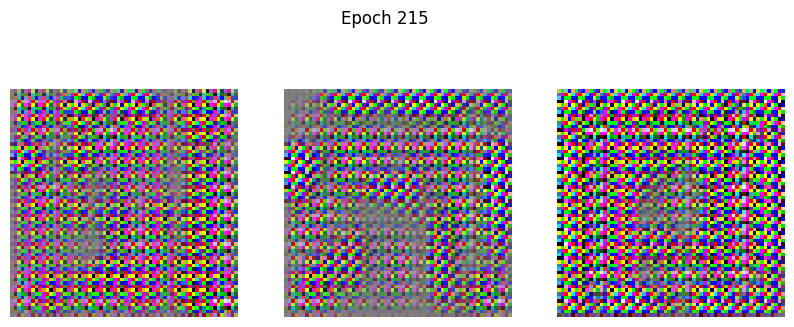

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.2692 - g_loss: 6.5899
Epoch 216/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1396 - g_loss: 6.0329 

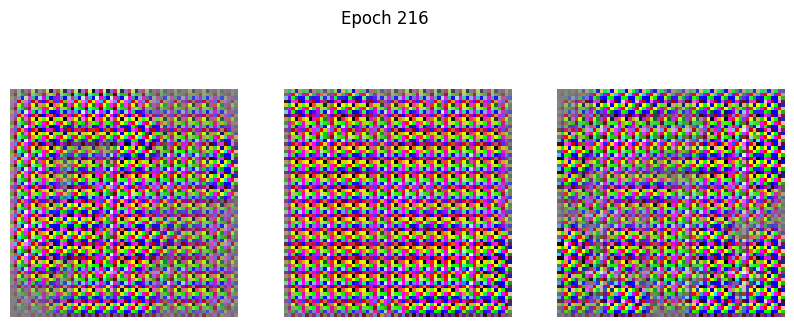

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1346 - g_loss: 6.0614
Epoch 217/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1792 - g_loss: 9.4699  

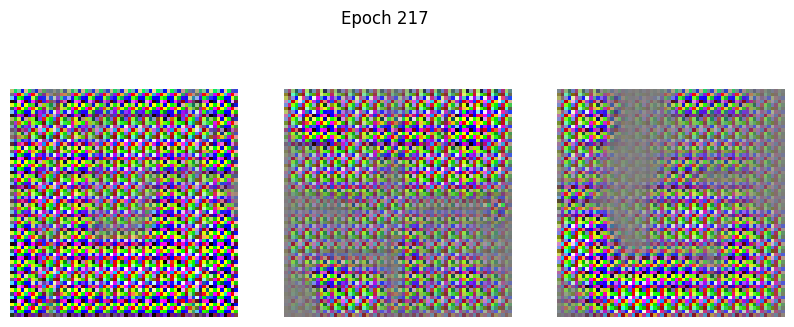

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.1713 - g_loss: 9.2449
Epoch 218/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1847 - g_loss: 8.1632 

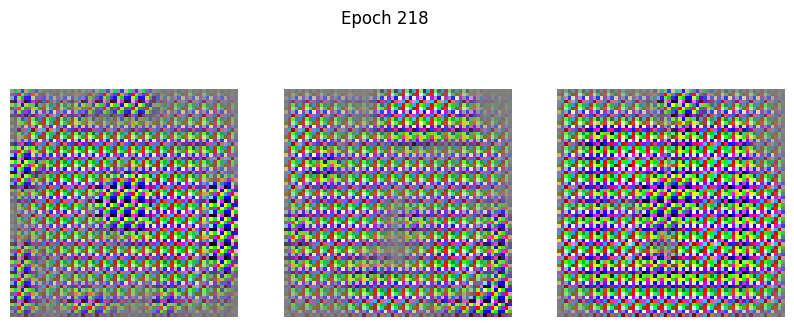

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1768 - g_loss: 8.1354
Epoch 219/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.1302 - g_loss: 8.1746 

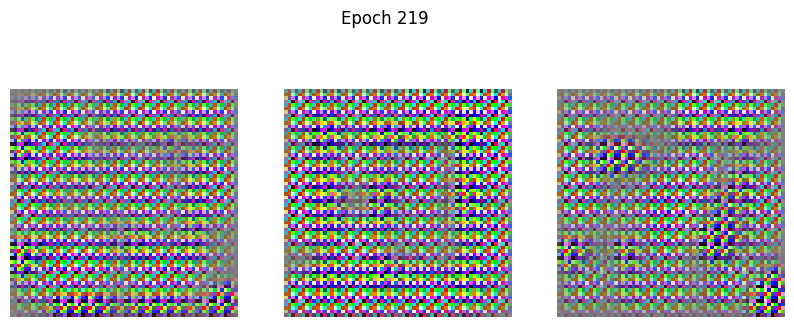

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.1301 - g_loss: 8.6752
Epoch 220/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1819 - g_loss: 10.0229

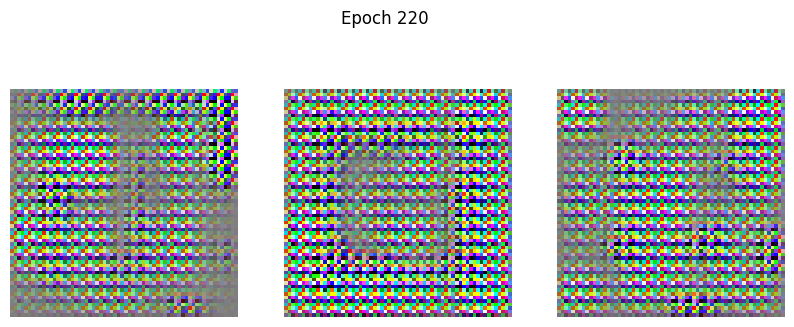

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.1916 - g_loss: 10.8283
Epoch 221/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2559 - g_loss: 8.2124

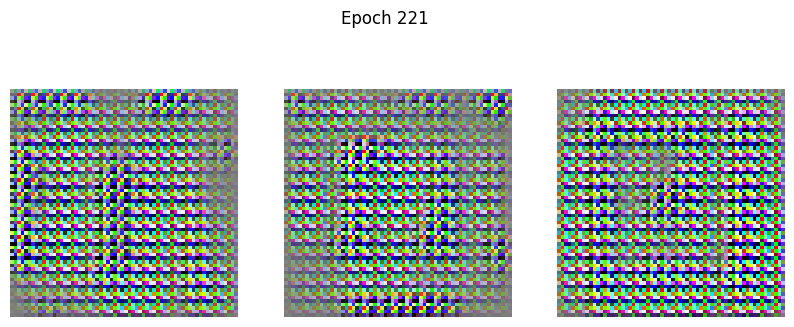

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.2490 - g_loss: 7.7365
Epoch 222/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.6140 - g_loss: 12.5824 

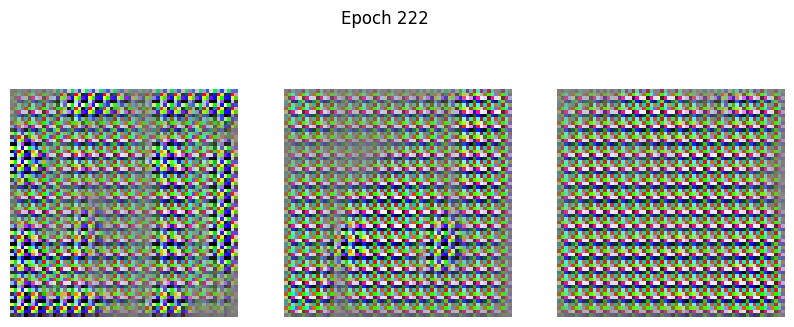

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step - d_loss: 0.5897 - g_loss: 12.4734
Epoch 223/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1501 - g_loss: 6.6119

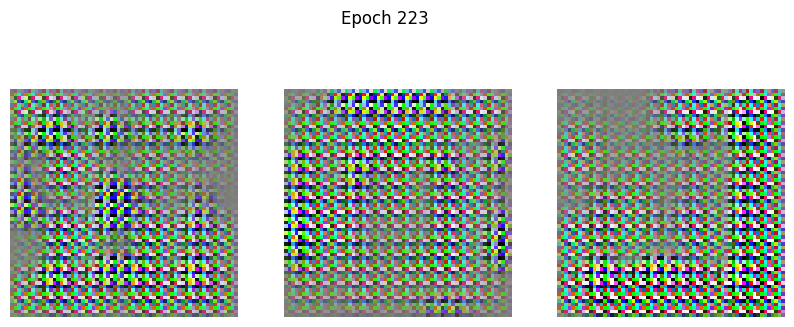

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 233ms/step - d_loss: 0.1410 - g_loss: 6.3294
Epoch 224/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0714 - g_loss: 3.8080

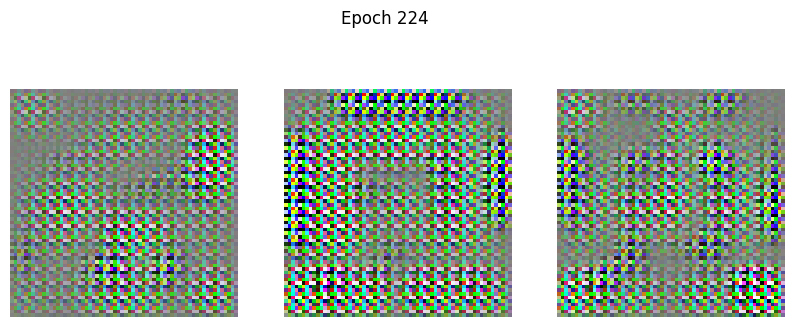

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step - d_loss: 0.0783 - g_loss: 4.0651
Epoch 225/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0314 - g_loss: 5.9798 

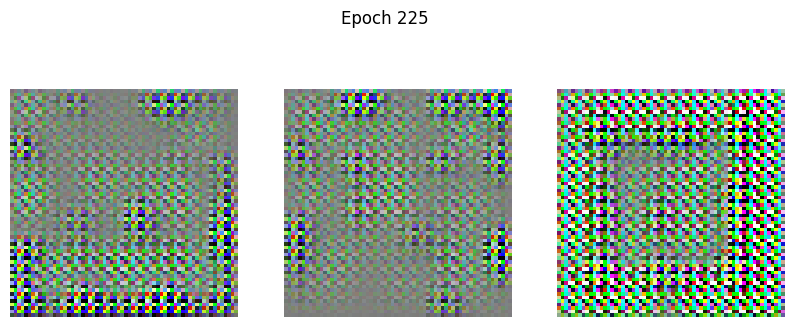

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0294 - g_loss: 5.8400
Epoch 226/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0646 - g_loss: 4.4092

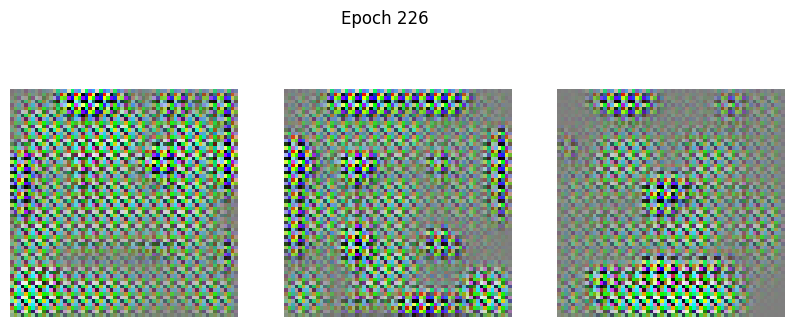

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step - d_loss: 0.0697 - g_loss: 4.5427
Epoch 227/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0560 - g_loss: 4.8214 

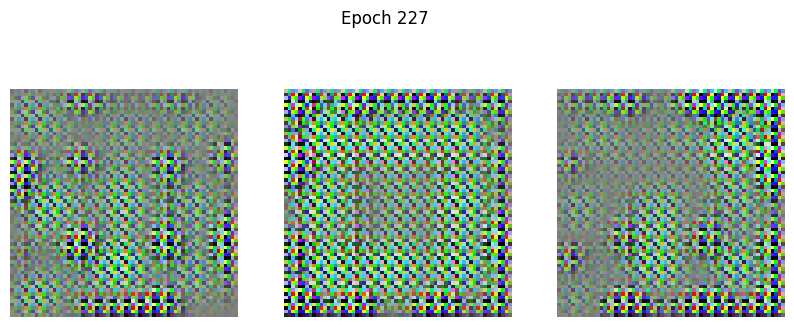

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 241ms/step - d_loss: 0.0546 - g_loss: 4.7452
Epoch 228/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0729 - g_loss: 4.6466 

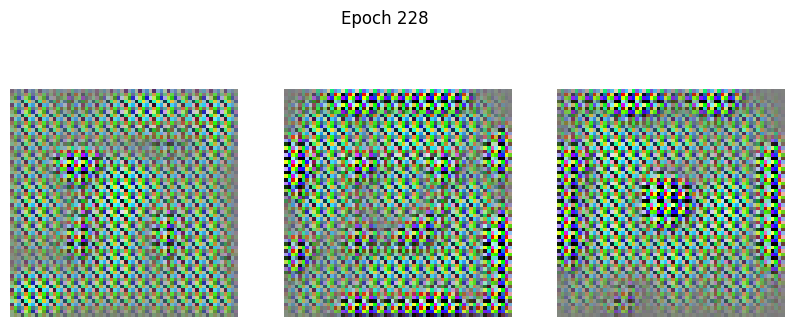

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0687 - g_loss: 4.6375
Epoch 229/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0479 - g_loss: 4.0795 

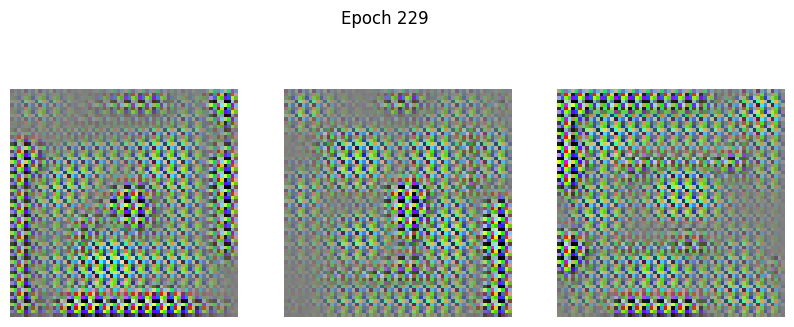

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0468 - g_loss: 4.0810
Epoch 230/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0731 - g_loss: 4.5637 

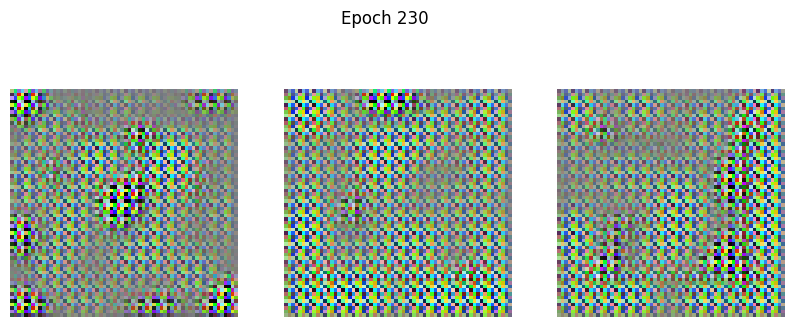

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.0722 - g_loss: 4.6195
Epoch 231/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0823 - g_loss: 5.1718

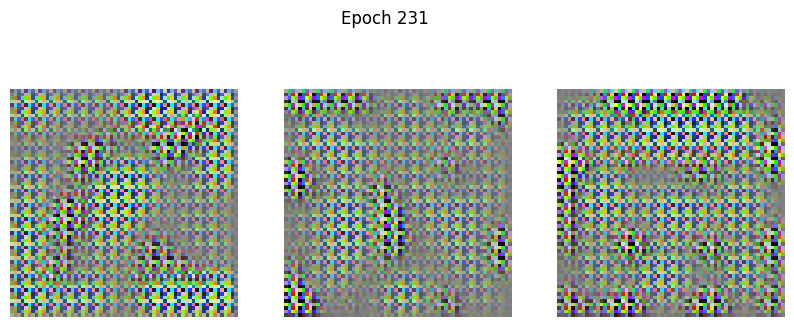

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step - d_loss: 0.0856 - g_loss: 5.1315
Epoch 232/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1225 - g_loss: 5.2103

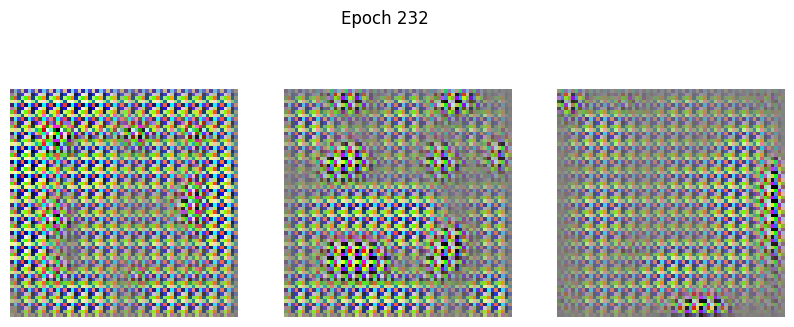

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 216ms/step - d_loss: 0.1259 - g_loss: 5.2055
Epoch 233/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1322 - g_loss: 5.6237

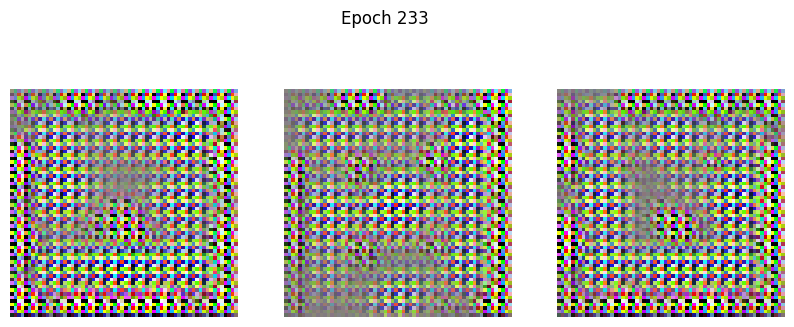

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step - d_loss: 0.1337 - g_loss: 5.5471
Epoch 234/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1162 - g_loss: 6.9100 

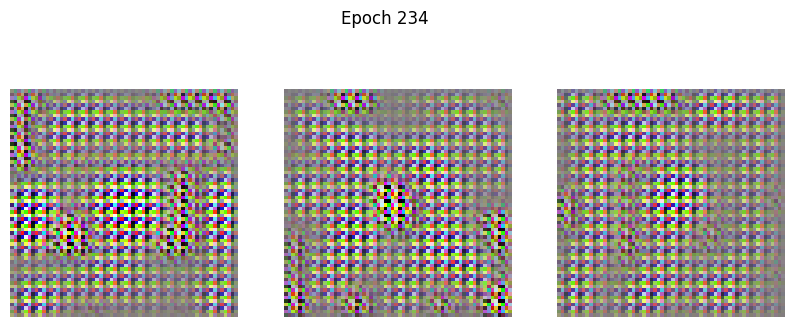

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.1088 - g_loss: 6.8373
Epoch 235/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0770 - g_loss: 4.6636 

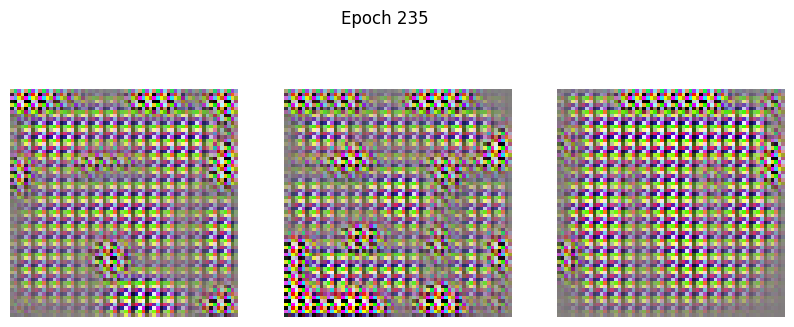

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.0809 - g_loss: 4.8933
Epoch 236/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0688 - g_loss: 6.1705 

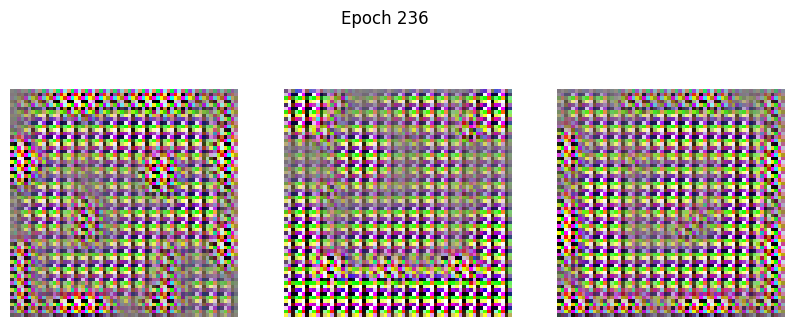

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0685 - g_loss: 6.1071
Epoch 237/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.0905 - g_loss: 6.1009

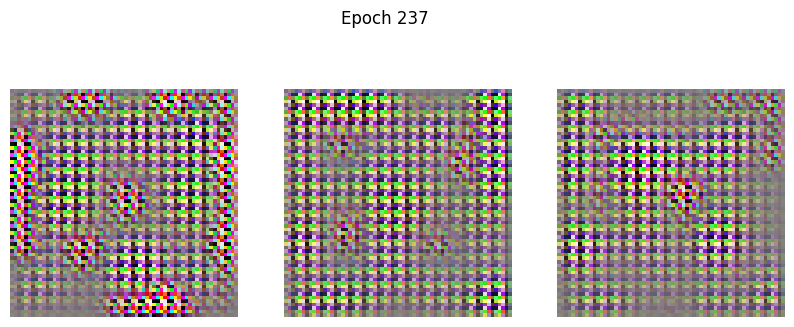

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step - d_loss: 0.0926 - g_loss: 5.9782
Epoch 238/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0896 - g_loss: 5.1539 

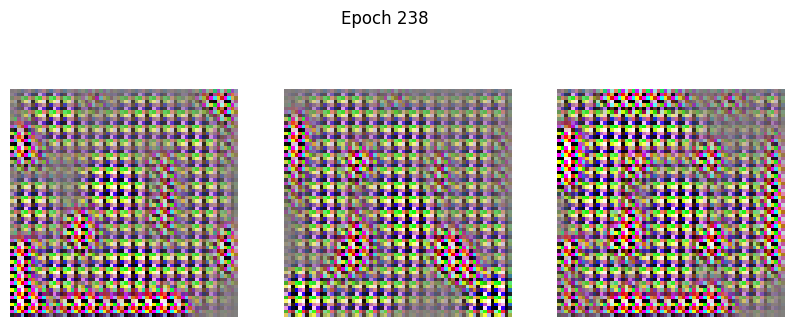

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.0882 - g_loss: 5.3190
Epoch 239/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0651 - g_loss: 5.1733 

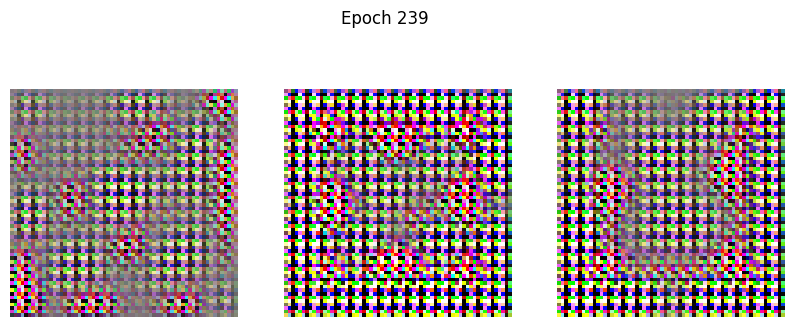

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0625 - g_loss: 5.1198
Epoch 240/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0579 - g_loss: 5.1882 

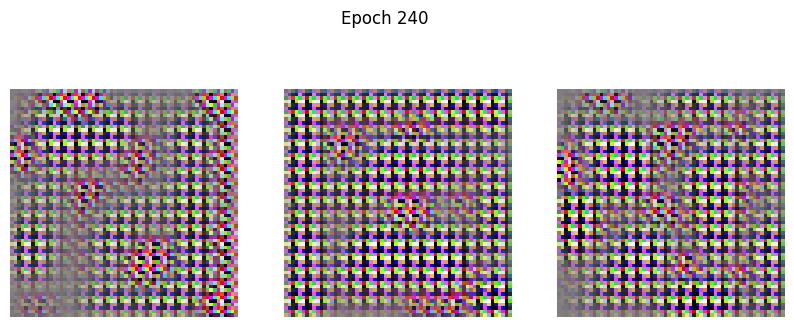

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0557 - g_loss: 5.2138
Epoch 241/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0582 - g_loss: 4.6030 

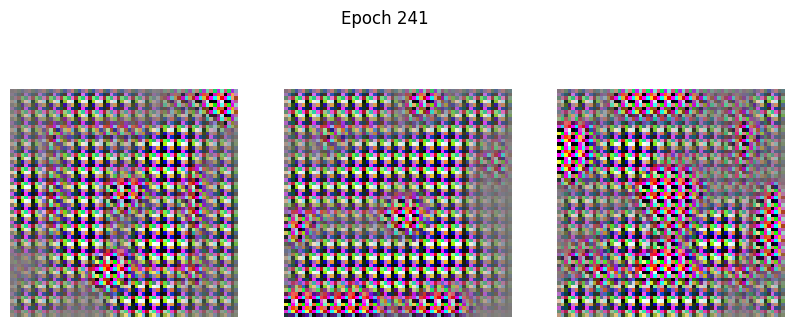

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0582 - g_loss: 4.7039
Epoch 242/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0507 - g_loss: 4.5505 

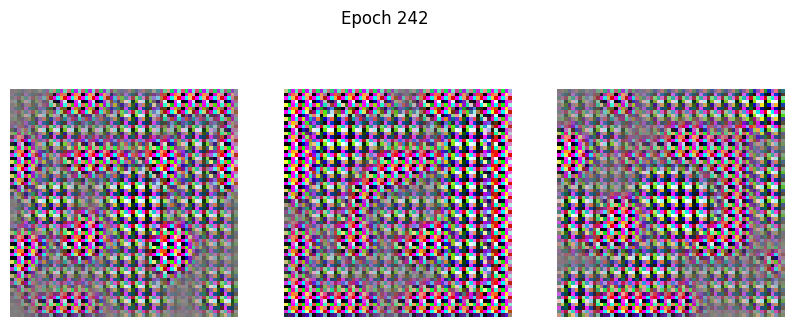

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0487 - g_loss: 4.5445
Epoch 243/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0612 - g_loss: 4.9019 

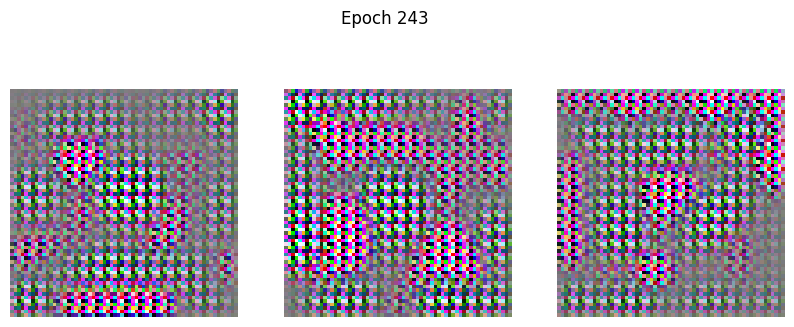

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.0608 - g_loss: 4.9655
Epoch 244/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0953 - g_loss: 5.3392 

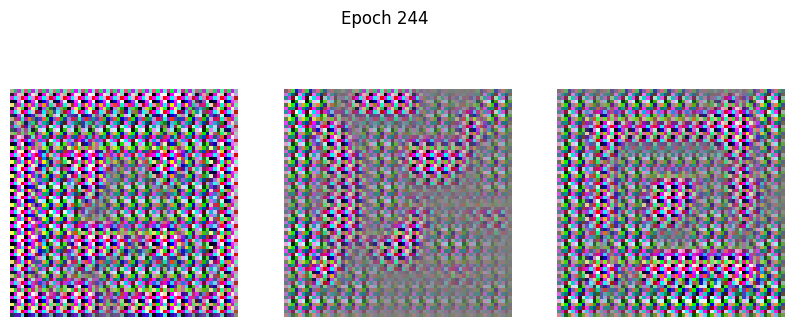

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step - d_loss: 0.0976 - g_loss: 5.4355
Epoch 245/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1333 - g_loss: 4.7741

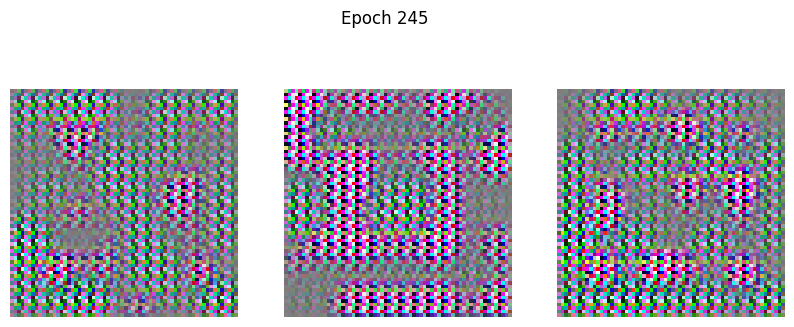

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 223ms/step - d_loss: 0.1419 - g_loss: 4.7807
Epoch 246/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1507 - g_loss: 4.7025

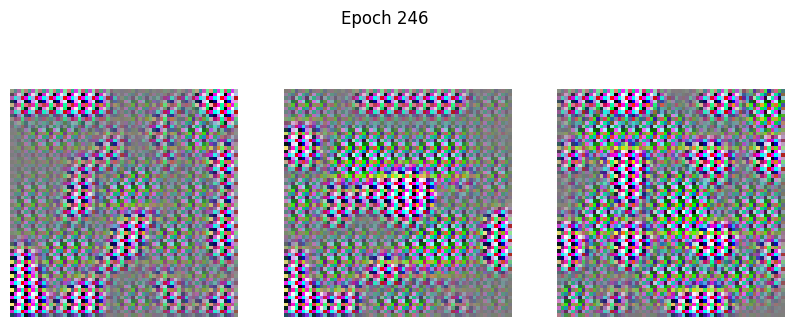

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1529 - g_loss: 4.6187
Epoch 247/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1280 - g_loss: 5.0749

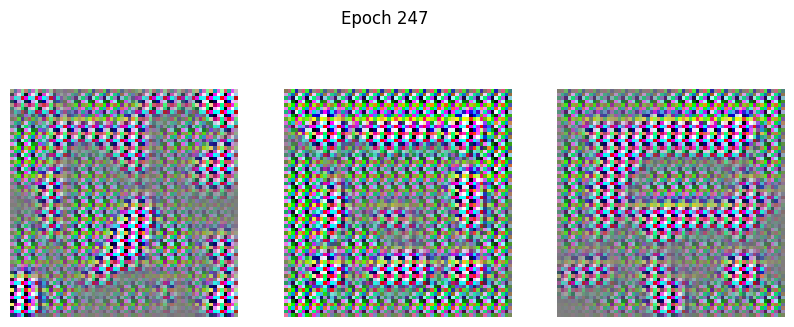

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1284 - g_loss: 5.0332
Epoch 248/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.1229 - g_loss: 5.0580

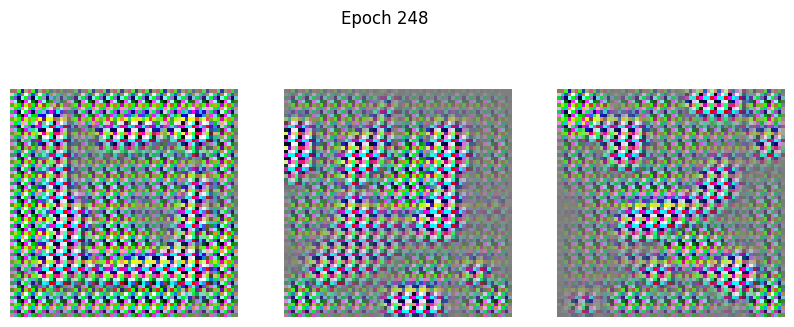

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1249 - g_loss: 5.0090
Epoch 249/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1565 - g_loss: 5.7871

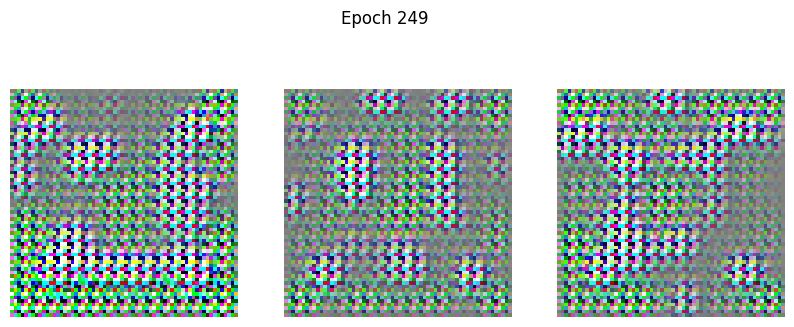

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1564 - g_loss: 5.5884
Epoch 250/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1112 - g_loss: 5.6642

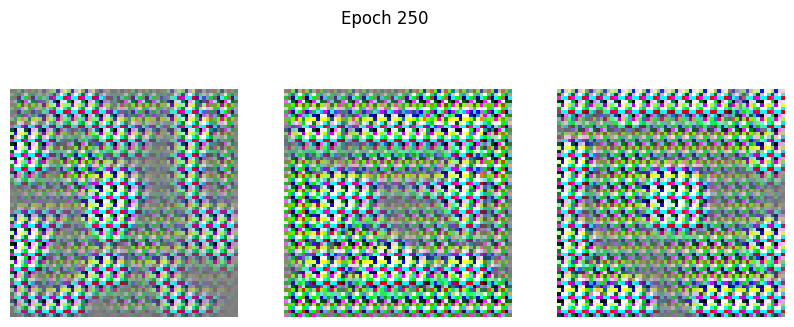

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1091 - g_loss: 5.7153
Epoch 251/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1048 - g_loss: 5.9894 

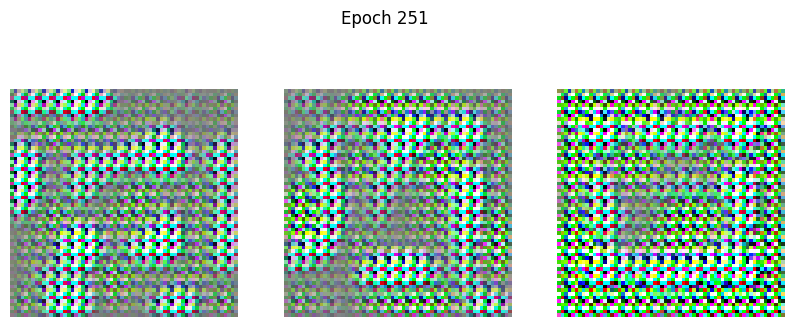

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - d_loss: 0.1085 - g_loss: 6.2478
Epoch 252/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1114 - g_loss: 5.2483

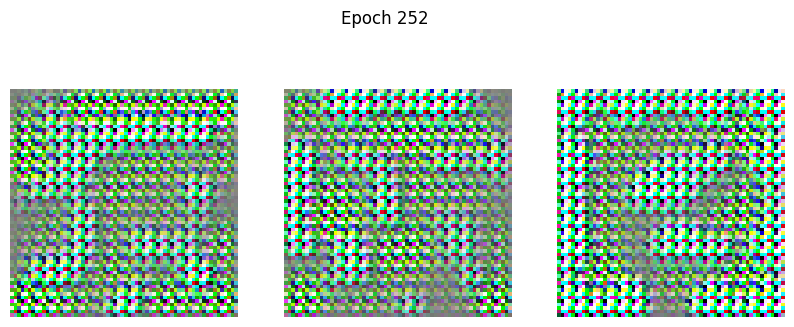

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1075 - g_loss: 5.0995
Epoch 253/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - d_loss: 0.1414 - g_loss: 8.3067

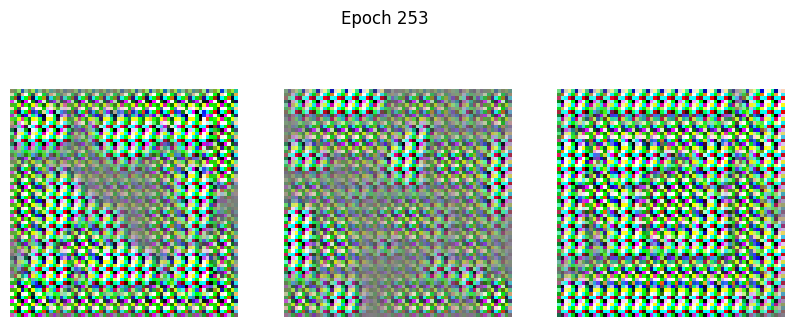

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.1366 - g_loss: 8.2241
Epoch 254/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0462 - g_loss: 4.9220

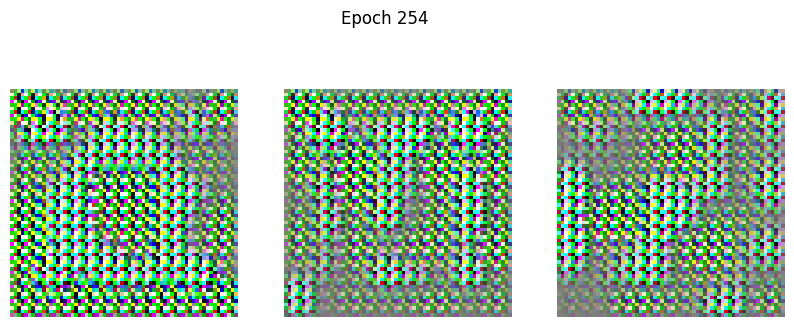

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.0495 - g_loss: 4.9344
Epoch 255/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0649 - g_loss: 6.4497

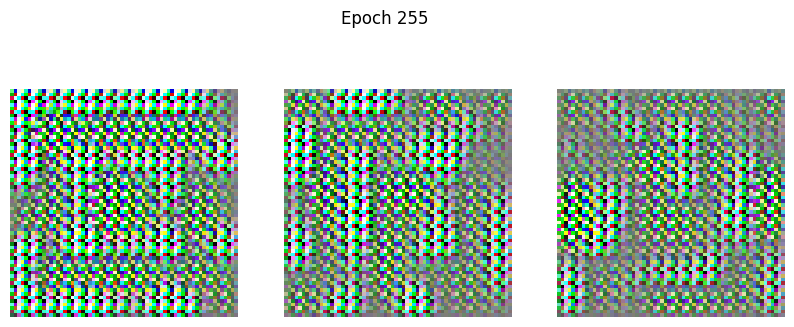

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.0643 - g_loss: 6.3390
Epoch 256/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0736 - g_loss: 5.9053

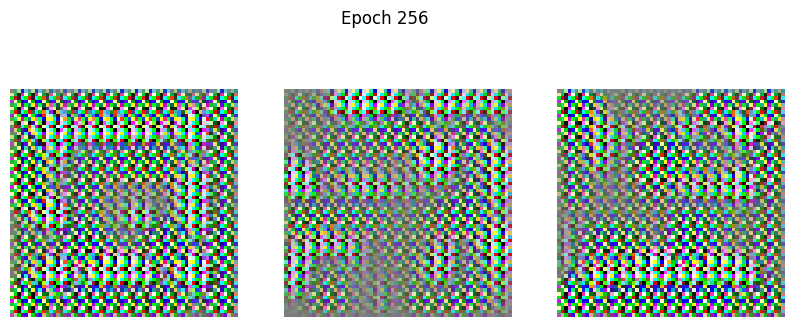

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0785 - g_loss: 6.0246
Epoch 257/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1343 - g_loss: 6.9651 

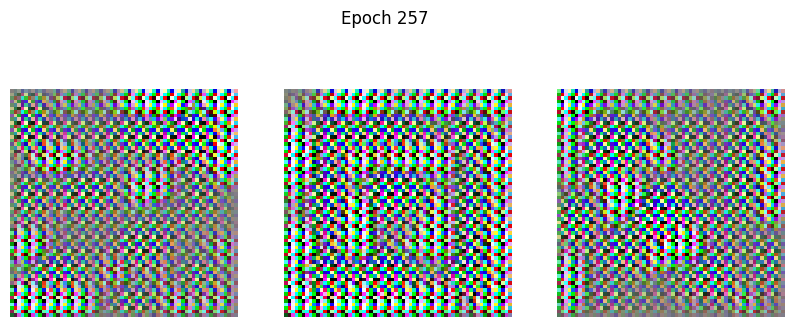

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1411 - g_loss: 7.6319
Epoch 258/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.2014 - g_loss: 9.4893

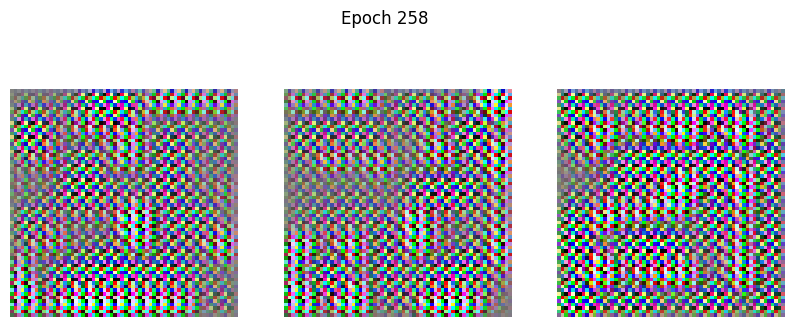

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step - d_loss: 0.1894 - g_loss: 8.9641
Epoch 259/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.2557 - g_loss: 17.9417

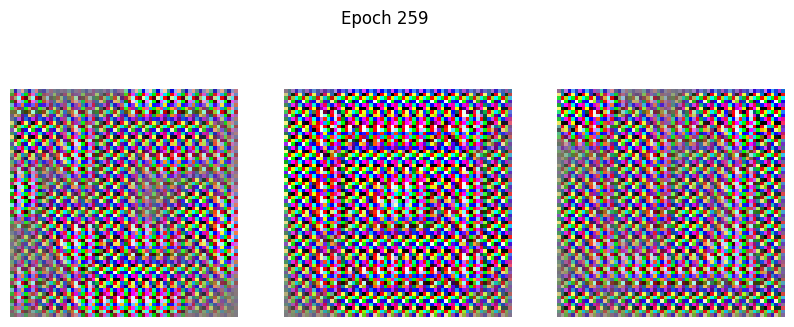

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.2541 - g_loss: 17.9167
Epoch 260/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1140 - g_loss: 8.8705 

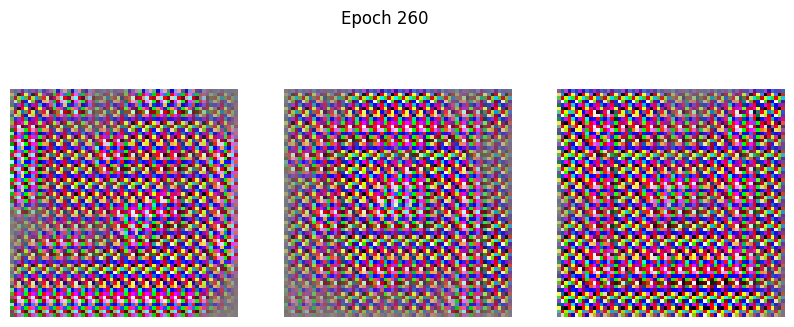

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1049 - g_loss: 8.5465
Epoch 261/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.7692 - g_loss: 32.9258

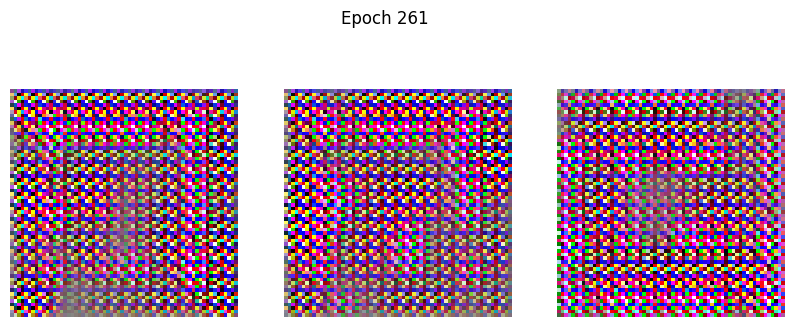

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step - d_loss: 0.8494 - g_loss: 32.2593
Epoch 262/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1370 - g_loss: 11.5895 

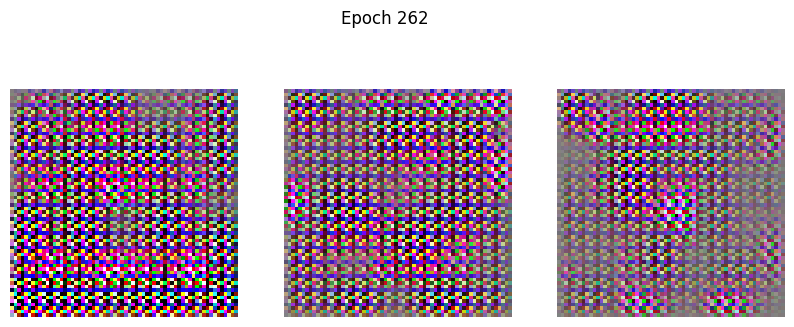

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 227ms/step - d_loss: 0.1194 - g_loss: 10.6422
Epoch 263/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step - d_loss: 1.2232 - g_loss: 19.8293

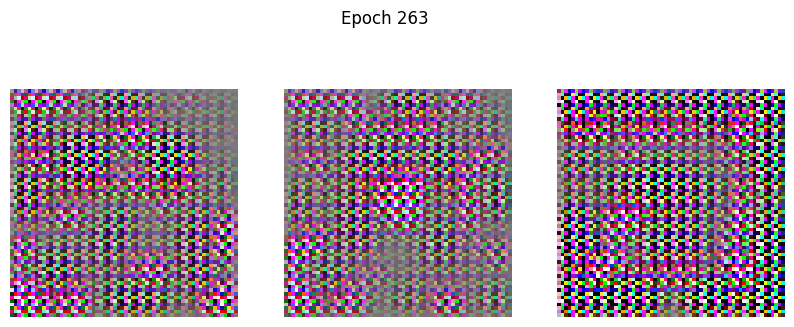

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step - d_loss: 1.0990 - g_loss: 19.8533
Epoch 264/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1710 - g_loss: 9.2826  

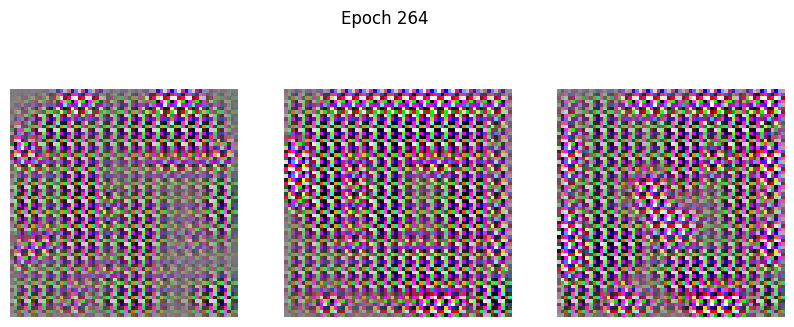

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1606 - g_loss: 8.6495
Epoch 265/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.4162 - g_loss: 10.0061

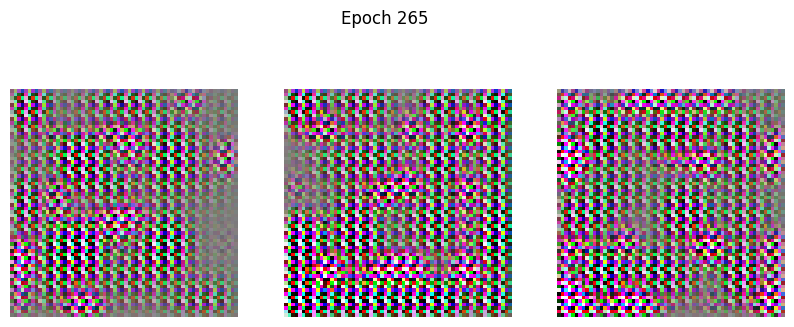

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 202ms/step - d_loss: 0.3901 - g_loss: 10.0189
Epoch 266/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1184 - g_loss: 5.8003

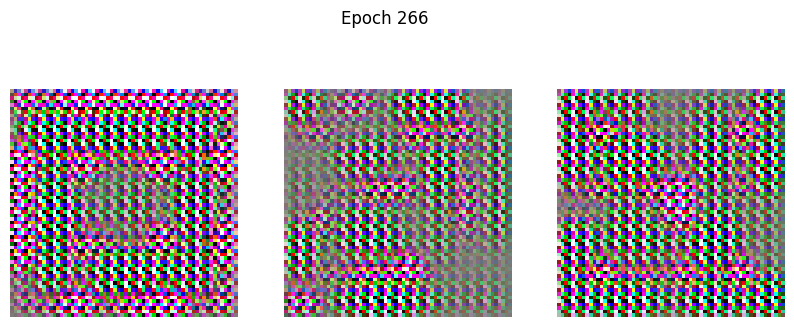

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - d_loss: 0.1148 - g_loss: 5.5076
Epoch 267/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.2769 - g_loss: 9.7879

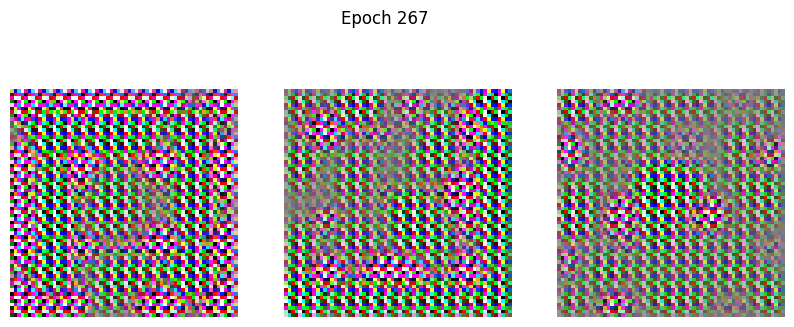

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - d_loss: 0.2637 - g_loss: 9.8098
Epoch 268/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0848 - g_loss: 5.7412

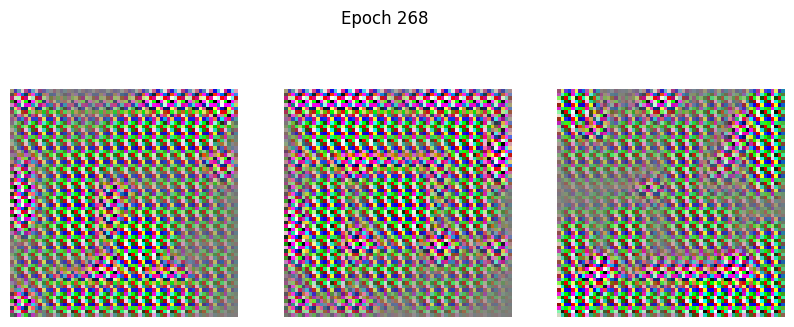

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step - d_loss: 0.0831 - g_loss: 5.4599
Epoch 269/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1432 - g_loss: 5.0887 

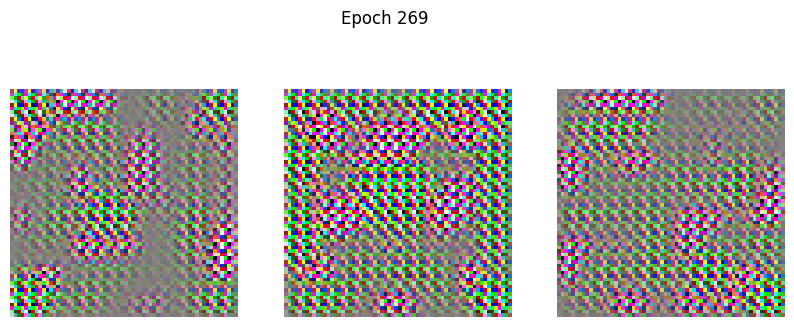

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 166ms/step - d_loss: 0.1339 - g_loss: 5.1355
Epoch 270/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0897 - g_loss: 4.3563

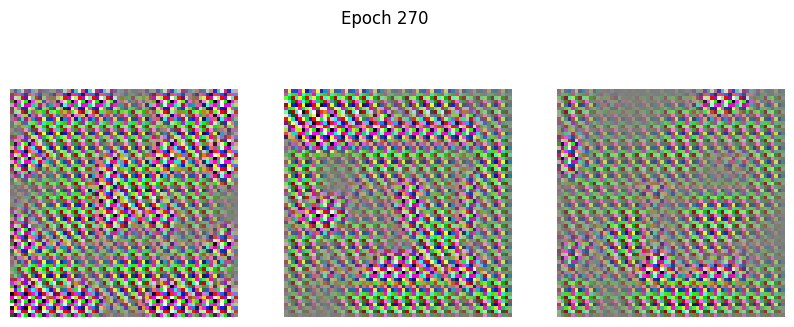

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0984 - g_loss: 4.3253
Epoch 271/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2003 - g_loss: 4.7039 

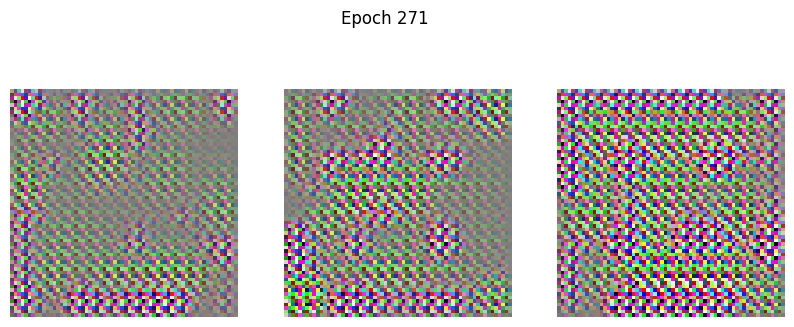

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1967 - g_loss: 4.7251
Epoch 272/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.2594 - g_loss: 4.4070 

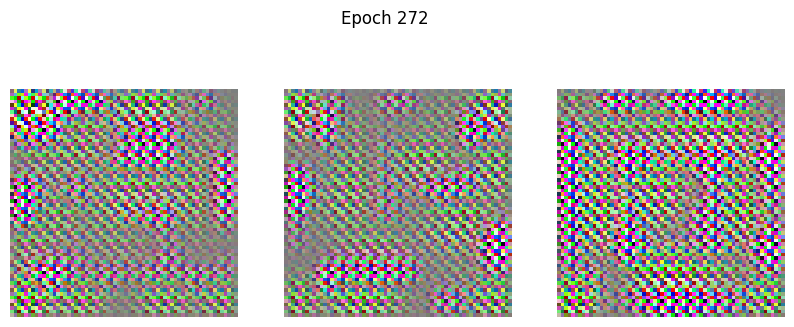

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.2572 - g_loss: 4.6124
Epoch 273/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.2509 - g_loss: 4.3848 

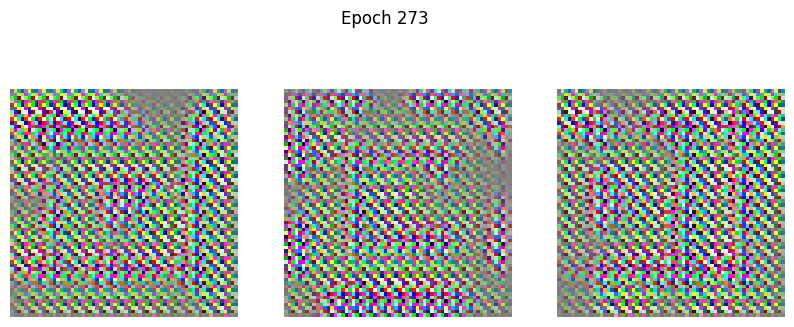

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.2439 - g_loss: 4.5722
Epoch 274/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1226 - g_loss: 5.4616

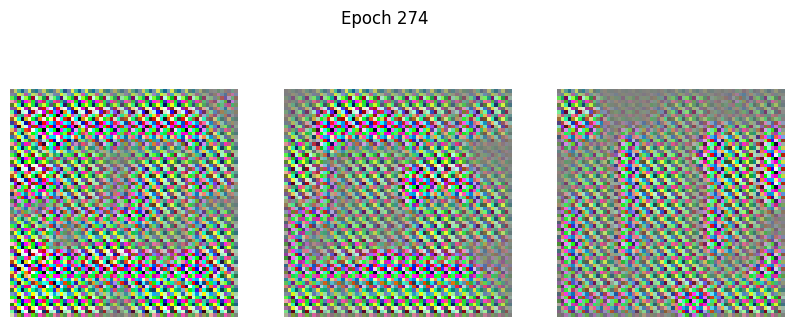

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step - d_loss: 0.1310 - g_loss: 5.4138
Epoch 275/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1686 - g_loss: 5.2663 

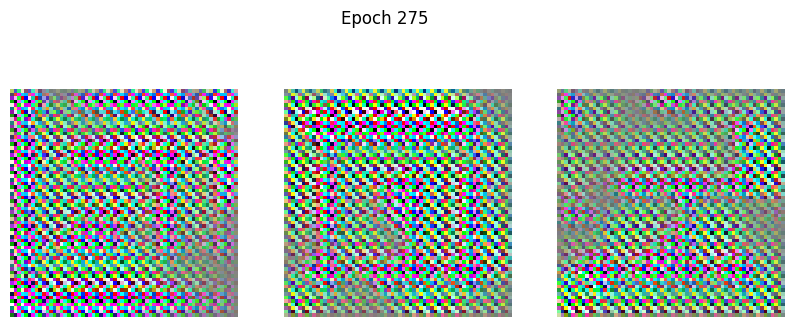

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1640 - g_loss: 5.2972
Epoch 276/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1340 - g_loss: 5.2429

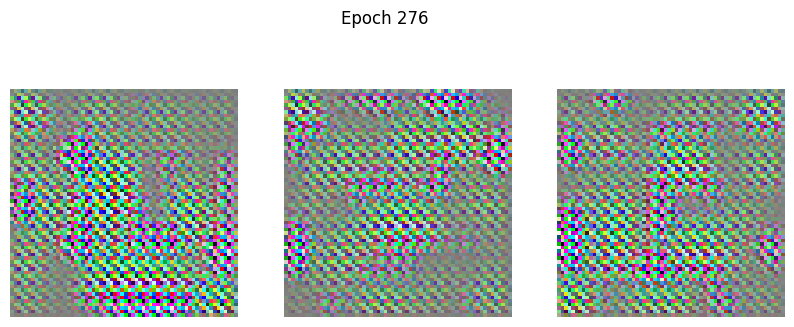

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1343 - g_loss: 5.1185
Epoch 277/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1102 - g_loss: 5.2913 

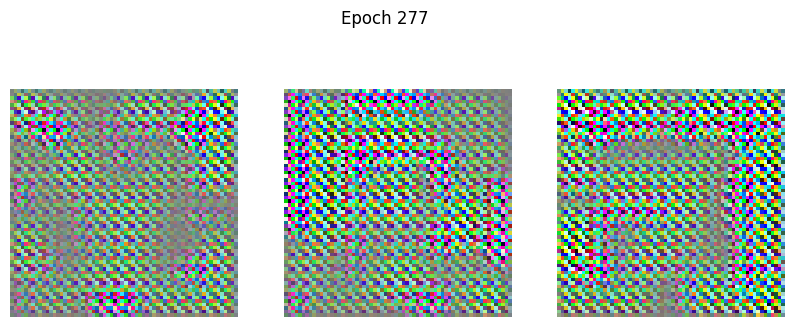

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1048 - g_loss: 5.3142
Epoch 278/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0599 - g_loss: 4.6527

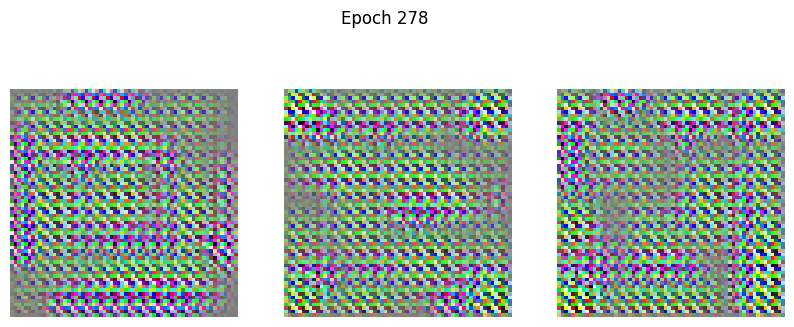

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step - d_loss: 0.0627 - g_loss: 4.6731
Epoch 279/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0822 - g_loss: 4.9467 

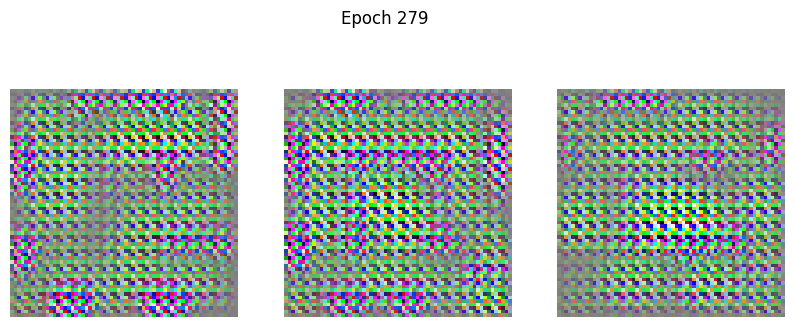

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0806 - g_loss: 4.9817
Epoch 280/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0836 - g_loss: 4.6773

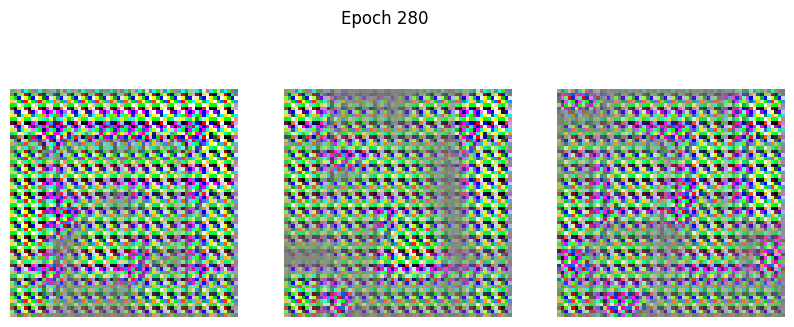

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0860 - g_loss: 4.6348
Epoch 281/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1026 - g_loss: 5.3045

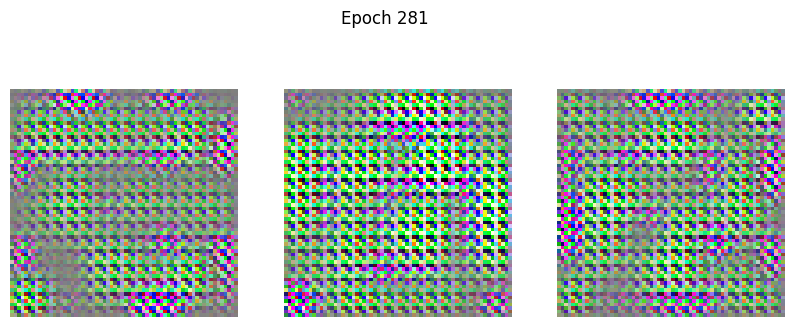

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1031 - g_loss: 5.2440
Epoch 282/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0957 - g_loss: 5.4145

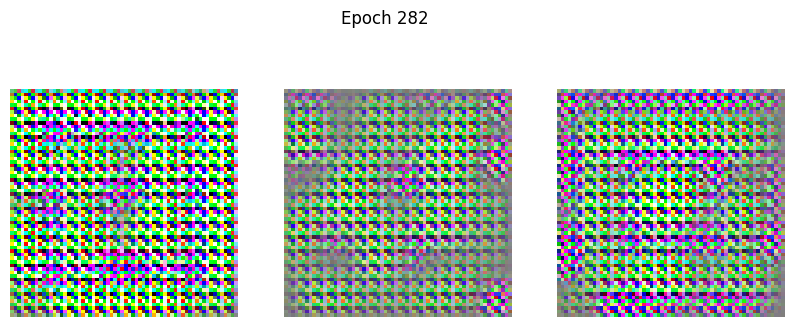

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0973 - g_loss: 5.3850
Epoch 283/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0810 - g_loss: 5.6772

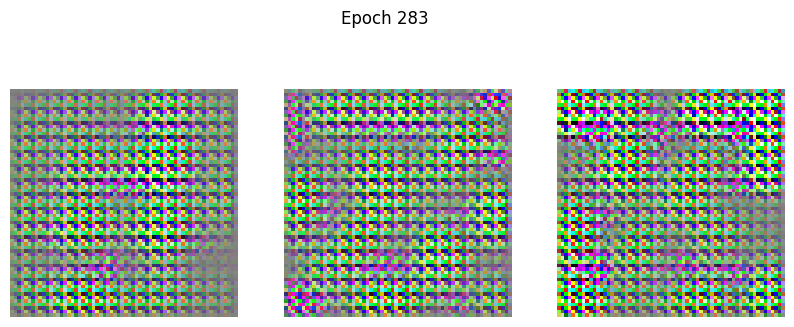

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0821 - g_loss: 5.5414
Epoch 284/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0512 - g_loss: 5.0124

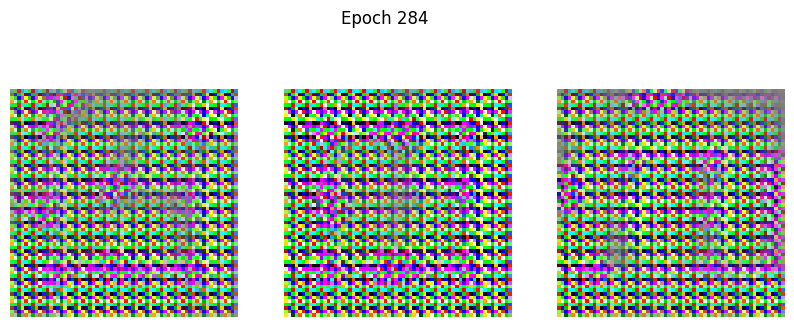

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0531 - g_loss: 5.0455
Epoch 285/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0593 - g_loss: 5.1193 

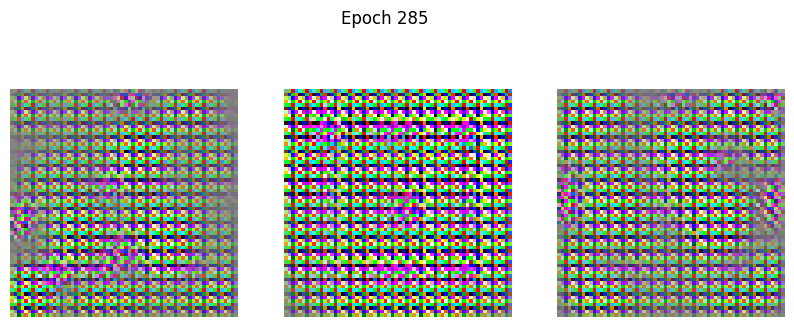

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.0578 - g_loss: 5.2153
Epoch 286/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0342 - g_loss: 4.6227

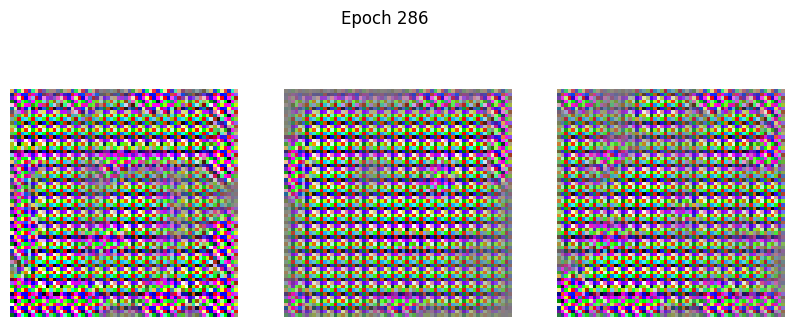

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0355 - g_loss: 4.5667
Epoch 287/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0442 - g_loss: 5.1352 

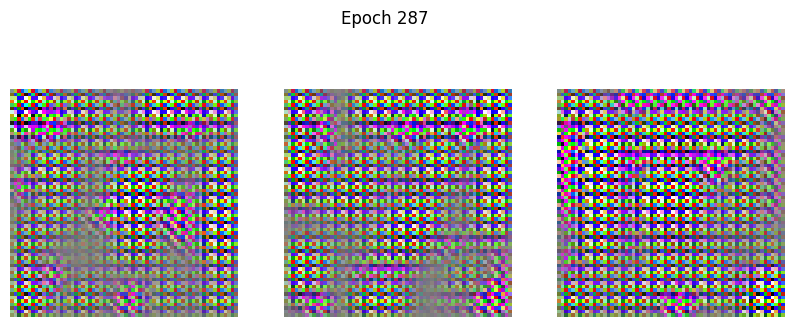

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.0426 - g_loss: 5.0734
Epoch 288/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0448 - g_loss: 5.4237

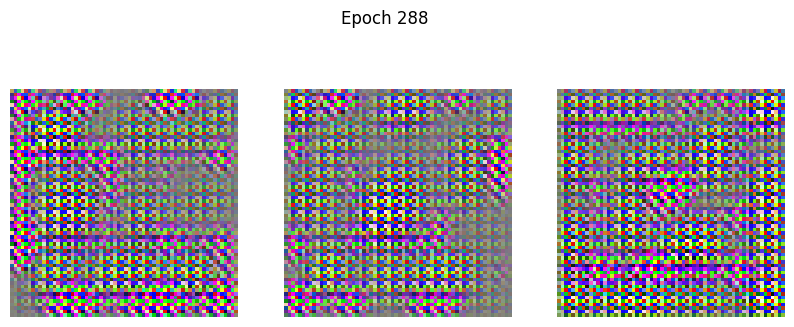

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0455 - g_loss: 5.4343
Epoch 289/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0431 - g_loss: 5.4273

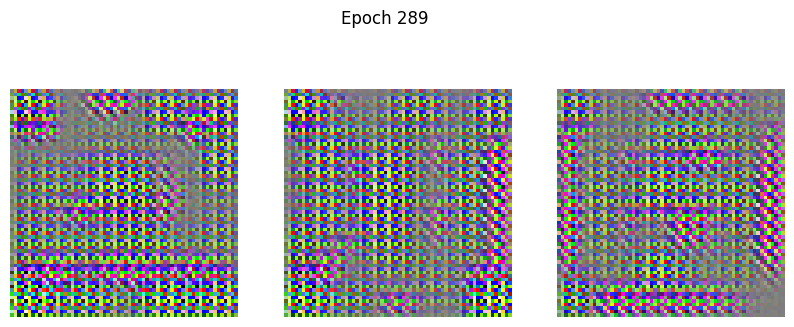

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.0456 - g_loss: 5.4535
Epoch 290/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0560 - g_loss: 5.9651

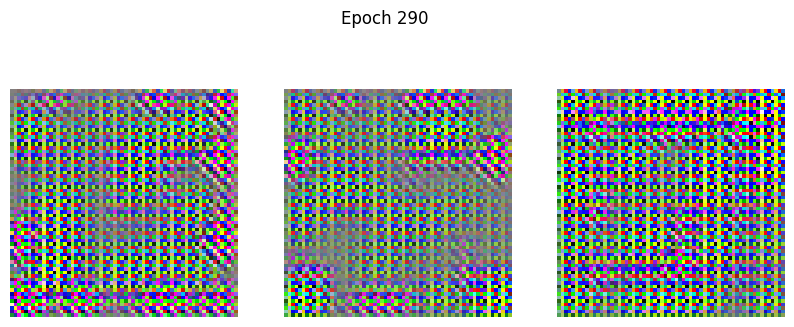

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0568 - g_loss: 5.8028
Epoch 291/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0658 - g_loss: 6.0967 

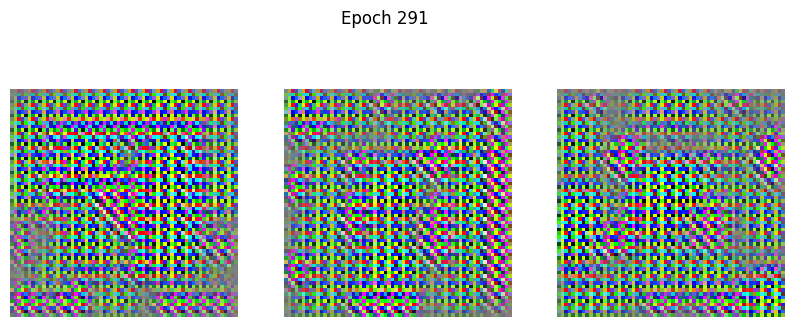

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0618 - g_loss: 5.9996
Epoch 292/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0469 - g_loss: 5.6835

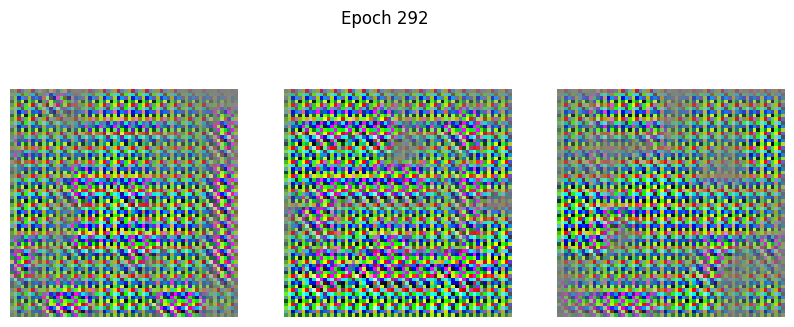

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0477 - g_loss: 5.6800
Epoch 293/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0566 - g_loss: 5.4666 

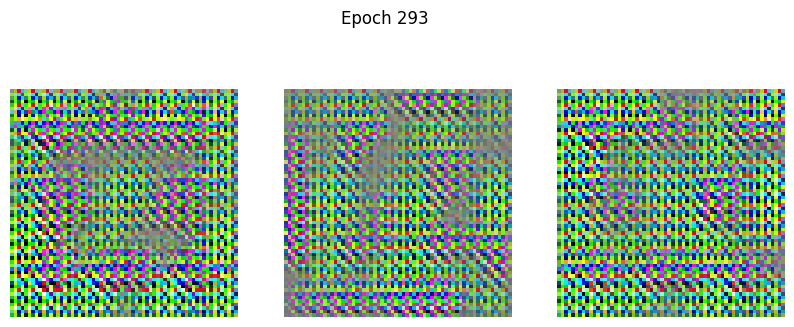

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step - d_loss: 0.0588 - g_loss: 5.6864
Epoch 294/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0966 - g_loss: 6.2708 

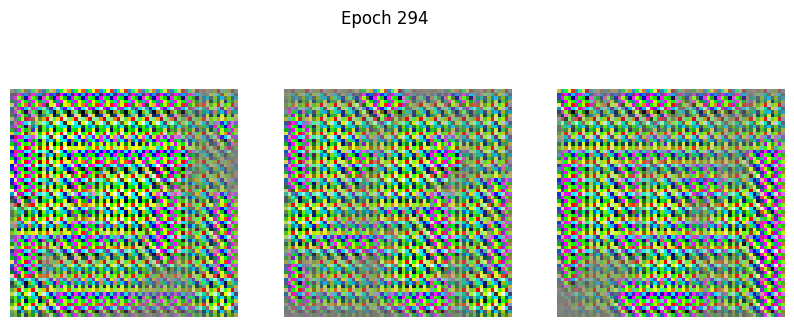

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1014 - g_loss: 6.5507
Epoch 295/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1405 - g_loss: 5.4174 

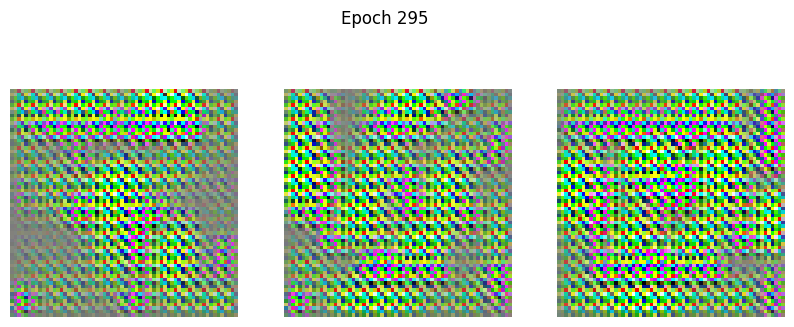

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1335 - g_loss: 5.4696
Epoch 296/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0515 - g_loss: 5.3693

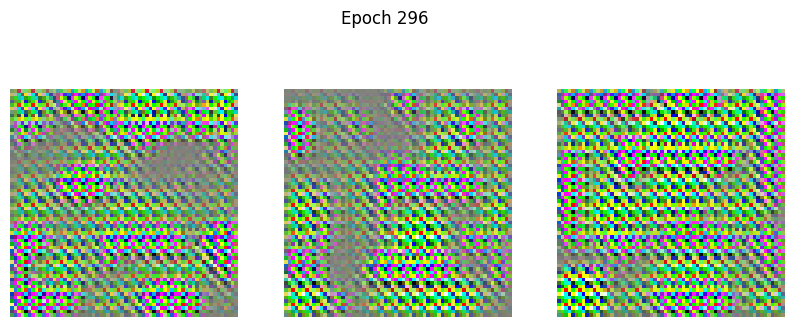

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0531 - g_loss: 5.4203
Epoch 297/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0510 - g_loss: 5.2041 

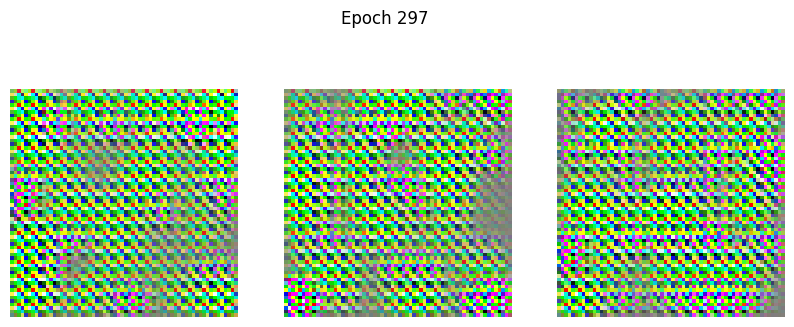

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.0487 - g_loss: 5.1310
Epoch 298/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0400 - g_loss: 5.0668

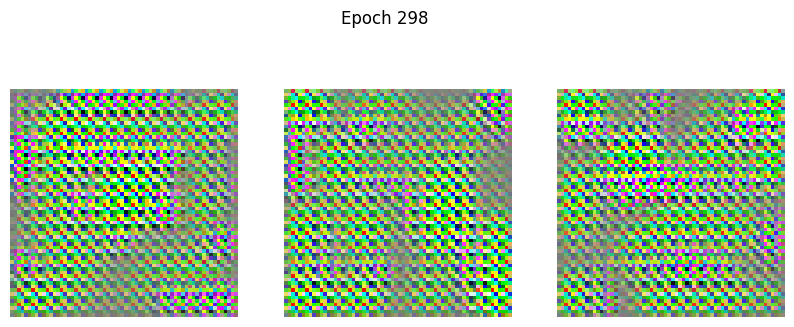

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0409 - g_loss: 5.0526
Epoch 299/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0329 - g_loss: 5.5082

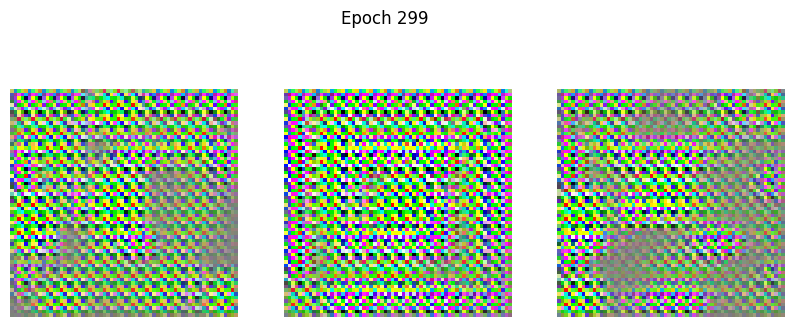

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0347 - g_loss: 5.4545
Epoch 300/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0457 - g_loss: 6.2254

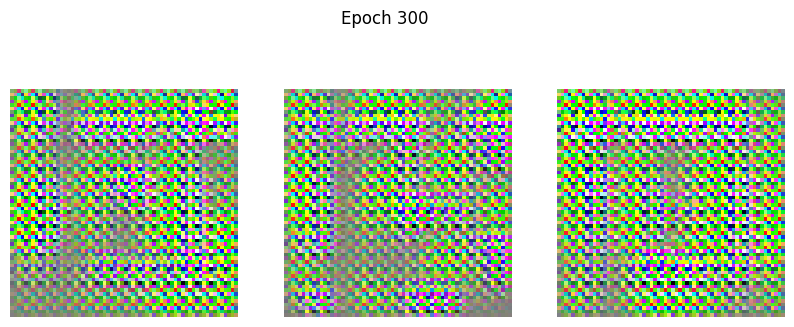

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0465 - g_loss: 6.1789
Epoch 301/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0460 - g_loss: 6.0951

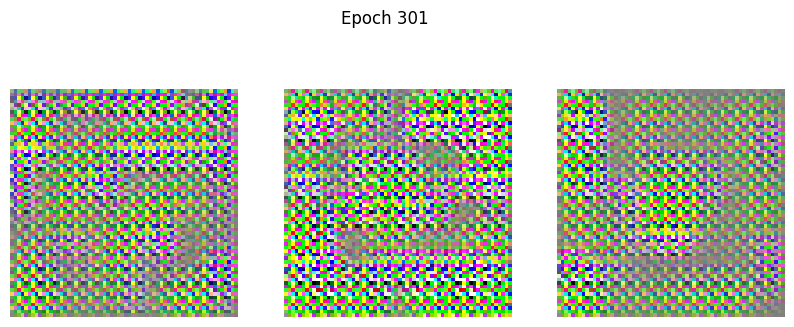

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.0476 - g_loss: 6.0447
Epoch 302/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - d_loss: 0.0432 - g_loss: 5.9375

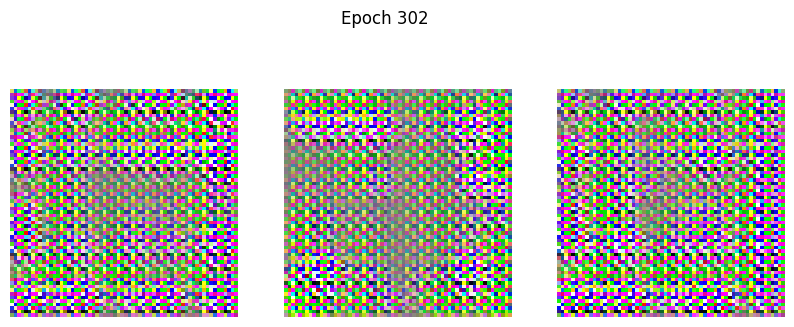

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0450 - g_loss: 5.8609
Epoch 303/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0470 - g_loss: 5.6921

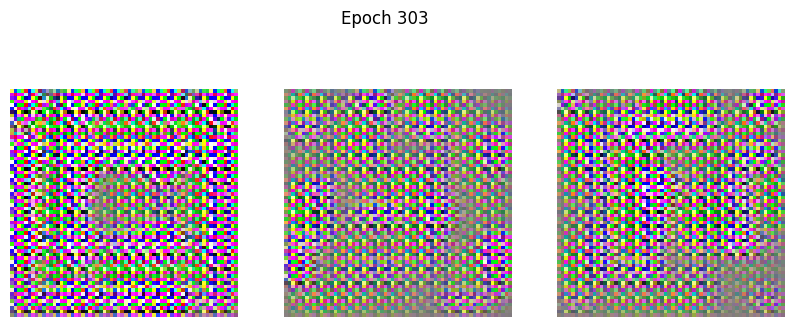

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - d_loss: 0.0482 - g_loss: 5.6055
Epoch 304/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0420 - g_loss: 5.9251

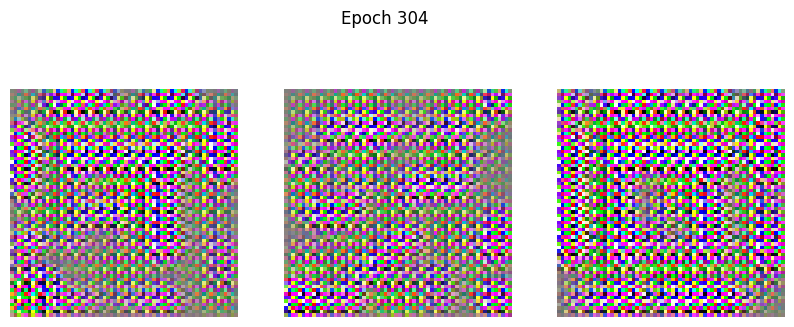

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step - d_loss: 0.0423 - g_loss: 5.8825
Epoch 305/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0342 - g_loss: 6.2967

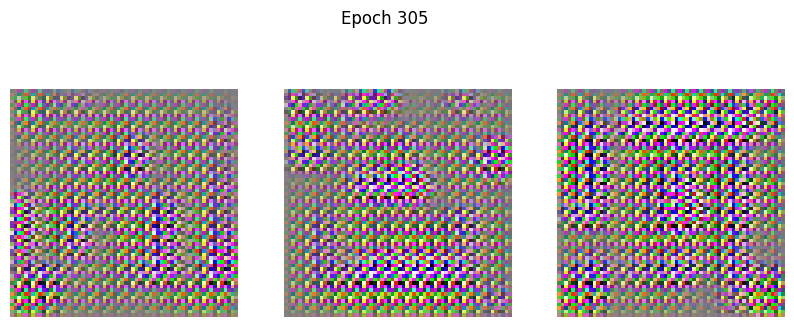

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step - d_loss: 0.0356 - g_loss: 6.1871
Epoch 306/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0876 - g_loss: 8.1321 

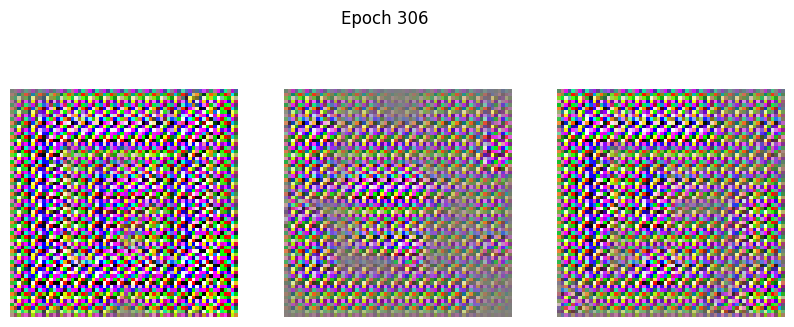

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0845 - g_loss: 7.9248
Epoch 307/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0744 - g_loss: 7.5728

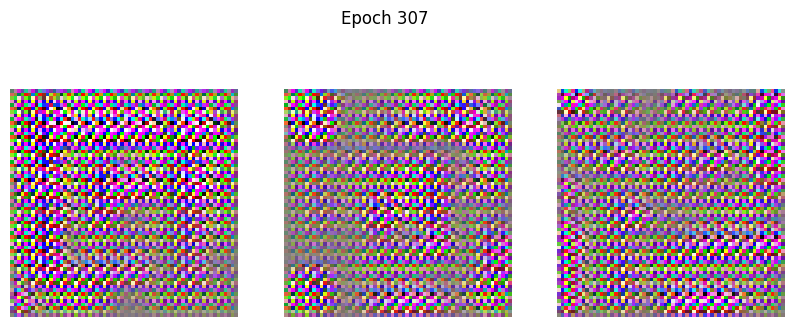

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 275ms/step - d_loss: 0.0748 - g_loss: 7.3897
Epoch 308/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1413 - g_loss: 9.7310  

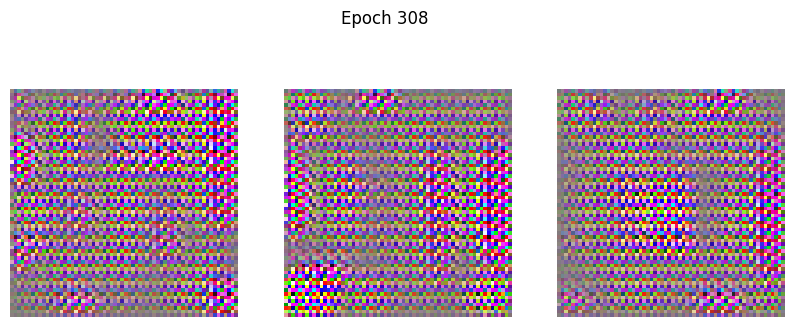

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 207ms/step - d_loss: 0.1371 - g_loss: 9.4817
Epoch 309/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0888 - g_loss: 6.2188

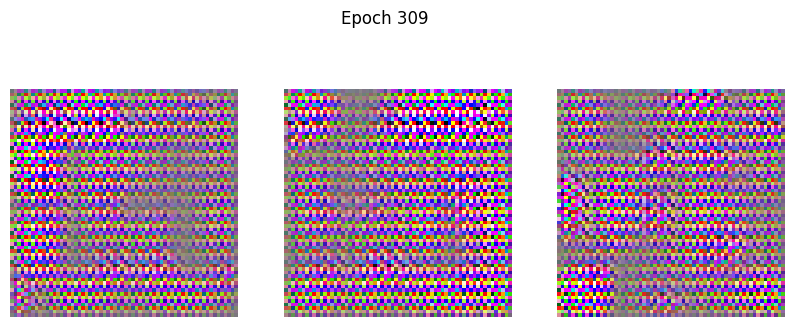

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 221ms/step - d_loss: 0.0933 - g_loss: 6.5848
Epoch 310/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0653 - g_loss: 6.9369

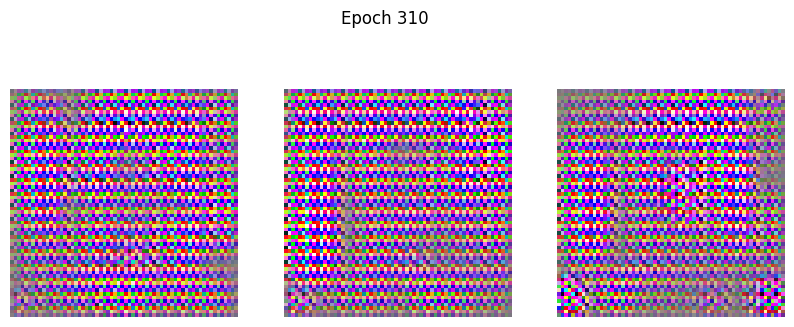

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0653 - g_loss: 6.6018
Epoch 311/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.5393 - g_loss: 22.0810

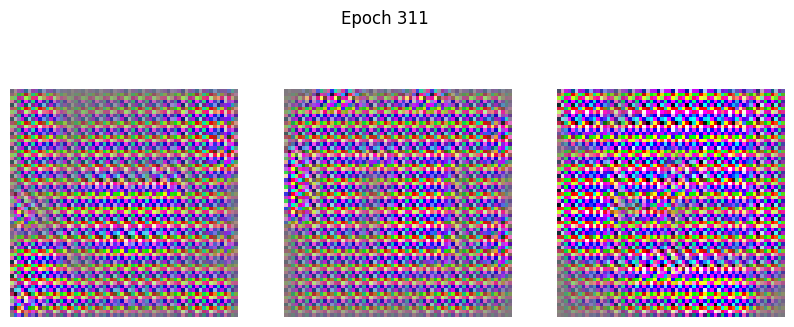

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.5793 - g_loss: 21.6148
Epoch 312/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0919 - g_loss: 9.6107  

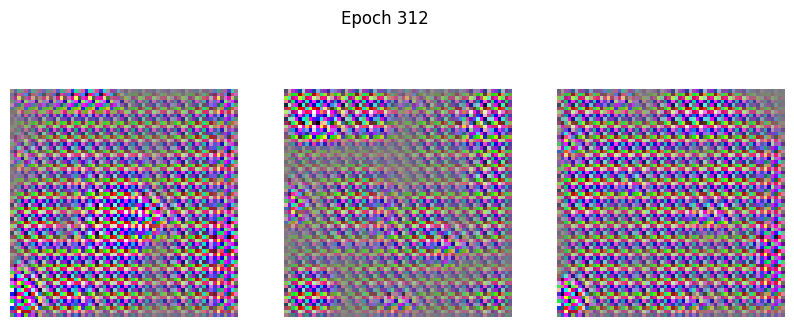

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0814 - g_loss: 9.0661
Epoch 313/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0614 - g_loss: 8.0993

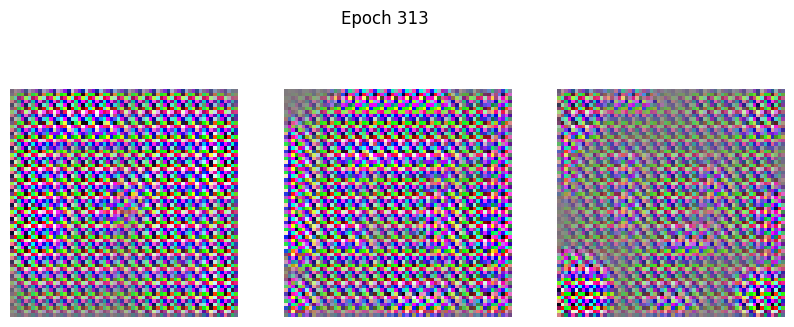

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0517 - g_loss: 8.0842
Epoch 314/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: -0.0221 - g_loss: 6.2234 

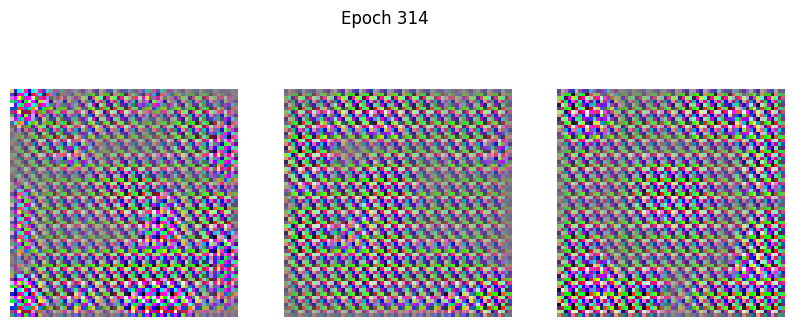

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step - d_loss: -0.0160 - g_loss: 6.4072
Epoch 315/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: -0.0108 - g_loss: 7.3527 

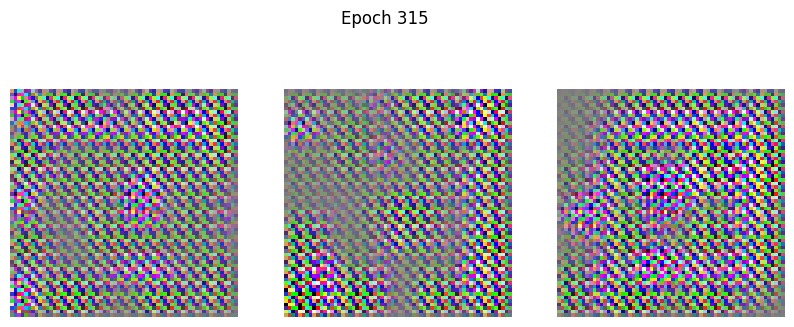

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: -0.0113 - g_loss: 7.2607
Epoch 316/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0170 - g_loss: 6.6607

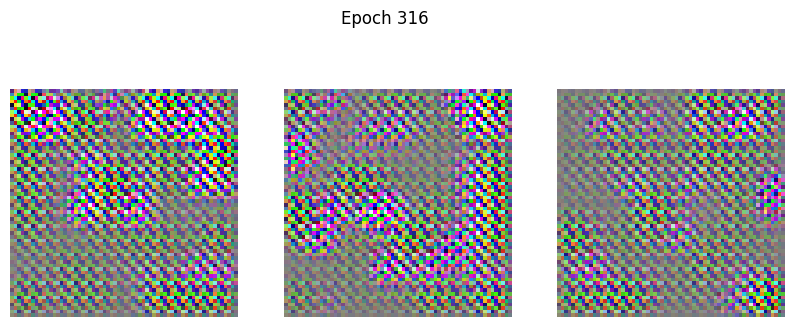

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0185 - g_loss: 6.6647
Epoch 317/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0328 - g_loss: 5.6263

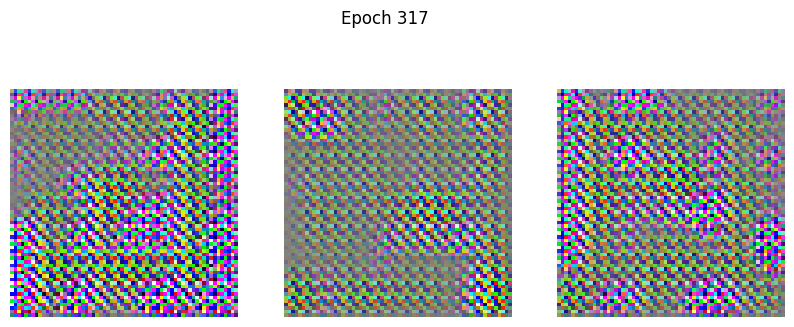

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0367 - g_loss: 5.6204
Epoch 318/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0824 - g_loss: 5.4873 

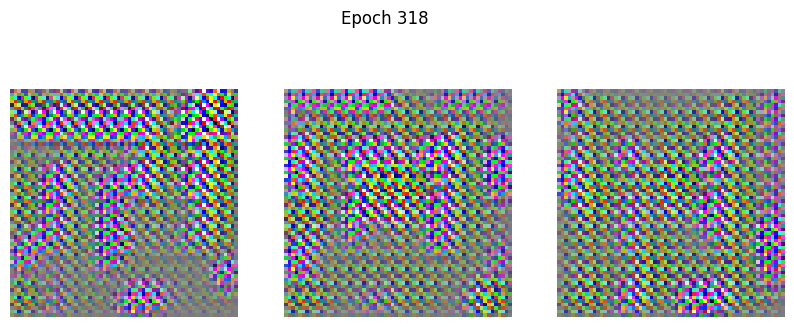

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.0809 - g_loss: 5.3948
Epoch 319/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1324 - g_loss: 5.7677

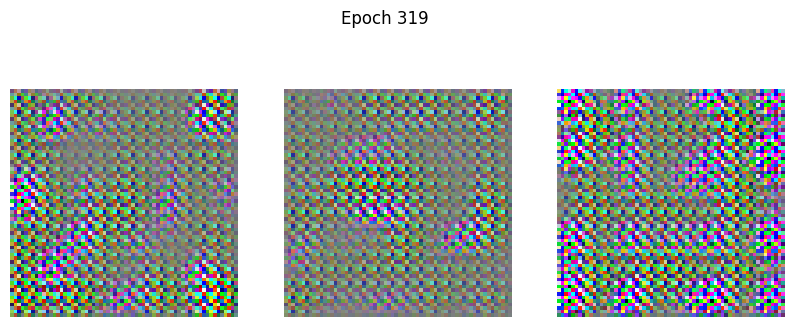

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.1366 - g_loss: 5.5222
Epoch 320/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1967 - g_loss: 8.4537 

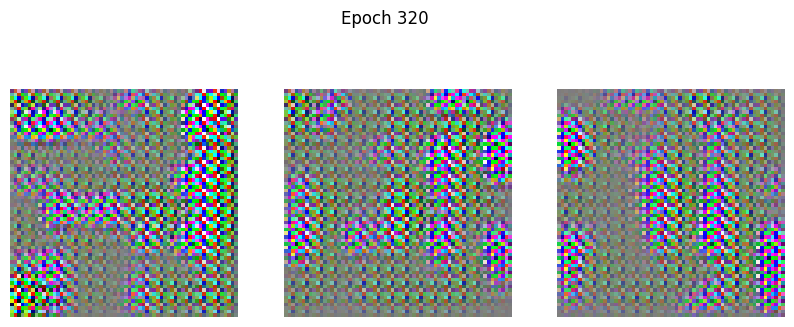

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1872 - g_loss: 8.3128
Epoch 321/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1340 - g_loss: 4.4849 

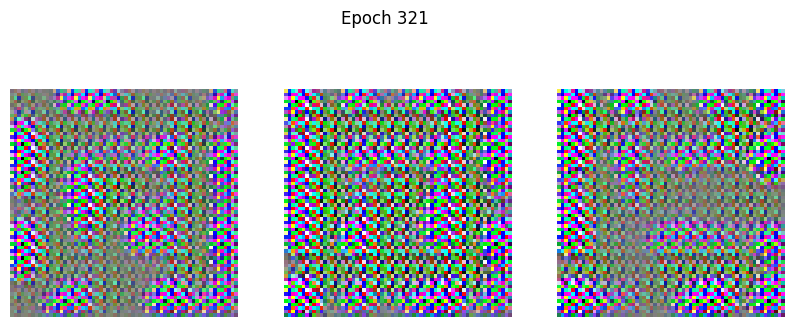

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1439 - g_loss: 4.9150
Epoch 322/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1125 - g_loss: 7.4493

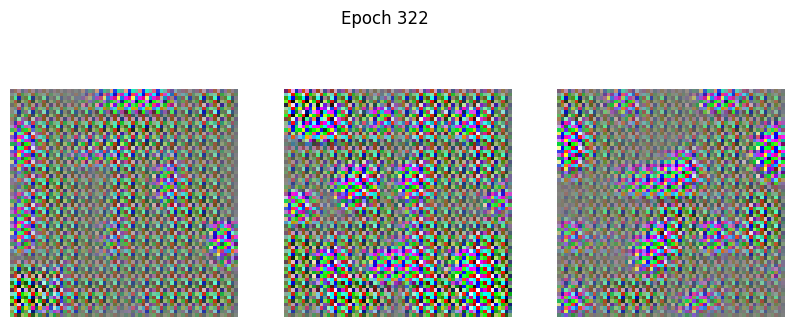

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1138 - g_loss: 7.1402
Epoch 323/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.0672 - g_loss: 4.2990

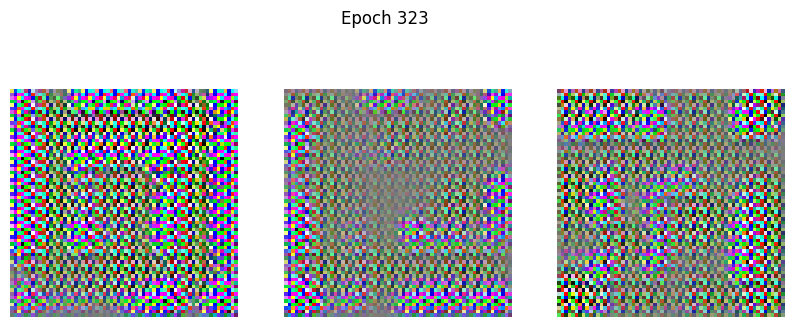

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0773 - g_loss: 4.6656
Epoch 324/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.0604 - g_loss: 6.6338

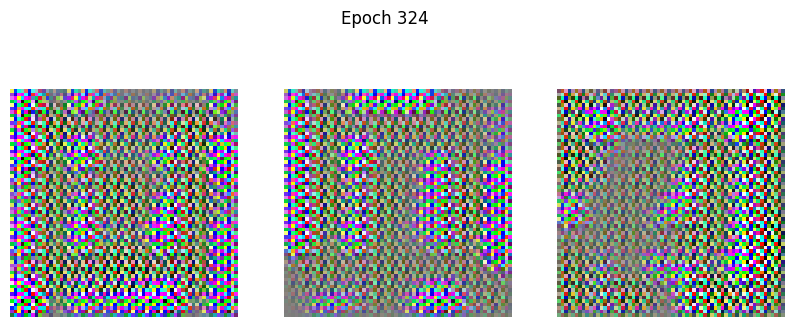

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.0626 - g_loss: 6.4223
Epoch 325/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0568 - g_loss: 3.8267

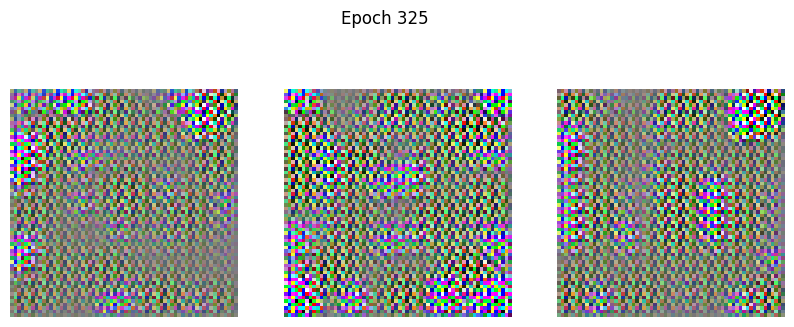

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0656 - g_loss: 4.0497
Epoch 326/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0555 - g_loss: 5.2562 

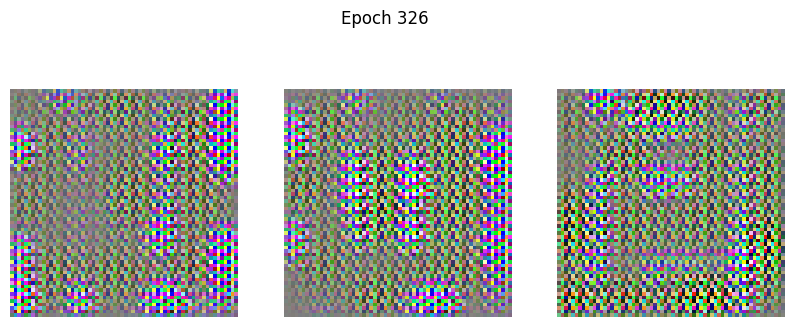

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0546 - g_loss: 5.1507
Epoch 327/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0821 - g_loss: 4.7041 

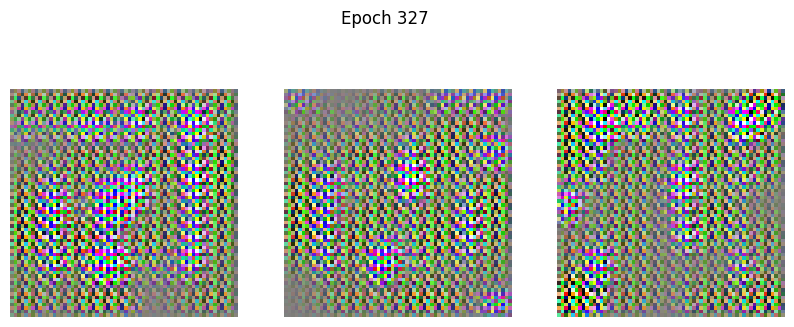

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.0786 - g_loss: 4.6499
Epoch 328/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0866 - g_loss: 4.8654 

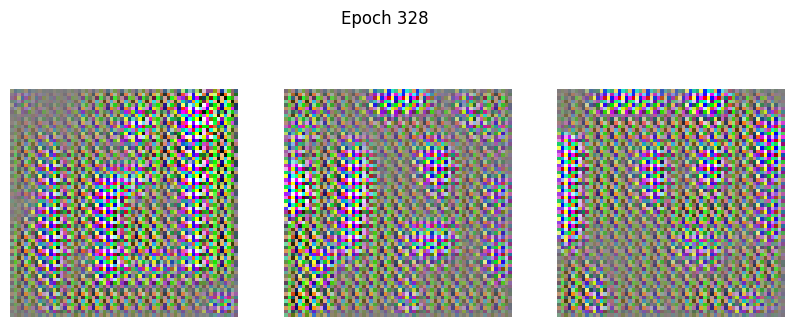

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0839 - g_loss: 4.8470
Epoch 329/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0829 - g_loss: 4.8733 

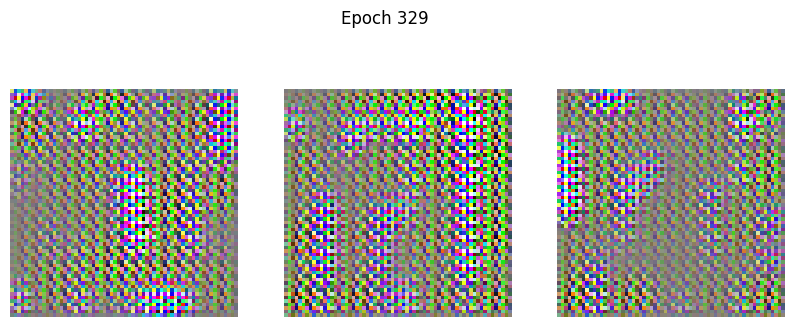

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.0793 - g_loss: 4.8690
Epoch 330/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0665 - g_loss: 5.2549

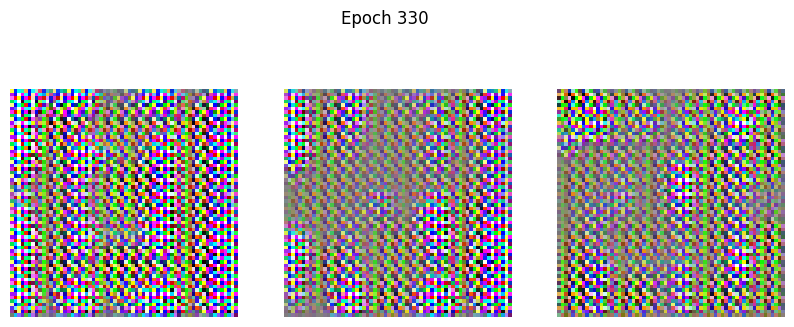

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.0685 - g_loss: 5.2118
Epoch 331/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0573 - g_loss: 4.9274 

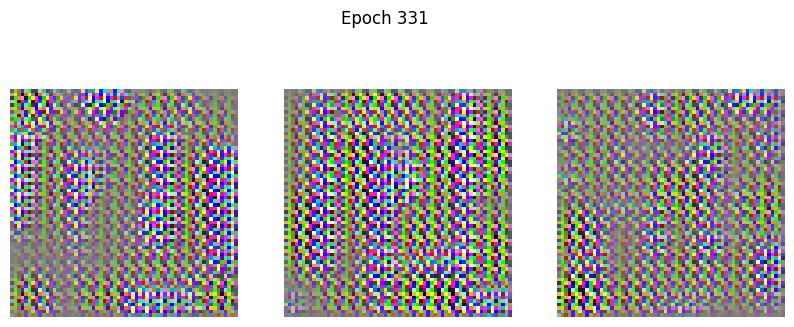

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0542 - g_loss: 4.9053
Epoch 332/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0377 - g_loss: 5.1216 

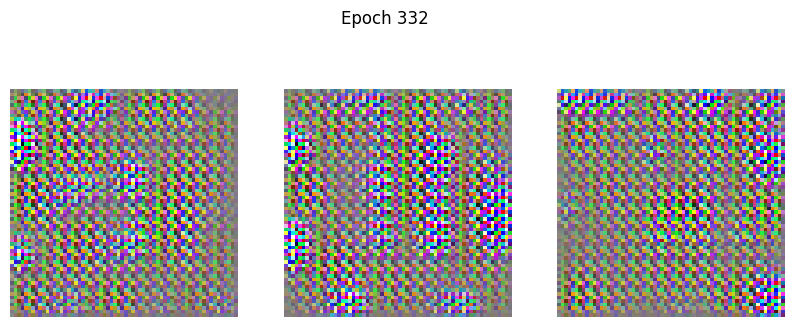

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0360 - g_loss: 5.1387
Epoch 333/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0380 - g_loss: 5.1375 

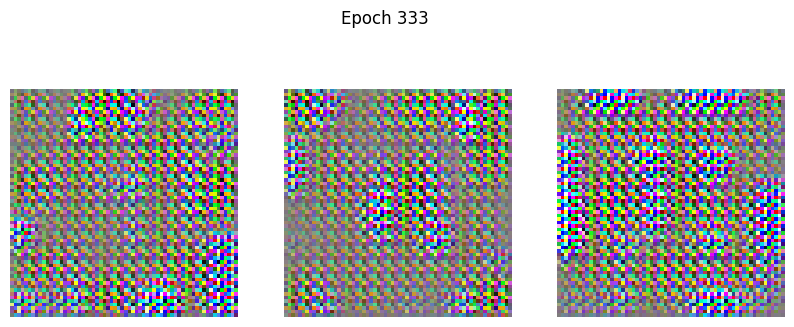

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0366 - g_loss: 5.1403
Epoch 334/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0326 - g_loss: 5.1484

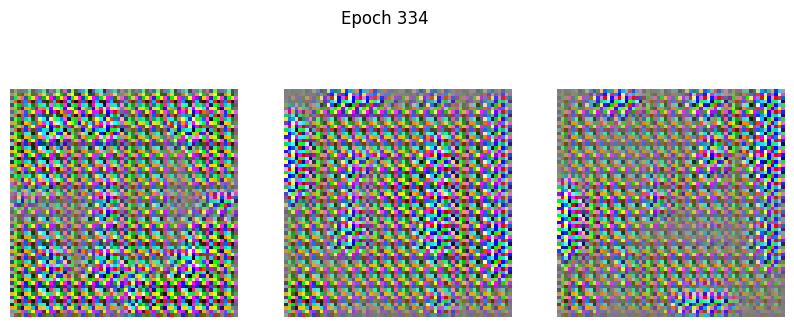

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.0336 - g_loss: 5.1205
Epoch 335/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0394 - g_loss: 4.7143 

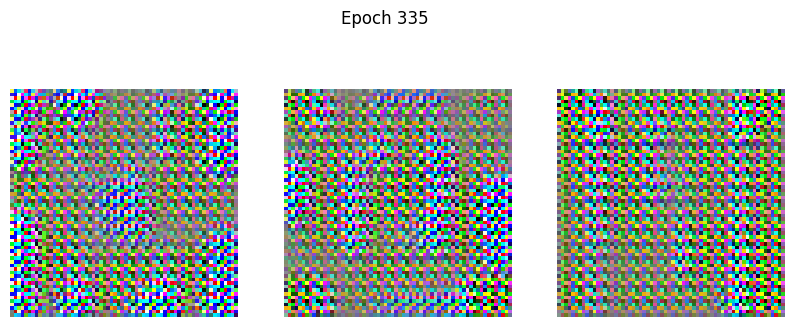

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0381 - g_loss: 4.7305
Epoch 336/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0396 - g_loss: 5.1340 

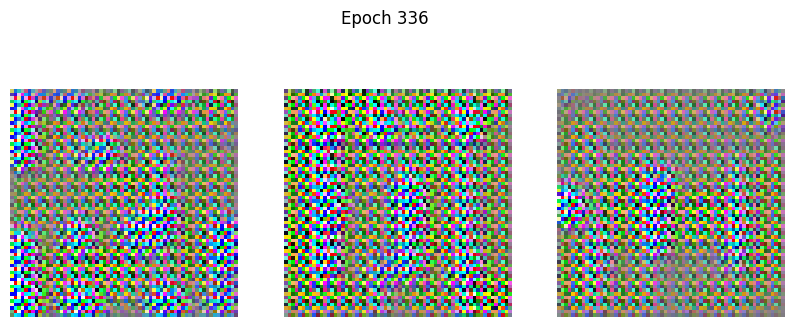

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.0376 - g_loss: 5.1324
Epoch 337/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0509 - g_loss: 5.1984

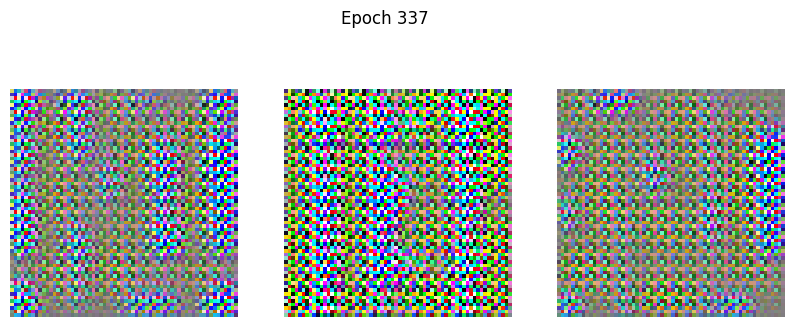

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.0521 - g_loss: 5.1265
Epoch 338/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0655 - g_loss: 5.5576

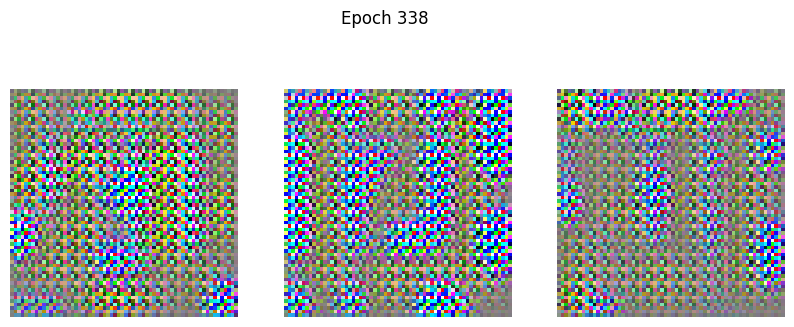

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0668 - g_loss: 5.4960
Epoch 339/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0854 - g_loss: 5.8546

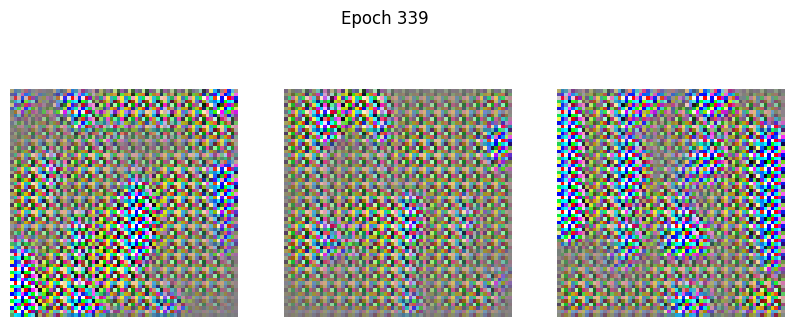

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0868 - g_loss: 5.6681
Epoch 340/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1118 - g_loss: 6.3132

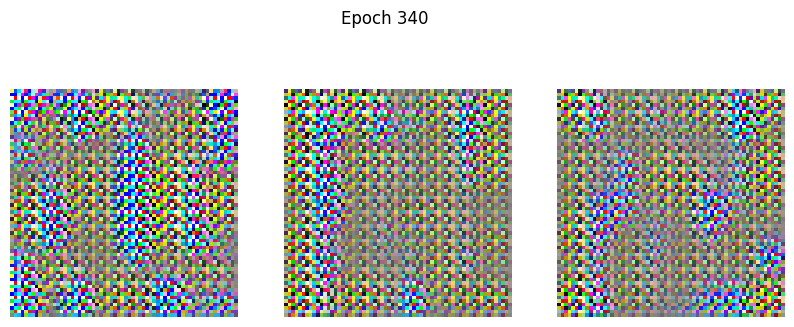

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step - d_loss: 0.1115 - g_loss: 6.1940
Epoch 341/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0692 - g_loss: 5.3639

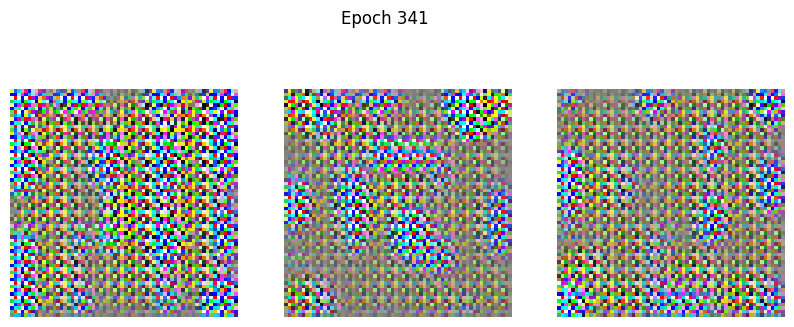

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0752 - g_loss: 5.5819
Epoch 342/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0694 - g_loss: 5.0063

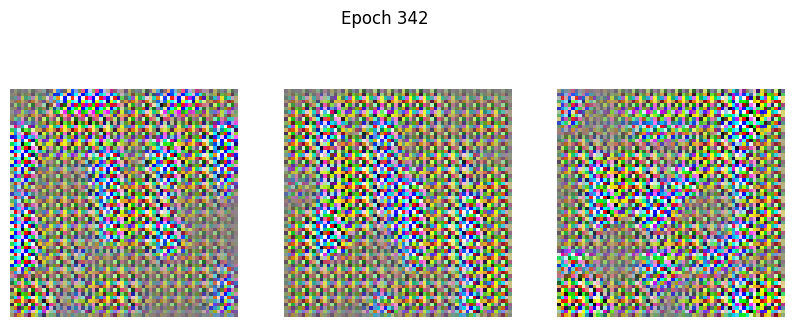

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step - d_loss: 0.0716 - g_loss: 4.9030
Epoch 343/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1123 - g_loss: 7.0130

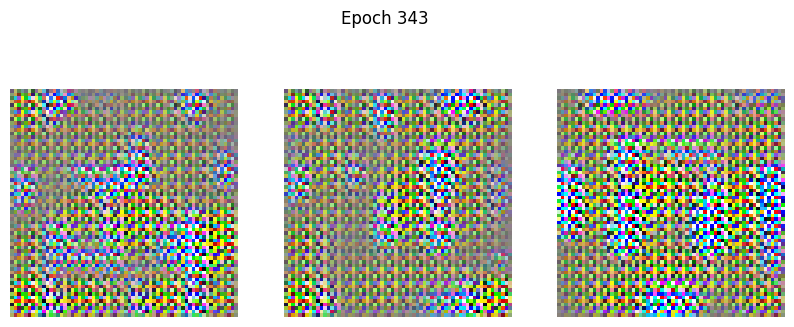

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 263ms/step - d_loss: 0.1148 - g_loss: 6.7974
Epoch 344/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0642 - g_loss: 4.7633 

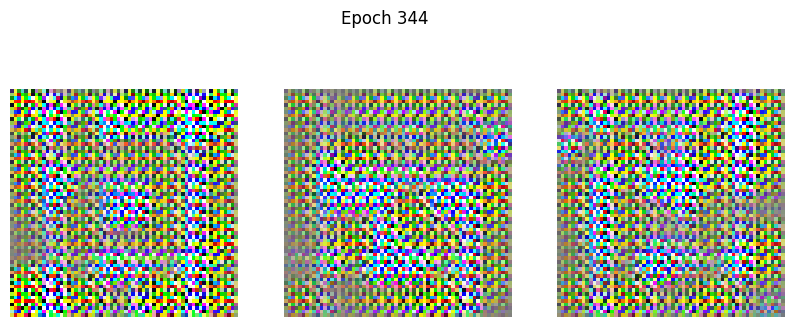

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - d_loss: 0.0616 - g_loss: 4.8664
Epoch 345/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0266 - g_loss: 4.8360

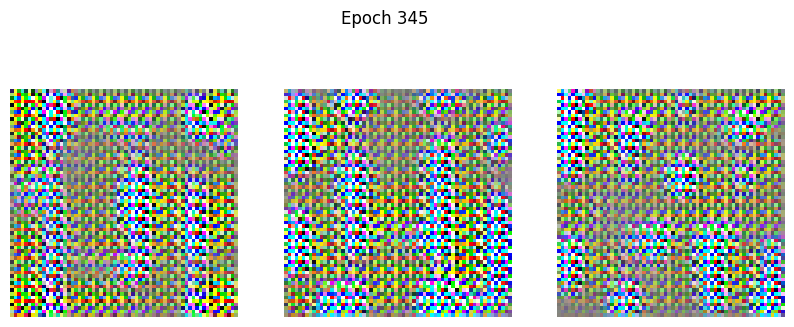

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - d_loss: 0.0302 - g_loss: 4.8044
Epoch 346/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0426 - g_loss: 5.1766

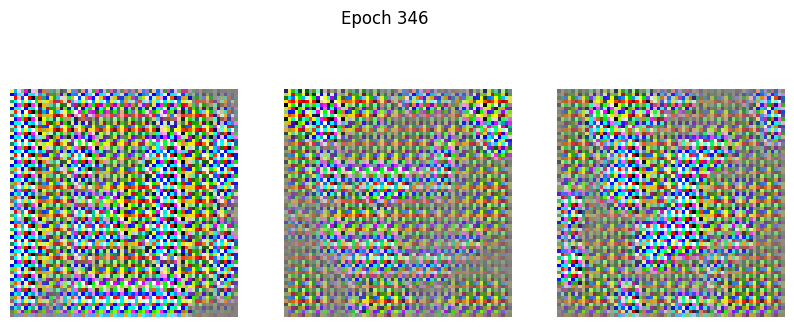

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - d_loss: 0.0442 - g_loss: 5.0655
Epoch 347/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0787 - g_loss: 6.3534 

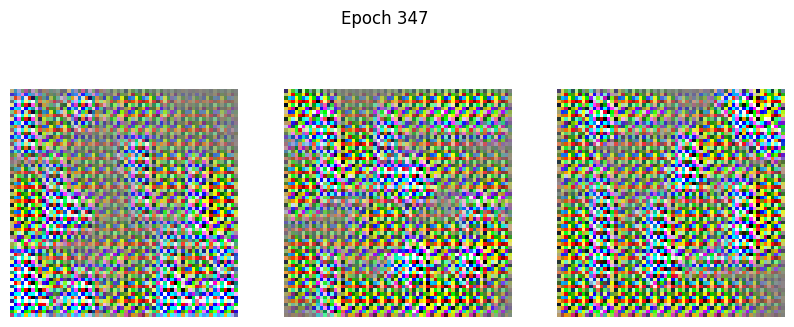

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 215ms/step - d_loss: 0.0751 - g_loss: 6.2187
Epoch 348/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0701 - g_loss: 5.5118 

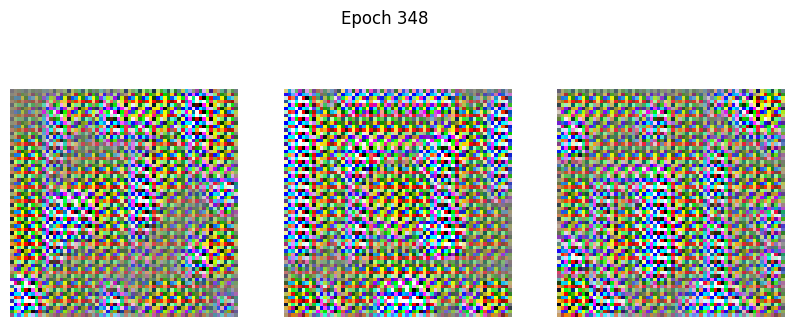

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step - d_loss: 0.0714 - g_loss: 5.8170
Epoch 349/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0971 - g_loss: 5.3232

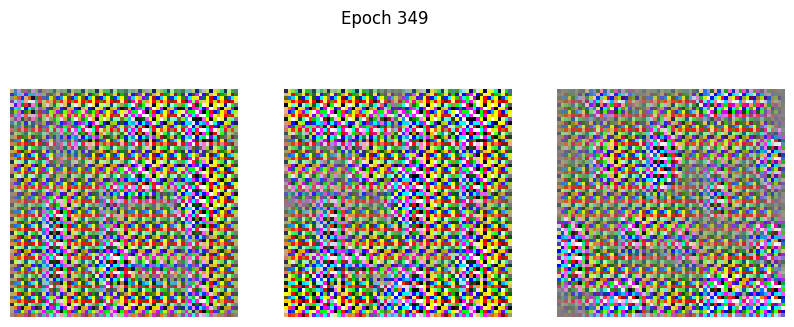

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 221ms/step - d_loss: 0.0976 - g_loss: 5.4456
Epoch 350/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0784 - g_loss: 5.8103 

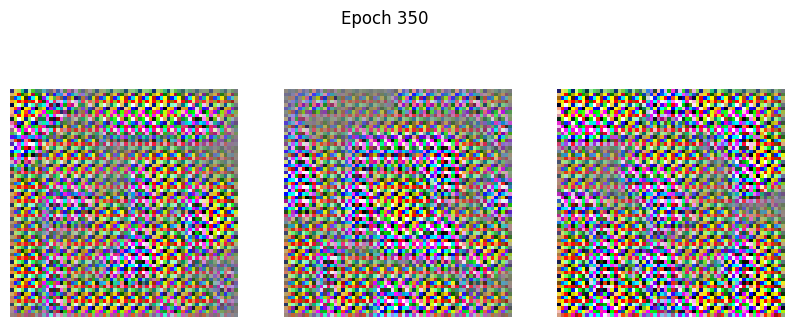

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0784 - g_loss: 6.1132
Epoch 351/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1108 - g_loss: 6.9816 

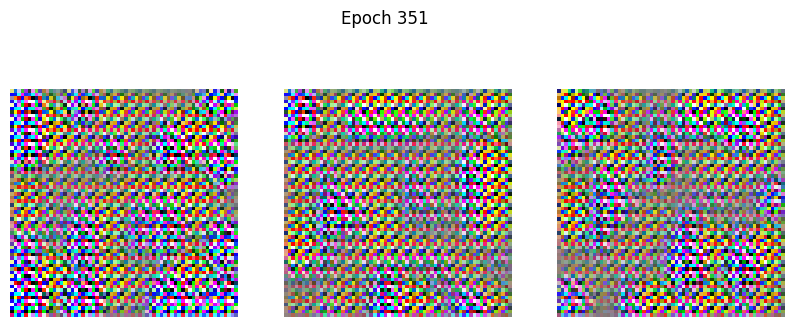

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step - d_loss: 0.1150 - g_loss: 7.7926
Epoch 352/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1778 - g_loss: 7.6733

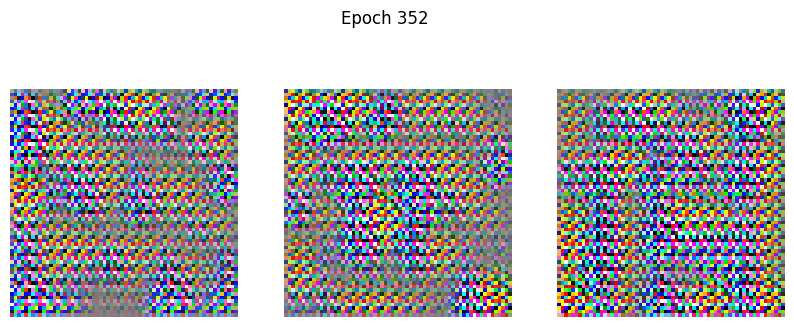

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1626 - g_loss: 7.1509
Epoch 353/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 1.0097 - g_loss: 26.1037

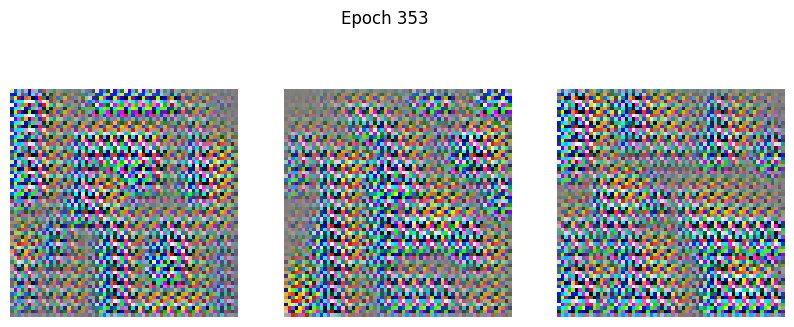

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 1.1147 - g_loss: 24.9114
Epoch 354/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1459 - g_loss: 6.7813 

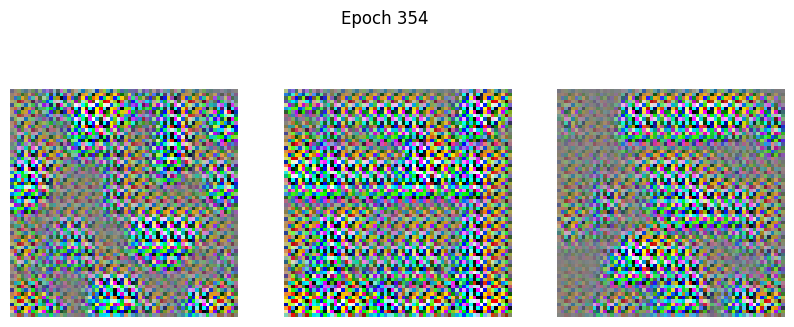

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.1817 - g_loss: 7.3174
Epoch 355/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: -0.0034 - g_loss: 9.6886  

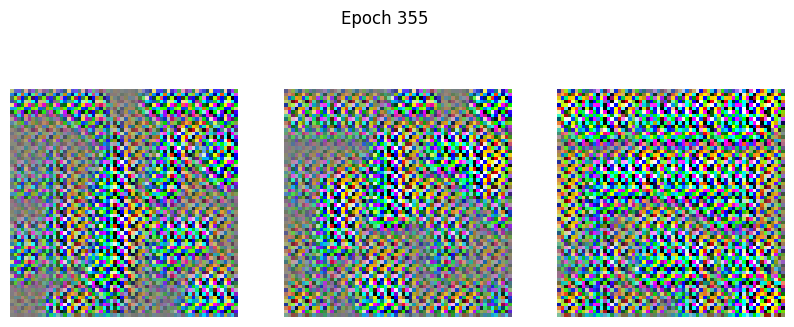

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: -0.0038 - g_loss: 9.3347
Epoch 356/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1067 - g_loss: 7.3998 

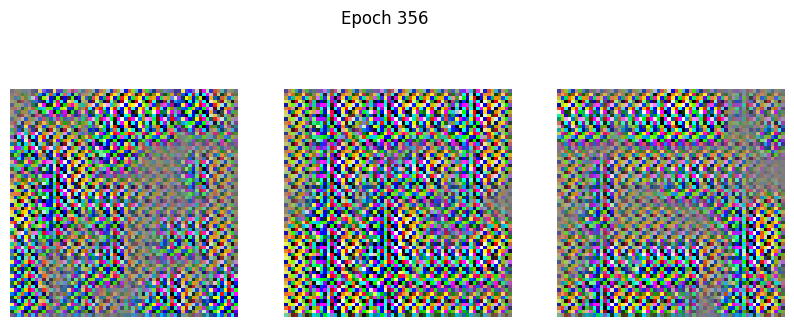

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1032 - g_loss: 7.4849
Epoch 357/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1052 - g_loss: 6.1421 

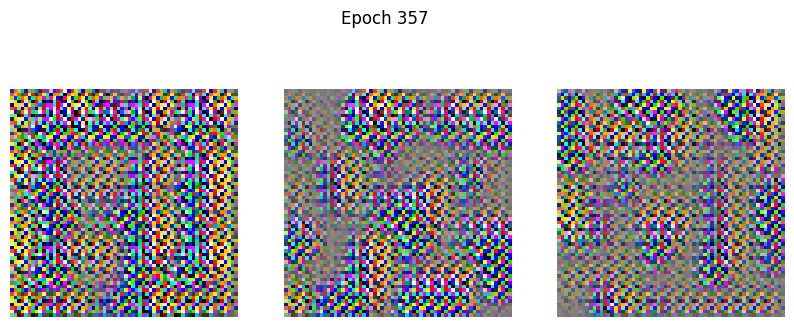

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1084 - g_loss: 6.0728
Epoch 358/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1784 - g_loss: 5.0243

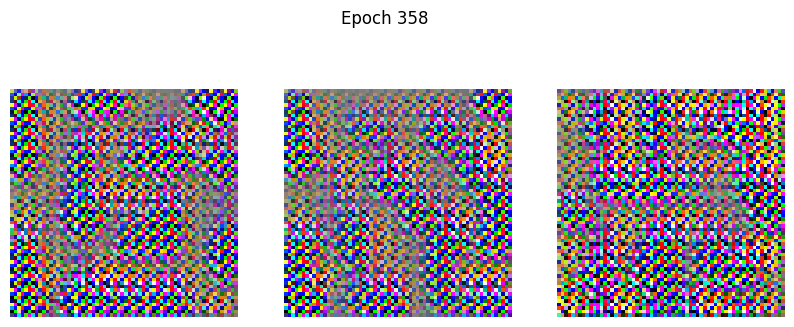

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1838 - g_loss: 4.8879
Epoch 359/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.2077 - g_loss: 7.7848

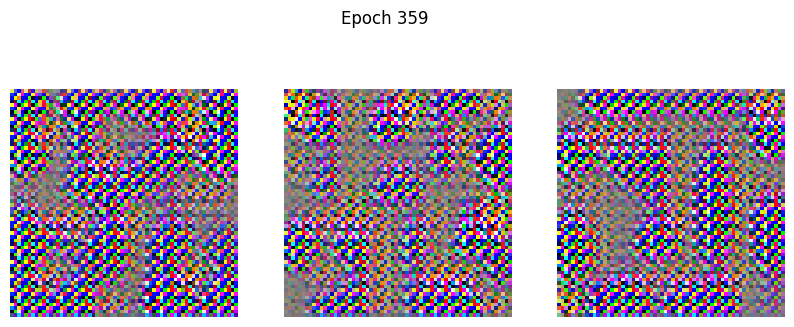

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.2112 - g_loss: 7.4780
Epoch 360/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1034 - g_loss: 5.4314

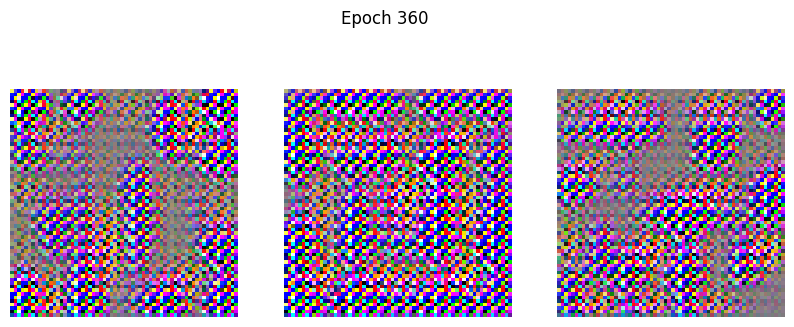

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1062 - g_loss: 5.5857
Epoch 361/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0839 - g_loss: 5.3018

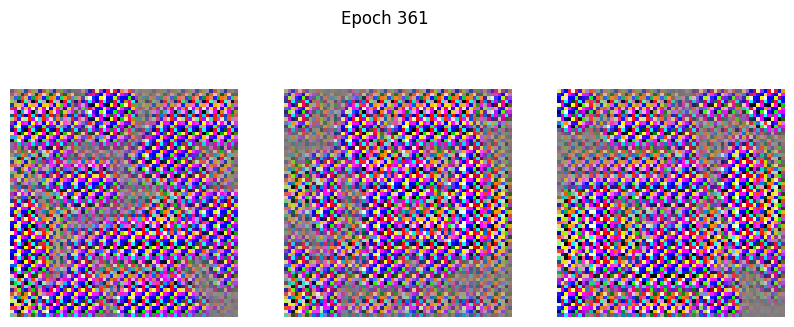

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0890 - g_loss: 5.2047
Epoch 362/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1628 - g_loss: 7.0391 

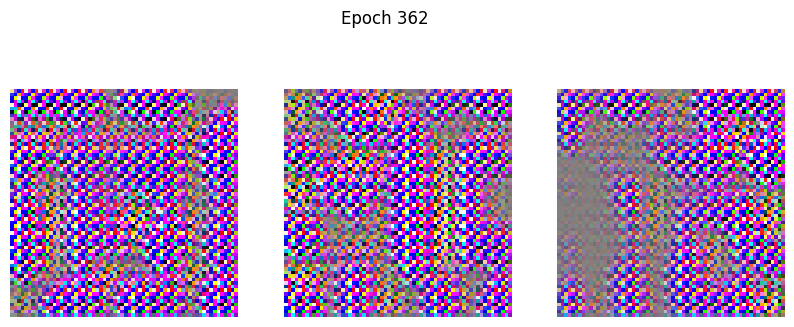

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1572 - g_loss: 6.8618
Epoch 363/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1277 - g_loss: 4.7409 

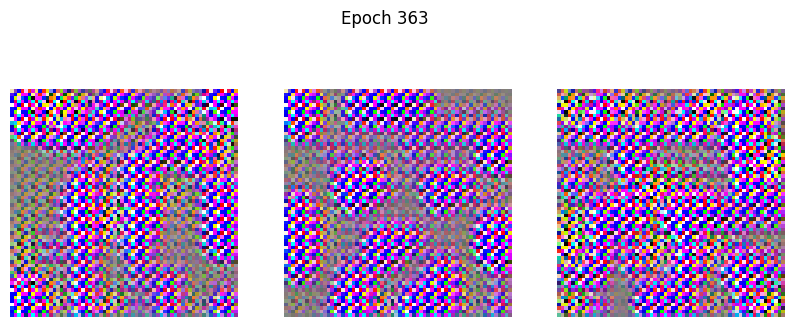

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1307 - g_loss: 5.3307
Epoch 364/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1337 - g_loss: 8.0912

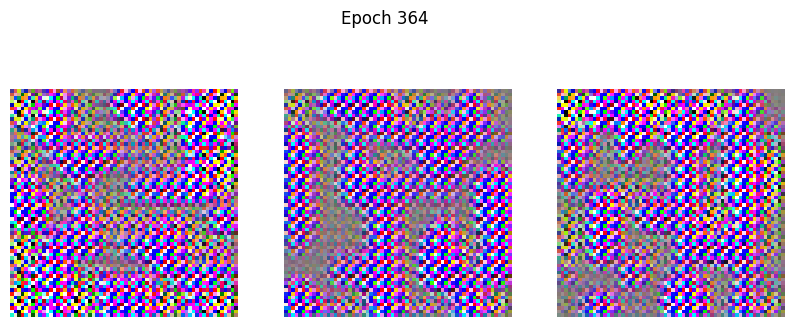

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1347 - g_loss: 7.6950
Epoch 365/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0543 - g_loss: 5.1620

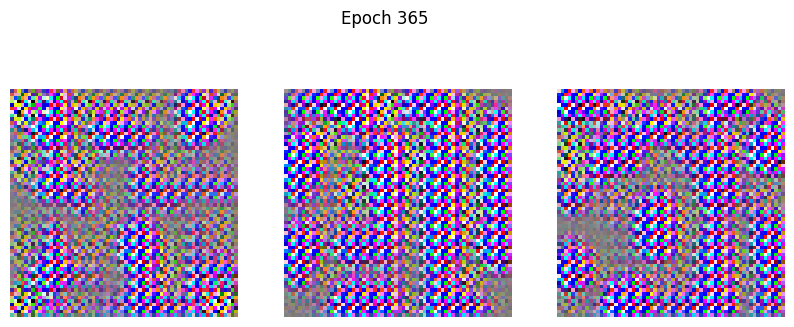

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step - d_loss: 0.0561 - g_loss: 5.4476
Epoch 366/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0400 - g_loss: 5.7731

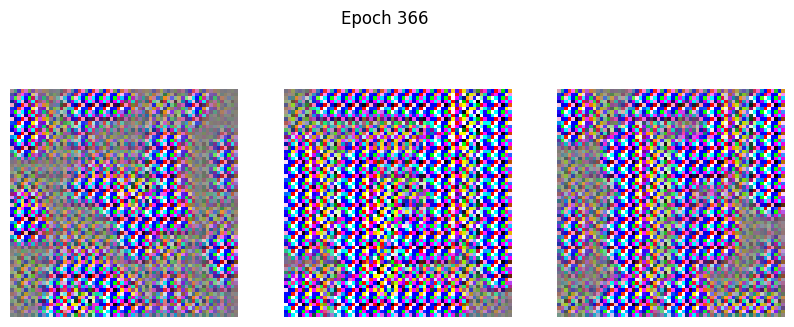

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 235ms/step - d_loss: 0.0426 - g_loss: 5.5785
Epoch 367/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1776 - g_loss: 14.1018

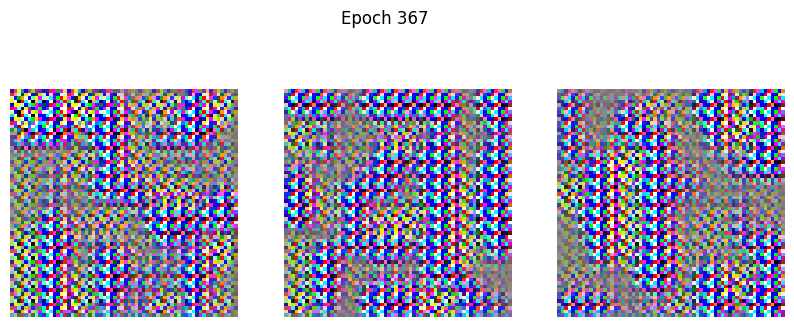

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1864 - g_loss: 13.9761
Epoch 368/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1108 - g_loss: 5.5759 

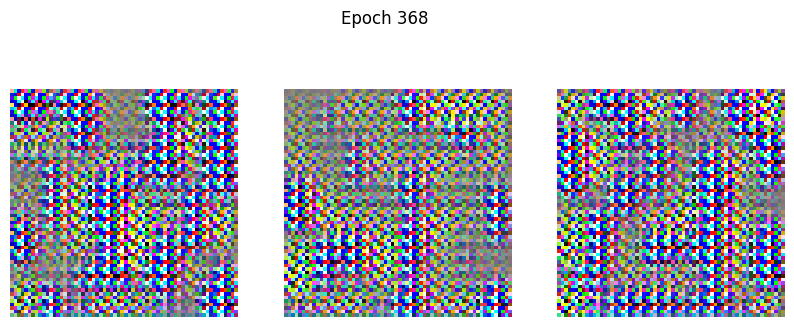

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1021 - g_loss: 5.3675
Epoch 369/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.2109 - g_loss: 13.8615 

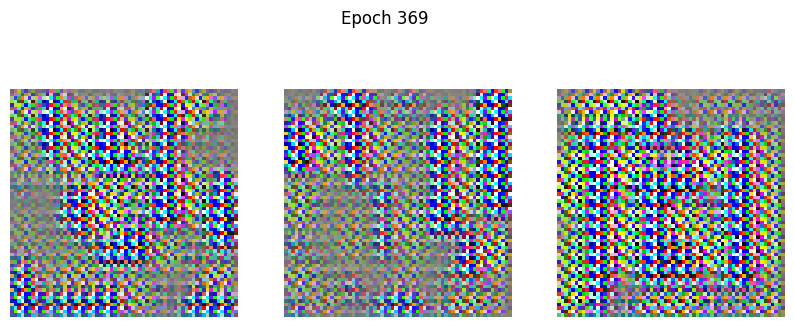

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.2036 - g_loss: 13.8377
Epoch 370/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1408 - g_loss: 7.9535

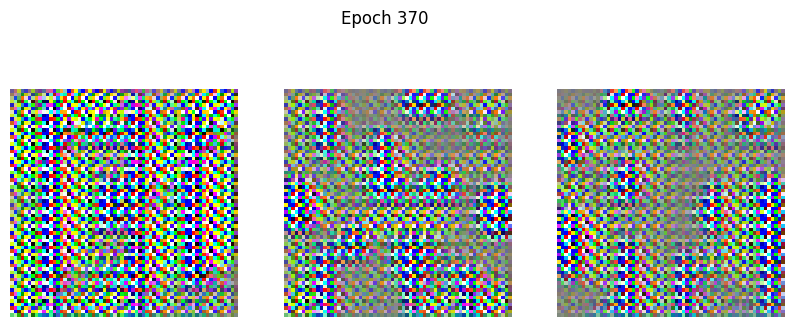

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step - d_loss: 0.1341 - g_loss: 7.4551
Epoch 371/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1051 - g_loss: 6.4261

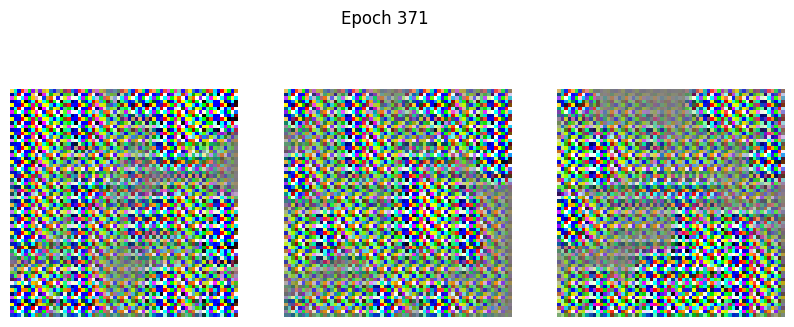

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0995 - g_loss: 6.4022
Epoch 372/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0632 - g_loss: 4.2743 

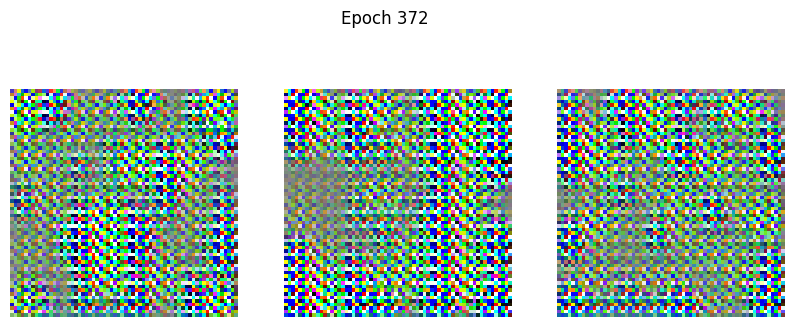

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0636 - g_loss: 4.3055
Epoch 373/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0696 - g_loss: 5.1775 

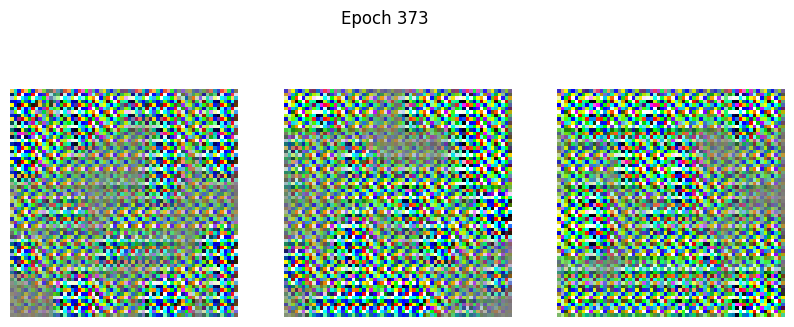

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.0672 - g_loss: 5.1649
Epoch 374/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0875 - g_loss: 4.6951 

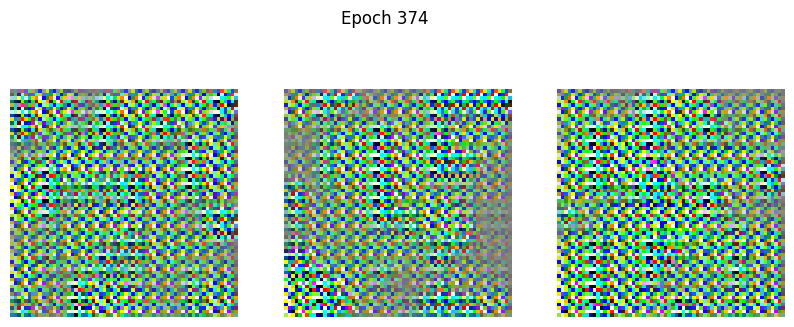

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.0870 - g_loss: 4.8035
Epoch 375/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0622 - g_loss: 4.7043

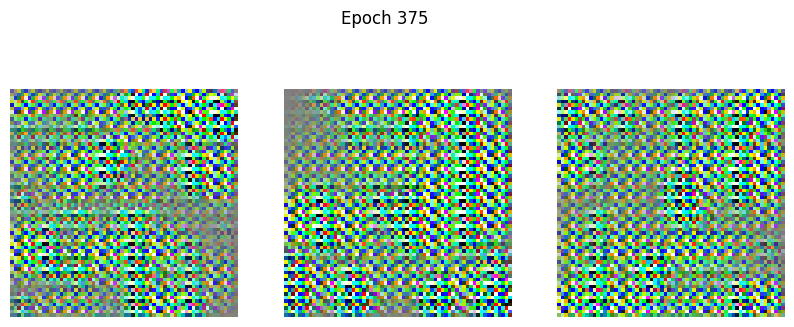

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0657 - g_loss: 4.6139
Epoch 376/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0638 - g_loss: 5.0816

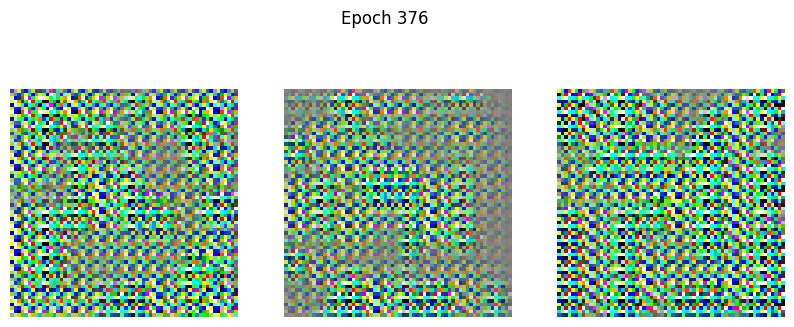

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step - d_loss: 0.0643 - g_loss: 4.9806
Epoch 377/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0417 - g_loss: 4.2287 

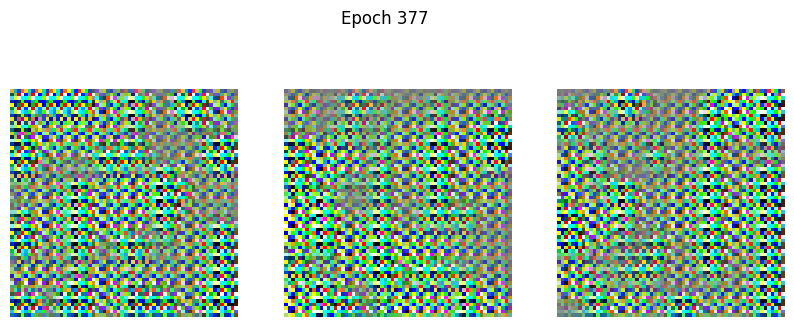

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 167ms/step - d_loss: 0.0405 - g_loss: 4.3301
Epoch 378/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0498 - g_loss: 4.9027 

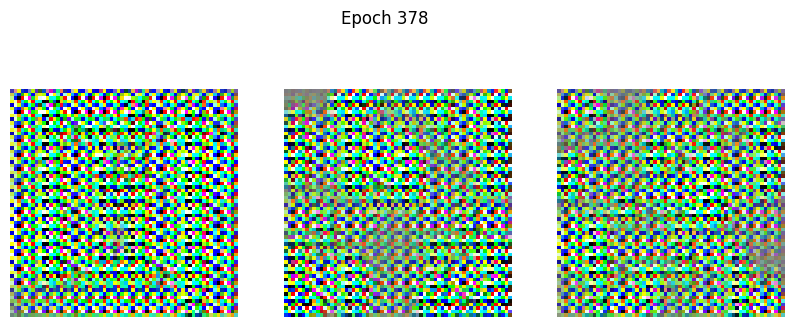

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - d_loss: 0.0490 - g_loss: 4.9203
Epoch 379/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0406 - g_loss: 4.9212

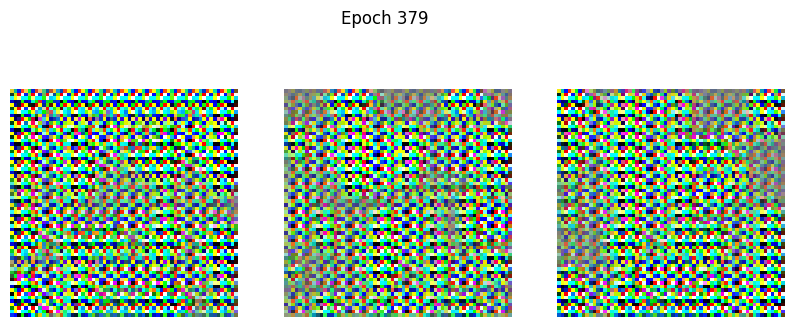

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.0436 - g_loss: 4.8978
Epoch 380/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0644 - g_loss: 6.1762 

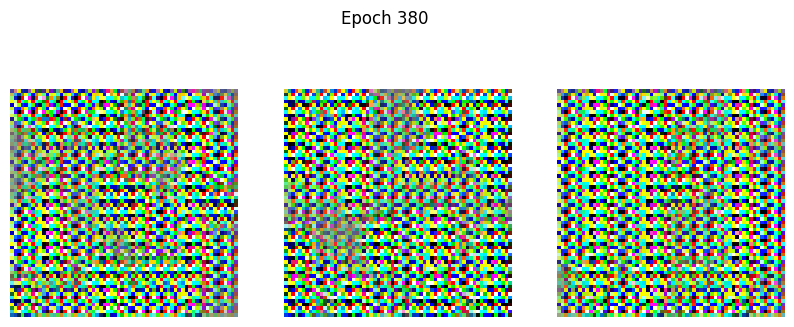

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step - d_loss: 0.0596 - g_loss: 6.1254
Epoch 381/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.0452 - g_loss: 5.1474

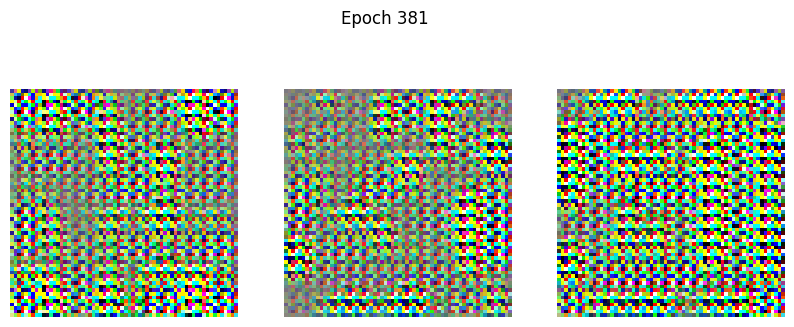

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 248ms/step - d_loss: 0.0499 - g_loss: 5.2850
Epoch 382/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0535 - g_loss: 5.6154

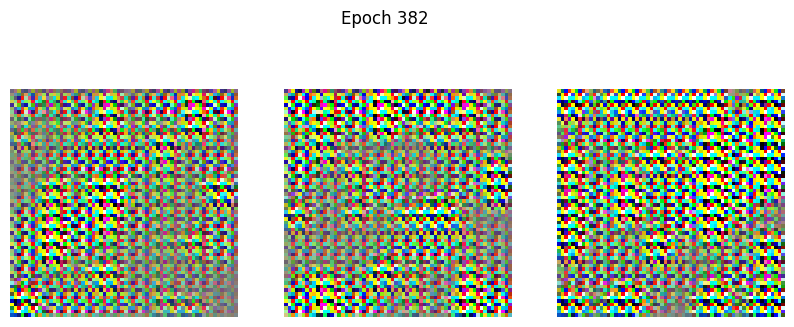

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step - d_loss: 0.0582 - g_loss: 5.6452
Epoch 383/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0642 - g_loss: 6.9072

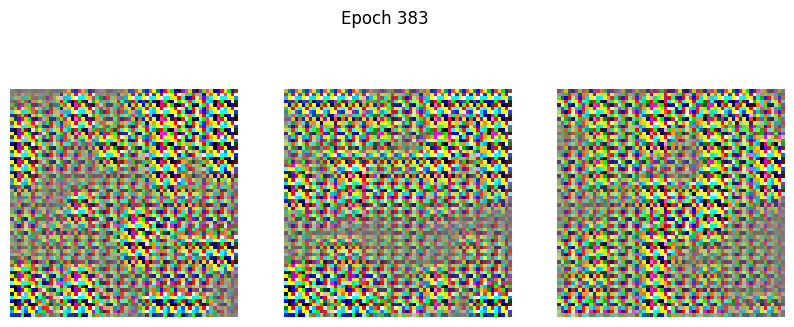

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - d_loss: 0.0663 - g_loss: 6.7121
Epoch 384/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1161 - g_loss: 8.3707 

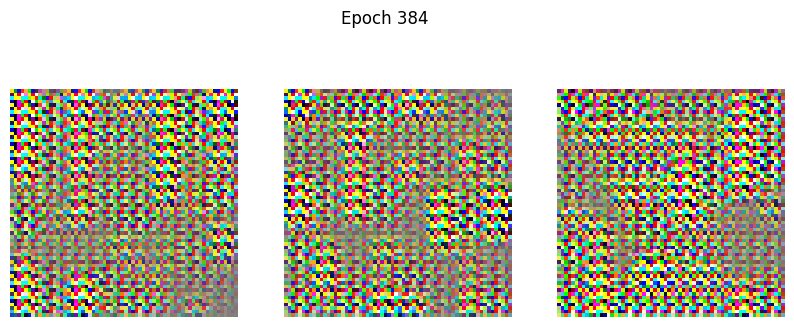

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.1122 - g_loss: 8.1649
Epoch 385/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0775 - g_loss: 6.5505 

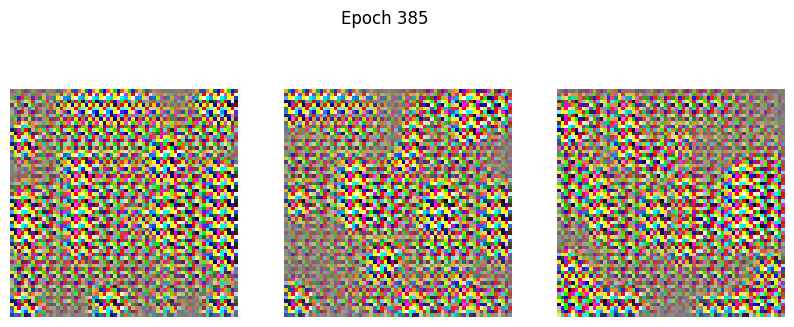

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - d_loss: 0.0786 - g_loss: 6.9874
Epoch 386/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1053 - g_loss: 6.3654 

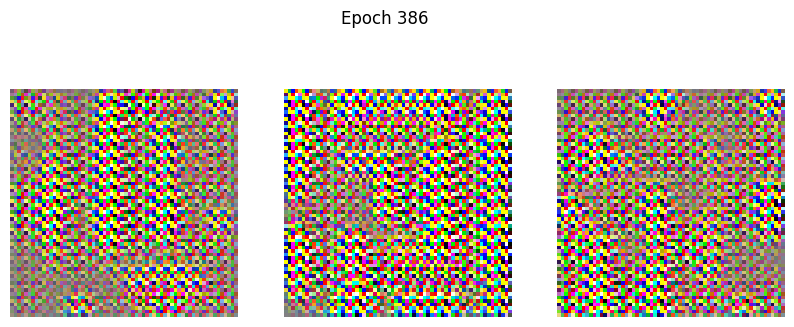

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 175ms/step - d_loss: 0.0972 - g_loss: 6.1358
Epoch 387/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1532 - g_loss: 11.4458

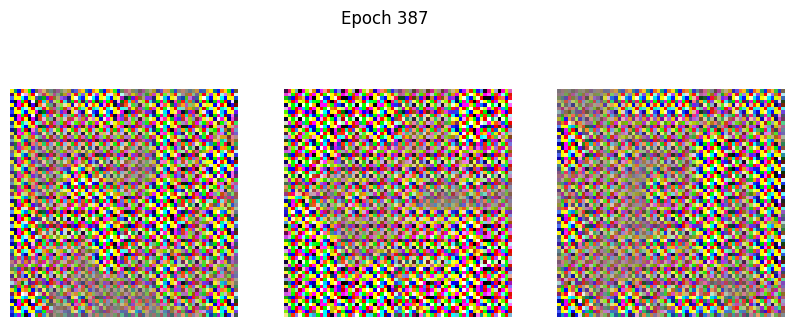

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1546 - g_loss: 11.2200
Epoch 388/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0940 - g_loss: 6.2736

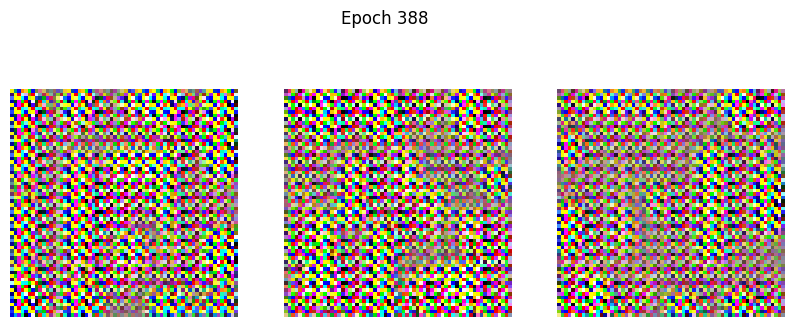

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1085 - g_loss: 6.8338
Epoch 389/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0823 - g_loss: 8.3293 

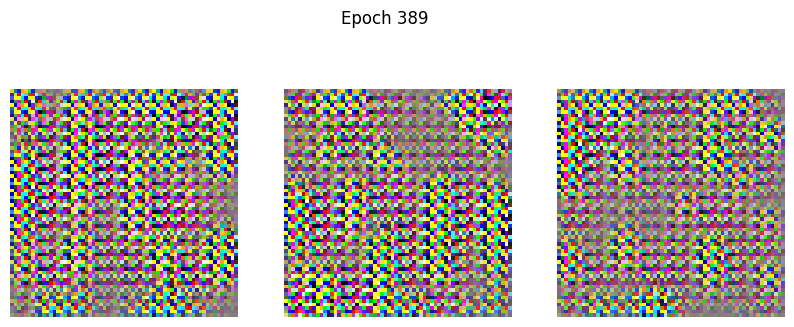

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0774 - g_loss: 7.9956
Epoch 390/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1434 - g_loss: 9.2215 

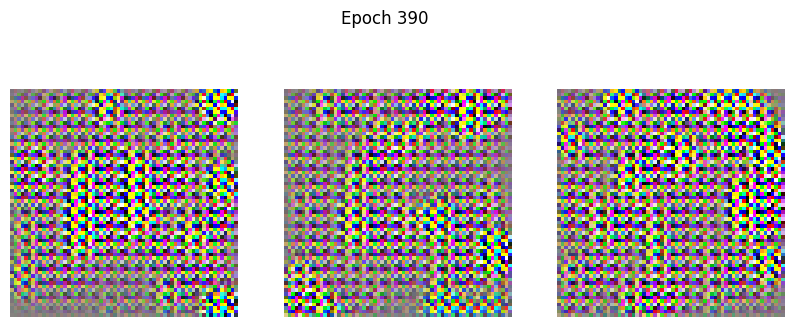

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1337 - g_loss: 9.0839
Epoch 391/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0733 - g_loss: 7.0699

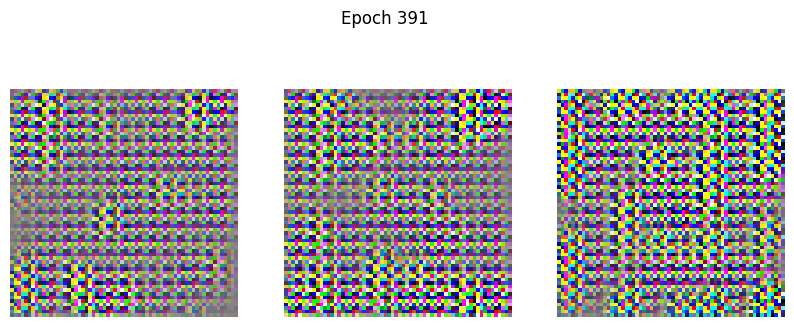

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0817 - g_loss: 7.6920
Epoch 392/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0998 - g_loss: 9.7766

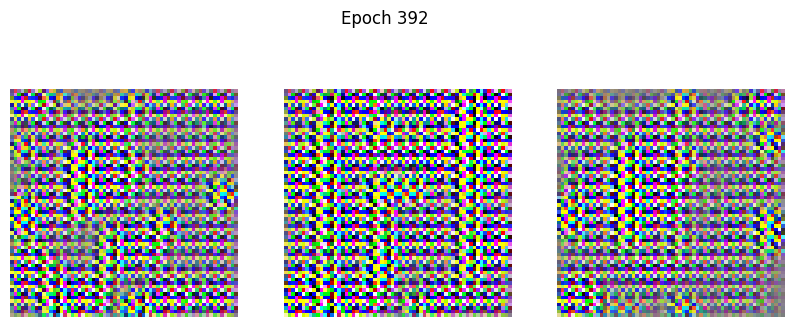

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step - d_loss: 0.0987 - g_loss: 9.3022
Epoch 393/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0608 - g_loss: 7.3579

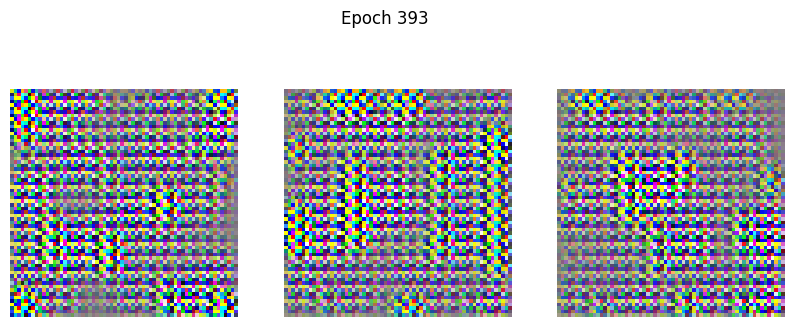

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 222ms/step - d_loss: 0.0576 - g_loss: 7.2567
Epoch 394/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.0384 - g_loss: 6.8059

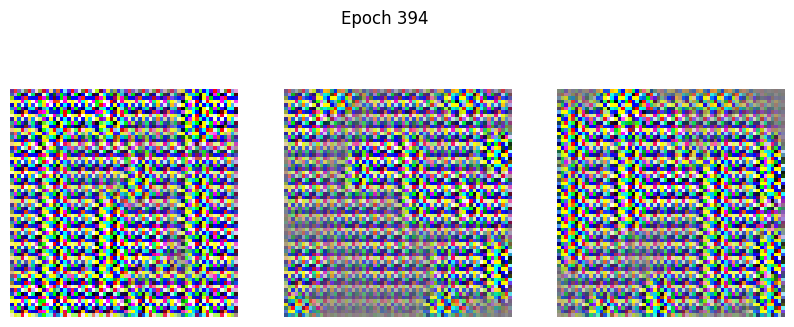

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.0396 - g_loss: 6.7546
Epoch 395/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.0626 - g_loss: 7.4867 

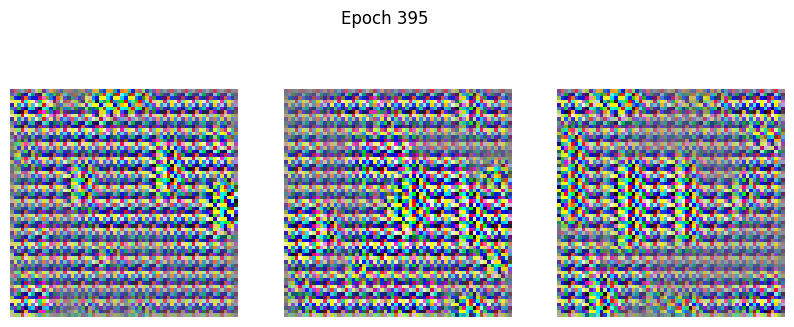

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - d_loss: 0.0616 - g_loss: 7.4105
Epoch 396/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1185 - g_loss: 7.9953

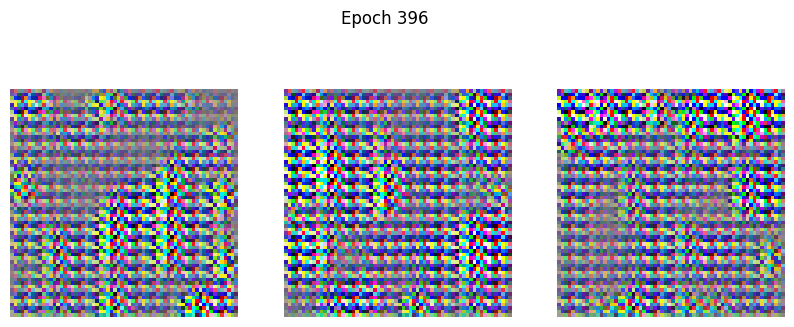

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.1262 - g_loss: 7.9053
Epoch 397/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.3561 - g_loss: 12.3345 

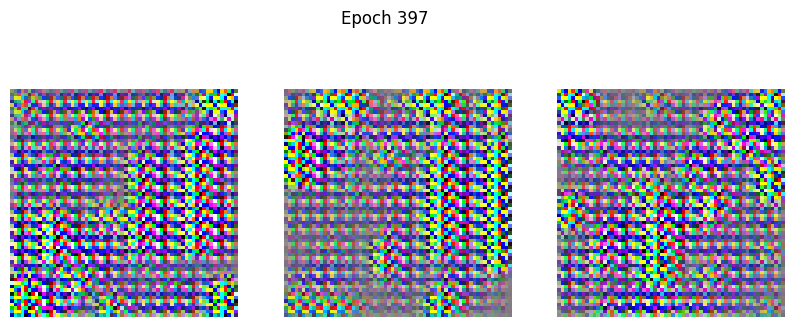

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.3618 - g_loss: 11.4237
Epoch 398/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.7535 - g_loss: 19.0315

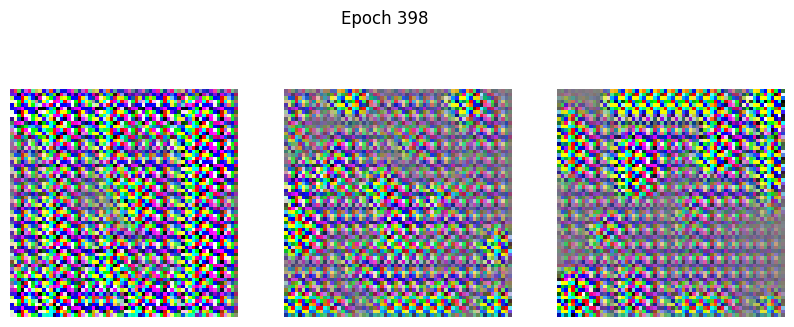

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - d_loss: 0.7347 - g_loss: 18.6053
Epoch 399/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0630 - g_loss: 6.4875 

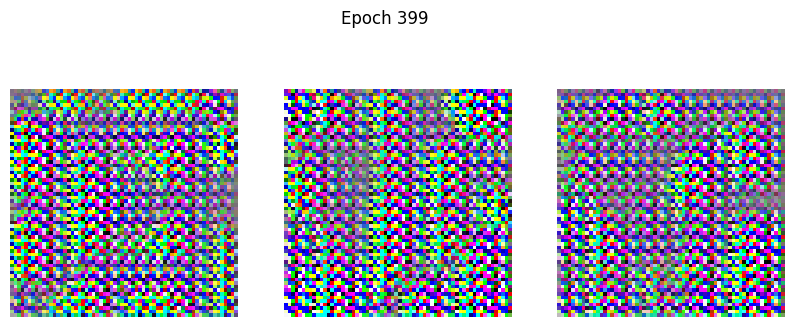

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0564 - g_loss: 6.1450
Epoch 400/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.2451 - g_loss: 12.8762

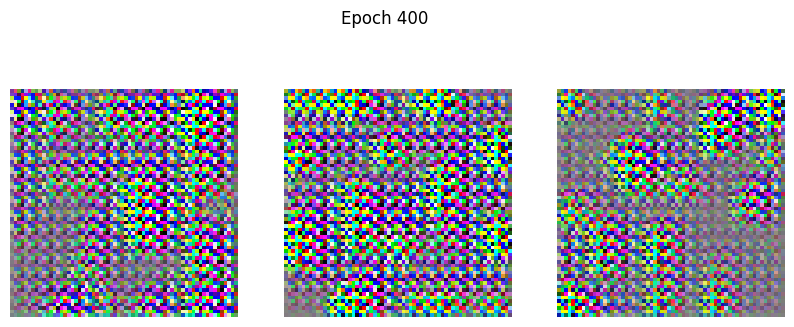

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.2288 - g_loss: 12.9176
Epoch 401/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.0978 - g_loss: 7.1371 

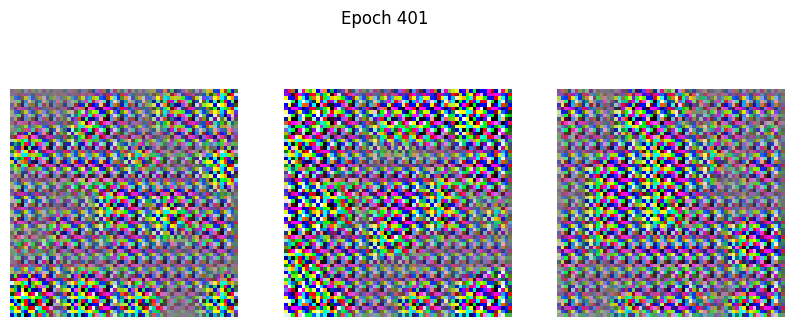

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0890 - g_loss: 6.7473
Epoch 402/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1864 - g_loss: 6.7988 

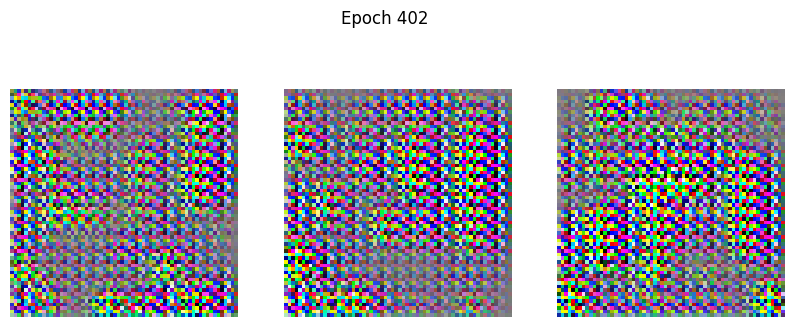

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - d_loss: 0.1757 - g_loss: 6.7278
Epoch 403/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.2090 - g_loss: 4.3242 

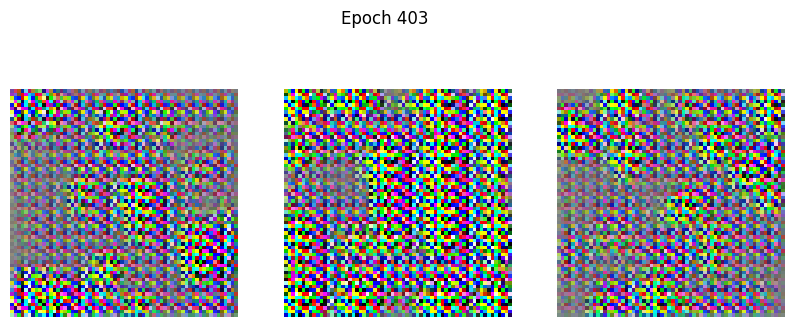

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.2197 - g_loss: 4.6895
Epoch 404/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.2441 - g_loss: 4.1288

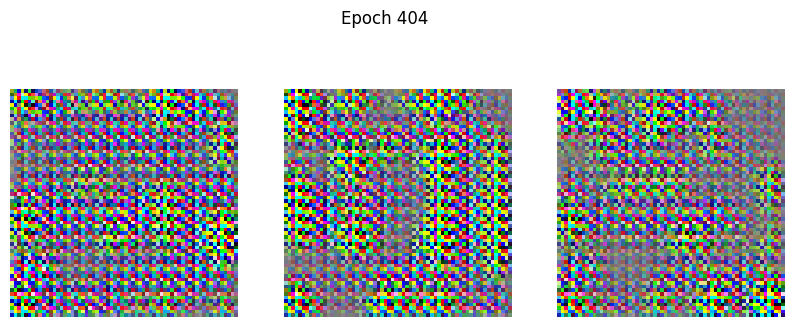

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.2353 - g_loss: 4.0486
Epoch 405/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1534 - g_loss: 6.0581 

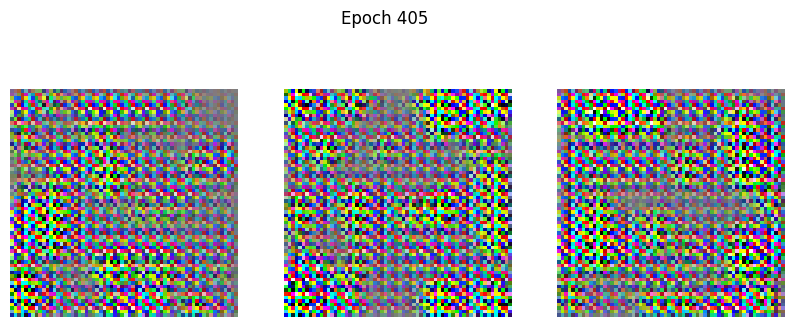

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1453 - g_loss: 5.9849
Epoch 406/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.1157 - g_loss: 3.5840 

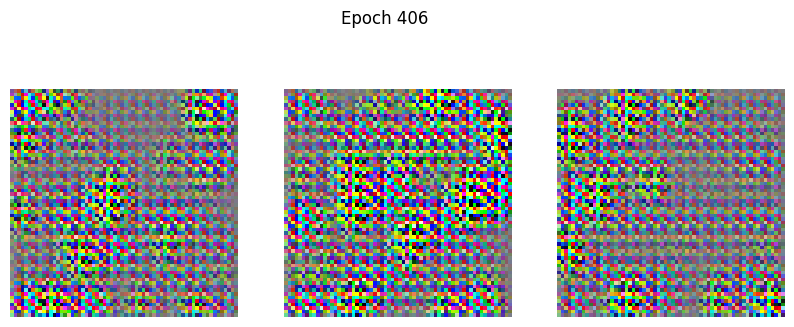

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.1165 - g_loss: 3.7050
Epoch 407/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0947 - g_loss: 4.3462 

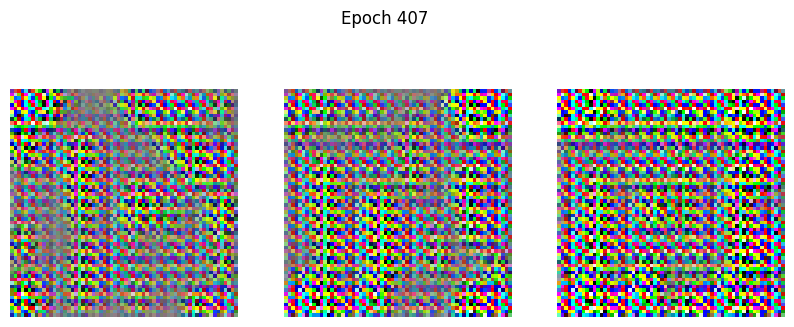

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0912 - g_loss: 4.2989
Epoch 408/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0753 - g_loss: 4.1570

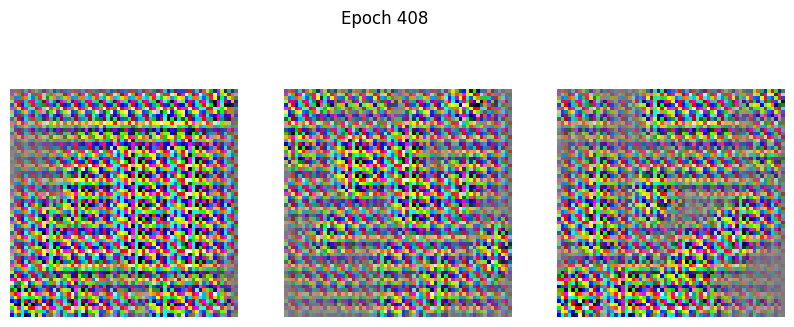

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0782 - g_loss: 4.1198
Epoch 409/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0800 - g_loss: 4.3908

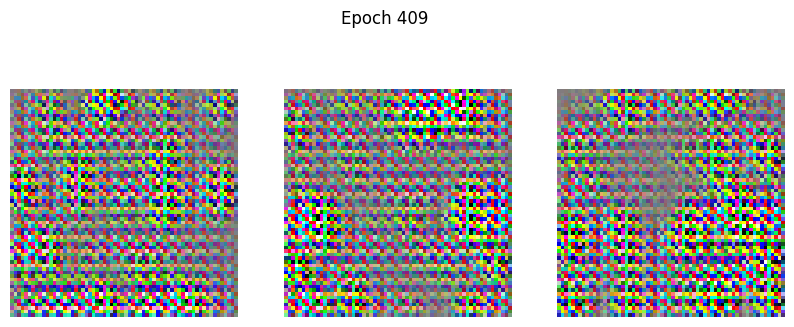

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0821 - g_loss: 4.3535
Epoch 410/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0922 - g_loss: 4.2251 

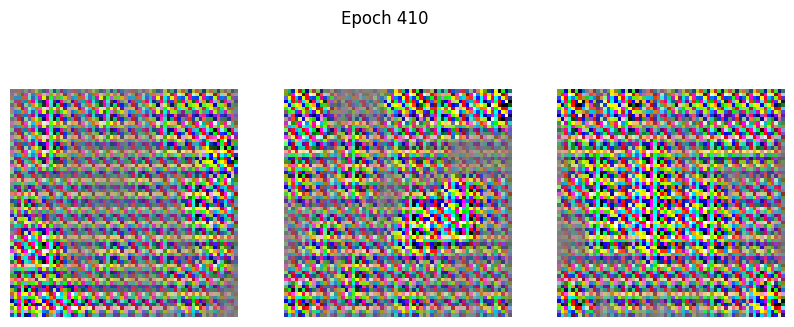

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.0905 - g_loss: 4.2735
Epoch 411/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0716 - g_loss: 4.2750

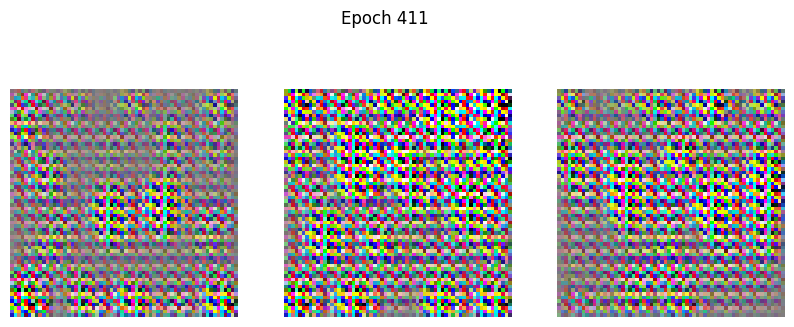

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.0739 - g_loss: 4.2018
Epoch 412/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0927 - g_loss: 4.5923 

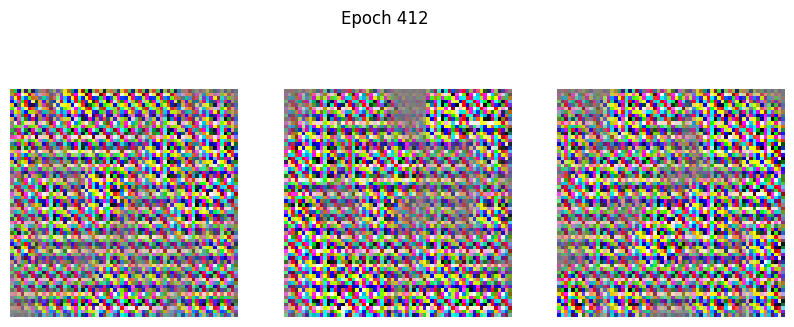

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0893 - g_loss: 4.5620
Epoch 413/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0601 - g_loss: 4.1574

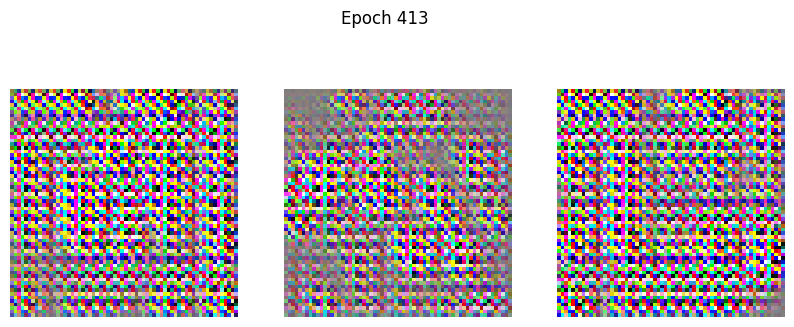

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step - d_loss: 0.0634 - g_loss: 4.1808
Epoch 414/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0685 - g_loss: 4.1797 

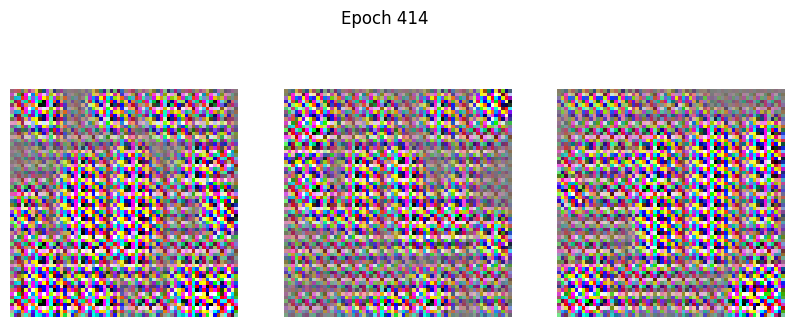

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.0653 - g_loss: 4.1869
Epoch 415/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0588 - g_loss: 4.4048

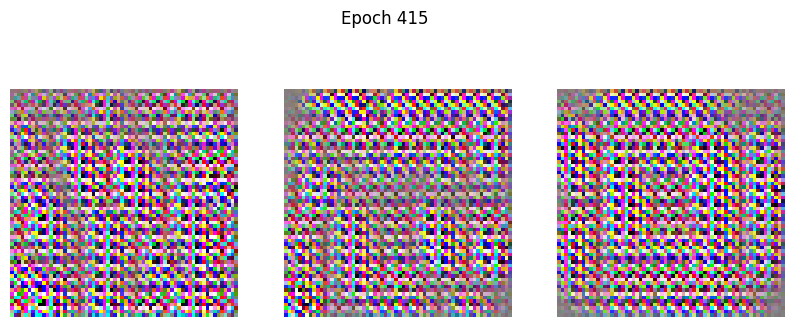

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - d_loss: 0.0599 - g_loss: 4.3534
Epoch 416/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0631 - g_loss: 4.5119 

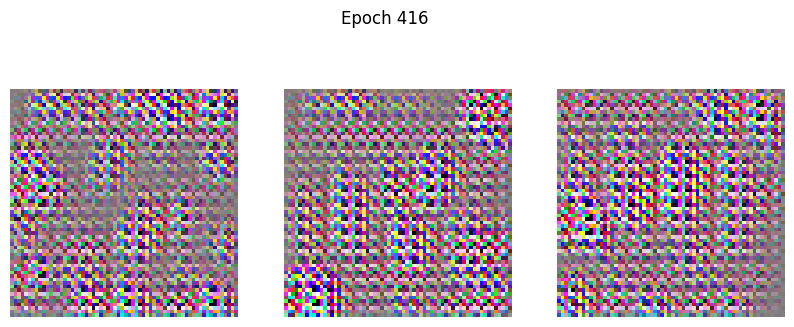

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0613 - g_loss: 4.5284
Epoch 417/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0609 - g_loss: 4.1805 

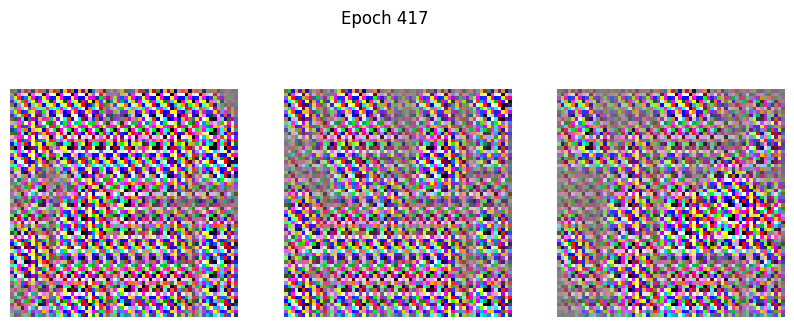

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step - d_loss: 0.0599 - g_loss: 4.2871
Epoch 418/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0601 - g_loss: 4.5671

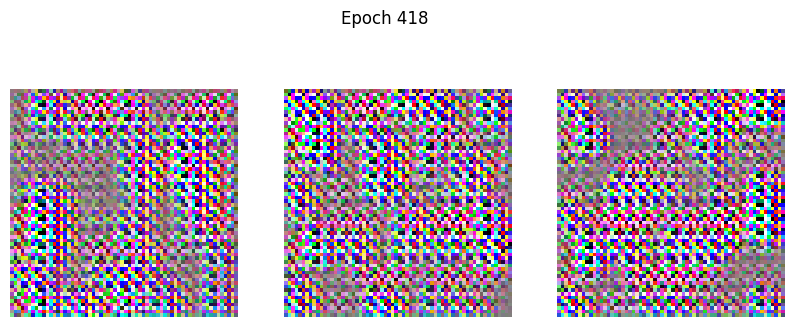

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 291ms/step - d_loss: 0.0632 - g_loss: 4.5188
Epoch 419/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0969 - g_loss: 5.2019 

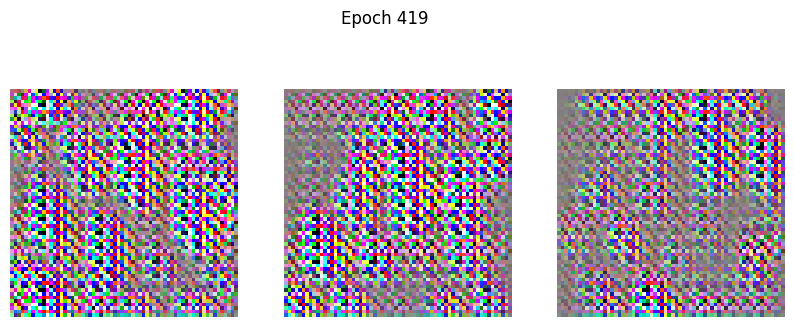

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step - d_loss: 0.0928 - g_loss: 5.1563
Epoch 420/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.0999 - g_loss: 4.5858 

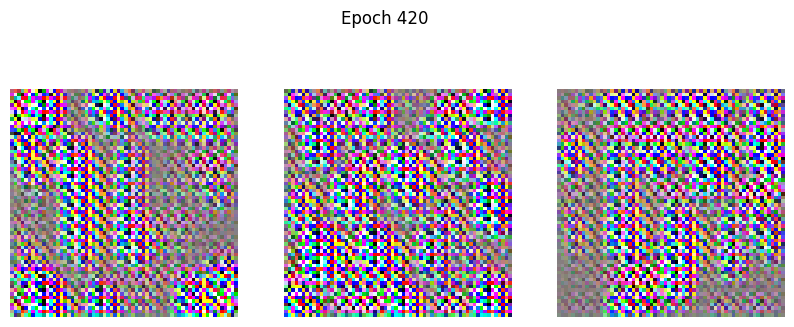

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step - d_loss: 0.1027 - g_loss: 4.9504
Epoch 421/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1004 - g_loss: 5.2437

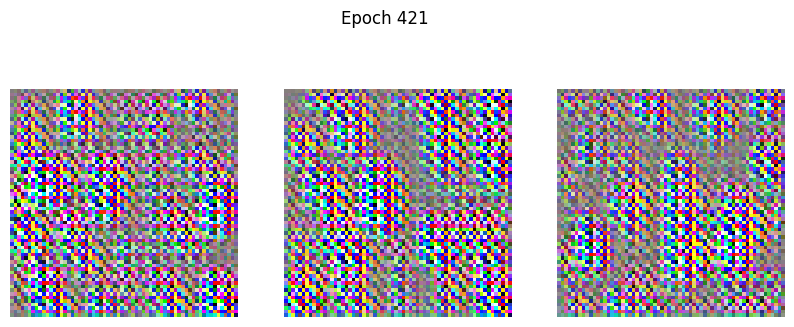

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 230ms/step - d_loss: 0.1004 - g_loss: 4.9237
Epoch 422/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step - d_loss: 0.2765 - g_loss: 10.1894

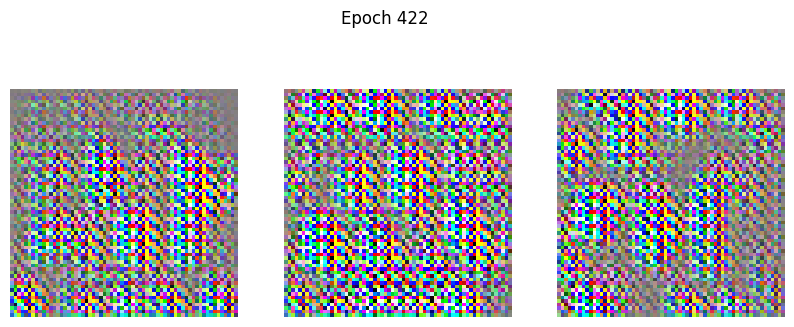

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - d_loss: 0.2820 - g_loss: 9.8729 
Epoch 423/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 0.0792 - g_loss: 4.1220 

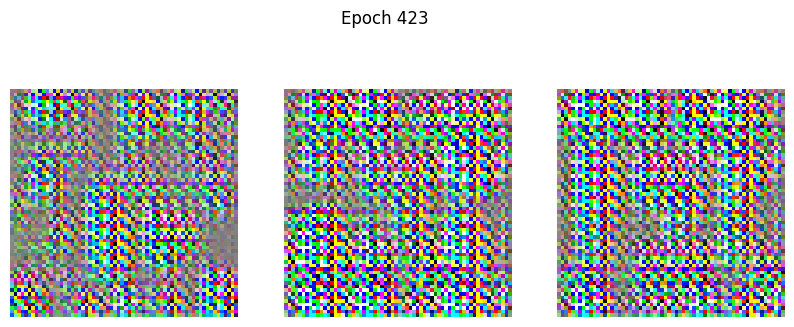

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - d_loss: 0.0895 - g_loss: 4.4804
Epoch 424/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0399 - g_loss: 6.1026

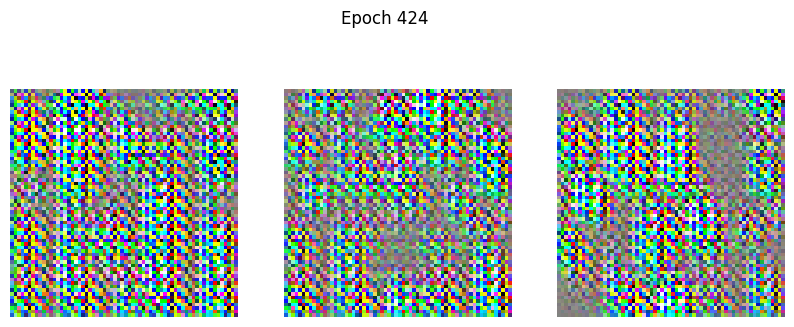

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 222ms/step - d_loss: 0.0440 - g_loss: 5.8443
Epoch 425/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1980 - g_loss: 6.2896 

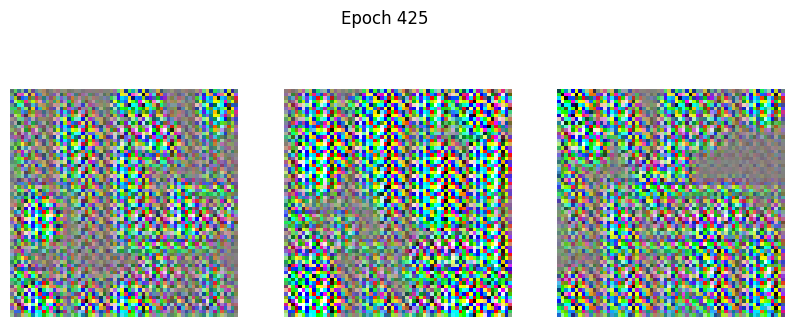

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1892 - g_loss: 6.1604
Epoch 426/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1941 - g_loss: 4.5706 

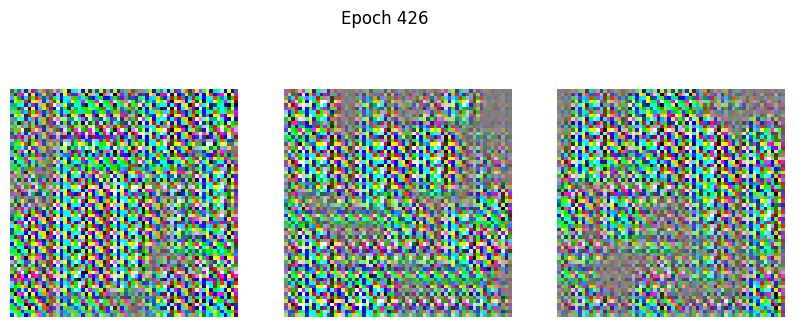

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - d_loss: 0.1965 - g_loss: 4.9402
Epoch 427/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1459 - g_loss: 5.0794

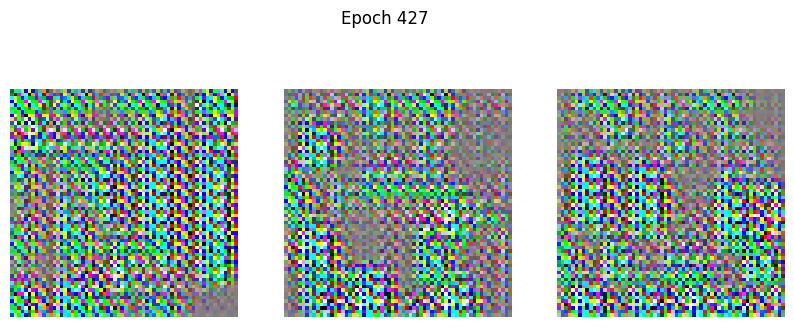

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1443 - g_loss: 4.8114
Epoch 428/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.2448 - g_loss: 7.0826 

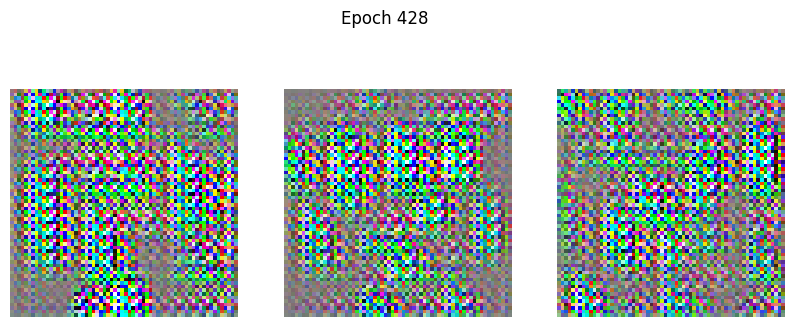

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.2288 - g_loss: 6.9914
Epoch 429/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1489 - g_loss: 3.7275

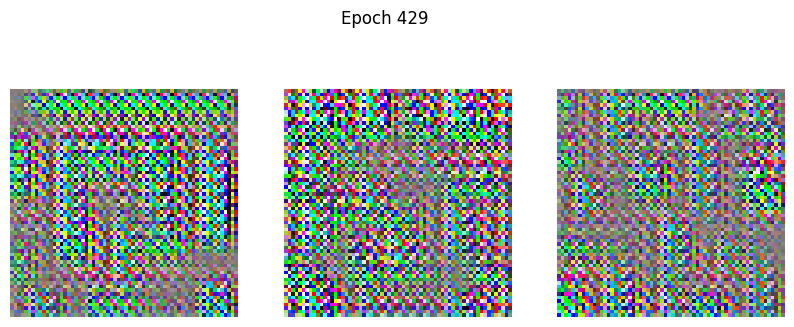

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - d_loss: 0.1606 - g_loss: 3.8478
Epoch 430/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1595 - g_loss: 4.1164

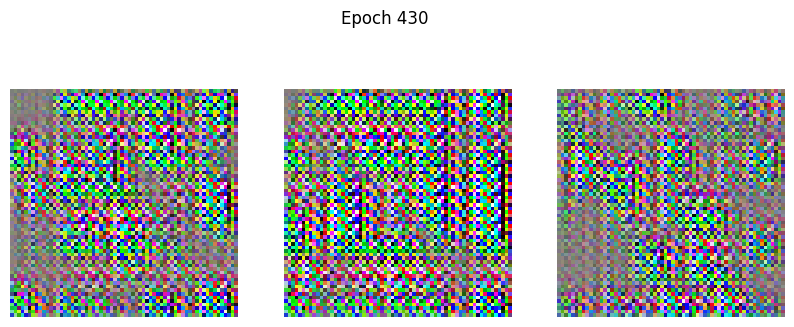

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 221ms/step - d_loss: 0.1673 - g_loss: 3.9989
Epoch 431/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.1772 - g_loss: 5.1596

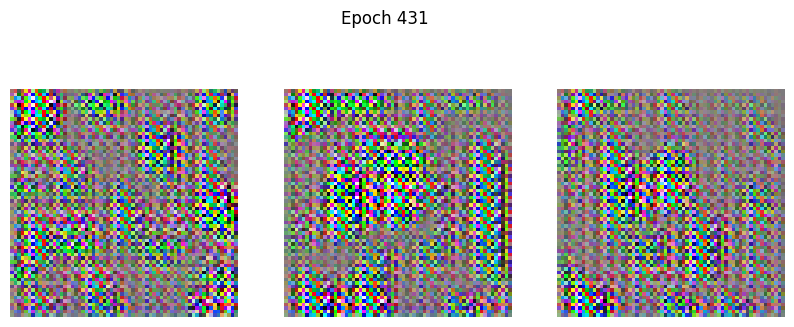

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.1730 - g_loss: 5.0303
Epoch 432/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0695 - g_loss: 3.6400

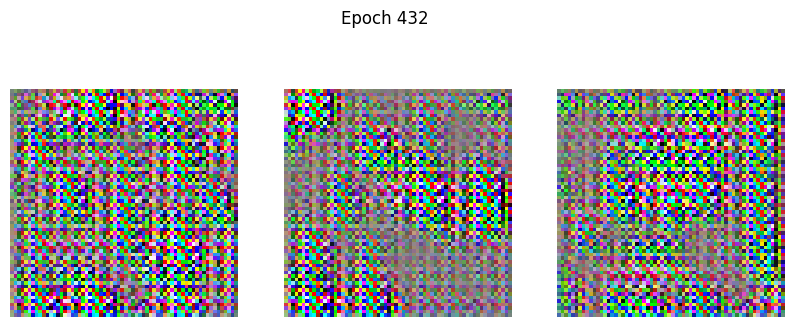

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0723 - g_loss: 3.6789
Epoch 433/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0843 - g_loss: 4.4220

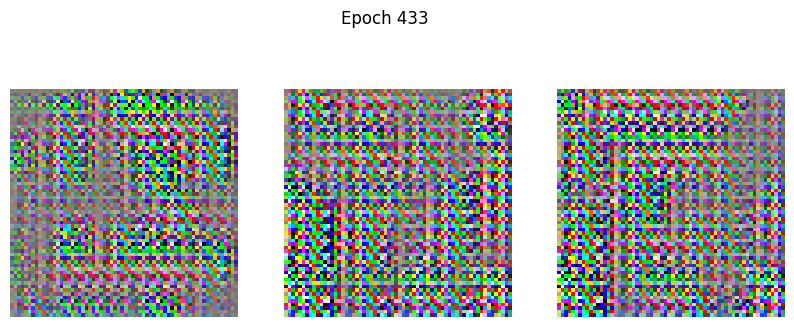

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0871 - g_loss: 4.4076
Epoch 434/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0965 - g_loss: 4.0190

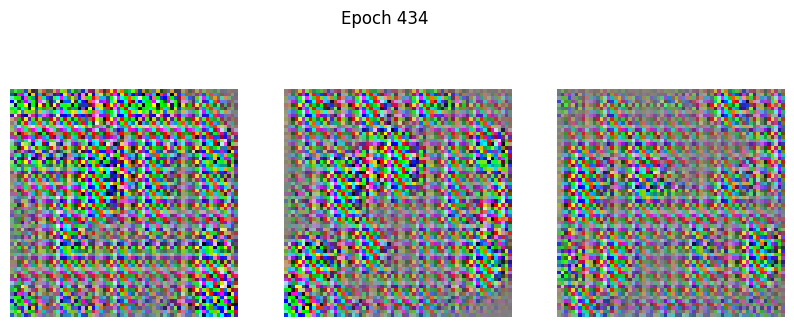

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.0990 - g_loss: 3.9894
Epoch 435/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1025 - g_loss: 4.0973

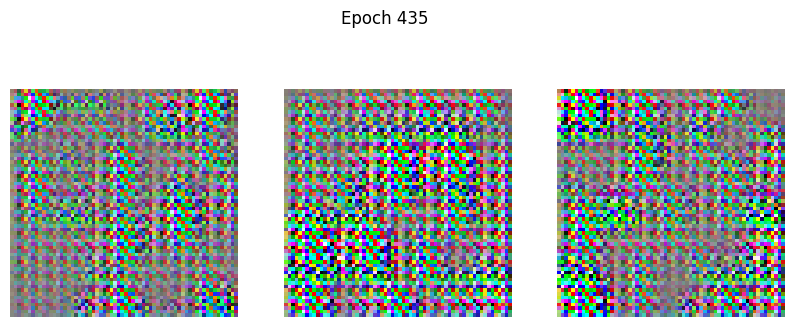

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - d_loss: 0.1044 - g_loss: 4.0293
Epoch 436/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1073 - g_loss: 4.0776 

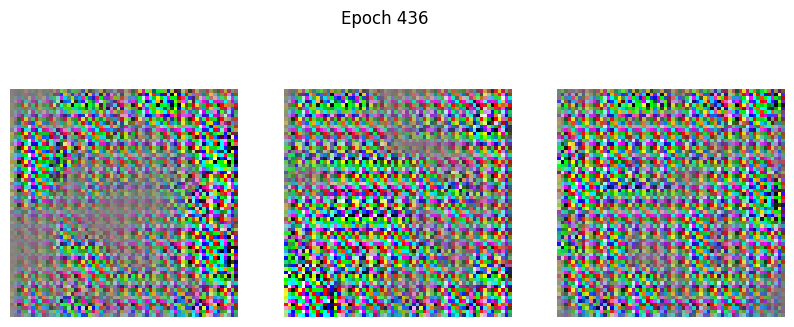

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1036 - g_loss: 4.1490
Epoch 437/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0613 - g_loss: 4.1745

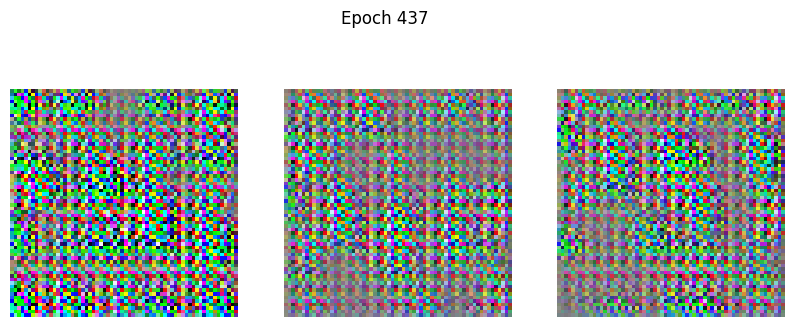

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0651 - g_loss: 4.0890
Epoch 438/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0732 - g_loss: 4.6696

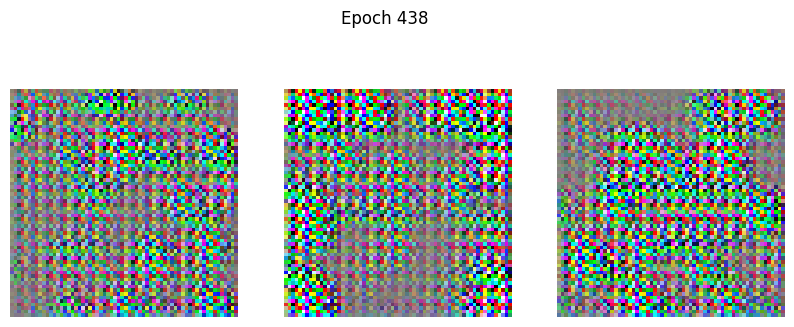

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.0751 - g_loss: 4.6286
Epoch 439/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.0475 - g_loss: 4.0004

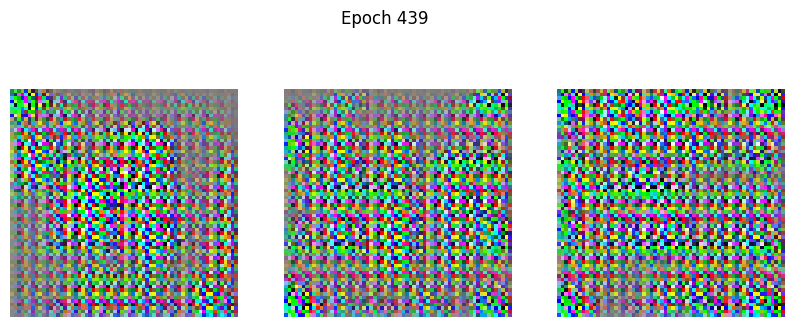

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - d_loss: 0.0510 - g_loss: 4.0427
Epoch 440/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0615 - g_loss: 4.4171 

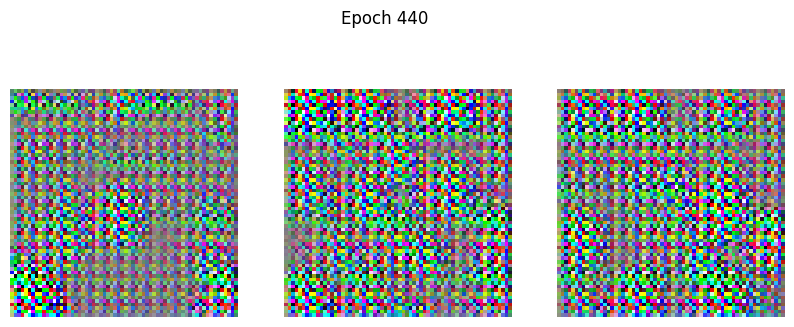

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.0597 - g_loss: 4.4602
Epoch 441/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0561 - g_loss: 4.3298 

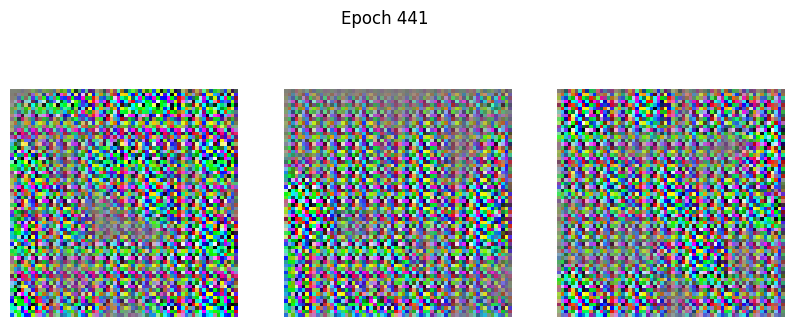

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0542 - g_loss: 4.3591
Epoch 442/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0607 - g_loss: 4.6913 

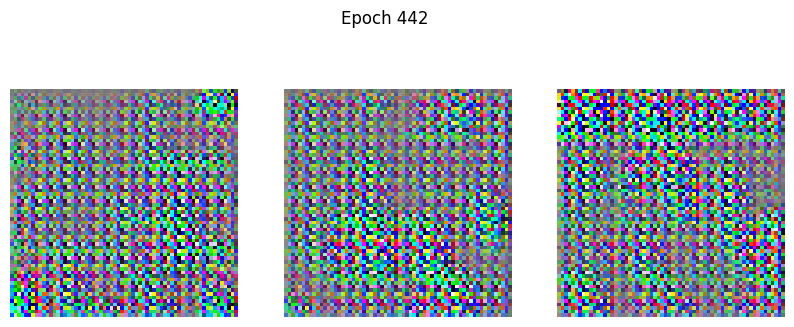

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.0595 - g_loss: 4.6853
Epoch 443/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0791 - g_loss: 4.5280 

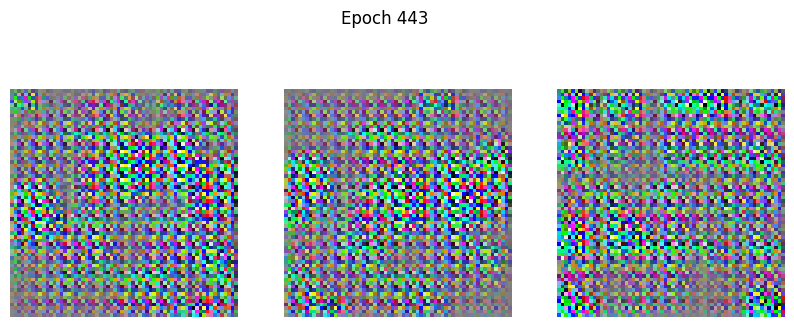

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0765 - g_loss: 4.5730
Epoch 444/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1058 - g_loss: 4.5189 

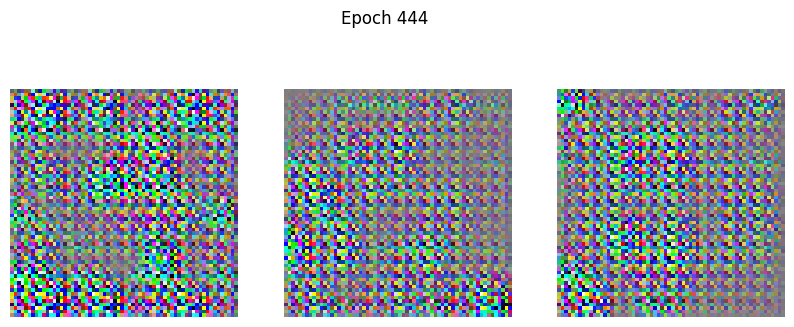

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - d_loss: 0.1068 - g_loss: 4.6489
Epoch 445/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1175 - g_loss: 4.7684

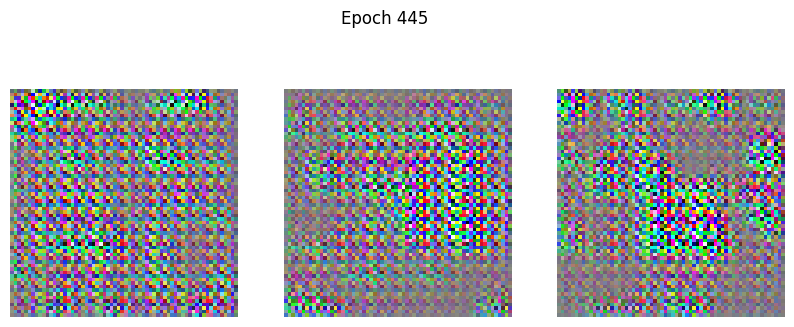

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1255 - g_loss: 4.6919
Epoch 446/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1913 - g_loss: 6.3542

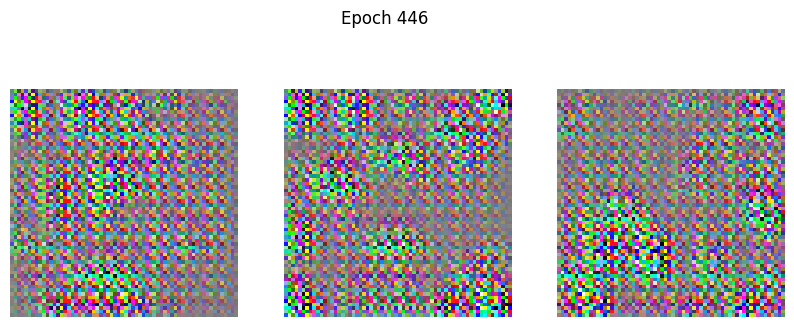

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.1965 - g_loss: 6.0333
Epoch 447/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.2041 - g_loss: 7.0653 

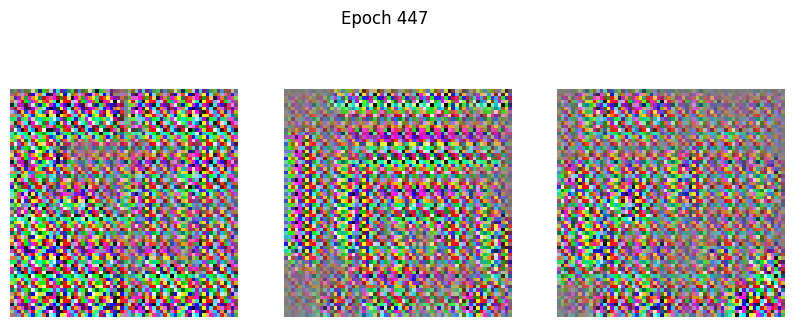

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - d_loss: 0.1873 - g_loss: 7.0272
Epoch 448/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0682 - g_loss: 4.1807

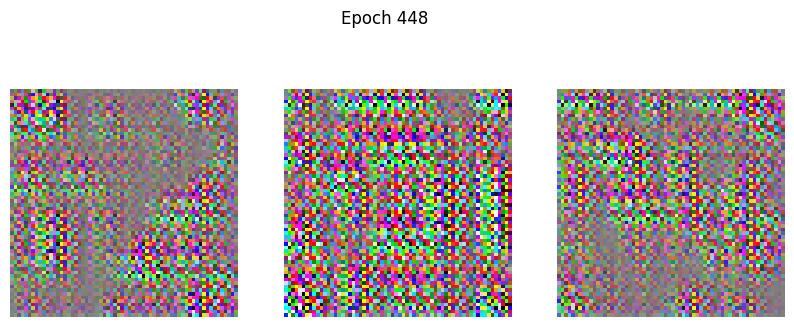

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0746 - g_loss: 4.2121
Epoch 449/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.0998 - g_loss: 4.8793 

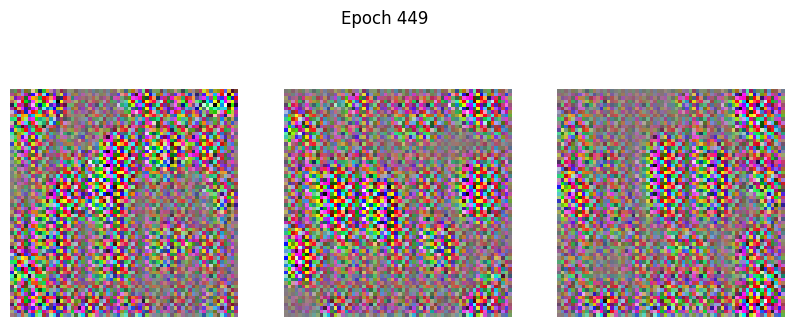

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - d_loss: 0.0965 - g_loss: 4.8825
Epoch 450/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.0888 - g_loss: 4.7332

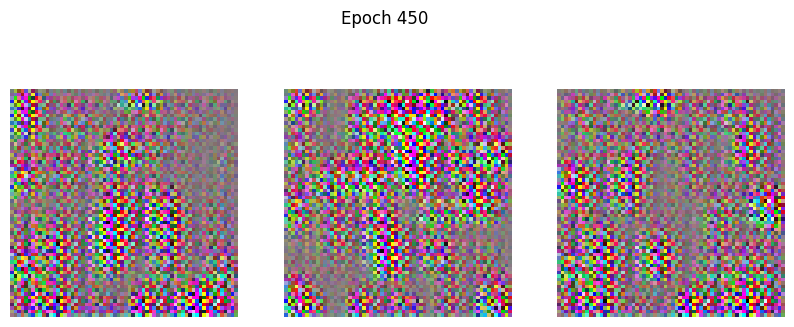

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - d_loss: 0.0936 - g_loss: 4.6290
Epoch 451/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1200 - g_loss: 5.1772

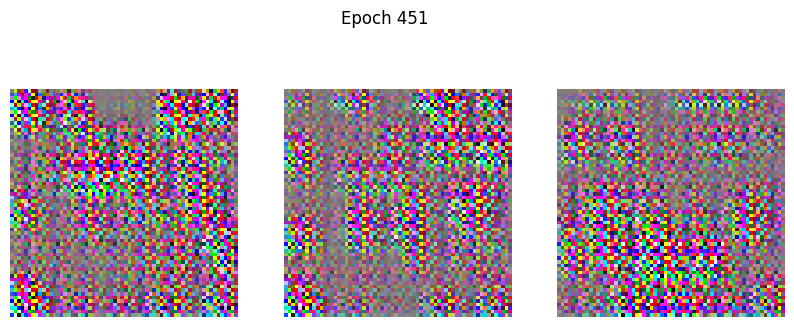

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1214 - g_loss: 5.1292
Epoch 452/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - d_loss: 0.1274 - g_loss: 5.1575 

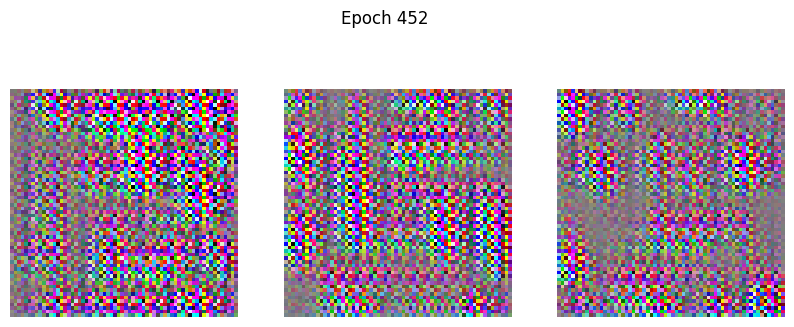

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 0.1214 - g_loss: 5.1194
Epoch 453/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1349 - g_loss: 5.5204

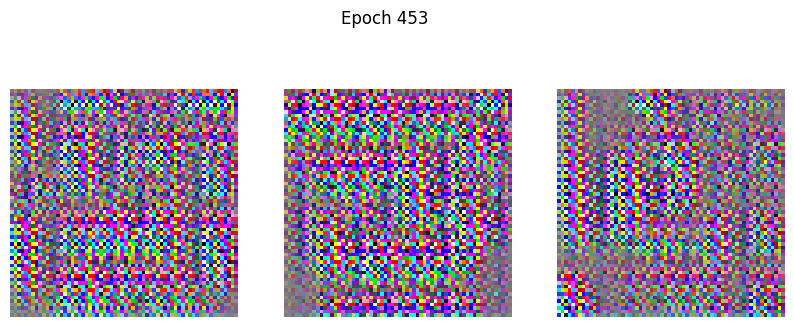

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1418 - g_loss: 5.2597
Epoch 454/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.2376 - g_loss: 9.0391

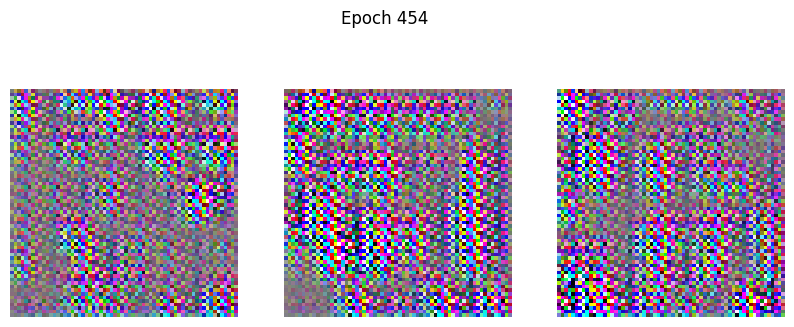

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.2337 - g_loss: 8.8555
Epoch 455/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0591 - g_loss: 4.6095

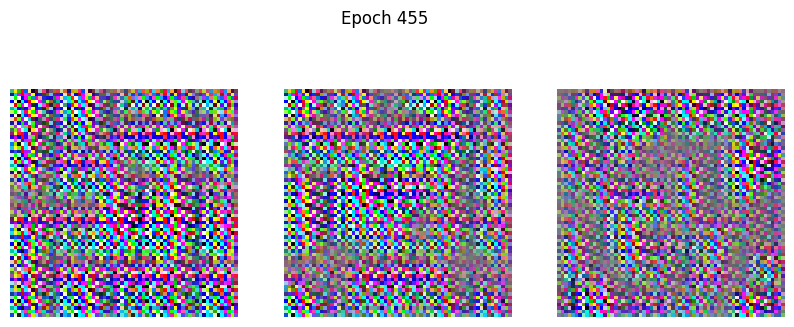

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.0682 - g_loss: 4.8836
Epoch 456/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.0514 - g_loss: 5.7999 

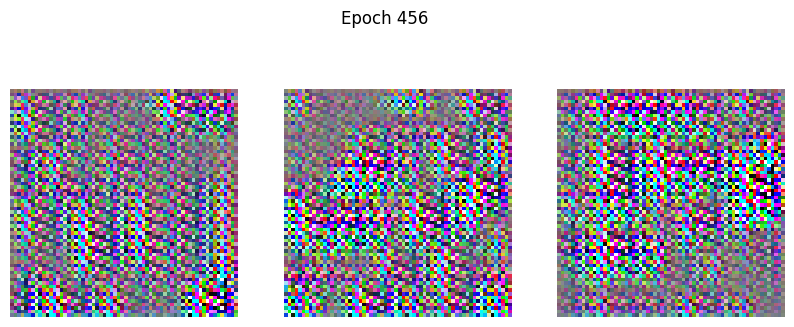

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step - d_loss: 0.0531 - g_loss: 5.7225
Epoch 457/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - d_loss: 0.2065 - g_loss: 6.6925

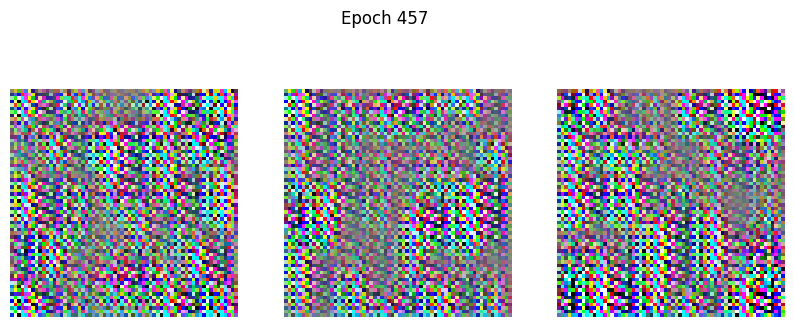

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step - d_loss: 0.2206 - g_loss: 6.1948
Epoch 458/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.4529 - g_loss: 10.3270

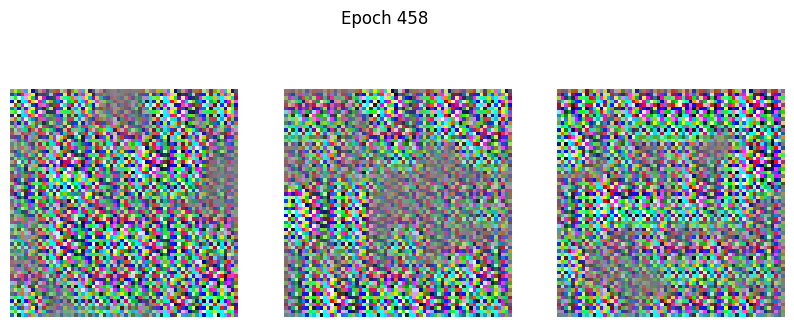

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 261ms/step - d_loss: 0.4314 - g_loss: 10.0776
Epoch 459/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - d_loss: 0.1162 - g_loss: 4.9245 

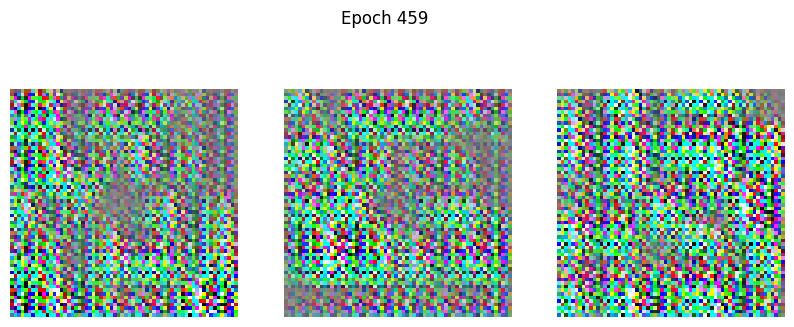

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1315 - g_loss: 5.3452
Epoch 460/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1060 - g_loss: 5.9822 

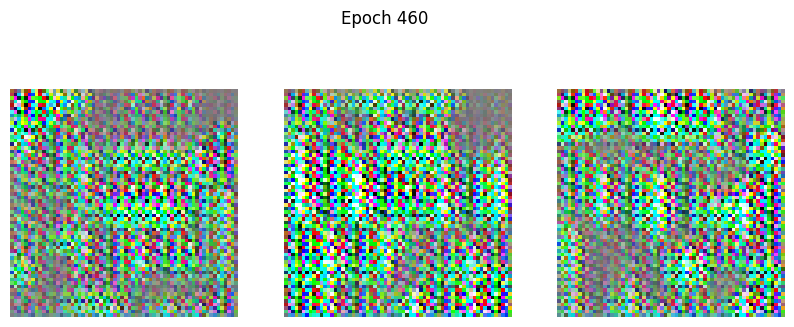

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step - d_loss: 0.1015 - g_loss: 5.7542
Epoch 461/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.2070 - g_loss: 6.2622

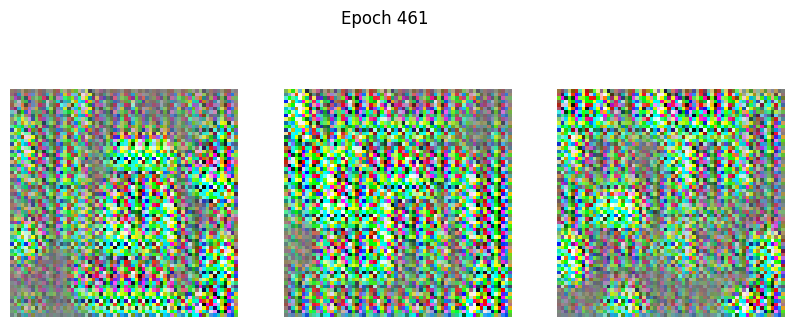

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 267ms/step - d_loss: 0.2109 - g_loss: 5.9954
Epoch 462/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1418 - g_loss: 5.6347

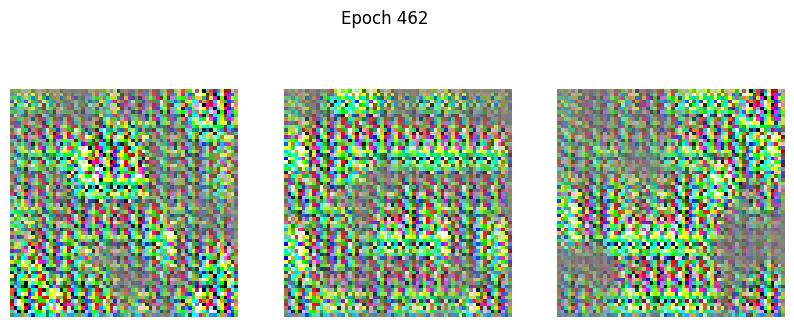

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step - d_loss: 0.1374 - g_loss: 5.5106
Epoch 463/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1014 - g_loss: 4.1169 

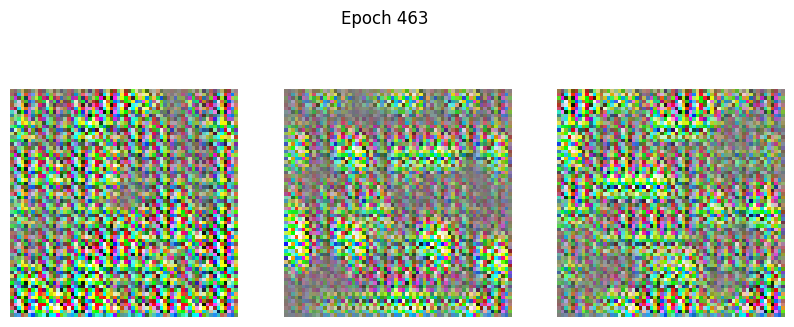

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 0.1005 - g_loss: 4.2076
Epoch 464/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0944 - g_loss: 4.5243

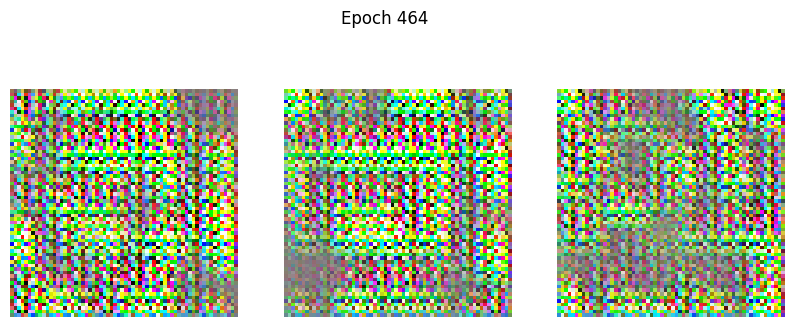

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1009 - g_loss: 4.3982
Epoch 465/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1896 - g_loss: 5.8133

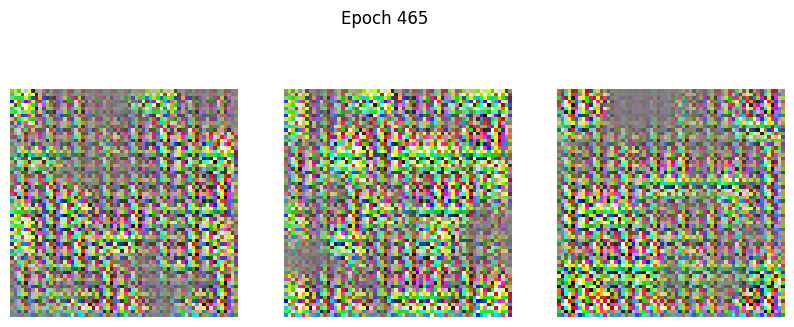

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1958 - g_loss: 5.4906
Epoch 466/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.1336 - g_loss: 5.0536 

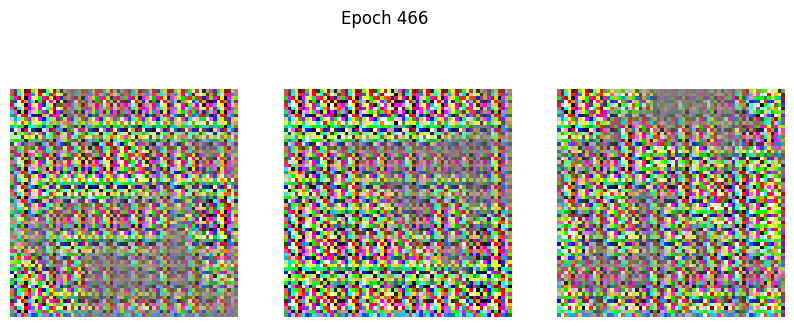

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - d_loss: 0.1246 - g_loss: 5.0171
Epoch 467/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0743 - g_loss: 3.9462

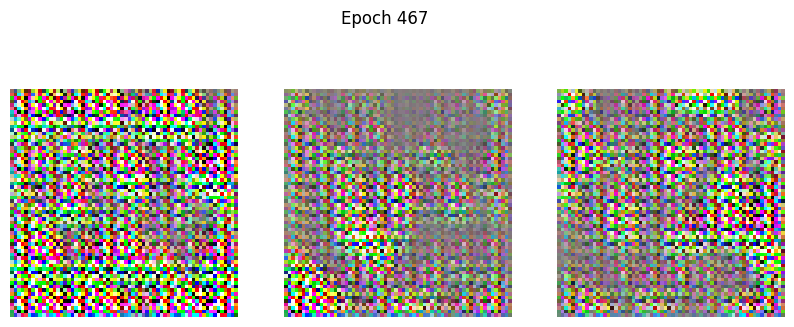

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0775 - g_loss: 3.9283
Epoch 468/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1125 - g_loss: 4.5632

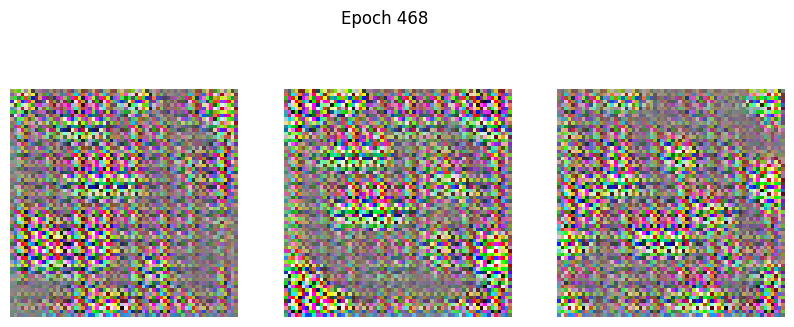

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step - d_loss: 0.1158 - g_loss: 4.4105
Epoch 469/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1386 - g_loss: 4.0423 

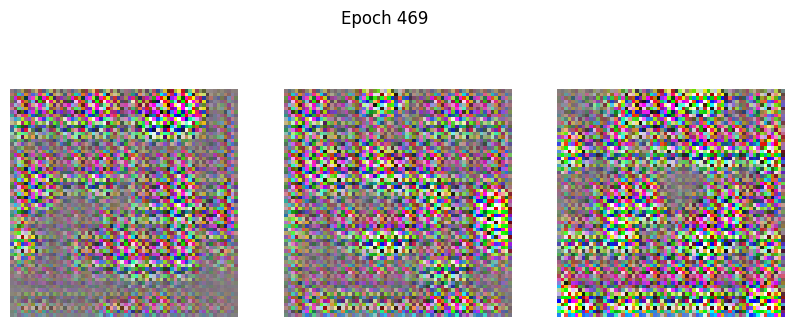

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 172ms/step - d_loss: 0.1329 - g_loss: 4.0069
Epoch 470/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1282 - g_loss: 3.8276

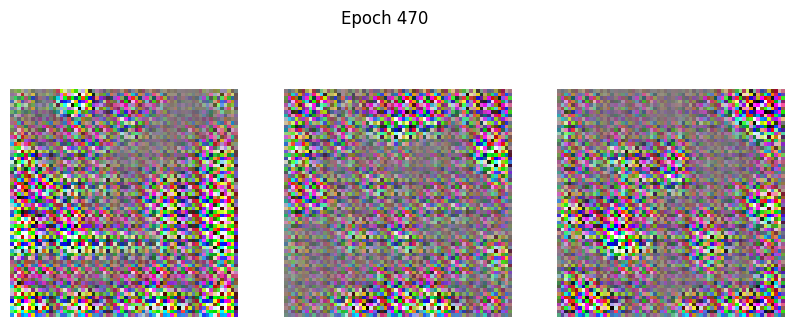

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1333 - g_loss: 3.7543
Epoch 471/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1618 - g_loss: 3.8187 

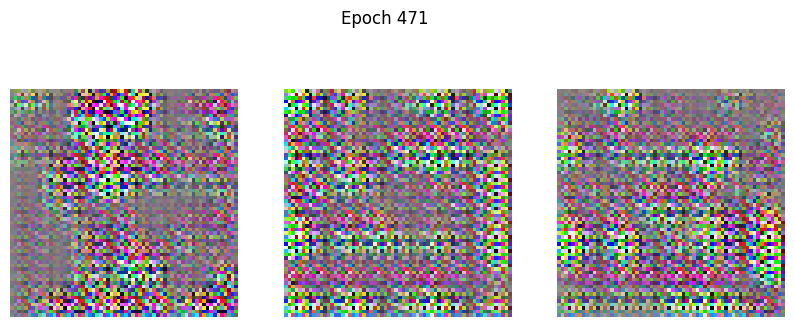

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - d_loss: 0.1564 - g_loss: 3.8167
Epoch 472/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1484 - g_loss: 3.2210 

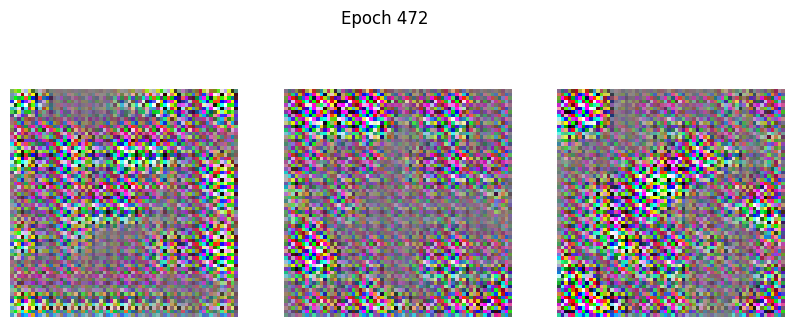

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1457 - g_loss: 3.2861
Epoch 473/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1243 - g_loss: 3.4361 

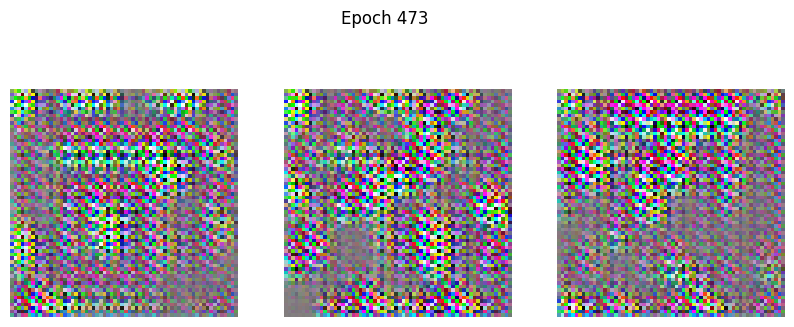

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - d_loss: 0.1211 - g_loss: 3.4636
Epoch 474/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1079 - g_loss: 3.8041

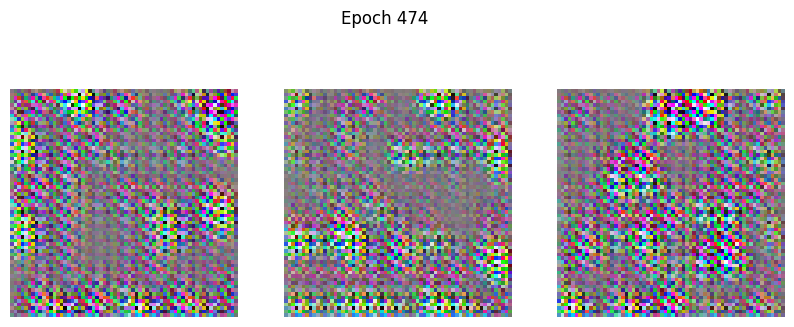

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.1105 - g_loss: 3.7369
Epoch 475/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - d_loss: 0.1200 - g_loss: 3.6946 

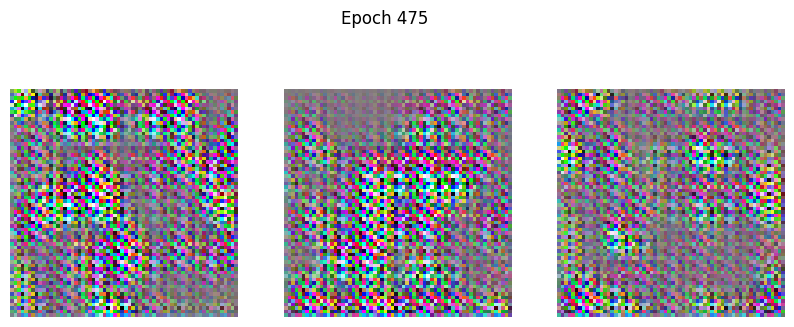

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - d_loss: 0.1156 - g_loss: 3.7486
Epoch 476/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1018 - g_loss: 3.7121

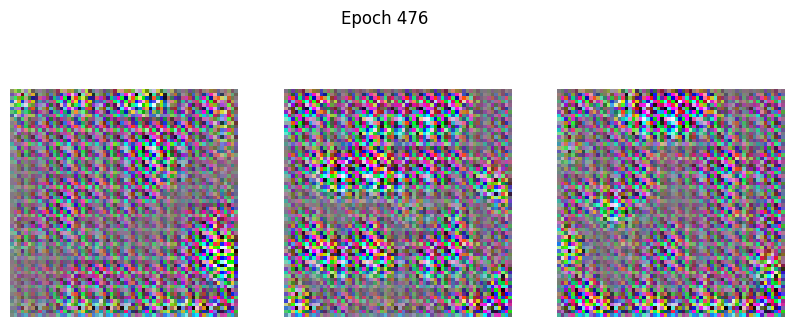

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - d_loss: 0.1066 - g_loss: 3.6732
Epoch 477/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1466 - g_loss: 4.1352

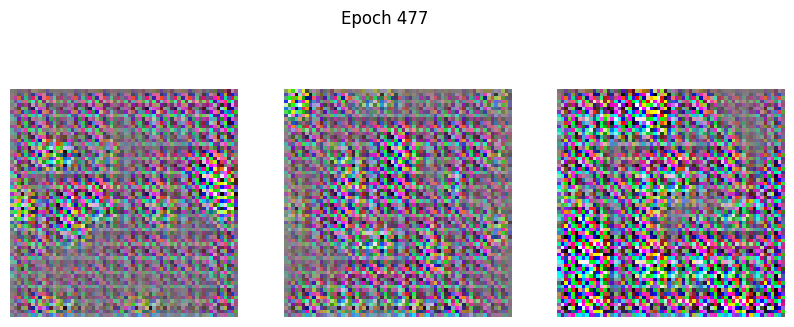

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - d_loss: 0.1506 - g_loss: 4.1546
Epoch 478/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.1426 - g_loss: 3.9924 

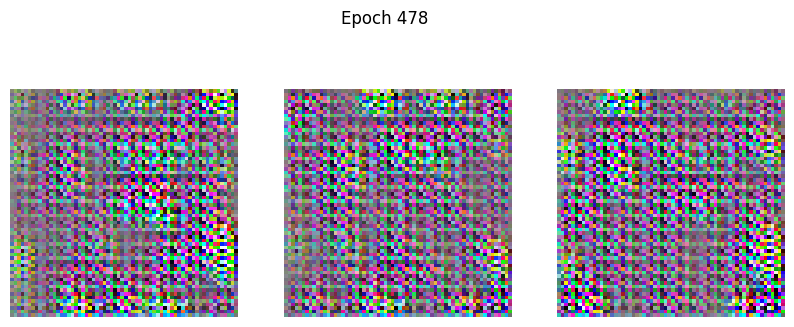

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - d_loss: 0.1368 - g_loss: 4.0353
Epoch 479/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.1221 - g_loss: 4.9763 

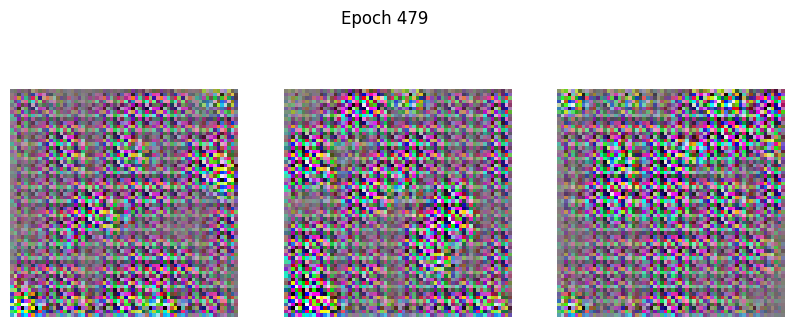

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1178 - g_loss: 4.9803
Epoch 480/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1132 - g_loss: 4.4839 

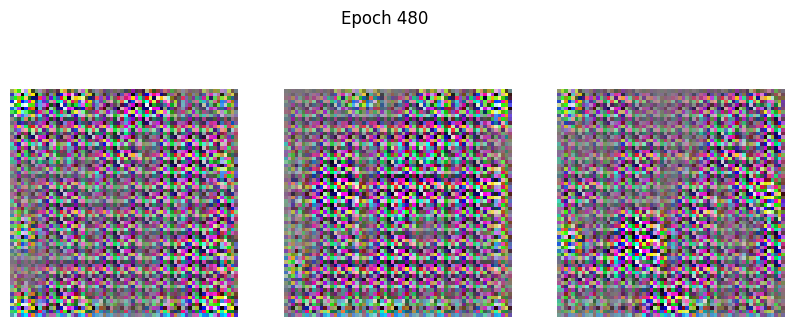

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - d_loss: 0.1144 - g_loss: 4.6365
Epoch 481/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0938 - g_loss: 4.5898 

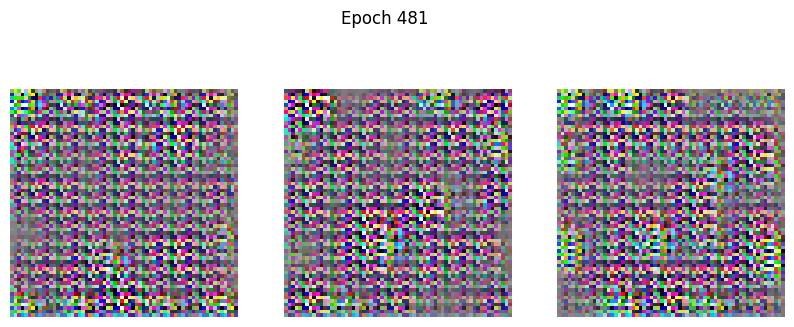

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - d_loss: 0.0912 - g_loss: 4.5671
Epoch 482/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.0901 - g_loss: 5.1972 

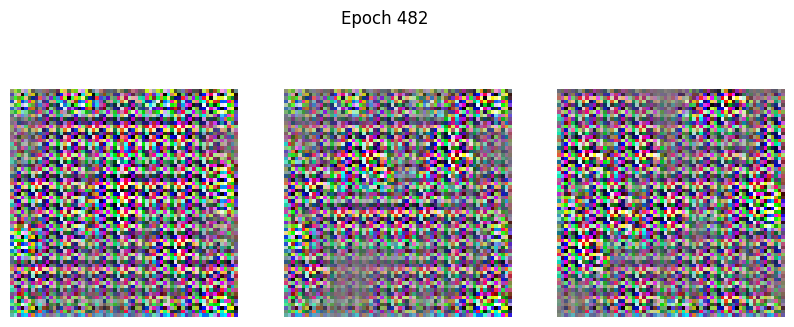

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - d_loss: 0.0878 - g_loss: 5.2147
Epoch 483/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - d_loss: 0.0886 - g_loss: 5.1094

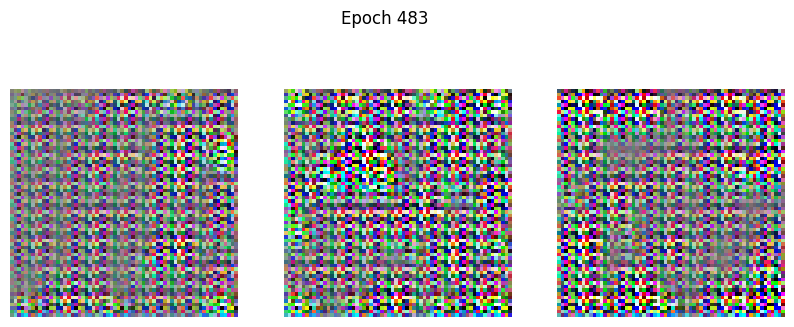

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.0944 - g_loss: 5.1967
Epoch 484/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1094 - g_loss: 5.4149

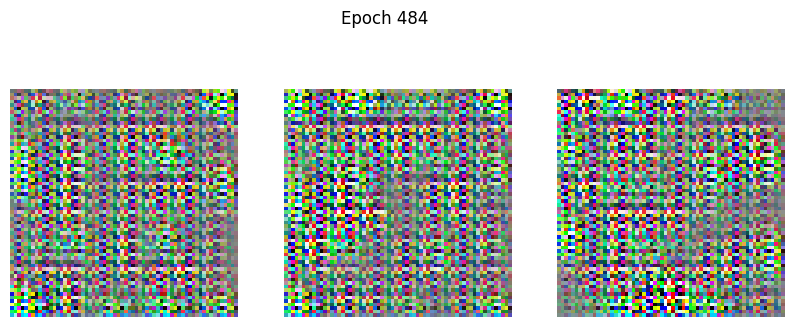

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - d_loss: 0.1141 - g_loss: 5.4120
Epoch 485/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - d_loss: 0.1469 - g_loss: 6.3319

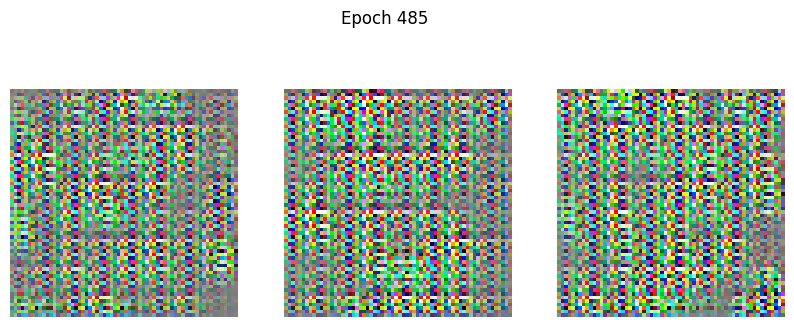

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step - d_loss: 0.1496 - g_loss: 6.0533
Epoch 486/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - d_loss: 0.3070 - g_loss: 9.1470

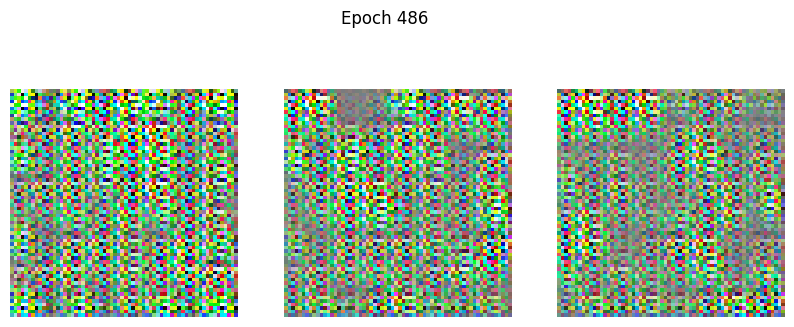

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - d_loss: 0.3093 - g_loss: 8.7006
Epoch 487/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.0965 - g_loss: 5.9546

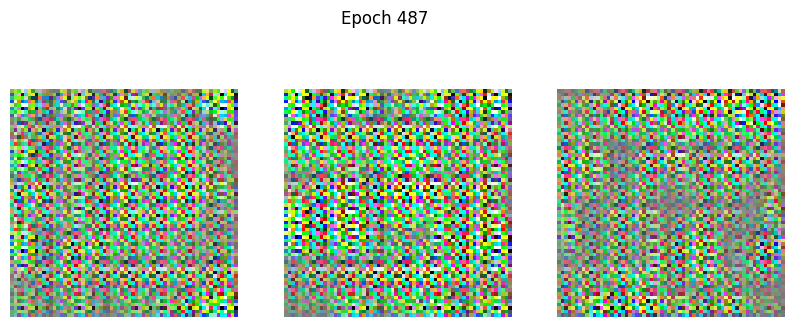

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - d_loss: 0.0943 - g_loss: 6.0865
Epoch 488/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0484 - g_loss: 5.4691

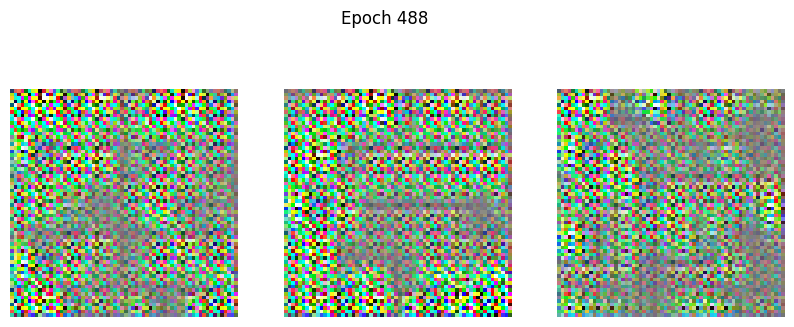

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.0522 - g_loss: 5.4144
Epoch 489/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1241 - g_loss: 6.0609

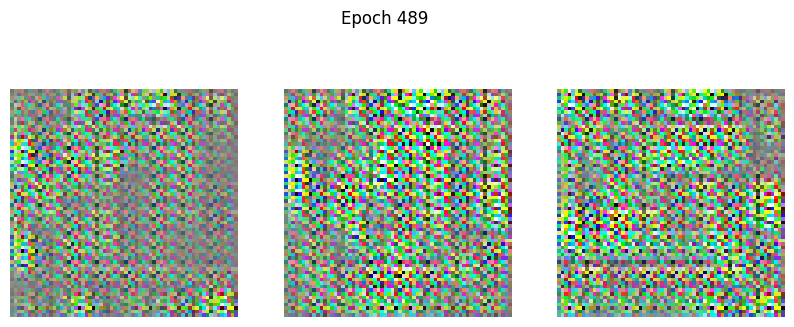

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - d_loss: 0.1290 - g_loss: 5.8053
Epoch 490/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.1325 - g_loss: 6.3050

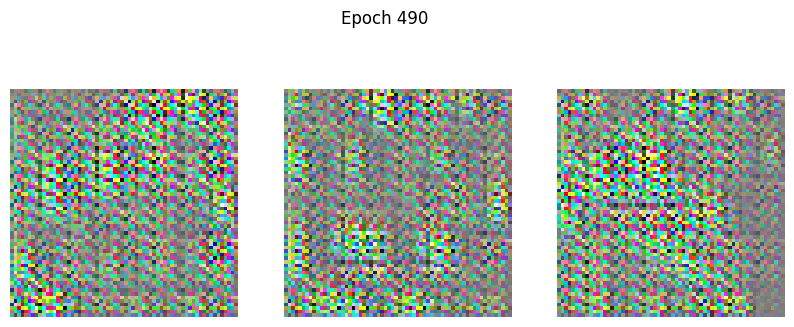

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - d_loss: 0.1295 - g_loss: 6.1576
Epoch 491/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.0739 - g_loss: 4.4647

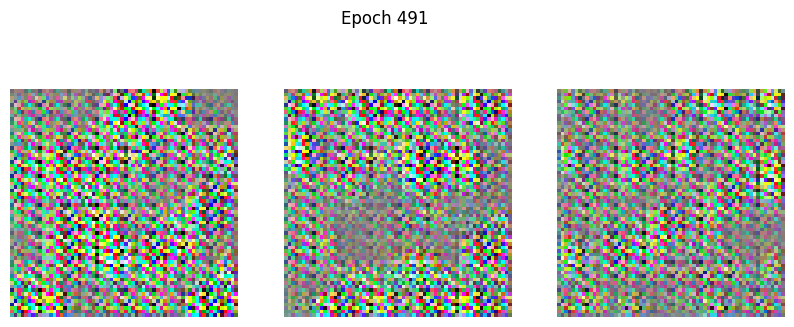

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - d_loss: 0.0799 - g_loss: 4.6441
Epoch 492/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - d_loss: 0.0888 - g_loss: 4.8627

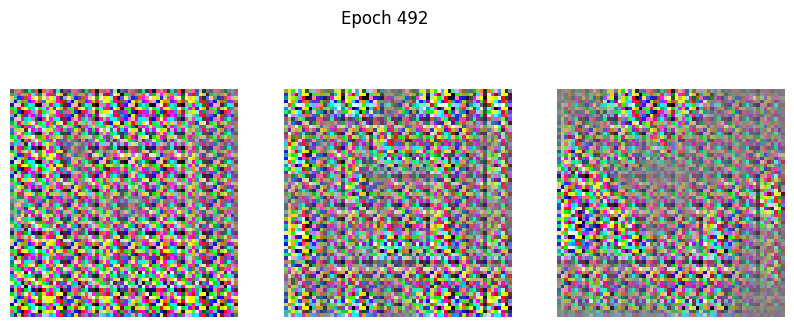

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step - d_loss: 0.0941 - g_loss: 4.7561
Epoch 493/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1683 - g_loss: 5.6436

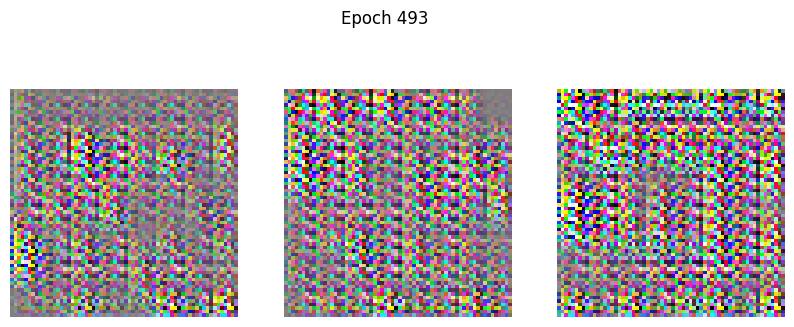

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step - d_loss: 0.1723 - g_loss: 5.3811
Epoch 494/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.1495 - g_loss: 6.4809 

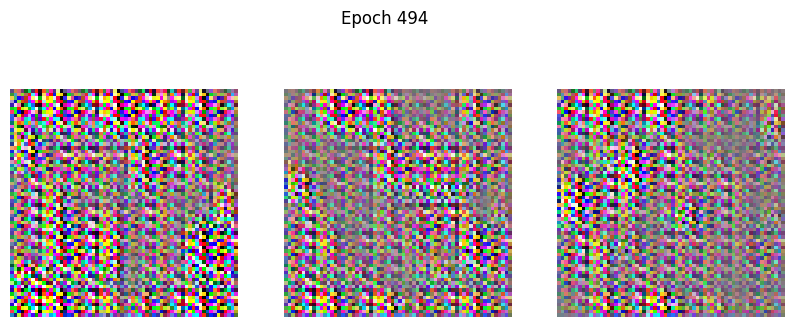

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - d_loss: 0.1371 - g_loss: 6.4412
Epoch 495/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.0798 - g_loss: 4.2819

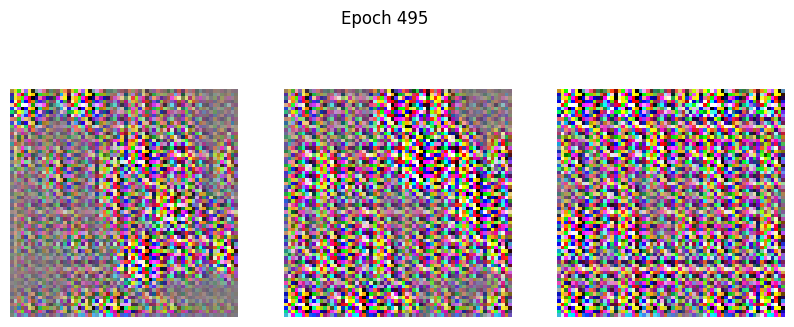

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step - d_loss: 0.0883 - g_loss: 4.4150
Epoch 496/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - d_loss: 0.1045 - g_loss: 4.7832

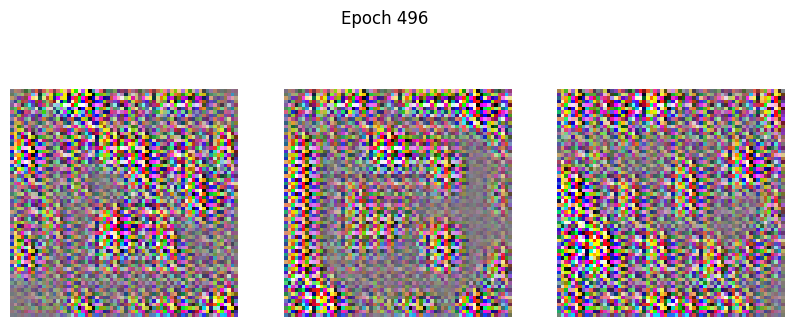

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step - d_loss: 0.1109 - g_loss: 4.6398
Epoch 497/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.1912 - g_loss: 6.4325

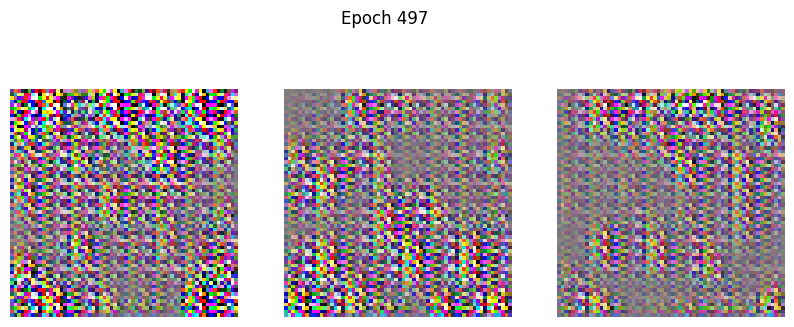

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step - d_loss: 0.1913 - g_loss: 6.2050
Epoch 498/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - d_loss: 0.0849 - g_loss: 4.1899 

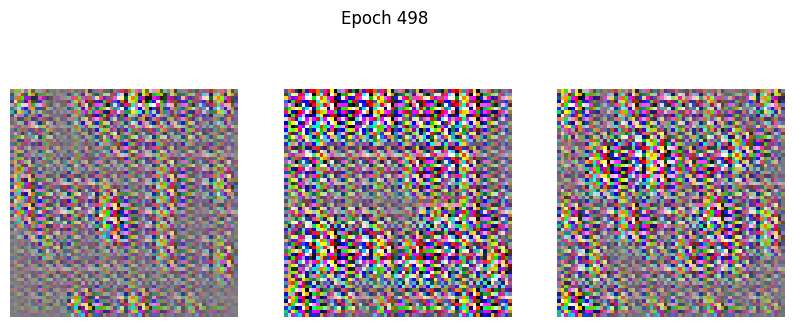

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - d_loss: 0.0853 - g_loss: 4.3165
Epoch 499/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - d_loss: 0.0568 - g_loss: 4.8791 

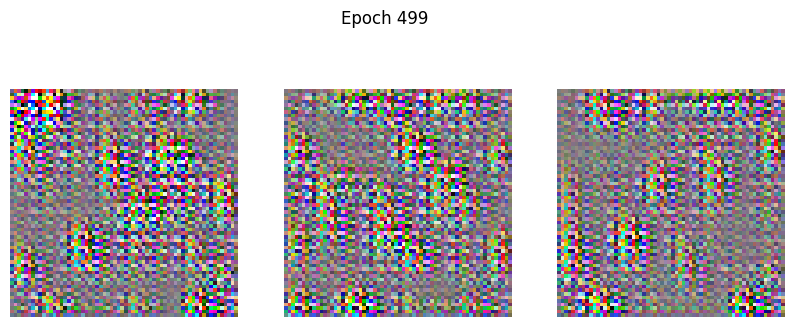

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 198ms/step - d_loss: 0.0568 - g_loss: 4.8111
Epoch 500/500
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - d_loss: 0.1184 - g_loss: 4.7539

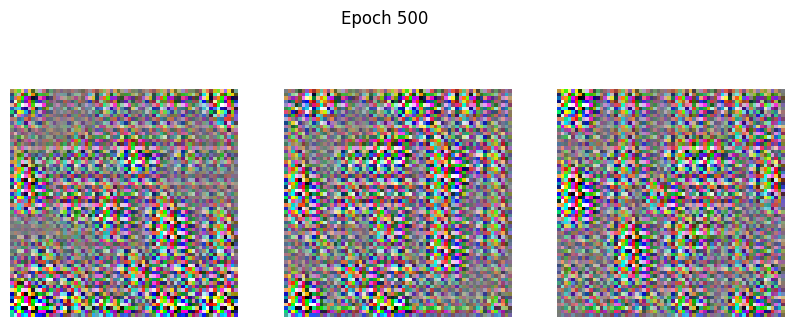

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step - d_loss: 0.1221 - g_loss: 4.6753


In [8]:
# Hyperparameters
EPOCHS = 500  # Tambahkan jumlah epoch untuk hasil lebih baik (misal: 100-200)
lr_generator = 0.0002
lr_discriminator = 0.0002

# Inisialisasi DCGAN
dcgan = DCGAN(discriminator=discriminator, generator=generator, latent_dim=latent_dim)

# Compile
dcgan.compile(
    d_optimizer=keras.optimizers.Adam(learning_rate=lr_discriminator, beta_1=0.5),
    g_optimizer=keras.optimizers.Adam(learning_rate=lr_generator, beta_1=0.5),
    loss_fn=keras.losses.BinaryCrossentropy(from_logits=True),
)

# Jalankan Training
print("Mulai Training...")
dcgan.fit(
    train_dataset,
    epochs=EPOCHS,
    callbacks=[GANMonitor(num_img=3, latent_dim=latent_dim)]
)